In [29]:
%matplotlib inline

# Preprocessing and Spike Sorting Tutorial

# Chapter 1: Importing Recording Data and Metadata

In [30]:
import os
import warnings
import glob
import pickle
import _pickle as cPickle
import imp
import git
import itertools
import cupy as cp

In [31]:
os.environ["SPECTRAL_CONNECTIVITY_ENABLE_GPU"] = "true"

In [32]:
os.environ["CUDA_PATH"] = "/usr/local/cuda-11.7"

In [33]:
from collections import defaultdict
import time
import json

In [34]:
import matplotlib.pyplot as plt
from matplotlib.pyplot import cm
import numpy as np
import pandas as pd
import scipy.signal
from labellines import labelLine, labelLines


In [35]:
from spectral_connectivity import Multitaper, Connectivity

In [36]:
from probeinterface import get_probe
from probeinterface.plotting import plot_probe, plot_probe_group
from probeinterface import write_prb, read_prb

In [37]:
# Changing the figure size
from matplotlib.pyplot import figure
figure(figsize=(8, 6), dpi=80)

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

The spikeinterface module by itself import only the spikeinterface.core submodule
which is not useful for end user



In [38]:
import spikeinterface

We need to import one by one different submodules separately (preferred).
There are 5 modules:

- :code:`extractors` : file IO
- :code:`toolkit` : processing toolkit for pre-, post-processing, validation, and automatic curation
- :code:`sorters` : Python wrappers of spike sorters
- :code:`comparison` : comparison of spike sorting output
- :code:`widgets` : visualization



In [39]:
import spikeinterface as si  # import core only
import spikeinterface.extractors as se
import spikeinterface.sorters as ss
import spikeinterface.comparison as sc
import spikeinterface.widgets as sw

In [40]:
import spikeinterface.core

We can also import all submodules at once with this
  this internally import core+extractors+toolkit+sorters+comparison+widgets+exporters

This is useful for notebooks but this is a more heavy import because internally many more dependency
are imported (scipy/sklearn/networkx/matplotlib/h5py...)



In [41]:
import spikeinterface.full as si

In [42]:
# Increase size of plot in jupyter

plt.rcParams["figure.figsize"] = (10,6)

# Part 1: Importing Data

- Getting the root directory of the Github Repo to base the files off of

In [43]:
git_repo = git.Repo(".", search_parent_directories=True)
git_root = git_repo.git.rev_parse("--show-toplevel")

In [44]:
git_root

'/nancy/projects/reward_competition_ephys_analysis_with_omission_and_divider_controls'

- Getting a list of all the electrophysiological recording files
    - **NOTE**: If your recording file does not end with `.rec` or is in a different directory than `./data` then you must change `glob.glob({./path/to/recording_file.rec})` below. Where you replace `{./path/to/recording_file.rec}` with the path to your recording file without the brackets.

```
MD EIB: 0(1 on Nancy notebook) Spike Gadgets/Spike Interface: 0
vHPC EIB: 16(17 on Nancy notebook) Spike Gadgets/Spike Interface: 31
BLA EIB: 17(18 on Nancy notebook) Spike Gadgets/Spike Interface: 30
LH EIB: 18(19 on Nancy notebook) Spike Gadgets/Spike Interface: 29
```

In [45]:
brain_region_to_channel = {"mPFC": "21", "MD": "16", "vHPC": "15", "BLA": "14", "LH": "13"}

In [46]:
channel_brain_region = {v: k for k, v in brain_region_to_channel.items()}

In [47]:
channel_brain_region

{'21': 'mPFC', '16': 'MD', '15': 'vHPC', '14': 'BLA', '13': 'LH'}

In [48]:
brain_region_to_channel = {k: v for k, v in sorted(brain_region_to_channel.items(), key=lambda item: item[1])}

In [49]:
brain_region_to_channel.keys()

dict_keys(['LH', 'BLA', 'vHPC', 'MD', 'mPFC'])

In [50]:
brain_region_to_channel.values()

dict_values(['13', '14', '15', '16', '21'])

In [51]:
brain_region_to_channel

{'LH': '13', 'BLA': '14', 'vHPC': '15', 'MD': '16', 'mPFC': '21'}

In [52]:
all_channels = [int(ch) for ch in brain_region_to_channel.values()]

In [53]:
all_channels

[13, 14, 15, 16, 21]

In [54]:
all_regions = brain_region_to_channel.keys()

In [55]:
all_regions

dict_keys(['LH', 'BLA', 'vHPC', 'MD', 'mPFC'])

In [56]:
resampled_frequency = 1000

## Calculating the power

In [57]:
lfp_array_filepath_glob = glob.glob("./proc/*/*traces.npy", recursive=True)

In [58]:
lfp_array_filepath_glob = [file for file in lfp_array_filepath_glob if "and" not in file]

In [59]:
lfp_array_filepath_glob

['./proc/20221123_113957_omission_subject_6_1_top_4_base_2_merged/20221123_113957_omission_subject_6_1_top_4_base_2_merged.traces.npy',
 './proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy',
 './proc/20221122_161341_omission_subject_6_1_top_4_base_2/20221122_161341_omission_subject_6_1_top_4_base_2.traces.npy',
 './proc/20221125_144832_omission_subject_6_1_top_1_base_2_merged/20221125_144832_omission_subject_6_1_top_1_base_2_merged.traces.npy',
 './proc/20221125_152723_competition_subject_6_1_top_3_base_2_merged/20221125_152723_competition_subject_6_1_top_3_base_2_merged.traces.npy']

# TESTING START

- Getting the tone times

In [66]:
tonetime_df = pd.read_csv("../2023_05_17_sleap_analysis/proc/timestamp_df/20221123_113957_omission_subject_6_1_and_6_4.tone_timestamps.csv", index_col=0)

In [67]:
tonetime_df

,tone_time,tone_state,reindexed_timestamp,lfp_index,video_time_stamp,video_frame,video_seconds,video_time,video_file_path,recording_basename,raw_data_file_path
0,9265924,1,0,0,1384,0,0,"(0, 0)",/nancy/projects/reward_competition_ephys_analy...,20221123_113957_omission_subject_6_1_and_6_4,/nancy/projects/reward_competition_ephys_analy...
1,9529345,0,263421,13171,263314,262,9,"(0, 9)",/nancy/projects/reward_competition_ephys_analy...,20221123_113957_omission_subject_6_1_and_6_4,/nancy/projects/reward_competition_ephys_analy...
2,10729738,1,1463814,73190,1463477,1460,52,"(0, 52)",/nancy/projects/reward_competition_ephys_analy...,20221123_113957_omission_subject_6_1_and_6_4,/nancy/projects/reward_competition_ephys_analy...
3,10929737,0,1663813,83190,1663042,1659,59,"(0, 59)",/nancy/projects/reward_competition_ephys_analy...,20221123_113957_omission_subject_6_1_and_6_4,/nancy/projects/reward_competition_ephys_analy...
4,12329733,1,3063809,153190,3062770,3056,109,"(1, 49)",/nancy/projects/reward_competition_ephys_analy...,20221123_113957_omission_subject_6_1_and_6_4,/nancy/projects/reward_competition_ephys_analy...
5,12529732,0,3263808,163190,3263721,3256,116,"(1, 56)",/nancy/projects/reward_competition_ephys_analy...,20221123_113957_omission_subject_6_1_and_6_4,/nancy/projects/reward_competition_ephys_analy...
6,14129728,1,4863804,243190,4863015,4853,173,"(2, 53)",/nancy/projects/reward_competition_ephys_analy...,20221123_113957_omission_subject_6_1_and_6_4,/nancy/projects/reward_competition_ephys_analy...
7,14329727,0,5063803,253190,5062580,5052,180,"(3, 0)",/nancy/projects/reward_competition_ephys_analy...,20221123_113957_omission_subject_6_1_and_6_4,/nancy/projects/reward_competition_ephys_analy...
8,15729723,1,6463799,323189,6463694,6450,230,"(3, 50)",/nancy/projects/reward_competition_ephys_analy...,20221123_113957_omission_subject_6_1_and_6_4,/nancy/projects/reward_competition_ephys_analy...
9,15929722,0,6663798,333189,6663259,6650,237,"(3, 57)",/nancy/projects/reward_competition_ephys_analy...,20221123_113957_omission_subject_6_1_and_6_4,/nancy/projects/reward_competition_ephys_analy...


- Getting the LFP

In [73]:
np_traces = np.load("../2023_05_17_lfp_analysis/proc/20221123_113957_omission_subject_6_1_top_4_base_2_merged/20221123_113957_omission_subject_6_1_top_4_base_2_merged.traces.npy")[:, 15]

In [77]:
duration = 20

In [88]:
sampling_rate = 1000

In [78]:
example_trial = np_traces[lfp_index - duration * 1000: lfp_index + duration * 1000]

# Calculating Power vs Frequency with NITIME

In [135]:
from nitime import timeseries
from nitime.algorithms.spectral import multi_taper_psd

In [116]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
import matplotlib.pyplot as plt
from scipy import signal
import numpy as np
from mtspec import mtspec


ModuleNotFoundError: No module named 'mtspec'

In [132]:
# Convert LFP to time-series object
T = utils.time_series(example_trial, sampling_interval=1./fs)

AttributeError: module 'nitime.utils' has no attribute 'time_series'

In [133]:
T = timeseries.TimeSeries(np_traces, sampling_interval=1./sampling_rate)

In [137]:
T

TimeSeries:UniformTime([0.000000e+00, 1.000000e-03, 2.000000e-03, ..., 1.277684e+03,
             1.277685e+03, 1.277686e+03], time_unit='s')array([-291, -163, -158, ..., -258, -183, -102], dtype=int16)

In [136]:
freqs, psd = multi_taper_psd(T, NW=4, adaptive=True, jackknife=True)


AttributeError: 'TimeSeries' object has no attribute 'reshape'

# Modeling with example code

## No trials, 200 Hz signal with 50 Hz signal starting at 25 seconds

In [184]:
# Simulate signal
frequency_of_interest = [200, 50]
sampling_frequency = 1500
time_extent = (0, 50)
n_time_samples = ((time_extent[1] - time_extent[0]) * sampling_frequency) + 1
time = np.linspace(time_extent[0], time_extent[1], num=n_time_samples, endpoint=True)
signal = np.sin(2 * np.pi * time[:, np.newaxis] * frequency_of_interest)
signal[: n_time_samples // 2, 1] = 0
signal = signal.sum(axis=1)
noise = np.random.normal(0, 4, signal.shape)

Text(0.5, 0, 'Time')

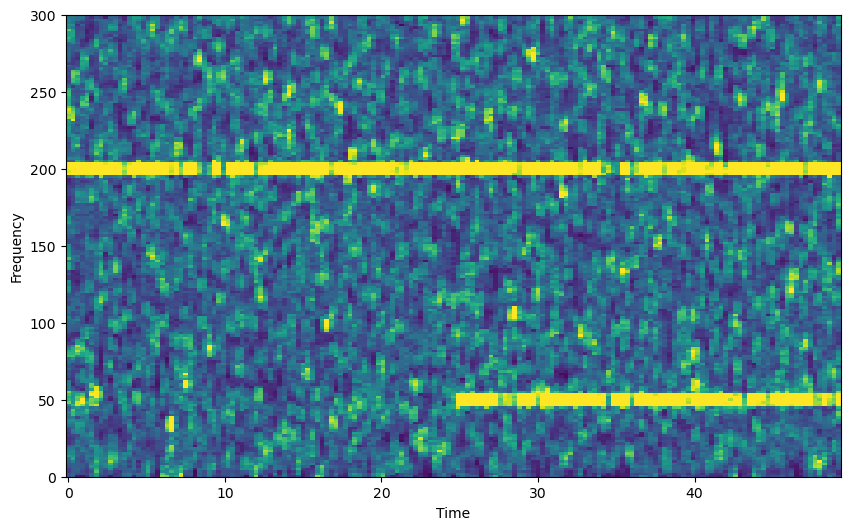

In [187]:
fig, ax = plt.subplots()

multitaper = Multitaper(
    signal + noise,
    sampling_frequency=sampling_frequency,
    time_halfbandwidth_product=3,
    time_window_duration=0.600,
    time_window_step=0.300,
    start_time=time[0],
)
connectivity = Connectivity.from_multitaper(multitaper)
mesh = ax.pcolormesh(
    connectivity.time,
    connectivity.frequencies,
    connectivity.power().squeeze().T,
    vmin=0.0,
    vmax=0.03,
    cmap="viridis",
    shading="auto",
)
ax.set_ylim((0, 300))
# ax.axvline(time[int(np.fix(n_time_samples / 2))], color="black")
ax.set_ylabel("Frequency")
ax.set_xlabel("Time")

## With trial structure (time x trials)


In [188]:
time_halfbandwidth_product = 1

frequency_of_interest = [200, 50]
time_extent = (0, 0.600)
n_trials = 100
sampling_frequency = 1500
n_time_samples = int(((time_extent[1] - time_extent[0]) * sampling_frequency) + 1)
time = np.linspace(time_extent[0], time_extent[1], num=n_time_samples, endpoint=True)
signal = np.sin(2 * np.pi * time[:, np.newaxis] * frequency_of_interest)
signal[: n_time_samples // 2, 1] = 0
signal = signal.sum(axis=1)[:, np.newaxis, np.newaxis]
noise = np.random.normal(0, 2, size=(n_time_samples, n_trials, 1))

In [192]:
n_time_samples

901

In [191]:
connectivity.time

array([0.  , 0.06, 0.12, 0.18, 0.24, 0.3 , 0.36, 0.42, 0.48, 0.54])

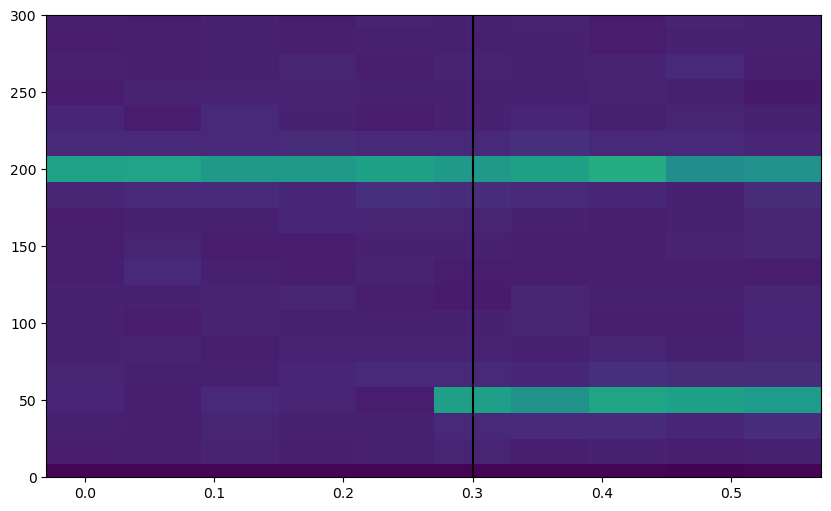

In [189]:
fig, ax = plt.subplots()

multitaper = Multitaper(
    signal + noise,
    sampling_frequency=sampling_frequency,
    time_halfbandwidth_product=time_halfbandwidth_product,
    time_window_duration=0.060,
    time_window_step=0.060,
    start_time=time[0],
)
connectivity = Connectivity.from_multitaper(multitaper)
mesh = ax.pcolormesh(
    connectivity.time,
    connectivity.frequencies,
    connectivity.power().squeeze().T,
    vmin=0.0,
    vmax=0.03,
    cmap="viridis",
    shading="auto",
)
ax.set_ylim((0, 300))
ax.axvline(time[int(np.fix(n_time_samples / 2))], color="black")

## Modeling a spectogram with this code

In [203]:
# Simulate signal
sampling_frequency = 1000
time_extent = (0, 40)
n_time_samples = ((time_extent[1] - time_extent[0]) * sampling_frequency) + 1
time = np.linspace(time_extent[0], time_extent[1], num=n_time_samples, endpoint=True)
signal = example_trial

In [197]:
signal

array([-1575, -1735, -1758, ...,  -864,  -881,  -857], dtype=int16)

KeyboardInterrupt: 

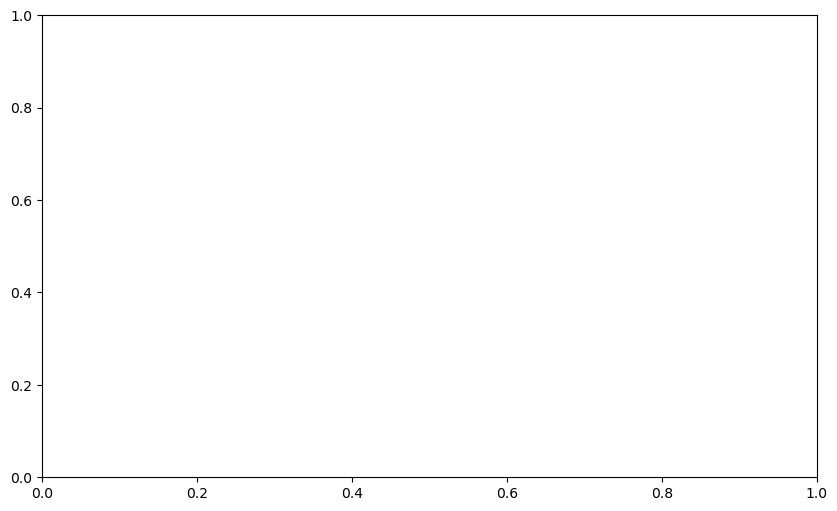

In [202]:
fig, ax = plt.subplots()

multitaper = Multitaper(
    signal + noise,
    sampling_frequency=sampling_frequency,
    time_halfbandwidth_product=3,
    time_window_duration=0.600,
    time_window_step=0.300,
    start_time=time[0],
)
connectivity = Connectivity.from_multitaper(multitaper)
mesh = ax.pcolormesh(
    connectivity.time,
    connectivity.frequencies,
    connectivity.power().squeeze().T,
    vmin=0.0,
    vmax=0.03,
    cmap="viridis",
    shading="auto",
)
ax.set_ylim((0, 300))
# ax.axvline(time[int(np.fix(n_time_samples / 2))], color="black")
ax.set_ylabel("Frequency")
ax.set_xlabel("Time")

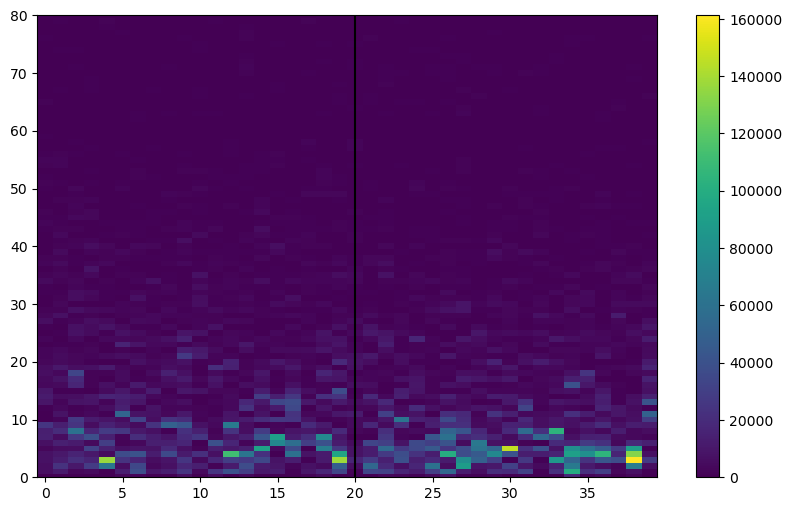

In [222]:
fig, ax = plt.subplots()

multitaper = Multitaper(
    signal,
    sampling_frequency=sampling_frequency,
    time_halfbandwidth_product=time_halfbandwidth_product,
    time_window_duration=1,
    time_window_step=1,
    start_time=time[0],
)
connectivity = Connectivity.from_multitaper(multitaper)
mesh = ax.pcolormesh(
    connectivity.time,
    connectivity.frequencies,
    connectivity.power().squeeze().T,
    cmap="viridis",
    shading="auto",
)
ax.set_ylim((0, 80))
ax.axvline(time[int(np.fix(n_time_samples / 2))], color="black")

cb = fig.colorbar(
    mesh,
#     ax=axes.ravel().tolist(),
#     orientation="horizontal",
#     shrink=0.5,
#     aspect=15,
#     pad=0.1,
#     label="Power",
)


In [224]:
connectivity.power().squeeze().shape

(40, 500)

In [225]:
connectivity.frequencies.shape

(500,)

In [163]:
time

array([0.        , 0.00066667, 0.00133333, 0.002     , 0.00266667,
       0.00333333, 0.004     , 0.00466667, 0.00533333, 0.006     ,
       0.00666667, 0.00733333, 0.008     , 0.00866667, 0.00933333,
       0.01      , 0.01066667, 0.01133333, 0.012     , 0.01266667,
       0.01333333, 0.014     , 0.01466667, 0.01533333, 0.016     ,
       0.01666667, 0.01733333, 0.018     , 0.01866667, 0.01933333,
       0.02      , 0.02066667, 0.02133333, 0.022     , 0.02266667,
       0.02333333, 0.024     , 0.02466667, 0.02533333, 0.026     ,
       0.02666667, 0.02733333, 0.028     , 0.02866667, 0.02933333,
       0.03      , 0.03066667, 0.03133333, 0.032     , 0.03266667,
       0.03333333, 0.034     , 0.03466667, 0.03533333, 0.036     ,
       0.03666667, 0.03733333, 0.038     , 0.03866667, 0.03933333,
       0.04      , 0.04066667, 0.04133333, 0.042     , 0.04266667,
       0.04333333, 0.044     , 0.04466667, 0.04533333, 0.046     ,
       0.04666667, 0.04733333, 0.048     , 0.04866667, 0.04933

# Calculating Power vs Frequency with Spectral Connectivity

In [60]:
time_halfbandwidth_product = 10
blocks = 5

In [145]:
time_window_duration = 1

In [149]:
time_window_step = time_window_duration * 0.5

In [63]:
first_proportion = 0
second_proportion = 1

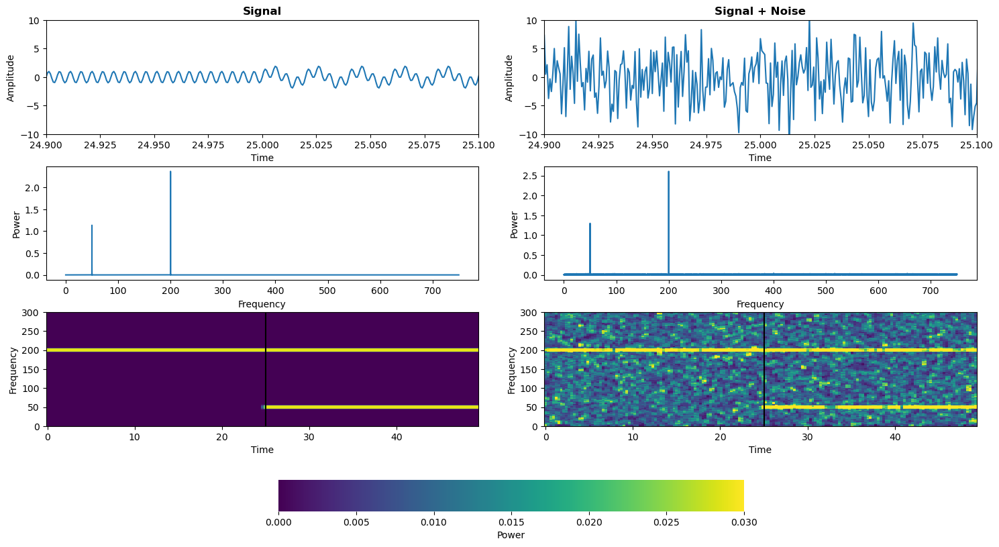

In [138]:
# Simulate signal
frequency_of_interest = [200, 50]
sampling_frequency = 1500
time_extent = (0, 50)
n_time_samples = ((time_extent[1] - time_extent[0]) * sampling_frequency) + 1
time = np.linspace(time_extent[0], time_extent[1], num=n_time_samples, endpoint=True)
signal = np.sin(2 * np.pi * time[:, np.newaxis] * frequency_of_interest)
signal[: n_time_samples // 2, 1] = 0
signal = signal.sum(axis=1)
noise = np.random.normal(0, 4, signal.shape)

# Plot
fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(15, 9))
axes[0, 0].plot(time, signal)
axes[0, 0].set_xlabel("Time")
axes[0, 0].set_ylabel("Amplitude")
axes[0, 0].set_title("Signal", fontweight="bold")
axes[0, 0].set_xlim((24.90, 25.10))
axes[0, 0].set_ylim((-10, 10))

axes[0, 1].plot(time, signal + noise)
axes[0, 1].set_xlabel("Time")
axes[0, 1].set_ylabel("Amplitude")
axes[0, 1].set_title("Signal + Noise", fontweight="bold")
axes[0, 1].set_xlim((24.90, 25.10))
axes[0, 1].set_ylim((-10, 10))

multitaper = Multitaper(
    signal,
    sampling_frequency=sampling_frequency,
    time_halfbandwidth_product=3,
    start_time=time[0],
)
connectivity = Connectivity.from_multitaper(multitaper)
axes[1, 0].plot(connectivity.frequencies, connectivity.power().squeeze())
axes[1, 0].set_xlabel("Frequency")
axes[1, 0].set_ylabel("Power")

multitaper = Multitaper(
    signal + noise,
    sampling_frequency=sampling_frequency,
    time_halfbandwidth_product=3,
    start_time=time[0],
)
connectivity = Connectivity.from_multitaper(multitaper)
axes[1, 1].plot(connectivity.frequencies, connectivity.power().squeeze())
axes[1, 1].set_xlabel("Frequency")
axes[1, 1].set_ylabel("Power")


multitaper = Multitaper(
    signal,
    sampling_frequency=sampling_frequency,
    time_halfbandwidth_product=3,
    time_window_duration=0.600,
    time_window_step=0.300,
    start_time=time[0],
)
connectivity = Connectivity.from_multitaper(multitaper)
mesh = axes[2, 0].pcolormesh(
    connectivity.time,
    connectivity.frequencies,
    connectivity.power().squeeze().T,
    vmin=0.0,
    vmax=0.03,
    cmap="viridis",
    shading="auto",
)
axes[2, 0].set_ylim((0, 300))
axes[2, 0].axvline(time[int(np.fix(n_time_samples / 2))], color="black")
axes[2, 0].set_ylabel("Frequency")
axes[2, 0].set_xlabel("Time")

multitaper = Multitaper(
    signal + noise,
    sampling_frequency=sampling_frequency,
    time_halfbandwidth_product=3,
    time_window_duration=0.600,
    time_window_step=0.300,
    start_time=time[0],
)
connectivity = Connectivity.from_multitaper(multitaper)
mesh = axes[2, 1].pcolormesh(
    connectivity.time,
    connectivity.frequencies,
    connectivity.power().squeeze().T,
    vmin=0.0,
    vmax=0.03,
    cmap="viridis",
    shading="auto",
)
axes[2, 1].set_ylim((0, 300))
axes[2, 1].axvline(time[int(np.fix(n_time_samples / 2))], color="black")
axes[2, 1].set_ylabel("Frequency")
axes[2, 1].set_xlabel("Time")

plt.tight_layout()
cb = fig.colorbar(
    mesh,
    ax=axes.ravel().tolist(),
    orientation="horizontal",
    shrink=0.5,
    aspect=15,
    pad=0.1,
    label="Power",
)
cb.outline.set_linewidth(0)

In [139]:
connectivity.time

array([ 0. ,  0.3,  0.6,  0.9,  1.2,  1.5,  1.8,  2.1,  2.4,  2.7,  3. ,
        3.3,  3.6,  3.9,  4.2,  4.5,  4.8,  5.1,  5.4,  5.7,  6. ,  6.3,
        6.6,  6.9,  7.2,  7.5,  7.8,  8.1,  8.4,  8.7,  9. ,  9.3,  9.6,
        9.9, 10.2, 10.5, 10.8, 11.1, 11.4, 11.7, 12. , 12.3, 12.6, 12.9,
       13.2, 13.5, 13.8, 14.1, 14.4, 14.7, 15. , 15.3, 15.6, 15.9, 16.2,
       16.5, 16.8, 17.1, 17.4, 17.7, 18. , 18.3, 18.6, 18.9, 19.2, 19.5,
       19.8, 20.1, 20.4, 20.7, 21. , 21.3, 21.6, 21.9, 22.2, 22.5, 22.8,
       23.1, 23.4, 23.7, 24. , 24.3, 24.6, 24.9, 25.2, 25.5, 25.8, 26.1,
       26.4, 26.7, 27. , 27.3, 27.6, 27.9, 28.2, 28.5, 28.8, 29.1, 29.4,
       29.7, 30. , 30.3, 30.6, 30.9, 31.2, 31.5, 31.8, 32.1, 32.4, 32.7,
       33. , 33.3, 33.6, 33.9, 34.2, 34.5, 34.8, 35.1, 35.4, 35.7, 36. ,
       36.3, 36.6, 36.9, 37.2, 37.5, 37.8, 38.1, 38.4, 38.7, 39. , 39.3,
       39.6, 39.9, 40.2, 40.5, 40.8, 41.1, 41.4, 41.7, 42. , 42.3, 42.6,
       42.9, 43.2, 43.5, 43.8, 44.1, 44.4, 44.7, 45

In [150]:
# Compute multitaper spectral estimate
m = Multitaper(time_halfbandwidth_product=time_halfbandwidth_product, \
               time_window_duration=time_window_step*2,
               time_window_step=time_window_step,
               time_series=example_trial,
               sampling_frequency=resampled_frequency, start_time=time[0])

# Sets up computing connectivity measures/power from multitaper spectral estimate
c = Connectivity.from_multitaper(m)

In [151]:
c.time

array([ 0. ,  0.5,  1. ,  1.5,  2. ,  2.5,  3. ,  3.5,  4. ,  4.5,  5. ,
        5.5,  6. ,  6.5,  7. ,  7.5,  8. ,  8.5,  9. ,  9.5, 10. , 10.5,
       11. , 11.5, 12. , 12.5, 13. , 13.5, 14. , 14.5, 15. , 15.5, 16. ,
       16.5, 17. , 17.5, 18. , 18.5, 19. , 19.5, 20. , 20.5, 21. , 21.5,
       22. , 22.5, 23. , 23.5, 24. , 24.5, 25. , 25.5, 26. , 26.5, 27. ,
       27.5, 28. , 28.5, 29. , 29.5, 30. , 30.5, 31. , 31.5, 32. , 32.5,
       33. , 33.5, 34. , 34.5, 35. , 35.5, 36. , 36.5, 37. , 37.5, 38. ,
       38.5, 39. ])

In [154]:
c.power().squeeze().shape

(79, 500)

In [155]:
c.frequencies.shape

(500,)

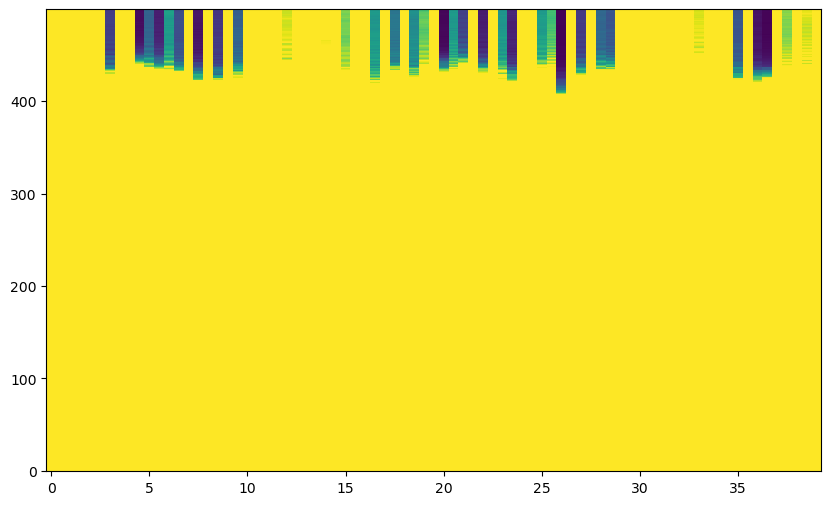

In [161]:
fig, ax = plt.subplots()

mesh = ax.pcolormesh(
    c.time,
    c.frequencies,
    c.power().squeeze().T,
    vmin=0.0,
    vmax=0.03,
    cmap="viridis",
    shading="auto",
)

ValueError: not enough values to unpack (expected 2, got 1)

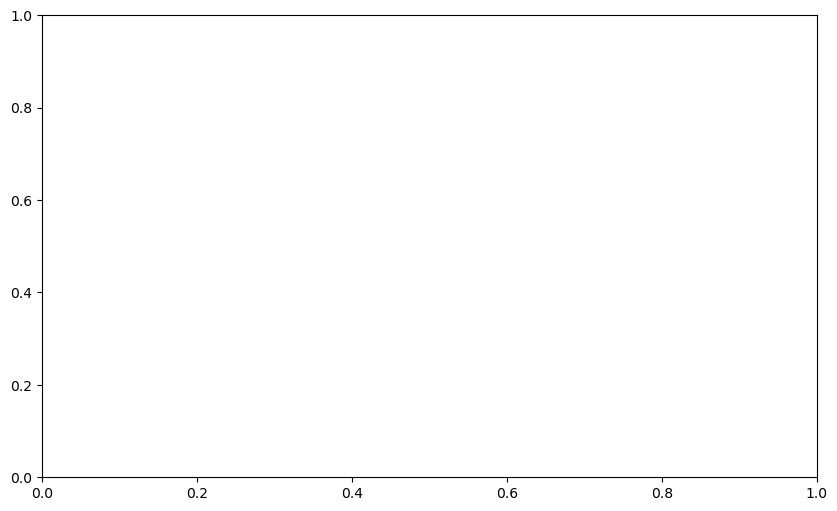

In [159]:
# Display the average spectrogram
cax = plt.pcolormesh(c.time, c.frequencies, 10 * np.log10(np.mean(c.power().squeeze(), axis=0)))
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [sec]')
plt.ylim(0,20)

cbar = plt.colorbar(cax)
cbar.set_label('Power spectral density (dB/Hz)')
plt.show()

(0.0, 50000.0)

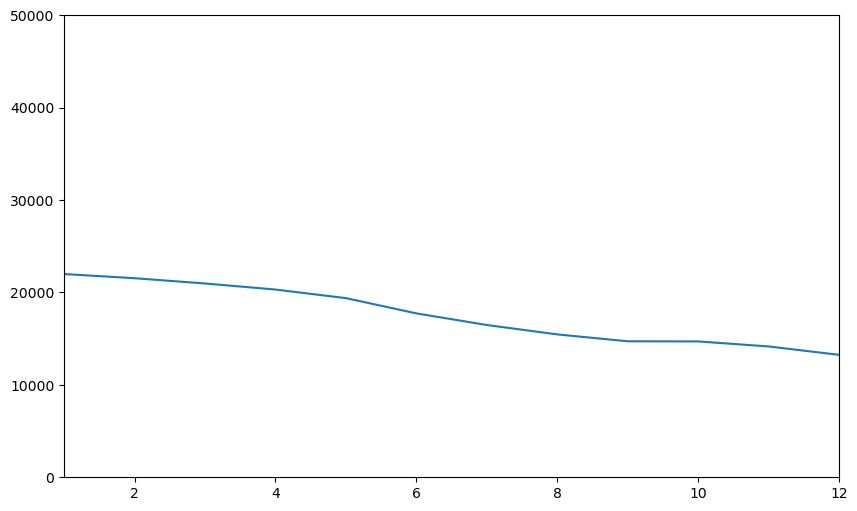

In [157]:
fig, ax = plt.subplots()

ax.plot(c.frequencies, np.mean(c.power().squeeze(), axis=0))

ax.set_xlim(1,12)
ax.set_ylim(0, 50000)

In [131]:
c.time

array([0.])

In [123]:
# Convert LFP to time-series object
T = timeseries.TimeSeries(np_traces, sampling_interval=1./sampling_rate)

In [ ]:
# Compute multi-taper PSD with a larger NW
freqs, psd = multi_taper_psd(T, NW=4, adaptive=True, jackknife=True)

# Plot the result
plt.semilogy(freqs, psd)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (V^2/Hz)')
plt.show()

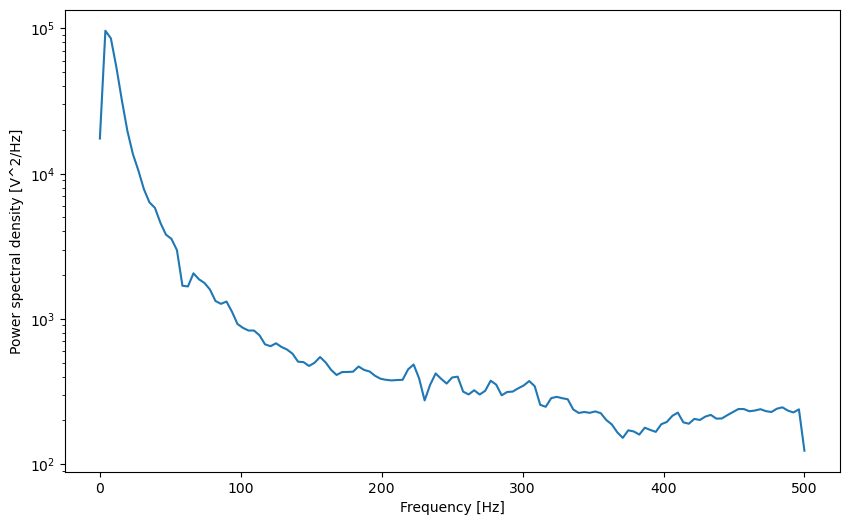

In [115]:
# Assuming `lfp` is your local field potential recording and `fs` is the sampling frequency
# Use Welch's method to estimate the power spectral density
frequencies, power = signal.welch(np_traces, sampling_rate)

# Plot the power spectral density
plt.semilogy(frequencies, power)
plt.xlabel('Frequency [Hz]')
plt.ylabel('Power spectral density [V^2/Hz]')
plt.
plt.show()

In [75]:
from scipy.signal import spectrogram
import matplotlib.pyplot as plt



In [81]:
# Assuming `trial_data` is a 1D numpy array containing the LFP data for one trial

sample_rate = 1000
f, t, Sxx = spectrogram(example_trial, fs=1000)
# f, t, Sxx = spectrogram(example_trial, fs=sample_rate, nperseg=window_size, noverlap=overlap)



# f contains the frequency bins
# t contains the time points
# Sxx contains the spectrogram, which is a 2D array where the element at index [i, j] is the power at frequency f[i] and time t[j]

In [105]:
spectrograms = []
for index, row in tonetime_df[tonetime_df["tone_state"] == 1].iloc[1:-1].iterrows():
    trial_start = row["lfp_index"] - duration * sample_rate
    trial_end = row["lfp_index"] + duration * sample_rate
    f, t, Sxx = spectrogram(np_traces[trial_start: trial_end], fs=1000)
    spectrograms.append(Sxx)

In [106]:
for arr in spectrograms:
    print(arr.shape)

(129, 178)
(129, 178)
(129, 178)
(129, 178)
(129, 178)
(129, 178)
(129, 178)
(129, 178)
(129, 178)
(129, 178)
(129, 178)
(129, 178)
(129, 178)
(129, 178)


In [107]:
# Convert the list into a 3D numpy array
spectrograms = np.array(spectrograms)

In [108]:
# Average the spectrograms over trials
average_spectrogram = np.mean(spectrograms, axis=0)

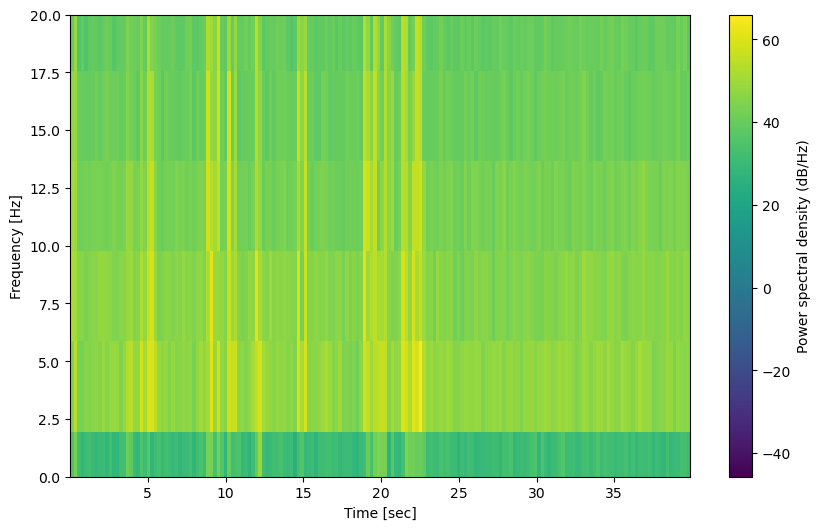

In [113]:
# Display the average spectrogram
cax = plt.pcolormesh(t, f, 10 * np.log10(average_spectrogram))
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [sec]')
plt.ylim(0,20)

cbar = plt.colorbar(cax)
cbar.set_label('Power spectral density (dB/Hz)')
plt.show()

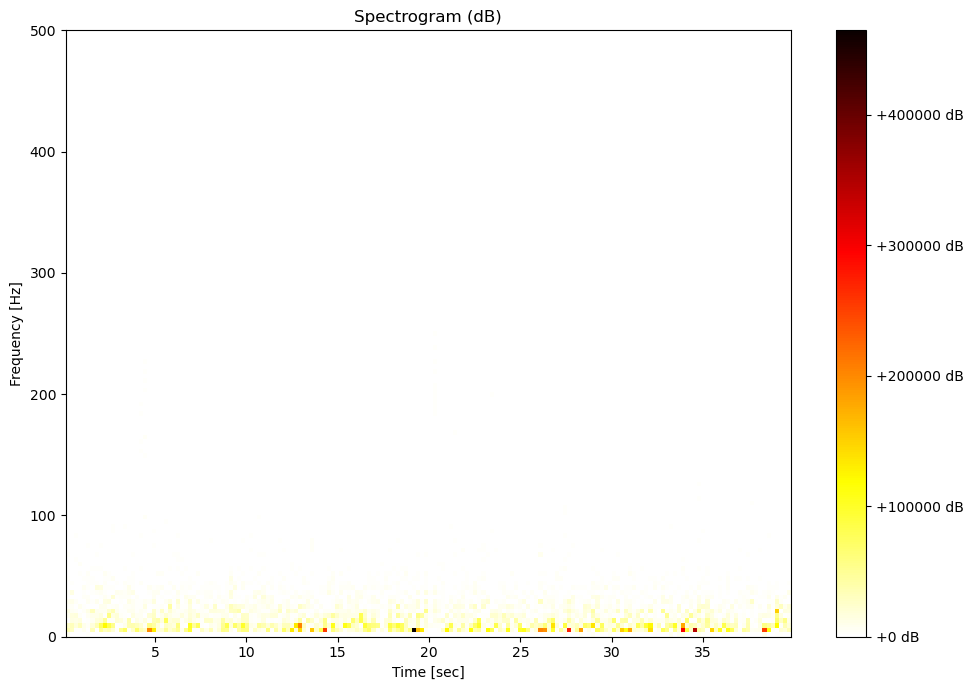

In [82]:
plt.figure(figsize=(10, 7))
plt.imshow(Sxx, aspect='auto', cmap='hot_r', origin='lower', extent=[t.min(), t.max(), f.min(), f.max()])
plt.colorbar(format='%+2.0f dB')
plt.title('Spectrogram (dB)')
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [sec]')
plt.tight_layout()
plt.show()

# TESTING END

- Individual channels

In [36]:
with cp.cuda.Device(0):
    power_issue_files = []
    for lfp_filepath, channel in itertools.product(lfp_array_filepath_glob, all_channels):
        print("LFP File Path: {}".format(lfp_filepath)) 
        print("Channel: {}".format(channel))
        try:
            recording_basename = os.path.basename(os.path.dirname(lfp_filepath))
            parent_output_directory = os.path.dirname(lfp_filepath)

            # Loading in LFP array
            lfp_array = np.load(lfp_filepath)
            # Cutting the LFP array to reduce on the memory usage
            lfp_array = lfp_array[int(lfp_array.shape[0]*first_proportion):int(lfp_array.shape[0]*second_proportion), channel]
            lfp_array = lfp_array*10**-3
            print(lfp_array.shape)
            print("calculating multitaper")
            # Compute multitaper spectral estimate
            m = Multitaper(time_halfbandwidth_product=time_halfbandwidth_product, time_series=lfp_array, \
                           sampling_frequency=resampled_frequency, time_window_duration=time_window_duration, \
                           time_window_step=time_window_step, n_fft_samples=2048)

            print("calculating connectivity")
            # Sets up computing connectivity measures/power from multitaper spectral estimate
            c = Connectivity.from_multitaper(m, blocks=blocks)

            # Saving to file
            frequencies_filename = "{}_thp_{}_twd_{}_ch_{}.frequencies.npy".format(recording_basename, time_halfbandwidth_product, time_window_duration, channel)
            power_filename = "{}_thp_{}_twd_{}_ch_{}.power.npy".format(recording_basename, time_halfbandwidth_product, time_window_duration, channel)
            
            np.save(file=os.path.join(parent_output_directory, frequencies_filename), arr=c.frequencies)
            np.save(file=os.path.join(parent_output_directory, power_filename), arr=c.power().squeeze())

        except Exception as e: 
            print(e)
            power_issue_files.append((lfp_filepath, channel))

LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 15
(1599198,)
calculating multitaper
calculating connectivity
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 16
(1599198,)
calculating multitaper
calculating connectivity
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 21
(1599198,

- All channels

- Original Code

## Plotting to look

In [37]:
all_prefixes = ["20221122_164720_competition", "20221122_161341_omission", "20221125_144832_omission", "20221125_152723_competition"]

13
14
15
16
21
20221122_164720_competition_6_1_top_3__base_3_merged_thp_10_twd_10.png


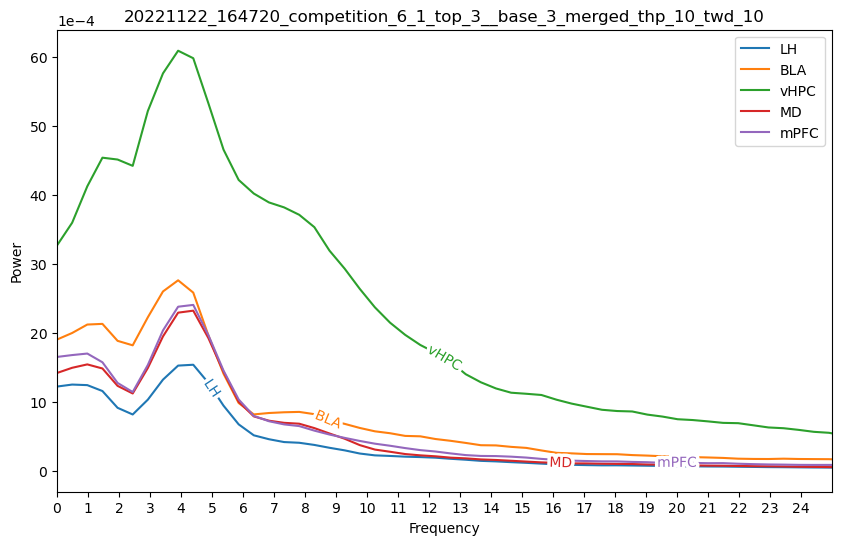

13
14
15
16
21
20221122_161341_omission_subject_6_1_top_4_base_2_thp_10_twd_10.png


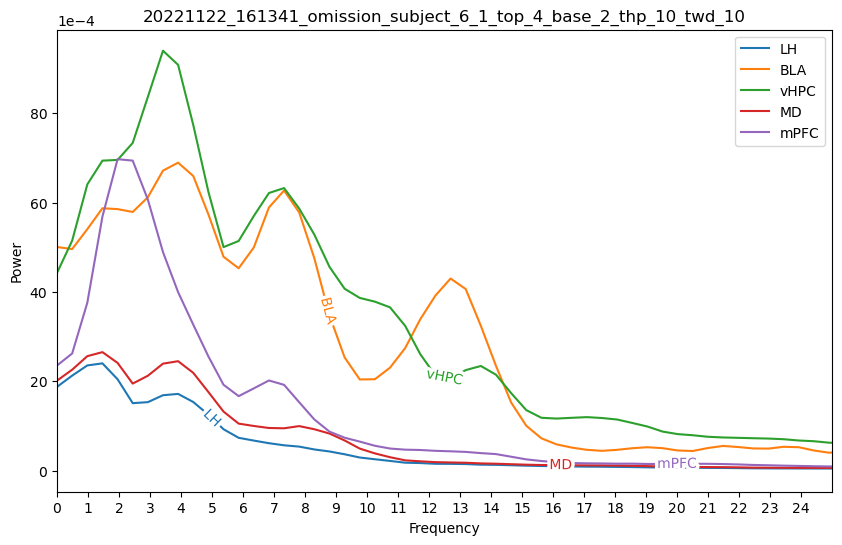

13
14
15
16
21
20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_10_twd_10.png


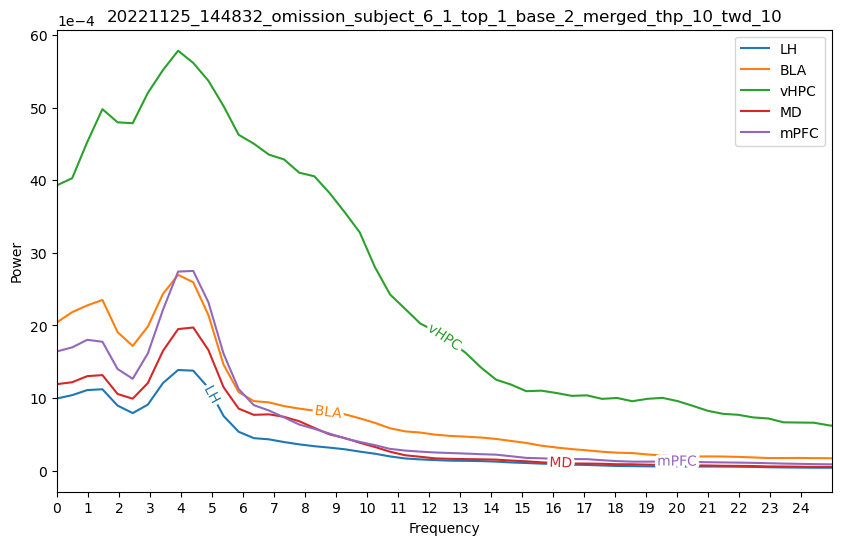

13
14
15
16
21
20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_10.png


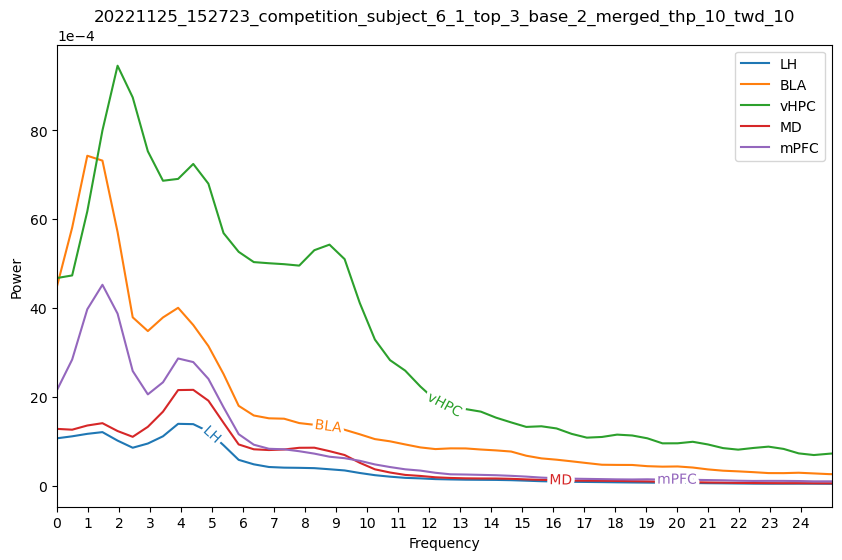

In [39]:
for prefix in all_prefixes:
    freq_array_filepath_glob = sorted(glob.glob("./proc/*/{}*thp_{}_*twd_{}*frequencies.npy".format(prefix, time_halfbandwidth_product, time_window_duration), recursive=True))
    power_array_filepath_glob = sorted(glob.glob("./proc/*/{}*thp_{}_*twd_{}*power.npy".format(prefix, time_halfbandwidth_product, time_window_duration), recursive=True))
    
    fig, ax = plt.subplots()
    ax.set_xlabel("Frequency")
    ax.set_ylabel("Power")

    for freq_array_path, power_array_path in zip(freq_array_filepath_glob, power_array_filepath_glob):
        output_dir_path = os.path.dirname(freq_array_path)
        channel = freq_array_path.split("ch_")[1].split(".")[0]
        print(channel)
        freq_array = np.load(freq_array_path)
        power_array = np.load(power_array_path)


        ax.plot(freq_array, np.mean(power_array, axis=0), label=channel_brain_region[channel])


    freq_start = 0
    freq_end = 25
    ax.set_xlim(freq_start, freq_end)
#     ax.set_ylim(0, 10e-4)
    plt.xticks(np.arange(freq_start, freq_end, 1.0))

    plt.ticklabel_format(axis='y', style='sci', scilimits=(-4,-4))
    ax.legend()
    labelLines(ax.get_lines(), zorder=2.5)   

    lfp_basename = os.path.basename(freq_array_path).split(".")[0]
    lfp_basename = lfp_basename.split("_ch")[0]

    plt.title("{}".format(lfp_basename))
    plt_file_name = "{}.png".format(lfp_basename)
    print(plt_file_name)
    plt.savefig(os.path.join(output_dir_path, plt_file_name))
    plt.show()

## Doing it will all combinations

In [41]:
all_param_numbers = [1, 2, 3, 5, 7, 10]

In [42]:
tws_ratio = 0.9

In [32]:
time_halfbandwidth_product = 10
blocks = 5

In [33]:
time_window_duration = 10

In [34]:
time_window_step = time_window_duration * 0.9

In [35]:
first_proportion = 0
second_proportion = 1

time_halfbandwidth_product: 1, time_window_duration: 1,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_1_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_1_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_1_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_1_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

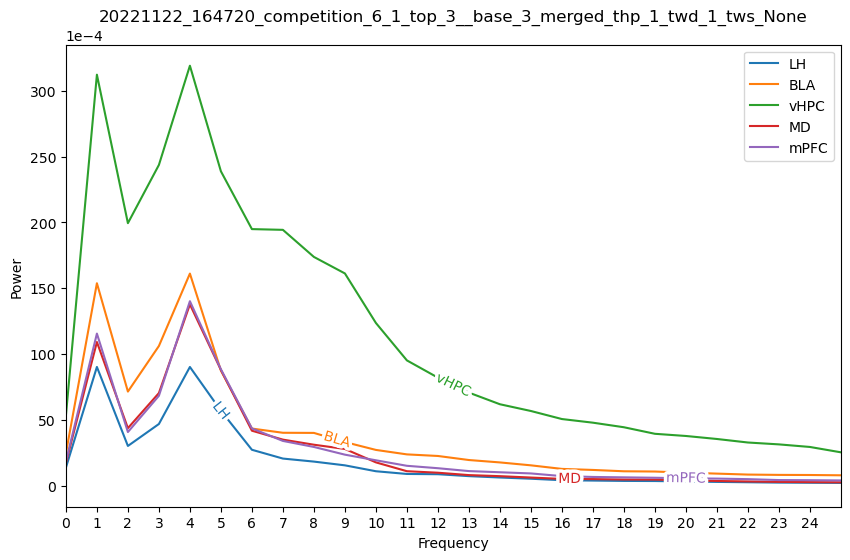

20221122_161341_omission_subject_6_1_top_4_base_2_thp_1_twd_1_tws_None.png


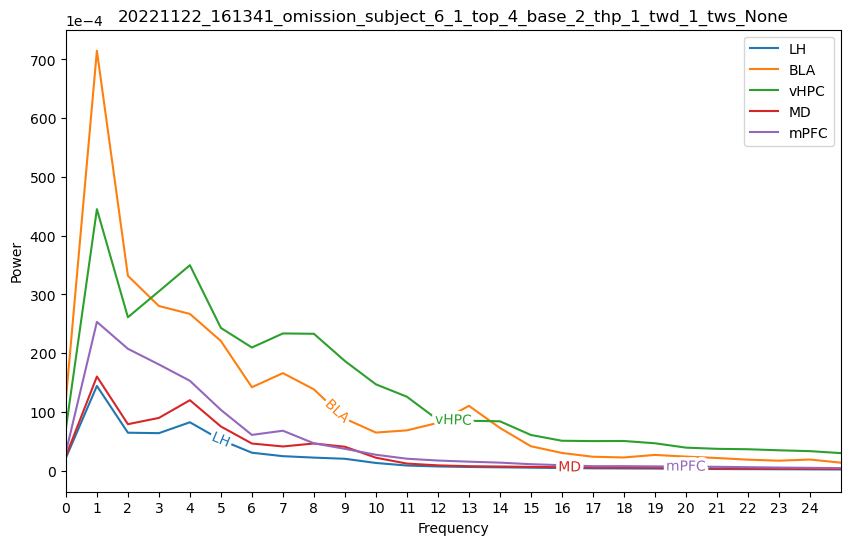

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_1_twd_1_tws_None.png


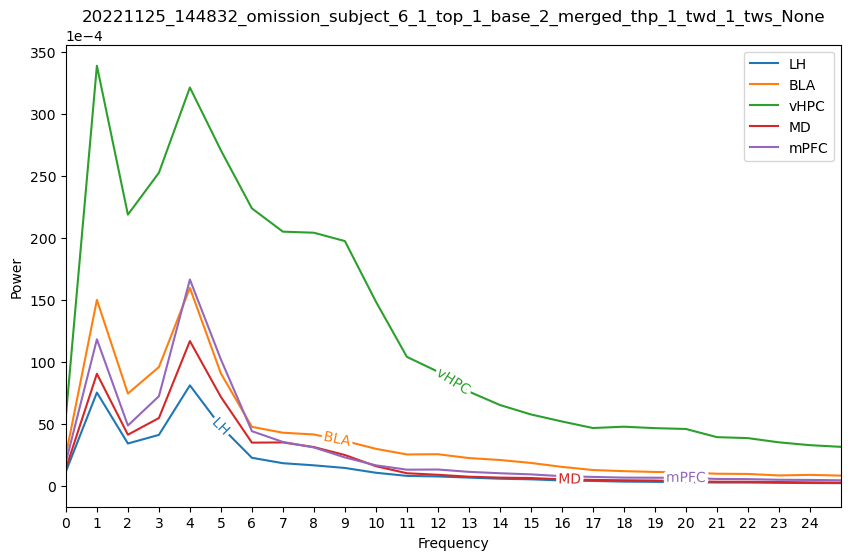

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_1_twd_1_tws_None.png


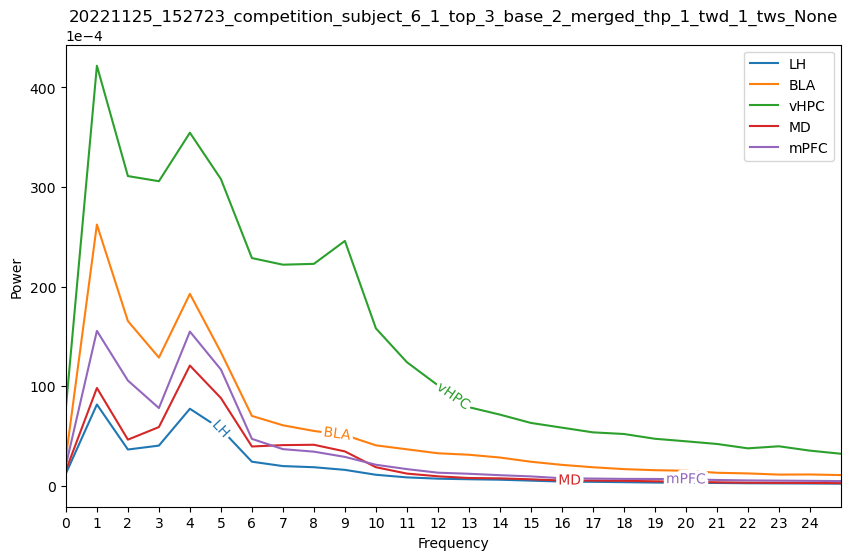

time_halfbandwidth_product: 1, time_window_duration: 1,         tws_ratio: 0.5, time_window_step 0.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_1_tws_0.5_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_1_tws_0.5_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_1_tws_0.5_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_1_tws_0.5_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

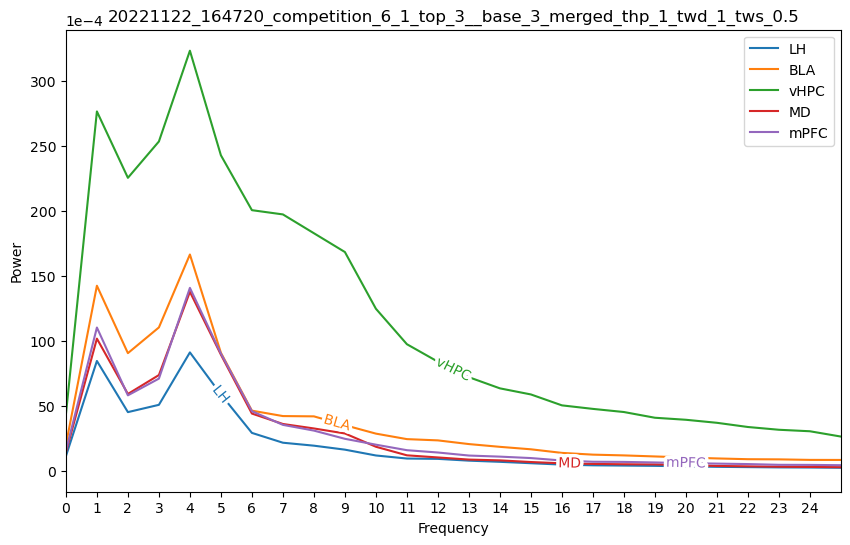

20221122_161341_omission_subject_6_1_top_4_base_2_thp_1_twd_1_tws_0.5.png


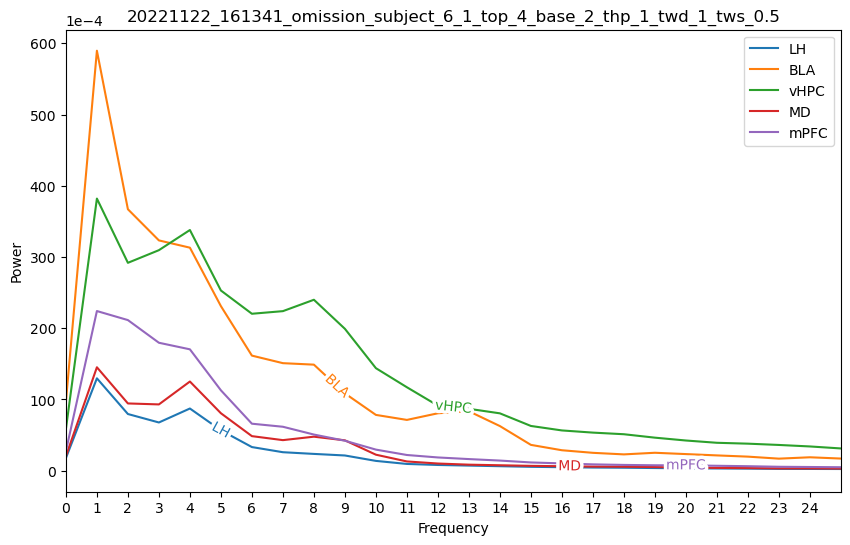

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_1_twd_1_tws_0.5.png


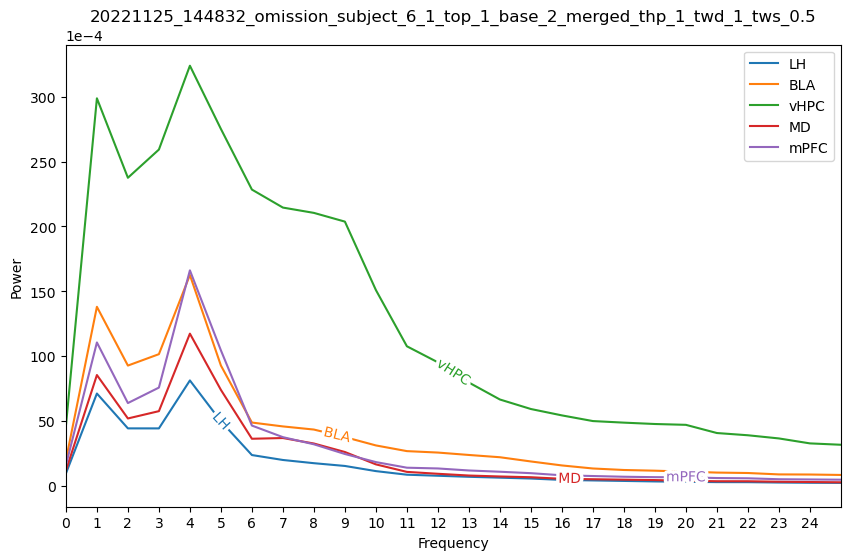

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_1_twd_1_tws_0.5.png


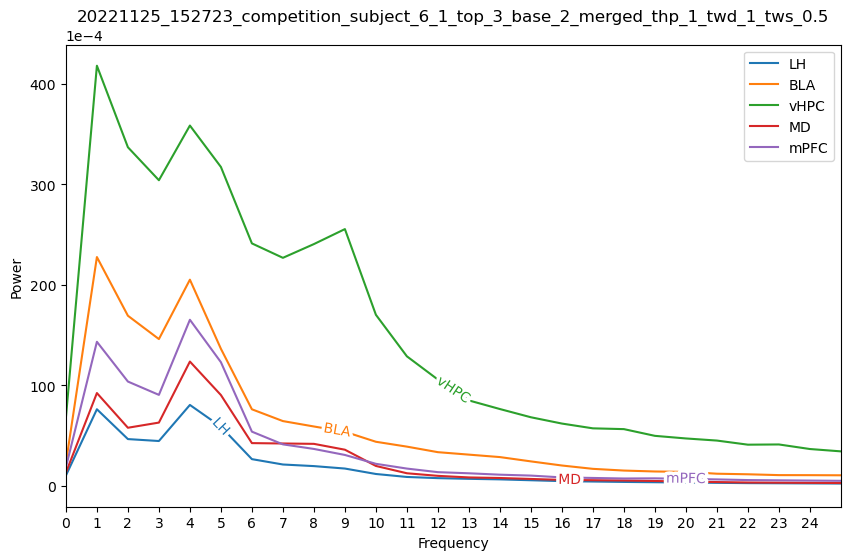

time_halfbandwidth_product: 1, time_window_duration: 1,         tws_ratio: 0.9, time_window_step 0.9
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_1_tws_0.9_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_1_tws_0.9_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_1_tws_0.9_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_1_tws_0.9_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

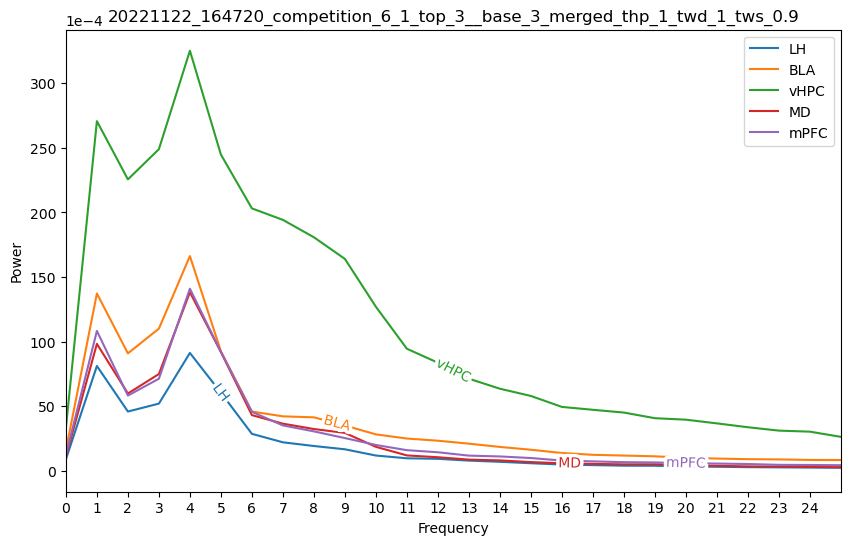

20221122_161341_omission_subject_6_1_top_4_base_2_thp_1_twd_1_tws_0.9.png


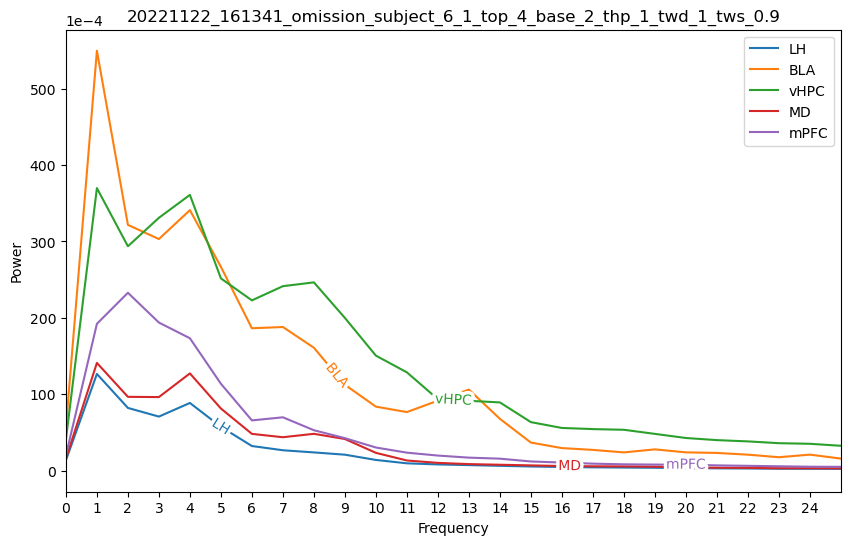

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_1_twd_1_tws_0.9.png


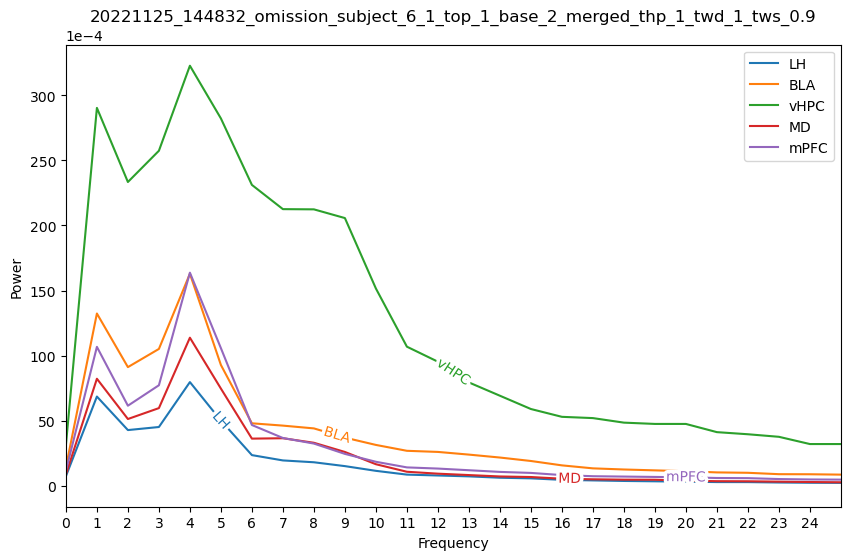

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_1_twd_1_tws_0.9.png


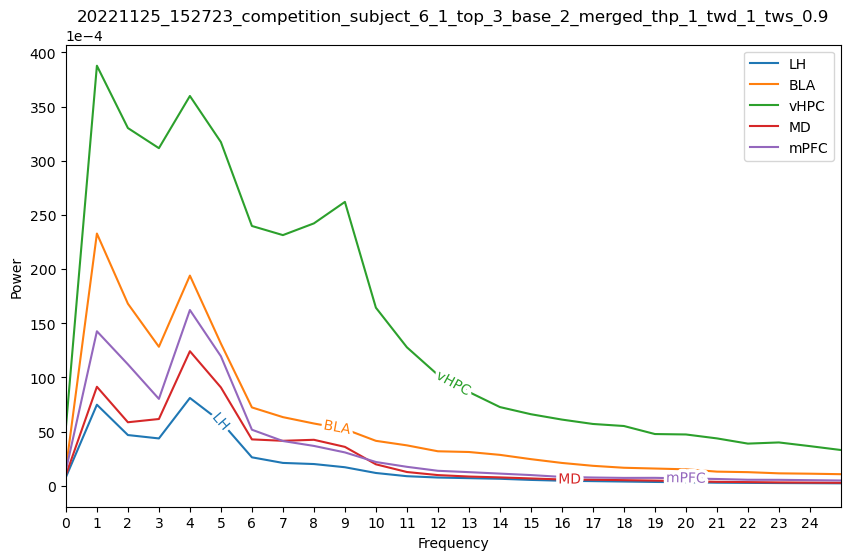

time_halfbandwidth_product: 1, time_window_duration: 2,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_2_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_2_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_2_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_2_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

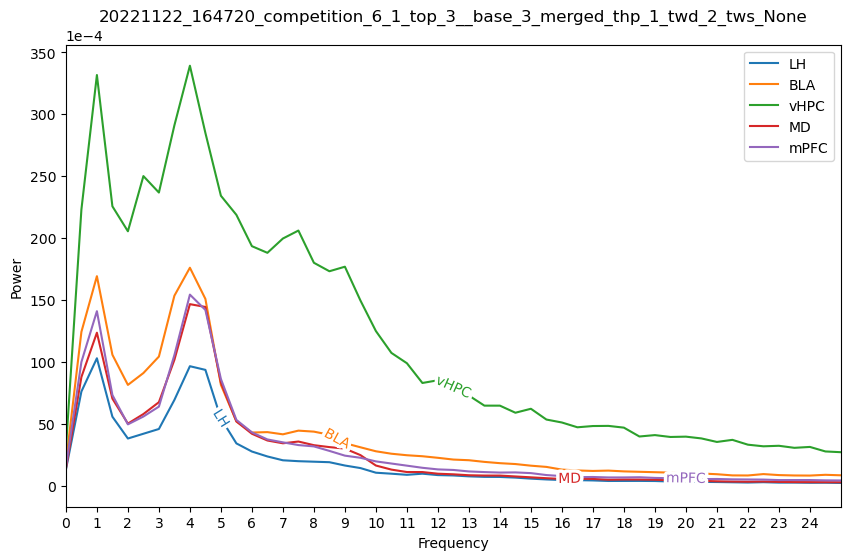

20221122_161341_omission_subject_6_1_top_4_base_2_thp_1_twd_2_tws_None.png


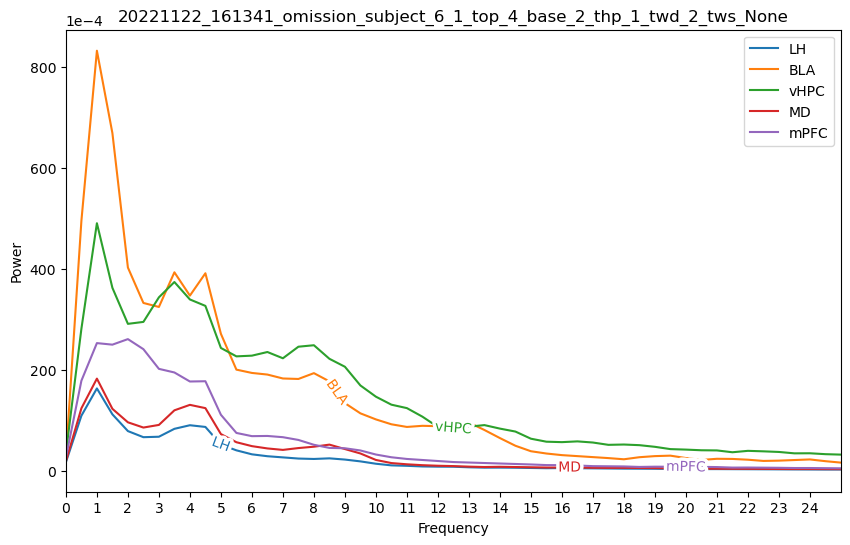

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_1_twd_2_tws_None.png


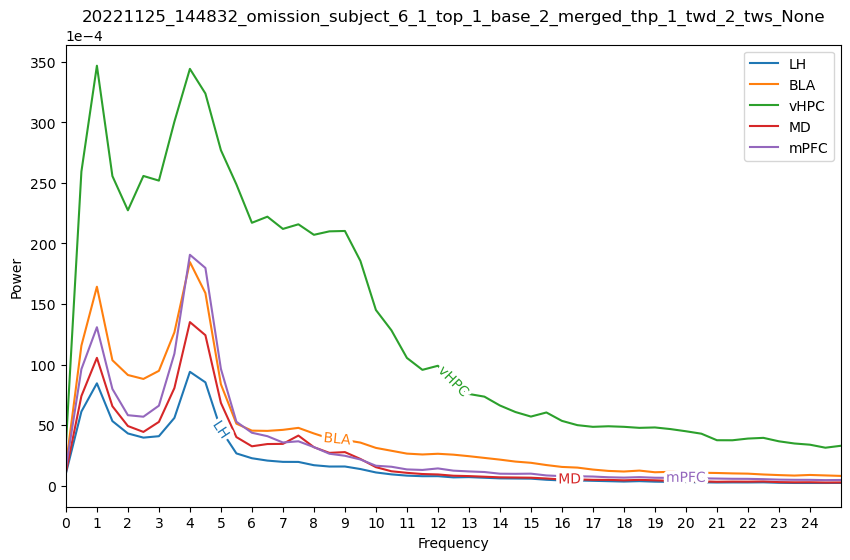

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_1_twd_2_tws_None.png


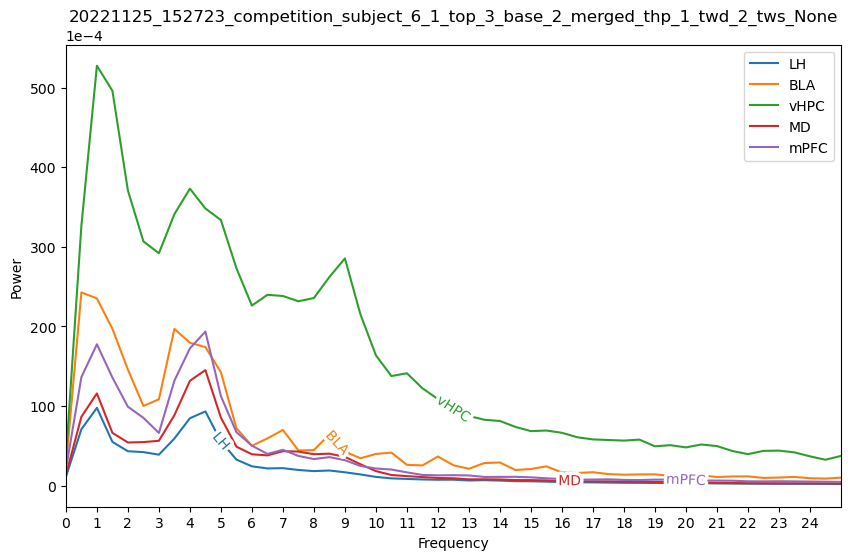

time_halfbandwidth_product: 1, time_window_duration: 2,         tws_ratio: 0.5, time_window_step 1.0
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_2_tws_1.0_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_2_tws_1.0_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_2_tws_1.0_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_2_tws_1.0_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

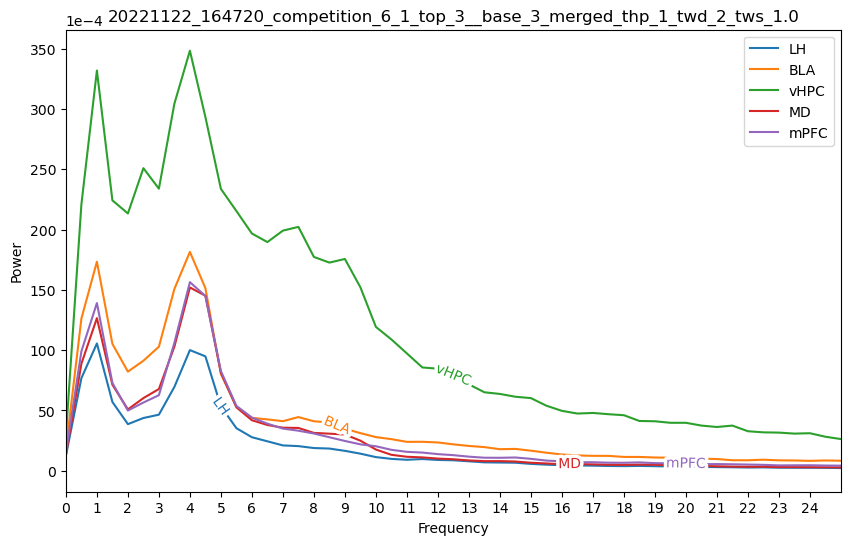

20221122_161341_omission_subject_6_1_top_4_base_2_thp_1_twd_2_tws_1.0.png


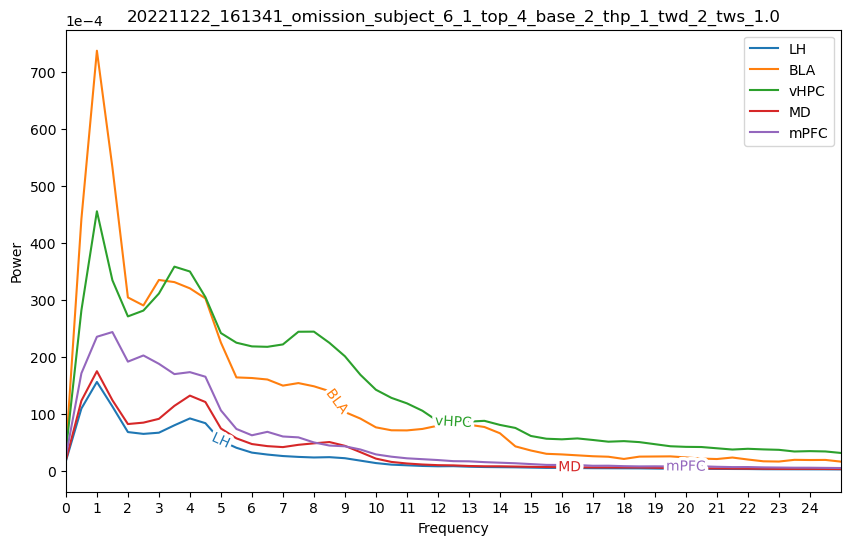

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_1_twd_2_tws_1.0.png


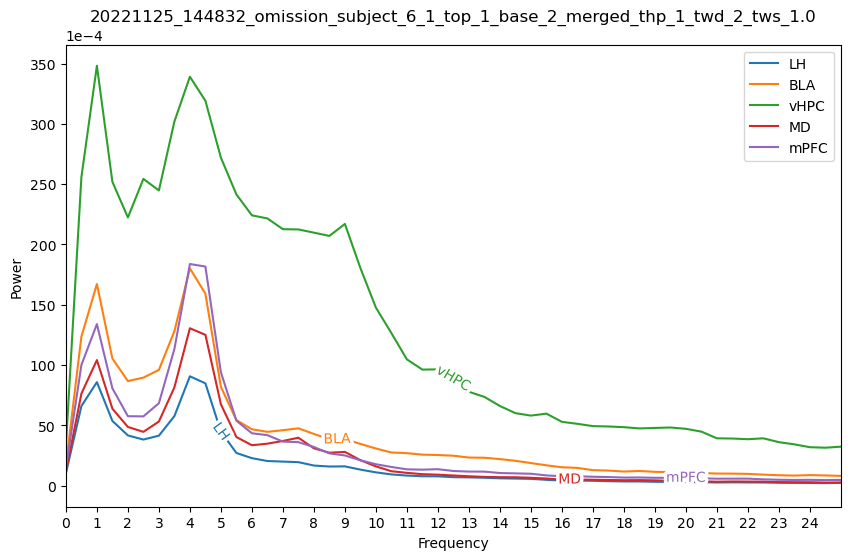

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_1_twd_2_tws_1.0.png


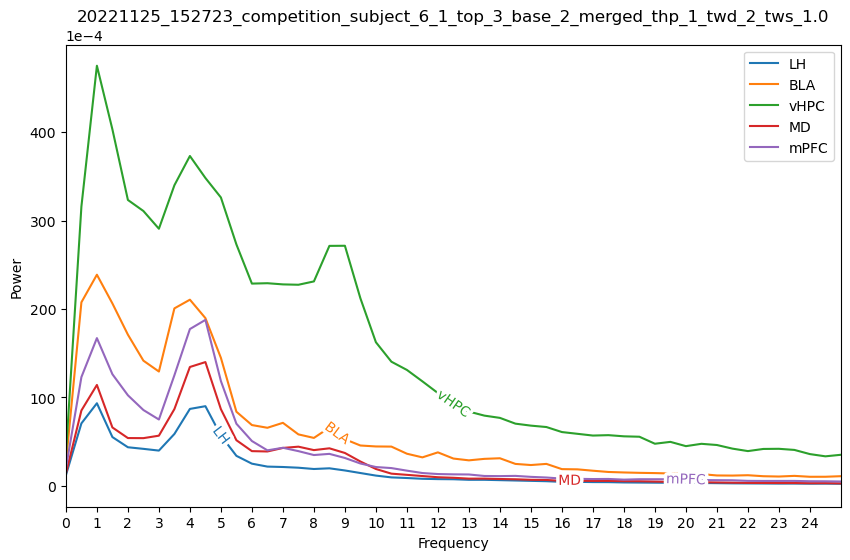

time_halfbandwidth_product: 1, time_window_duration: 2,         tws_ratio: 0.9, time_window_step 1.8
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_2_tws_1.8_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_2_tws_1.8_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_2_tws_1.8_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_2_tws_1.8_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

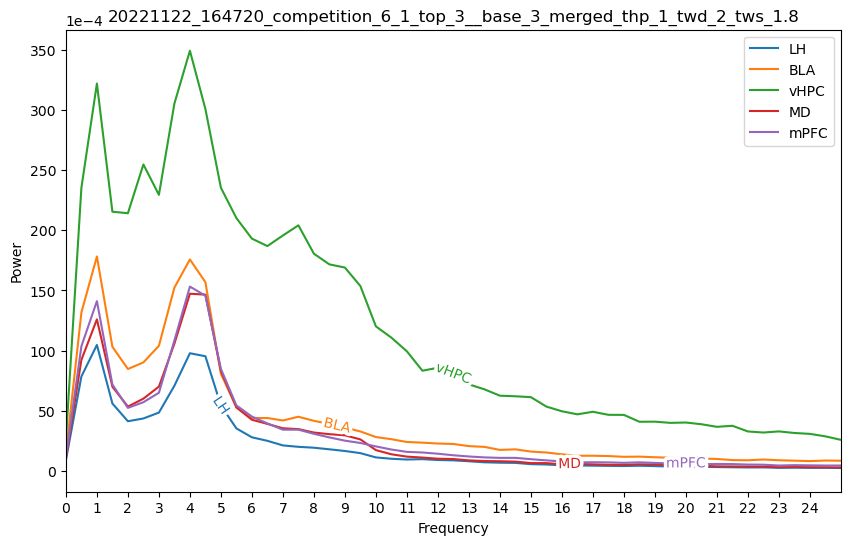

20221122_161341_omission_subject_6_1_top_4_base_2_thp_1_twd_2_tws_1.8.png


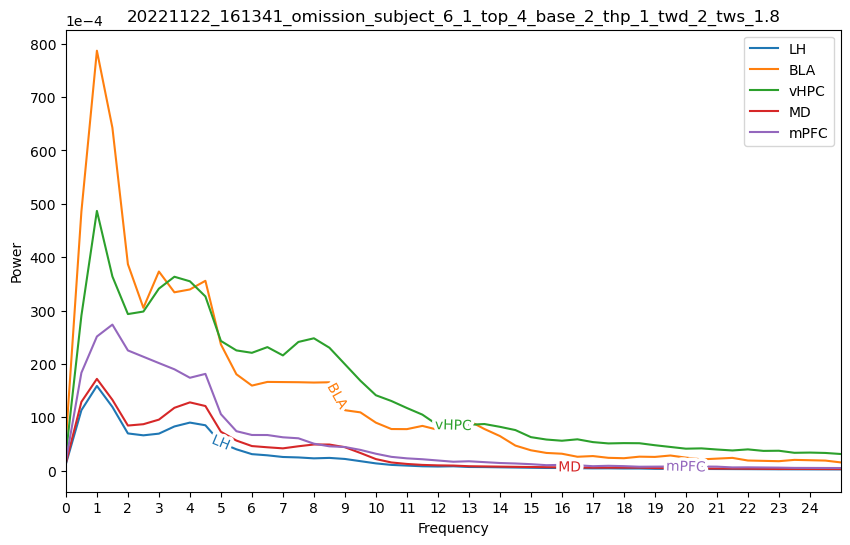

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_1_twd_2_tws_1.8.png


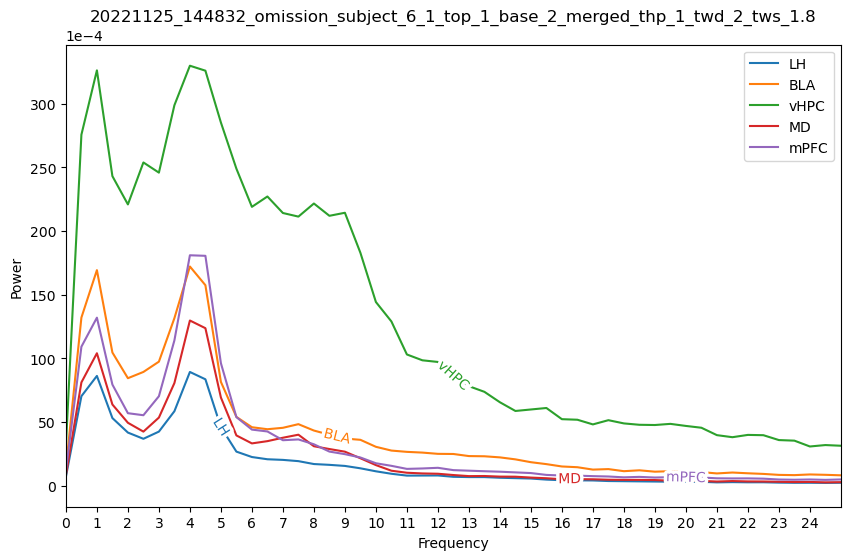

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_1_twd_2_tws_1.8.png


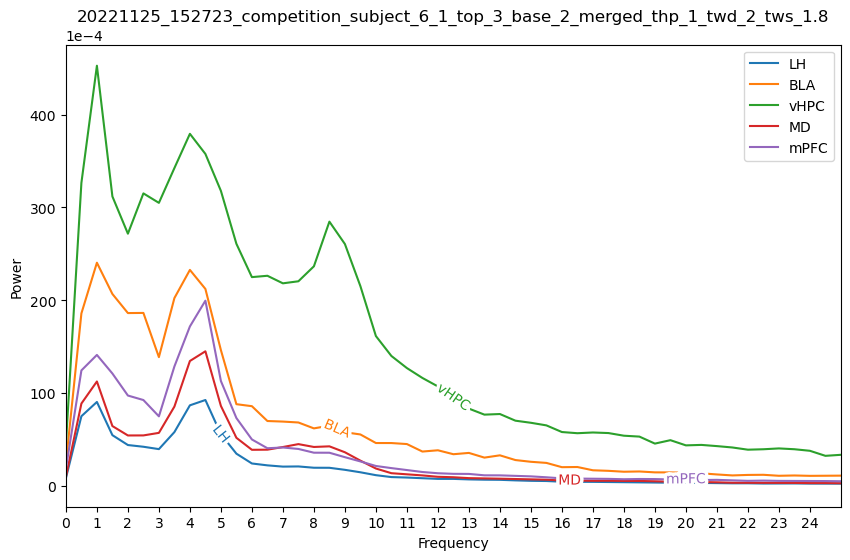

time_halfbandwidth_product: 1, time_window_duration: 3,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_3_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_3_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_3_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_3_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

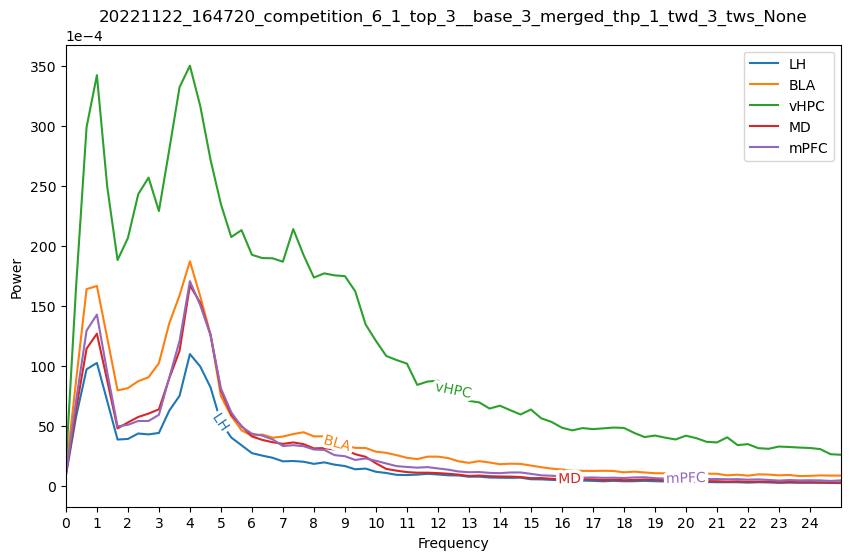

20221122_161341_omission_subject_6_1_top_4_base_2_thp_1_twd_3_tws_None.png


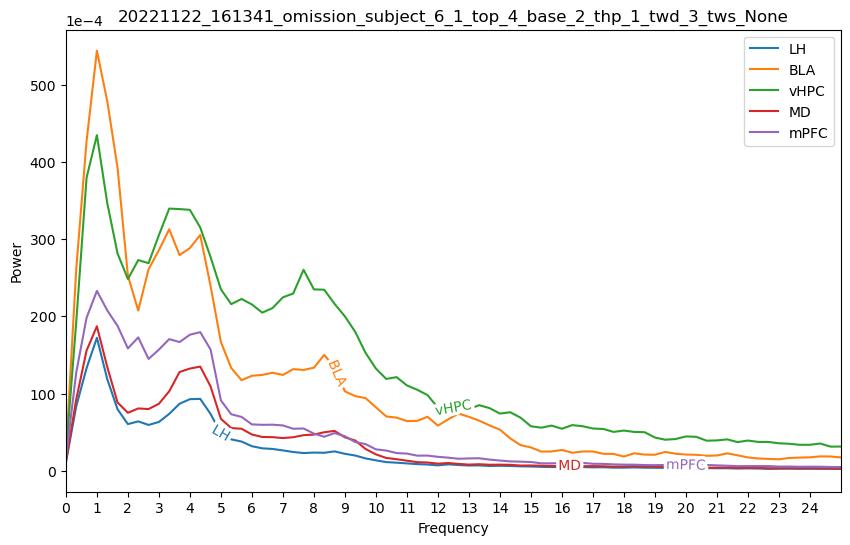

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_1_twd_3_tws_None.png


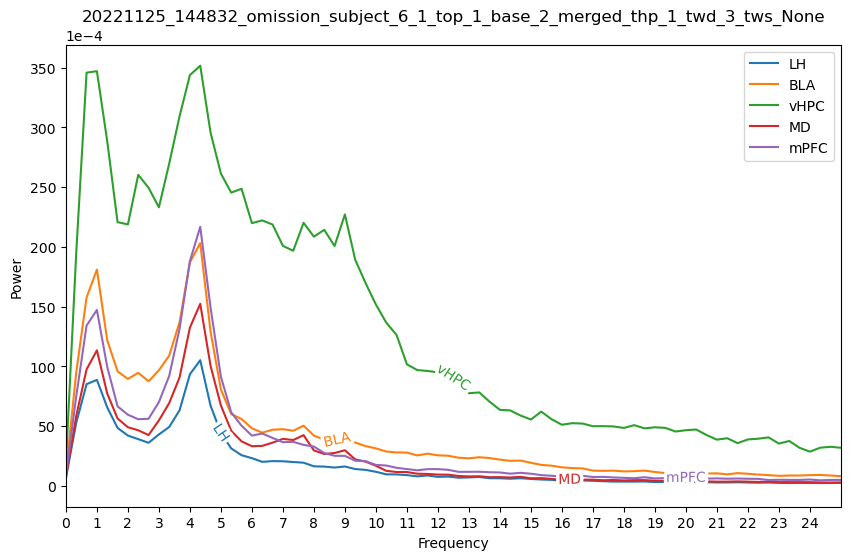

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_1_twd_3_tws_None.png


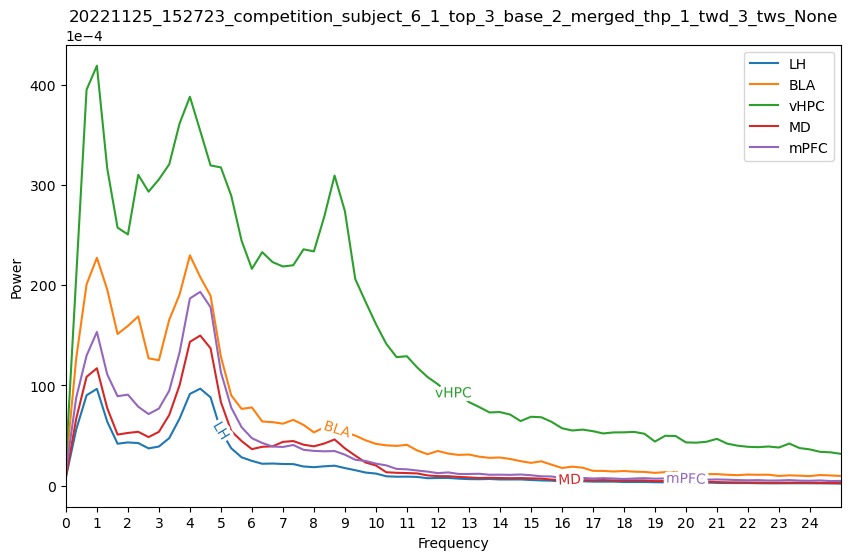

time_halfbandwidth_product: 1, time_window_duration: 3,         tws_ratio: 0.5, time_window_step 1.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_3_tws_1.5_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_3_tws_1.5_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_3_tws_1.5_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_3_tws_1.5_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

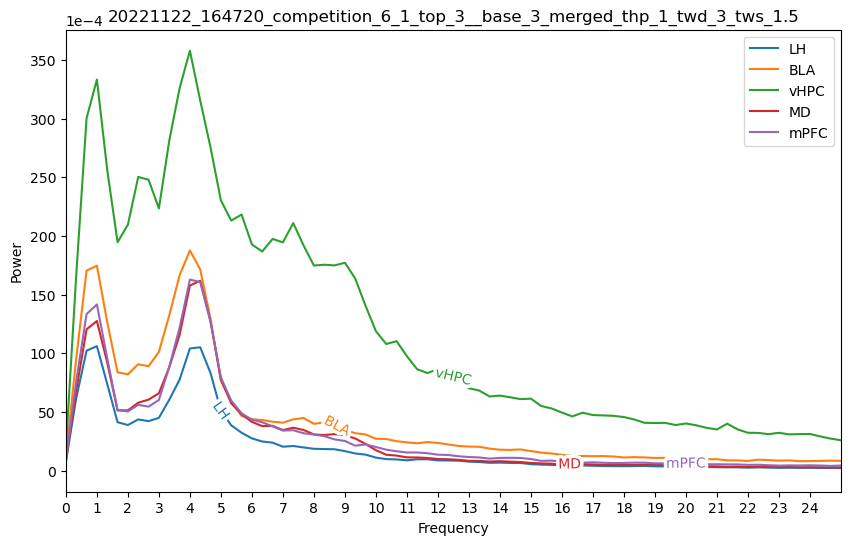

20221122_161341_omission_subject_6_1_top_4_base_2_thp_1_twd_3_tws_1.5.png


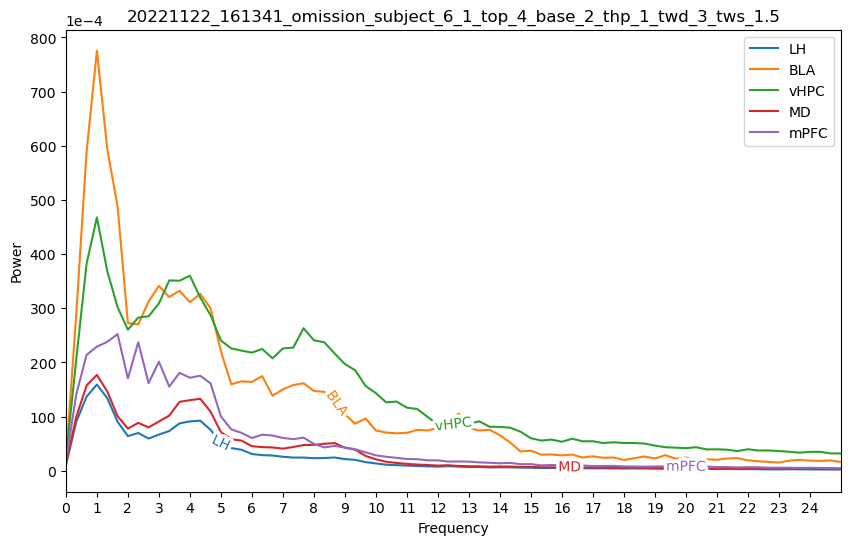

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_1_twd_3_tws_1.5.png


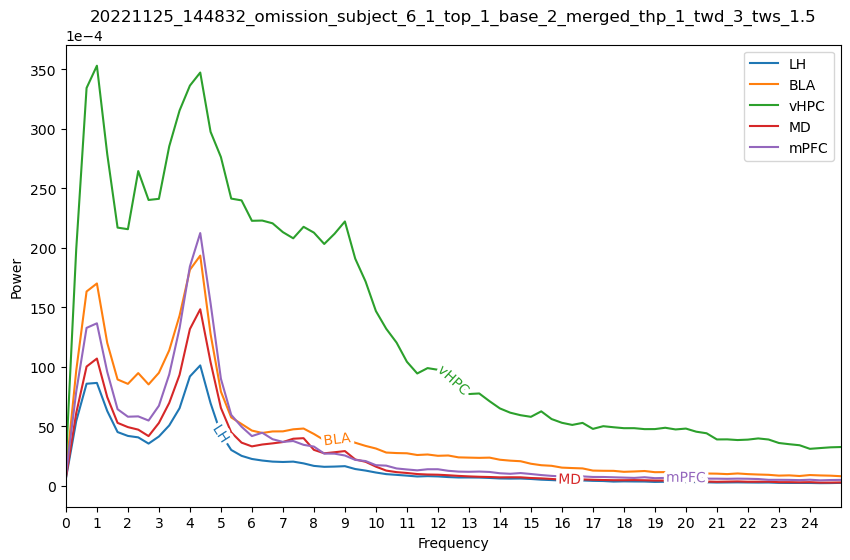

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_1_twd_3_tws_1.5.png


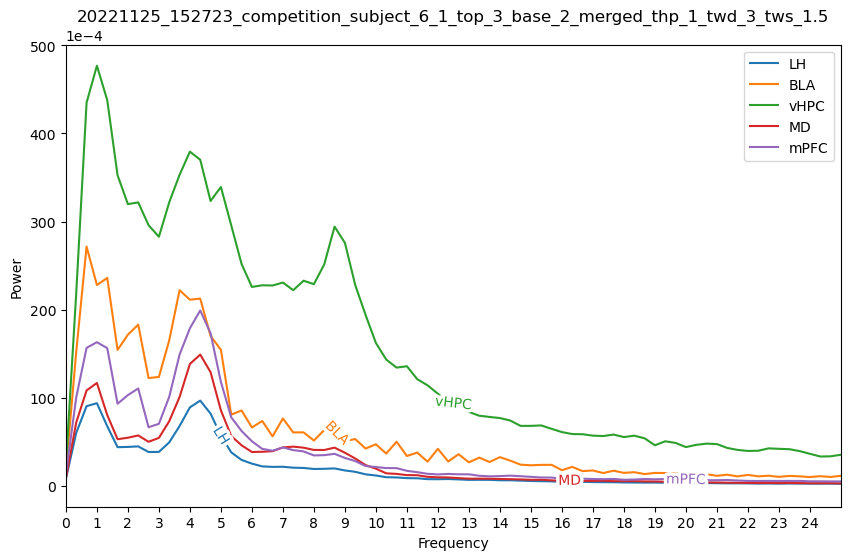

time_halfbandwidth_product: 1, time_window_duration: 3,         tws_ratio: 0.9, time_window_step 2.7
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_3_tws_2.7_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_3_tws_2.7_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_3_tws_2.7_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_3_tws_2.7_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

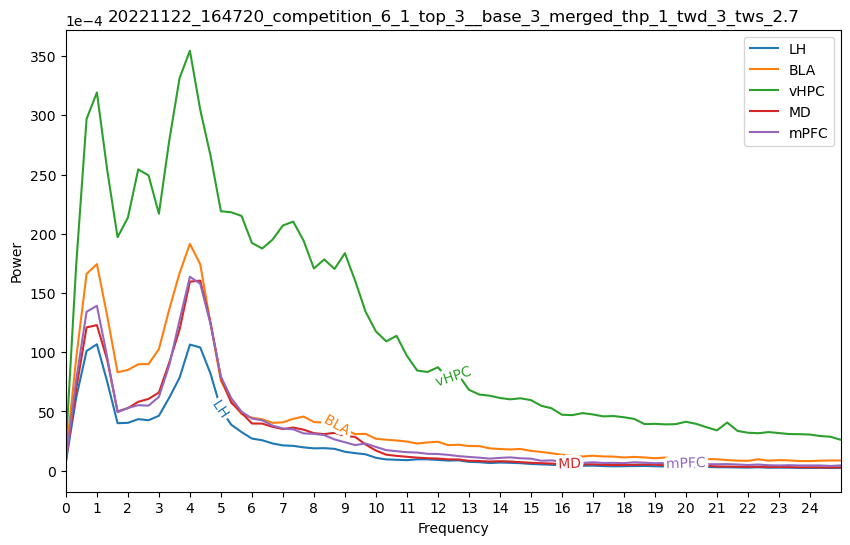

20221122_161341_omission_subject_6_1_top_4_base_2_thp_1_twd_3_tws_2.7.png


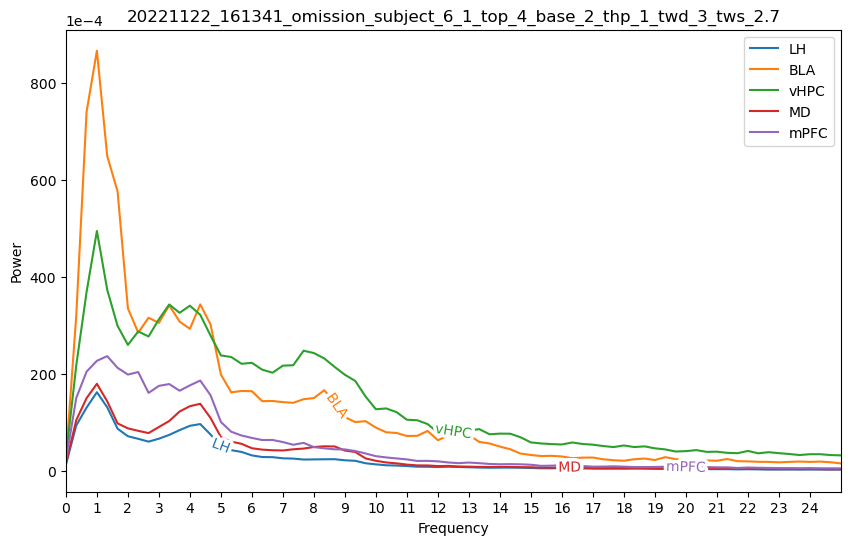

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_1_twd_3_tws_2.7.png


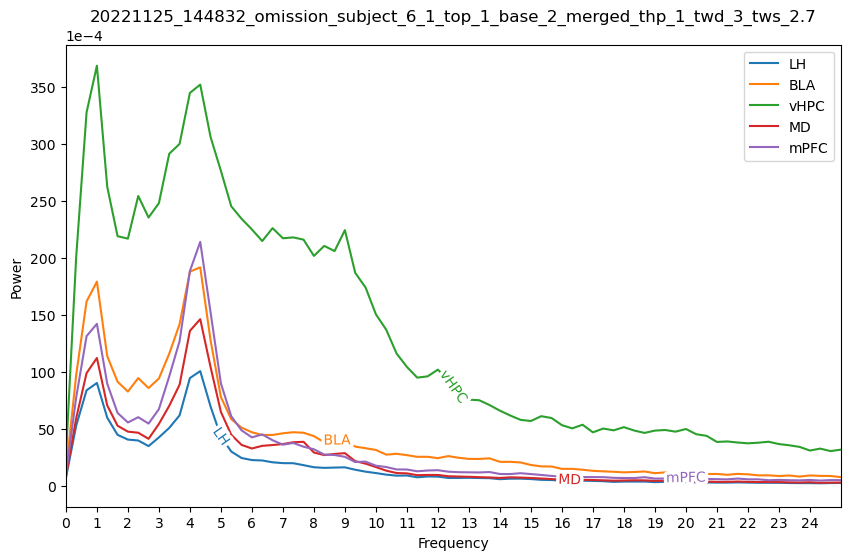

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_1_twd_3_tws_2.7.png


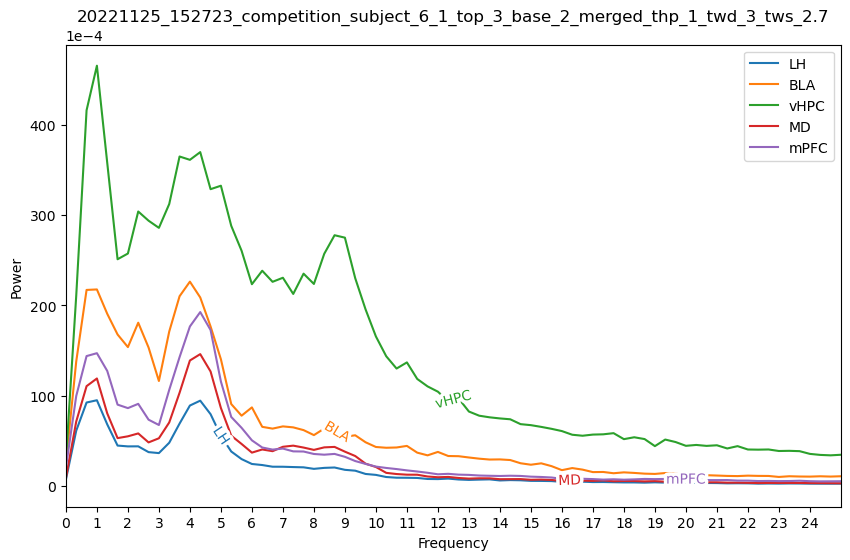

time_halfbandwidth_product: 1, time_window_duration: 5,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_5_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_5_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_5_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_5_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

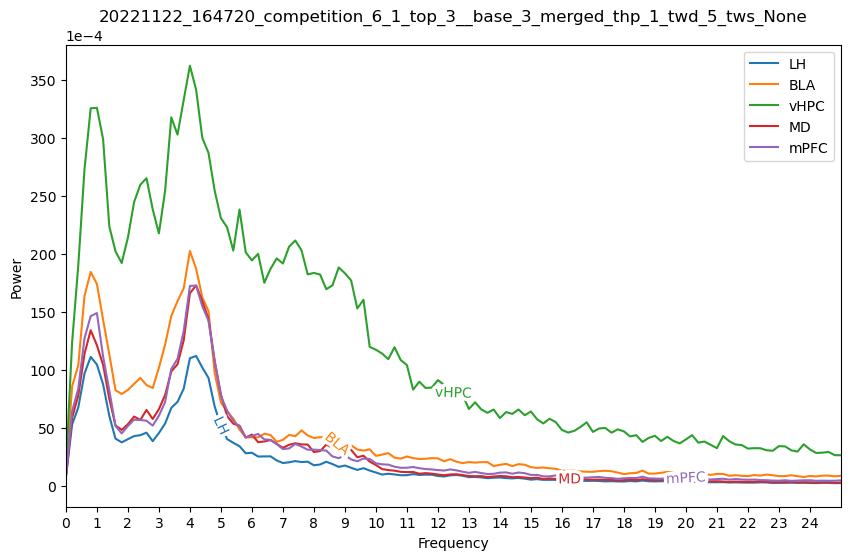

20221122_161341_omission_subject_6_1_top_4_base_2_thp_1_twd_5_tws_None.png


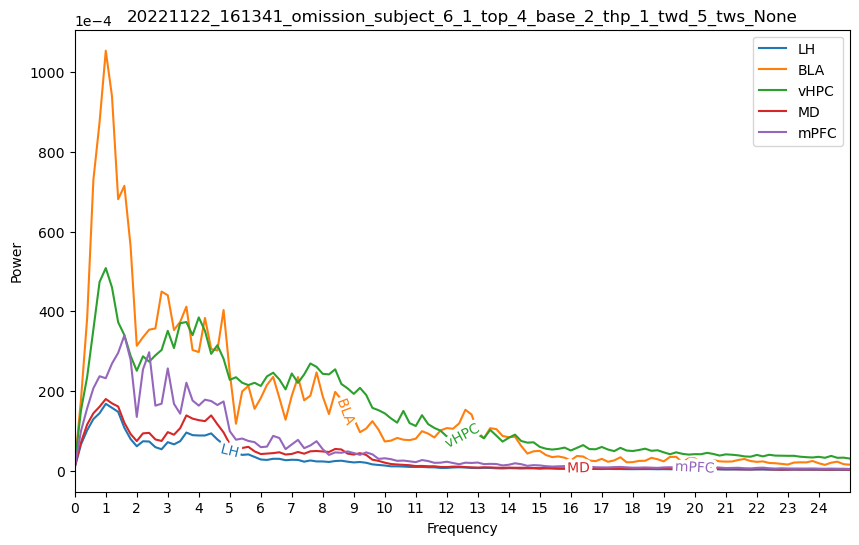

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_1_twd_5_tws_None.png


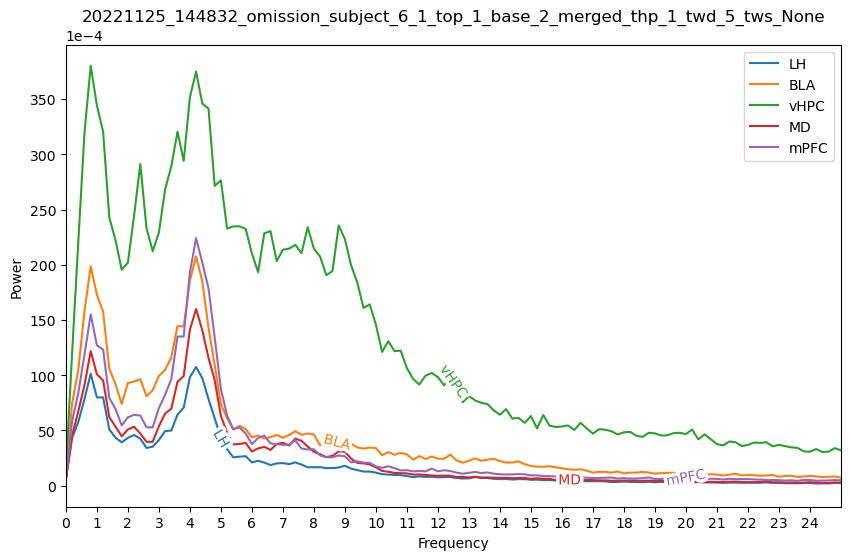

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_1_twd_5_tws_None.png


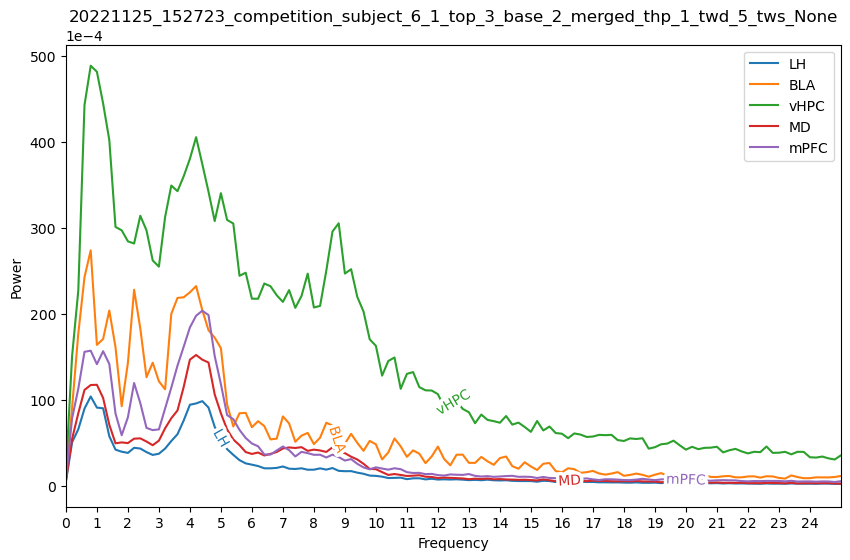

time_halfbandwidth_product: 1, time_window_duration: 5,         tws_ratio: 0.5, time_window_step 2.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_5_tws_2.5_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_5_tws_2.5_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_5_tws_2.5_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_5_tws_2.5_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

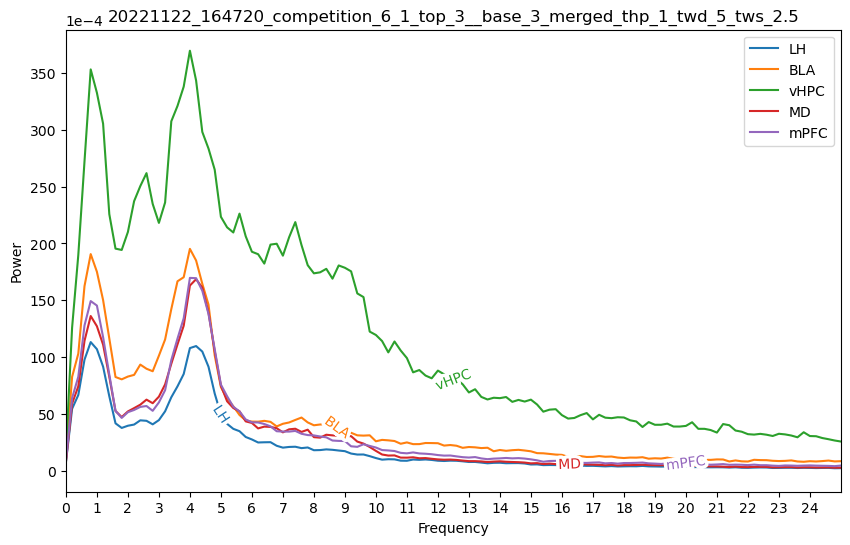

20221122_161341_omission_subject_6_1_top_4_base_2_thp_1_twd_5_tws_2.5.png


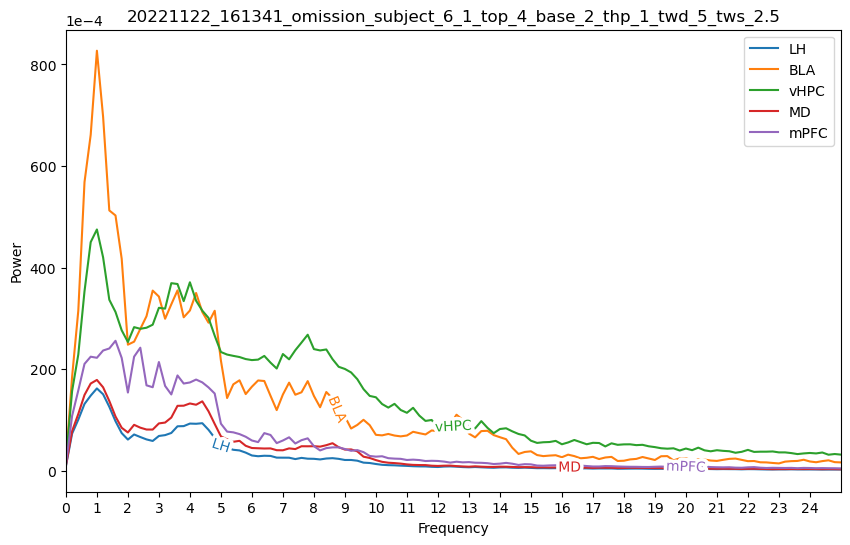

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_1_twd_5_tws_2.5.png


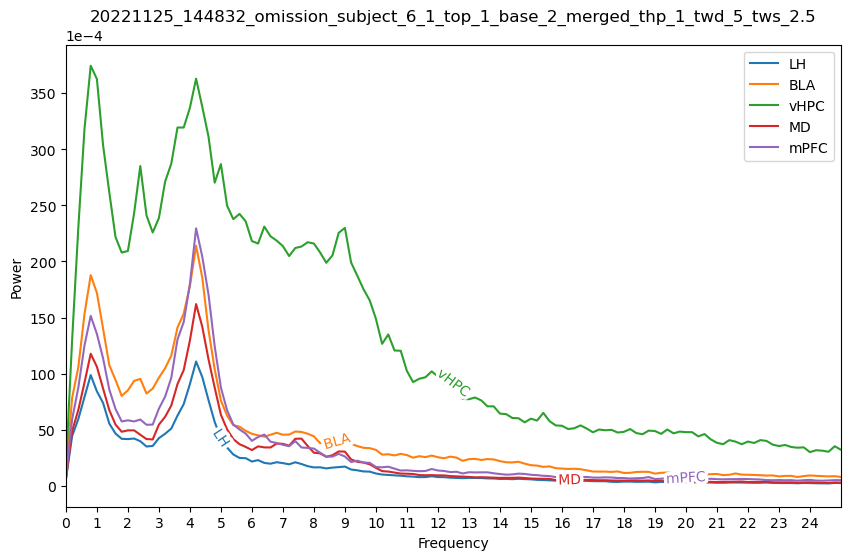

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_1_twd_5_tws_2.5.png


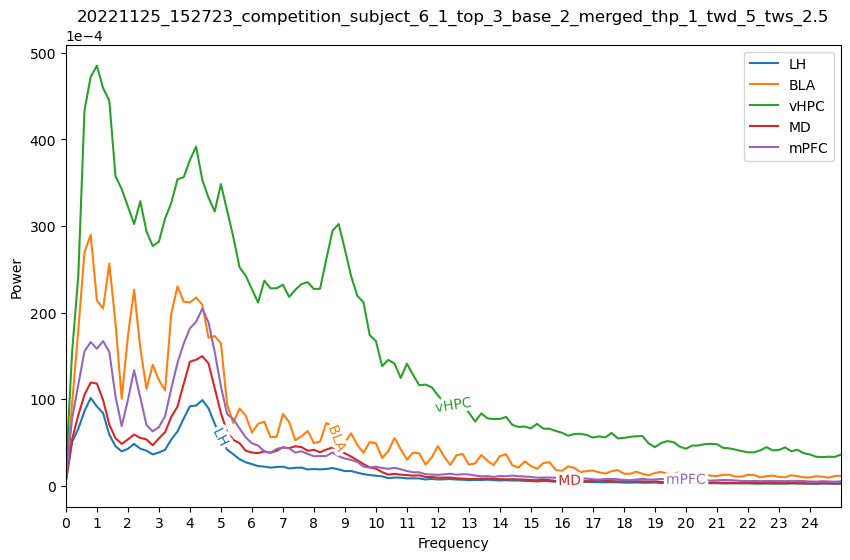

time_halfbandwidth_product: 1, time_window_duration: 5,         tws_ratio: 0.9, time_window_step 4.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_5_tws_4.5_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_5_tws_4.5_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_5_tws_4.5_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_5_tws_4.5_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

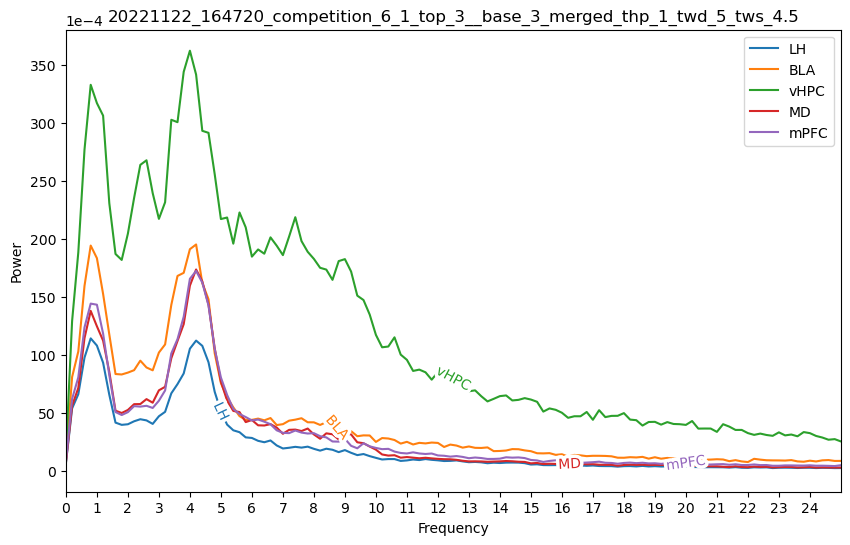

20221122_161341_omission_subject_6_1_top_4_base_2_thp_1_twd_5_tws_4.5.png


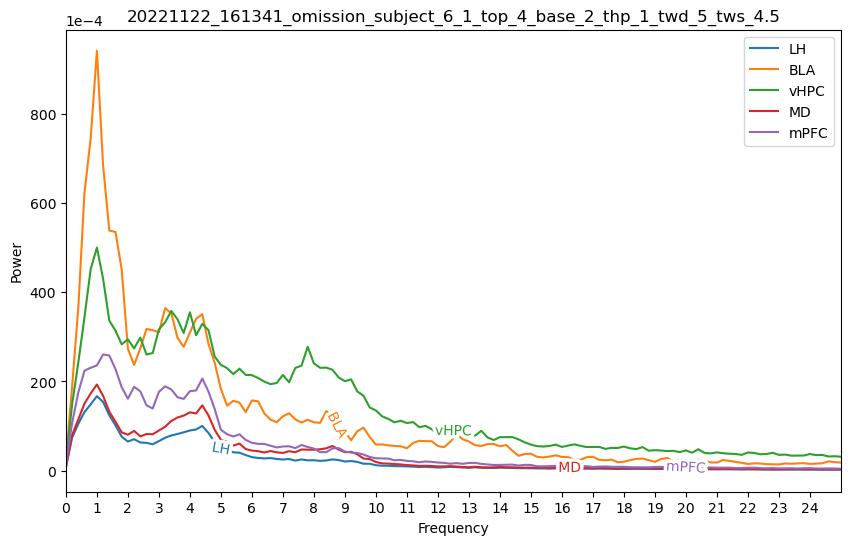

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_1_twd_5_tws_4.5.png


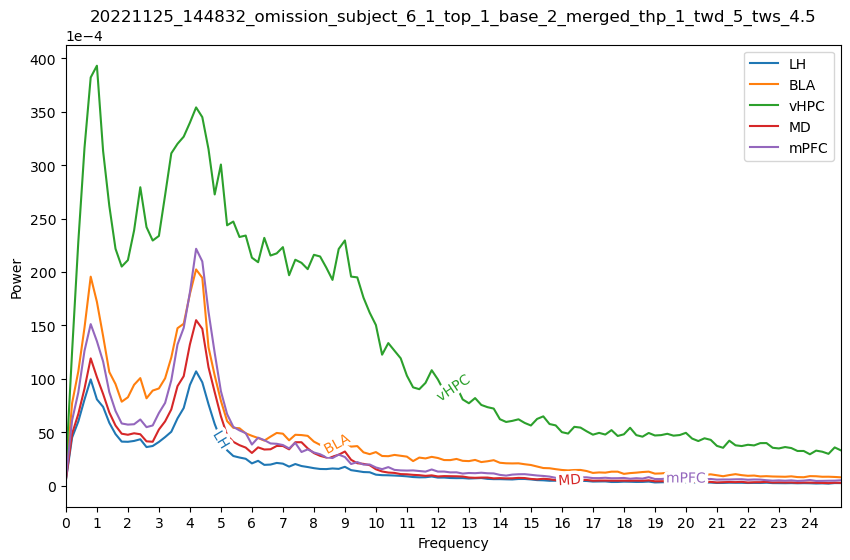

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_1_twd_5_tws_4.5.png


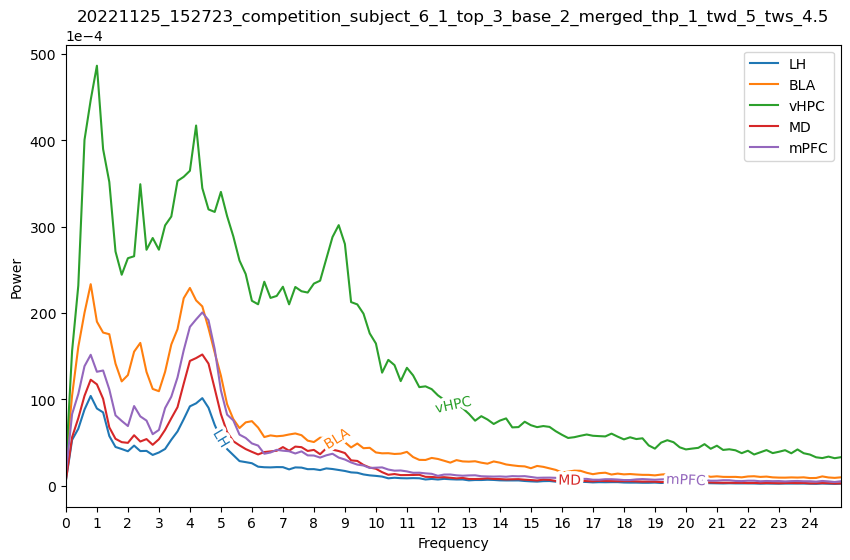

time_halfbandwidth_product: 1, time_window_duration: 7,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_7_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_7_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_7_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_7_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

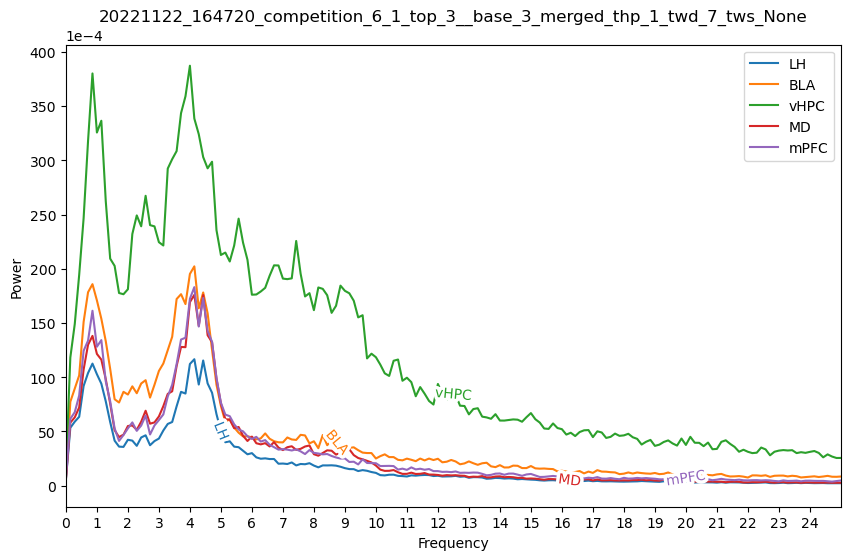

20221122_161341_omission_subject_6_1_top_4_base_2_thp_1_twd_7_tws_None.png


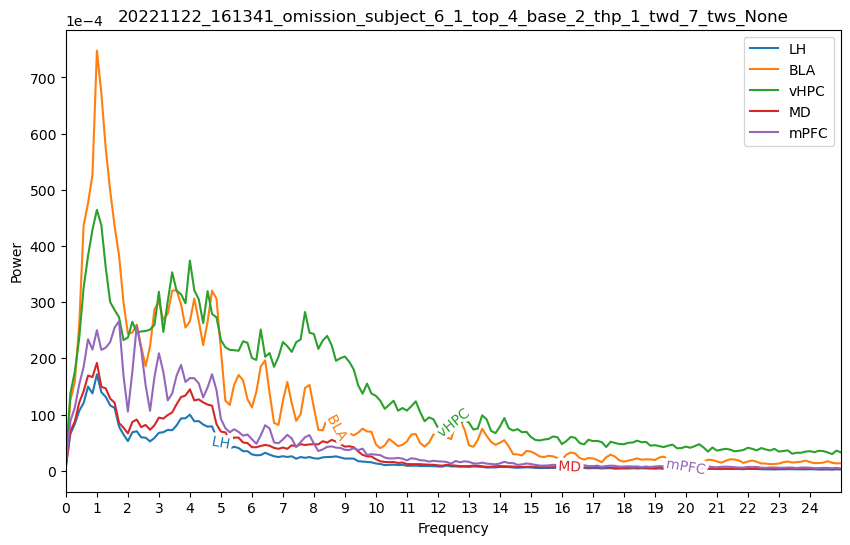

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_1_twd_7_tws_None.png


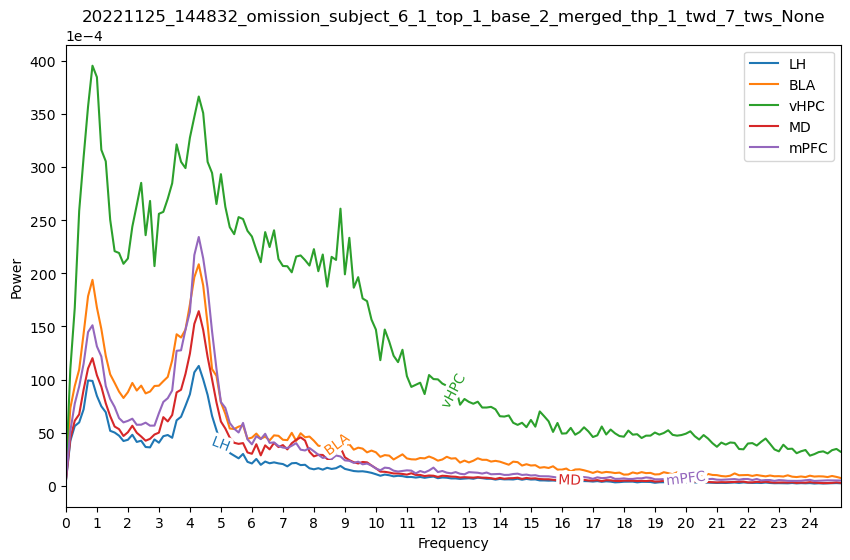

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_1_twd_7_tws_None.png


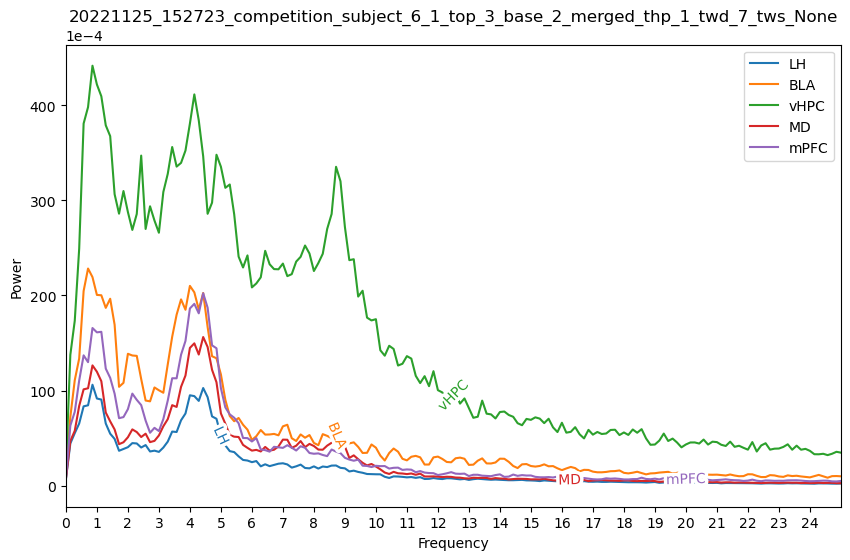

time_halfbandwidth_product: 1, time_window_duration: 7,         tws_ratio: 0.5, time_window_step 3.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_7_tws_3.5_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_7_tws_3.5_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_7_tws_3.5_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_7_tws_3.5_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

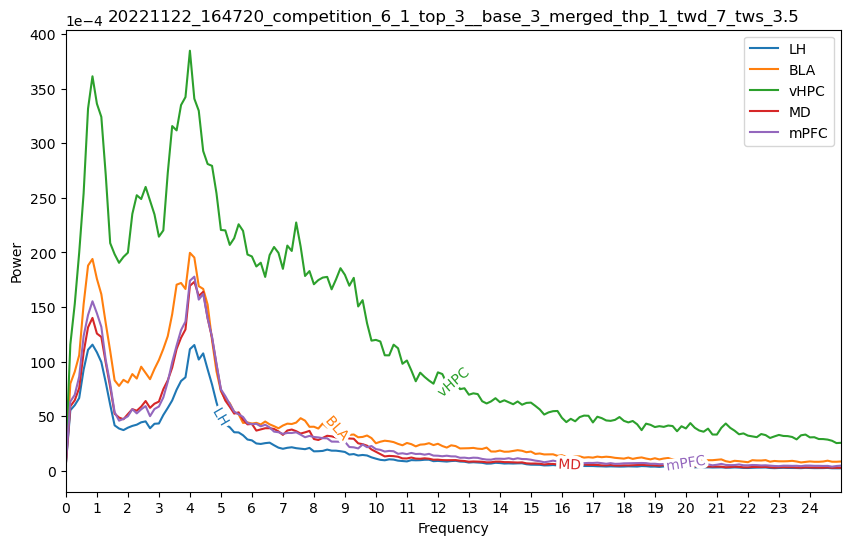

20221122_161341_omission_subject_6_1_top_4_base_2_thp_1_twd_7_tws_3.5.png


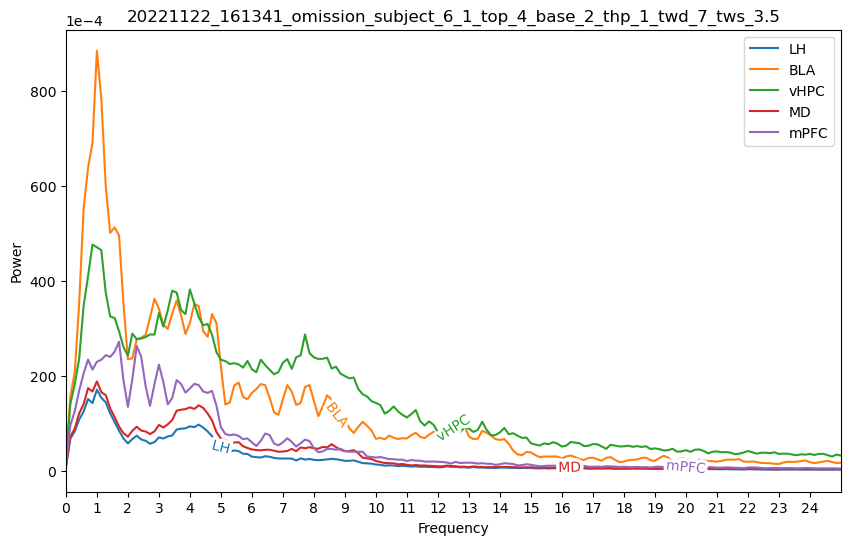

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_1_twd_7_tws_3.5.png


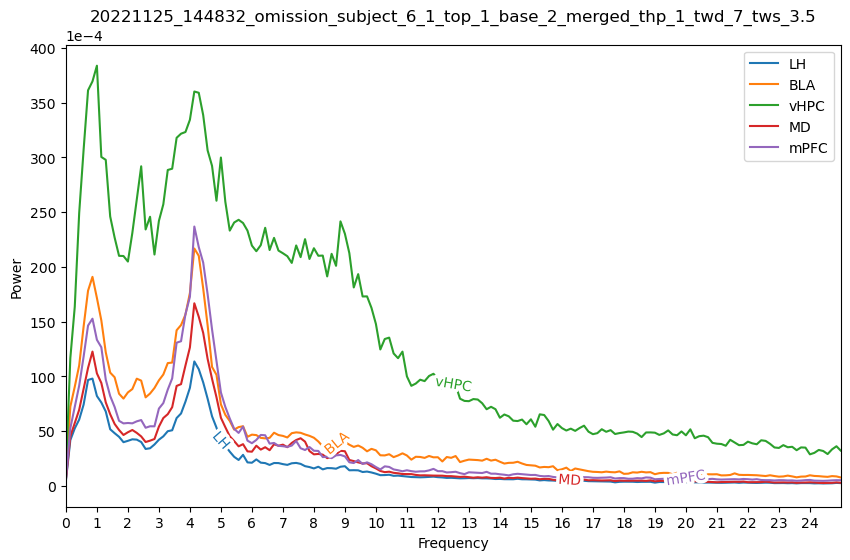

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_1_twd_7_tws_3.5.png


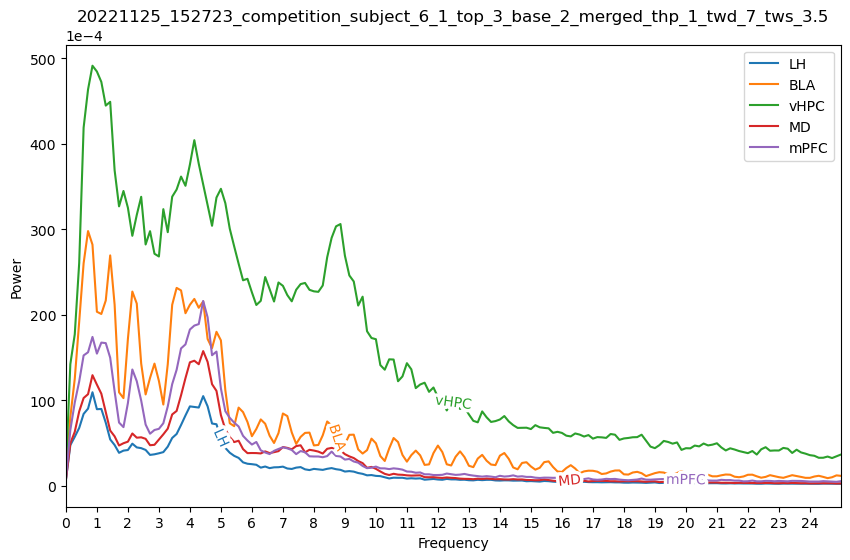

time_halfbandwidth_product: 1, time_window_duration: 7,         tws_ratio: 0.9, time_window_step 6.3
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_7_tws_6.3_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_7_tws_6.3_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_7_tws_6.3_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_7_tws_6.3_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

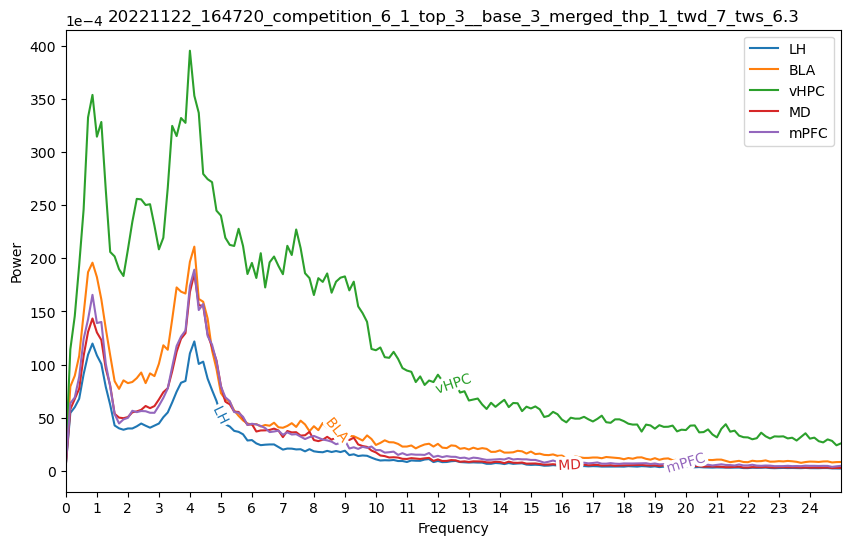

20221122_161341_omission_subject_6_1_top_4_base_2_thp_1_twd_7_tws_6.3.png


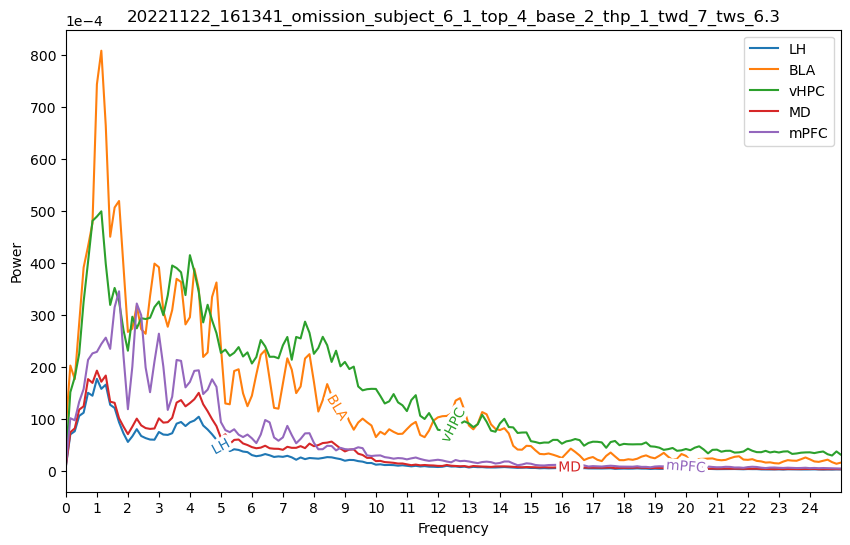

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_1_twd_7_tws_6.3.png


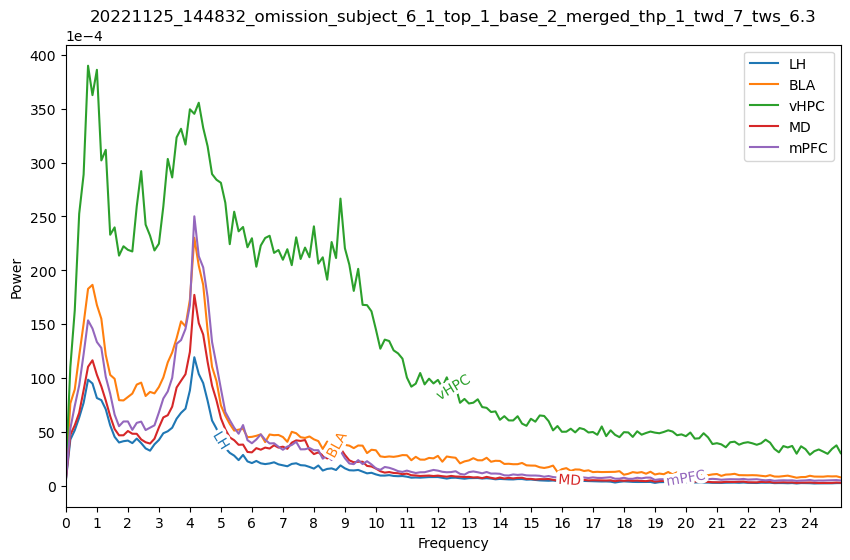

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_1_twd_7_tws_6.3.png


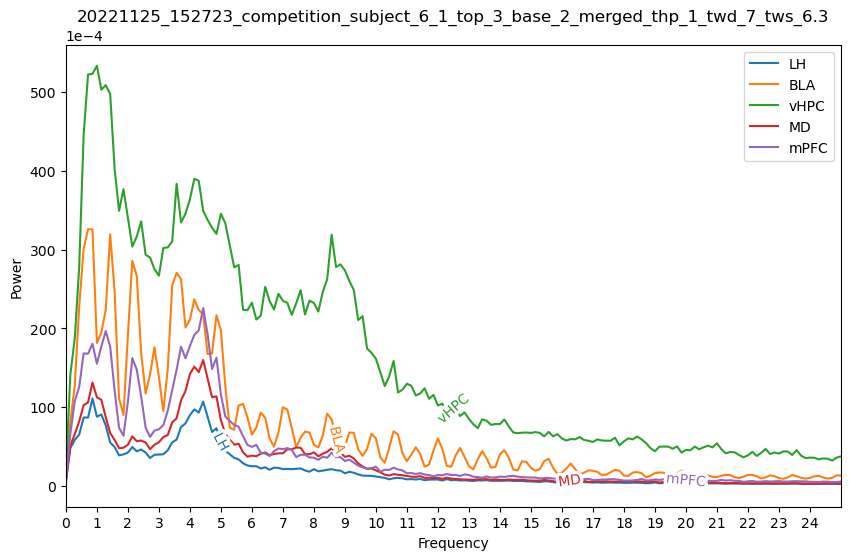

time_halfbandwidth_product: 1, time_window_duration: 10,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_10_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_10_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_10_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_10_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competiti

20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_10_tws_None.png


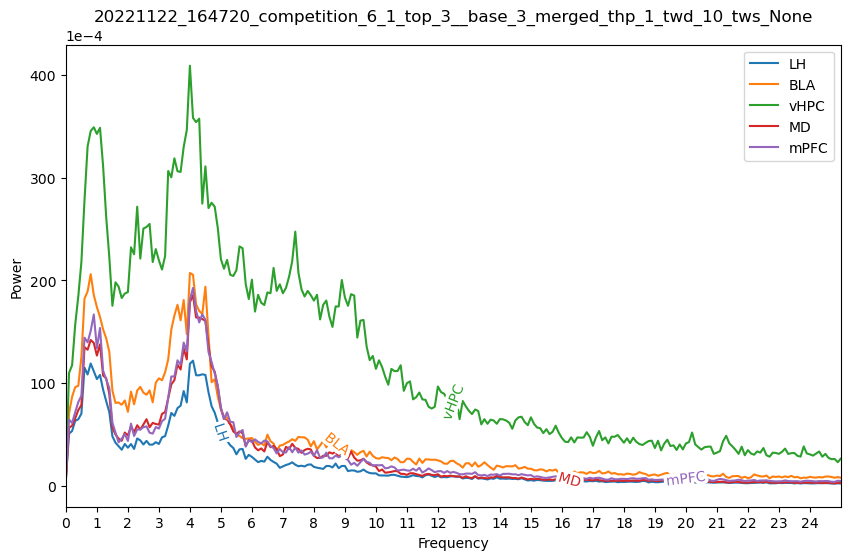

20221122_161341_omission_subject_6_1_top_4_base_2_thp_1_twd_10_tws_None.png


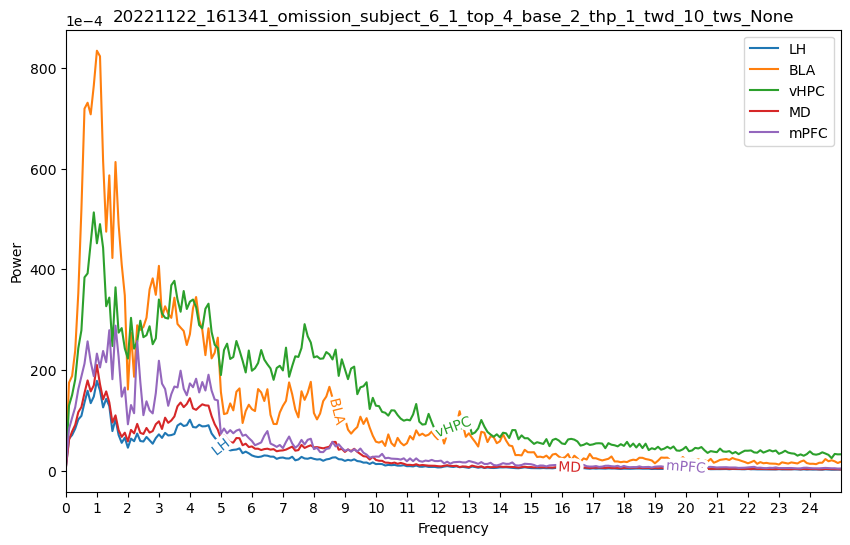

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_1_twd_10_tws_None.png


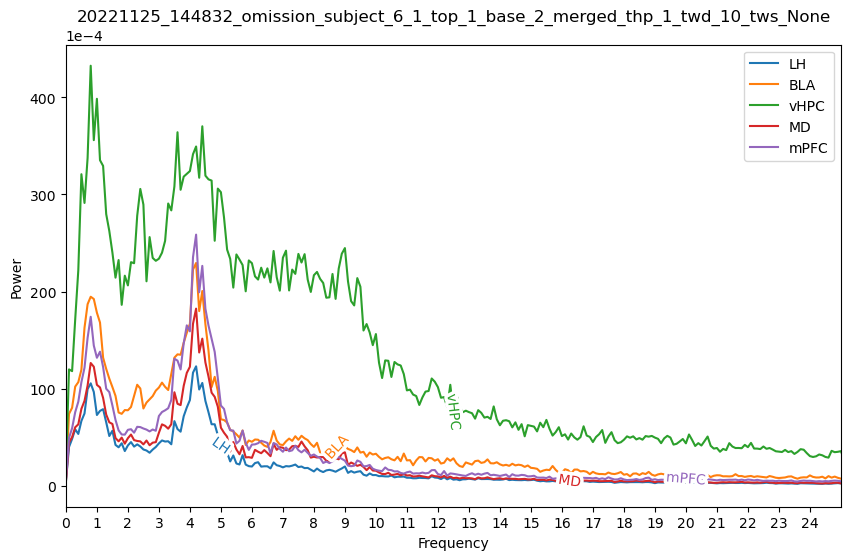

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_1_twd_10_tws_None.png


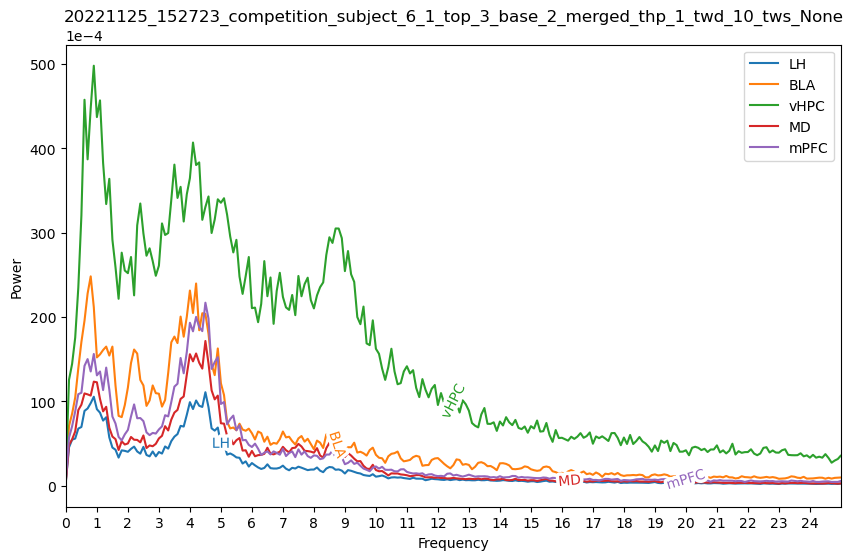

time_halfbandwidth_product: 1, time_window_duration: 10,         tws_ratio: 0.5, time_window_step 5.0
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_10_tws_5.0_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_10_tws_5.0_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_10_tws_5.0_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_10_tws_5.0_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1

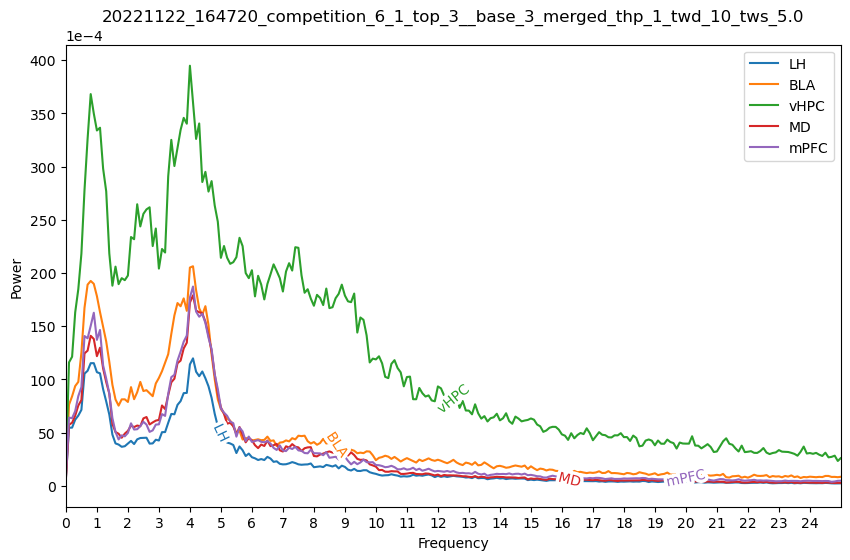

20221122_161341_omission_subject_6_1_top_4_base_2_thp_1_twd_10_tws_5.0.png


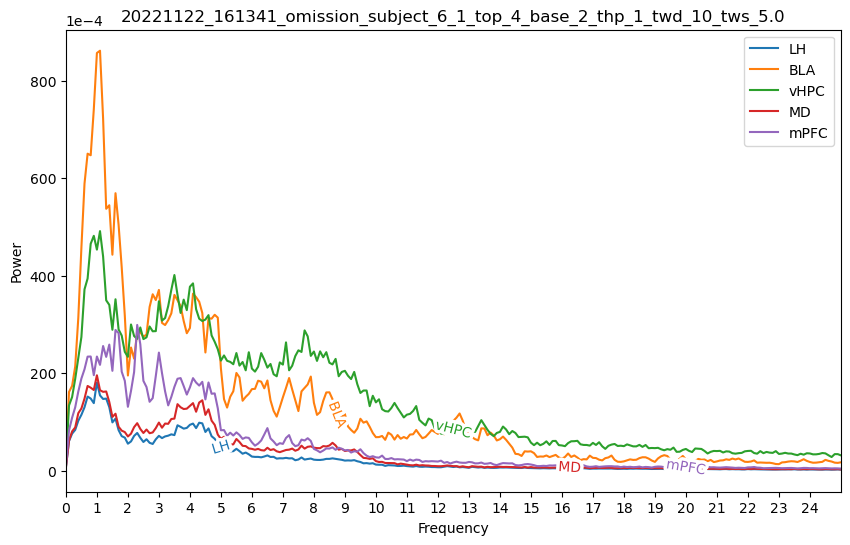

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_1_twd_10_tws_5.0.png


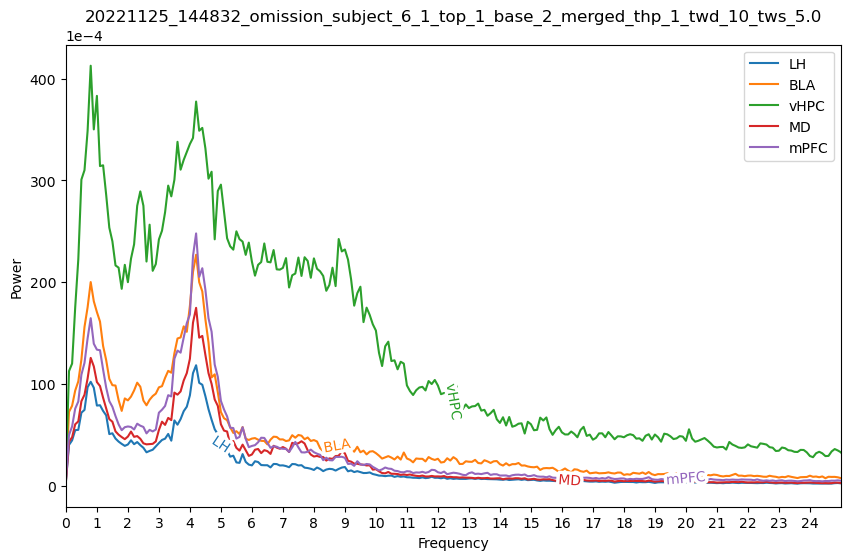

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_1_twd_10_tws_5.0.png


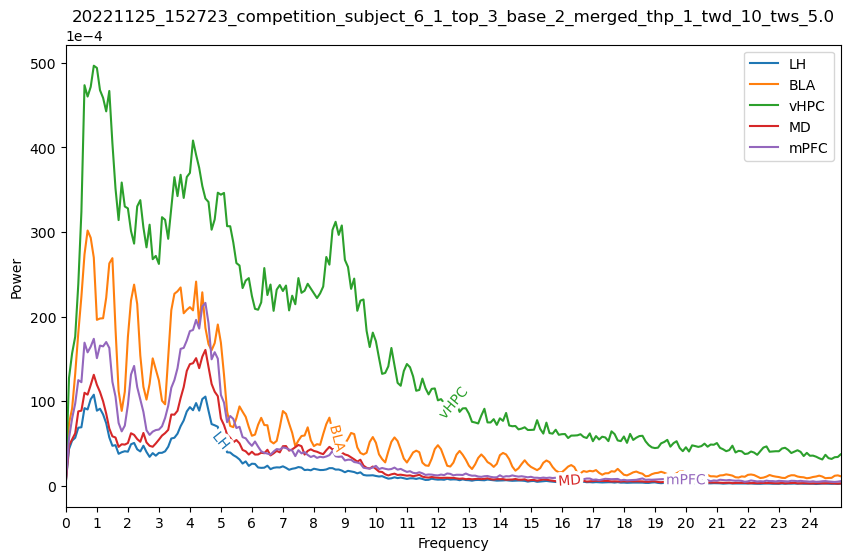

time_halfbandwidth_product: 1, time_window_duration: 10,         tws_ratio: 0.9, time_window_step 9.0
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_10_tws_9.0_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_10_tws_9.0_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_10_tws_9.0_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_1_twd_10_tws_9.0_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1

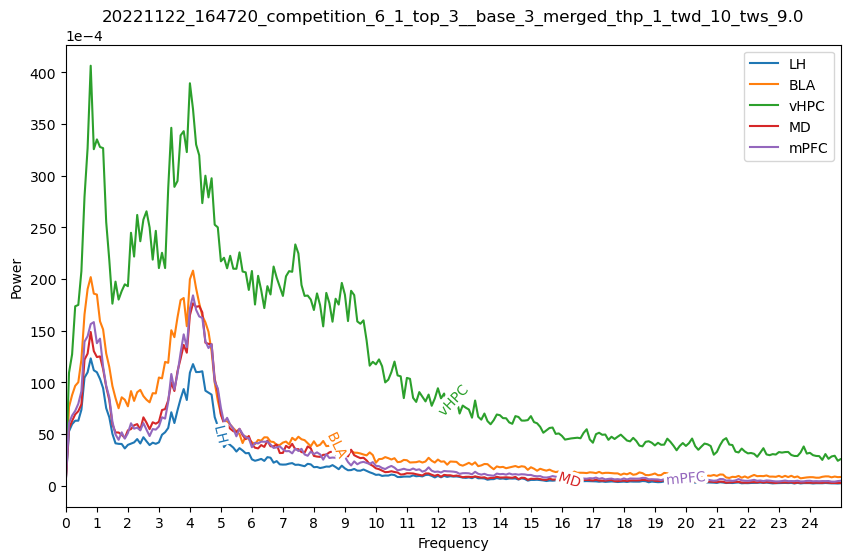

20221122_161341_omission_subject_6_1_top_4_base_2_thp_1_twd_10_tws_9.0.png


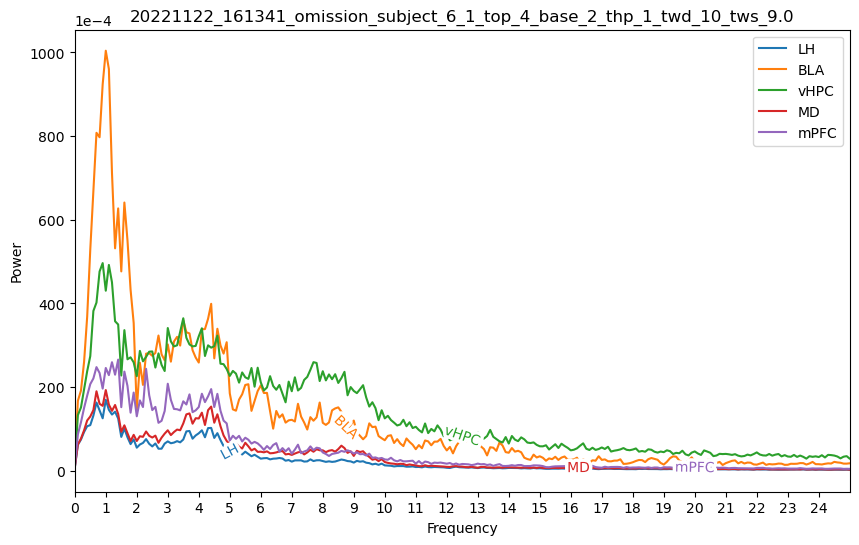

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_1_twd_10_tws_9.0.png


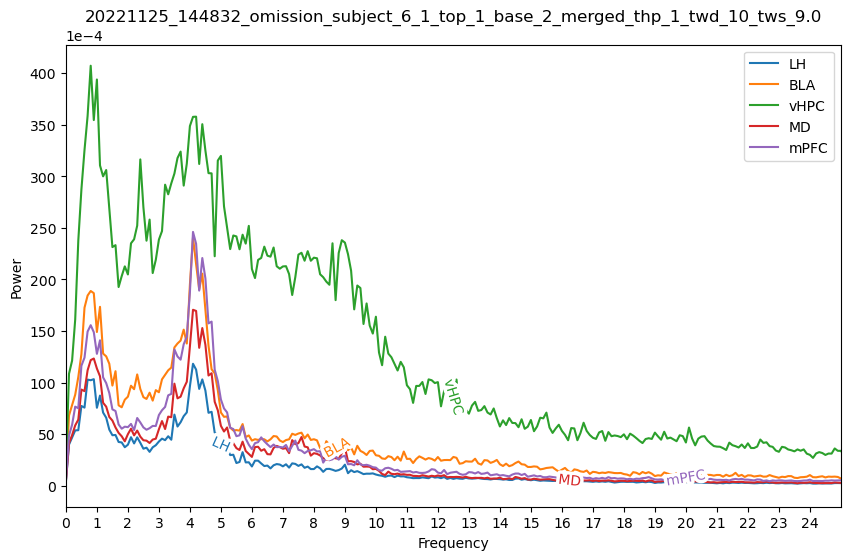

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_1_twd_10_tws_9.0.png


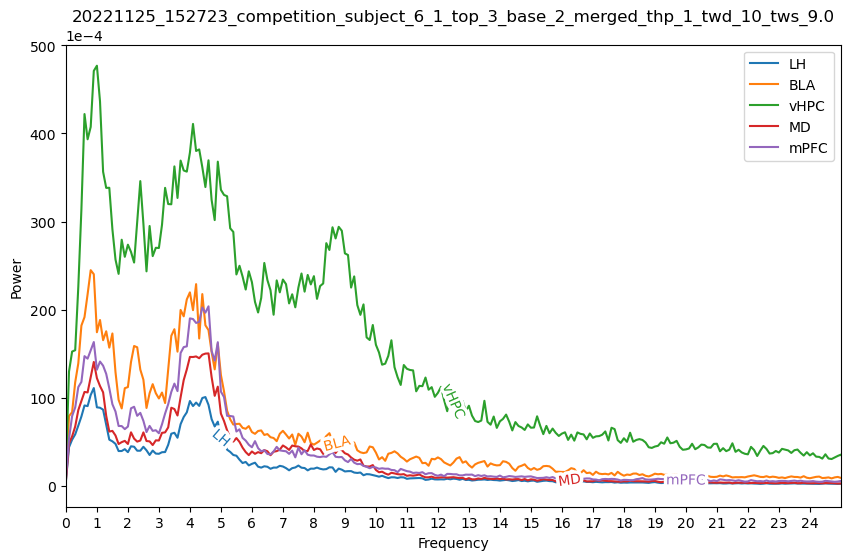

time_halfbandwidth_product: 2, time_window_duration: 1,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_1_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_1_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_1_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_1_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

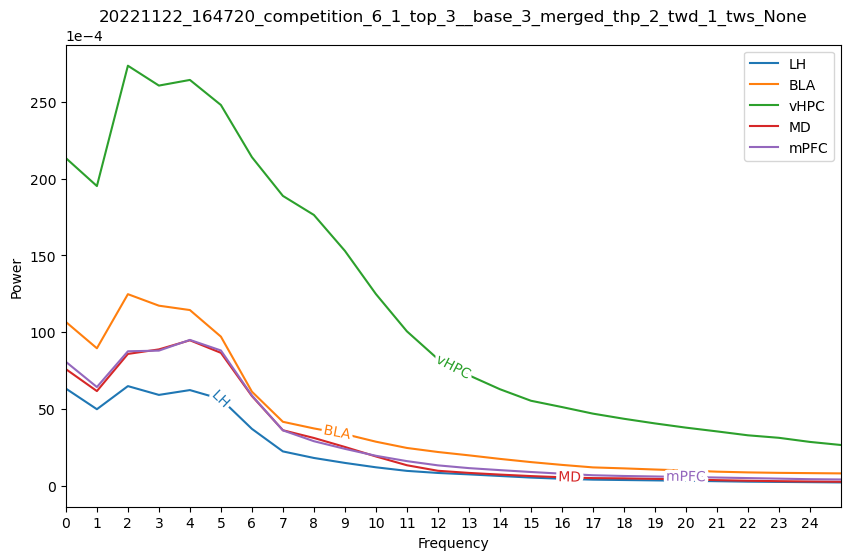

20221122_161341_omission_subject_6_1_top_4_base_2_thp_2_twd_1_tws_None.png


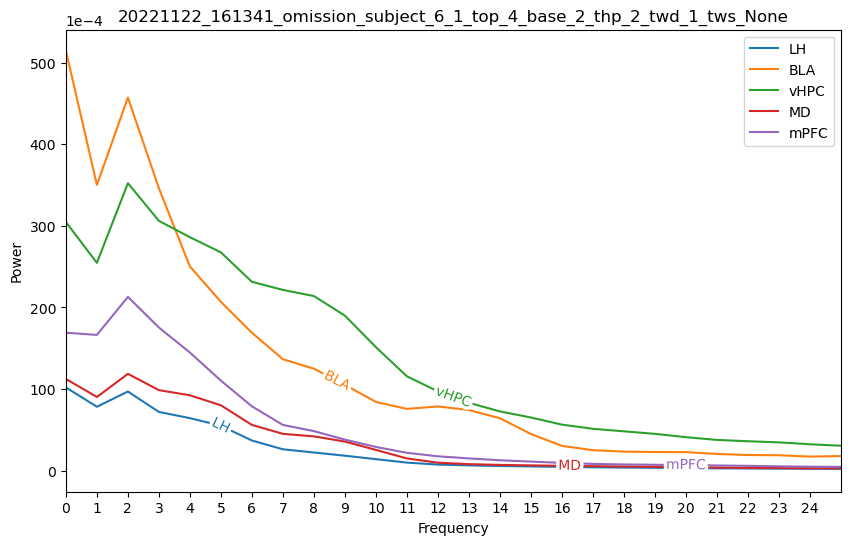

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_2_twd_1_tws_None.png


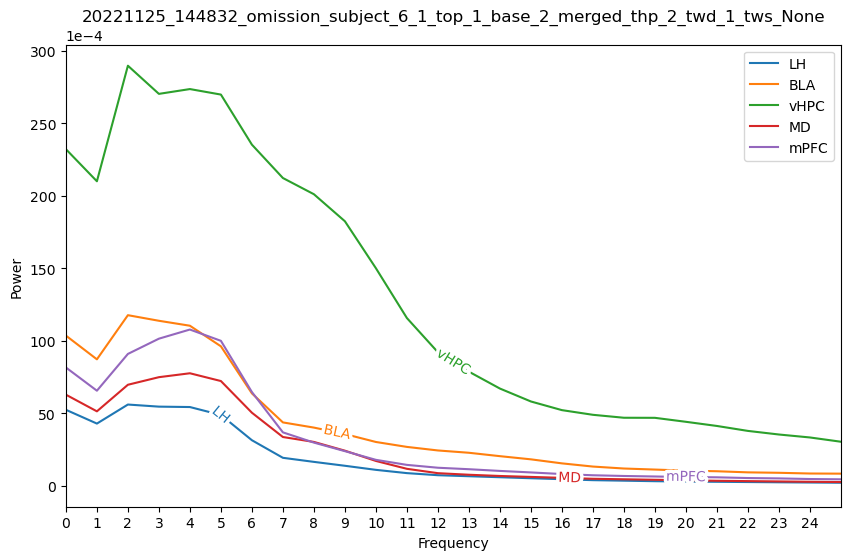

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_2_twd_1_tws_None.png


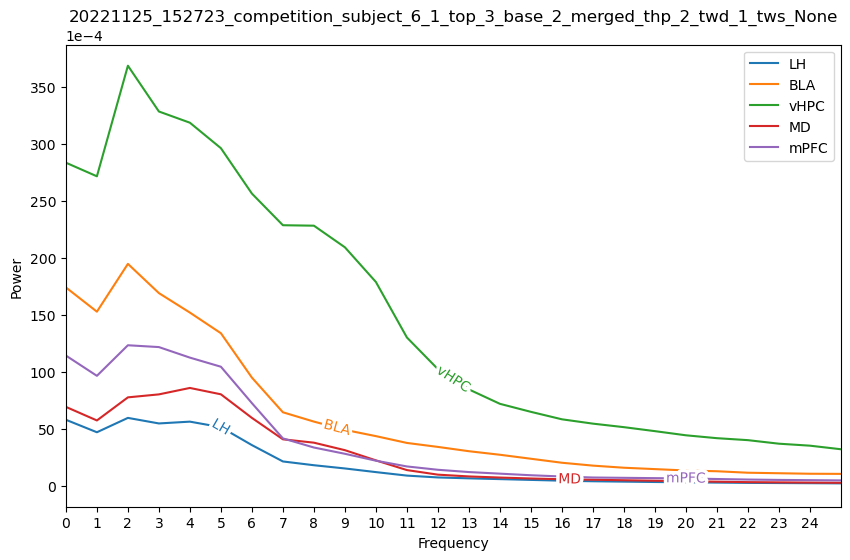

time_halfbandwidth_product: 2, time_window_duration: 1,         tws_ratio: 0.5, time_window_step 0.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_1_tws_0.5_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_1_tws_0.5_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_1_tws_0.5_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_1_tws_0.5_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

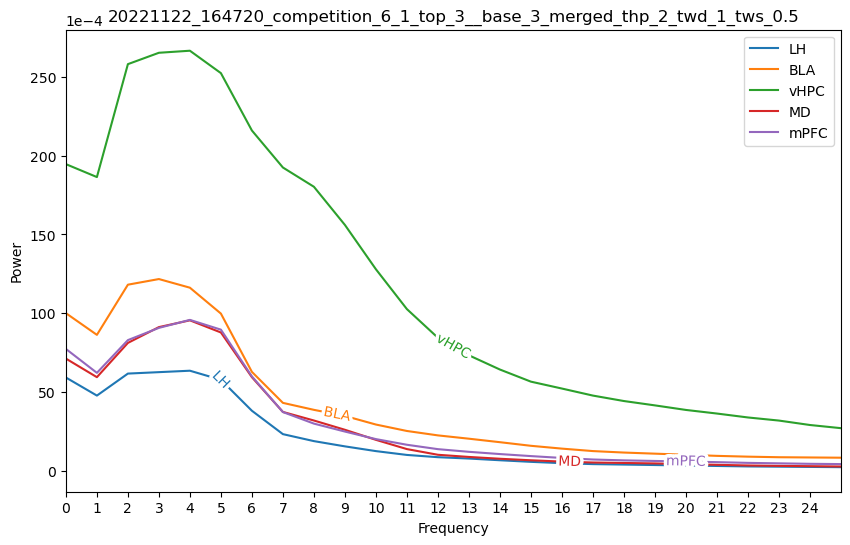

20221122_161341_omission_subject_6_1_top_4_base_2_thp_2_twd_1_tws_0.5.png


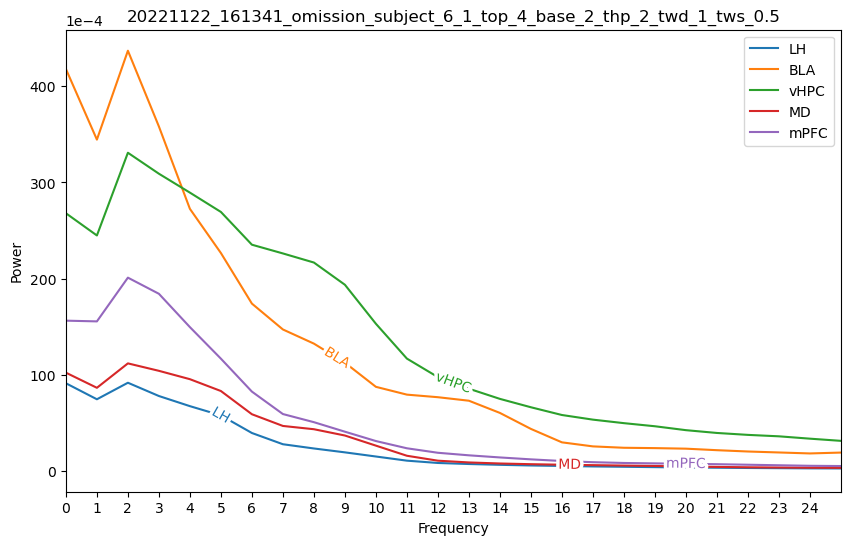

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_2_twd_1_tws_0.5.png


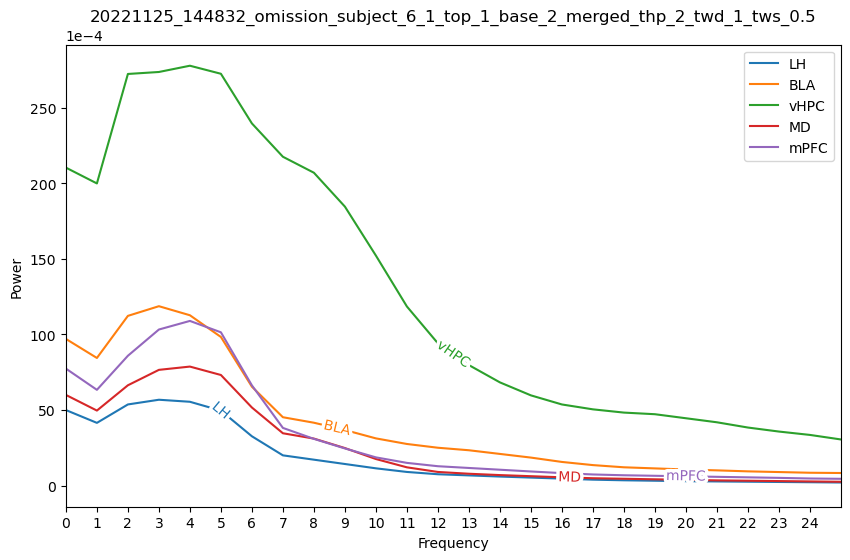

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_2_twd_1_tws_0.5.png


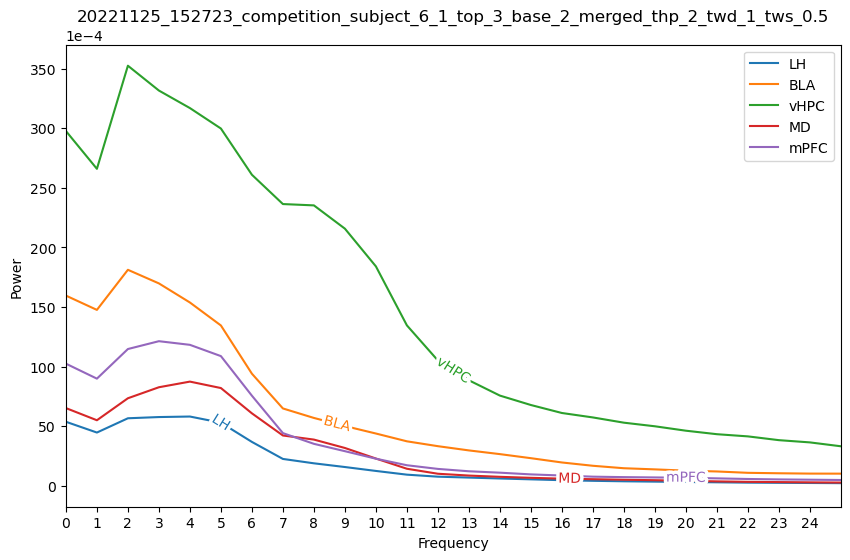

time_halfbandwidth_product: 2, time_window_duration: 1,         tws_ratio: 0.9, time_window_step 0.9
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_1_tws_0.9_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_1_tws_0.9_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_1_tws_0.9_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_1_tws_0.9_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

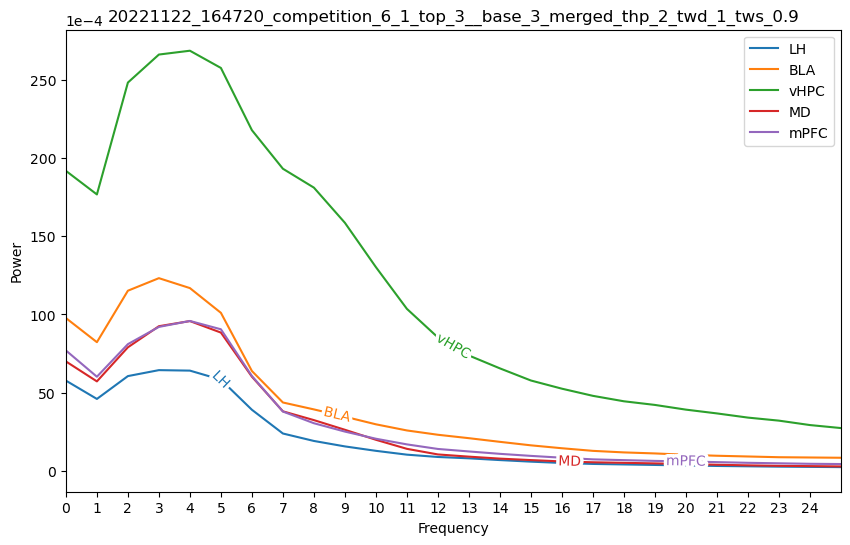

20221122_161341_omission_subject_6_1_top_4_base_2_thp_2_twd_1_tws_0.9.png


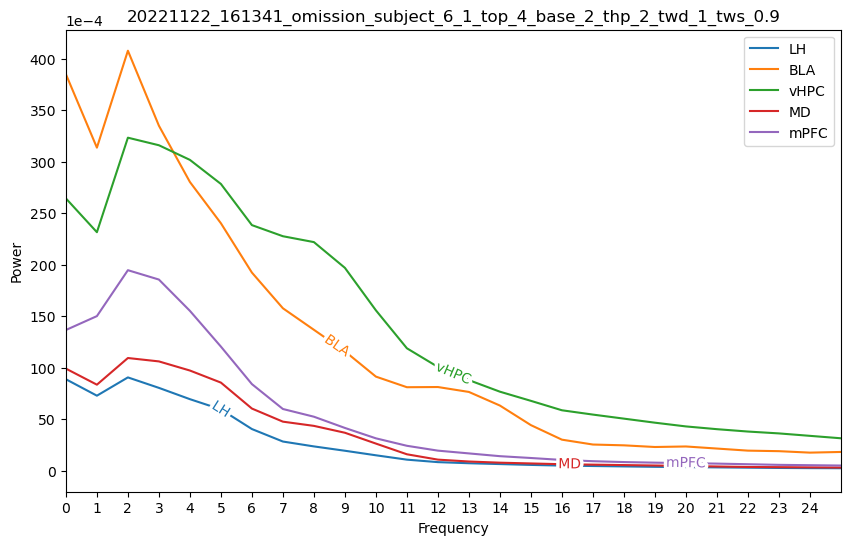

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_2_twd_1_tws_0.9.png


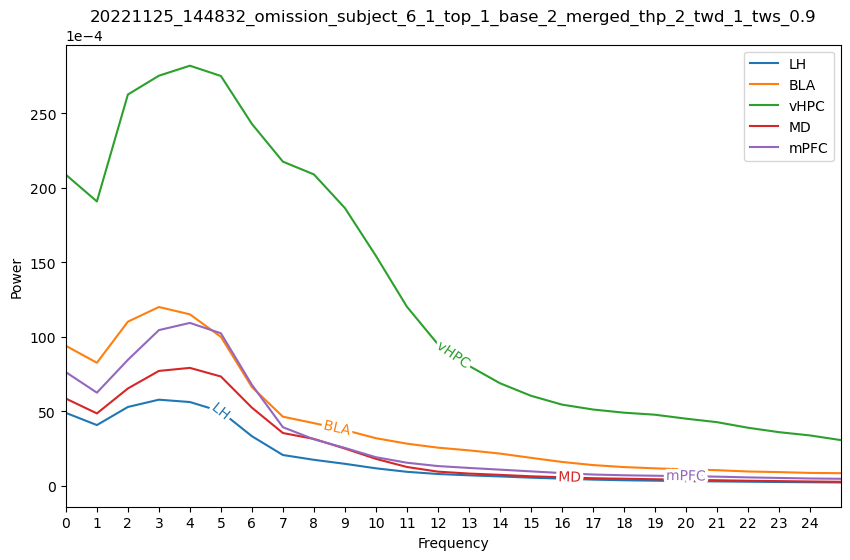

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_2_twd_1_tws_0.9.png


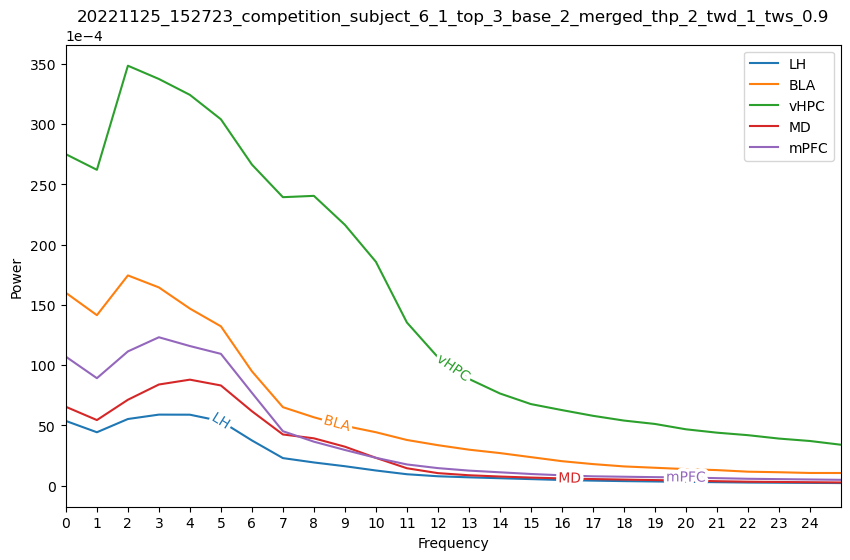

time_halfbandwidth_product: 2, time_window_duration: 2,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_2_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_2_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_2_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_2_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

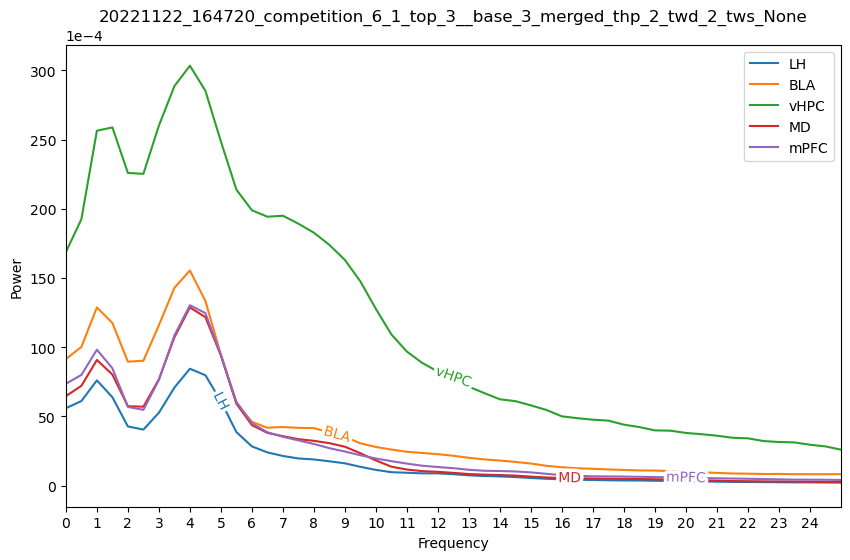

20221122_161341_omission_subject_6_1_top_4_base_2_thp_2_twd_2_tws_None.png


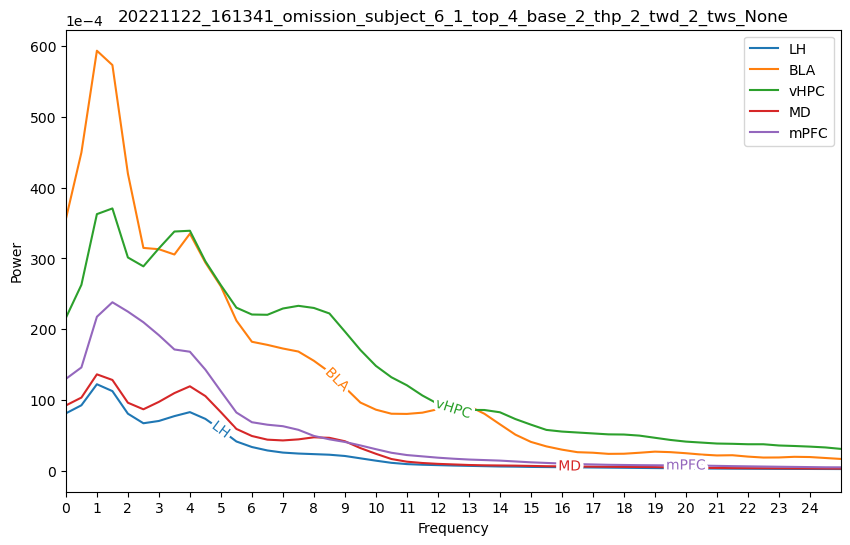

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_2_twd_2_tws_None.png


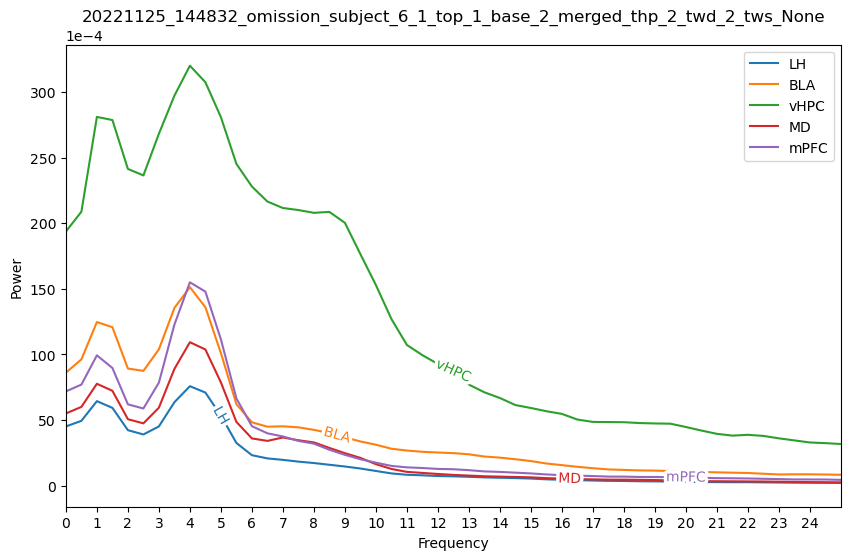

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_2_twd_2_tws_None.png


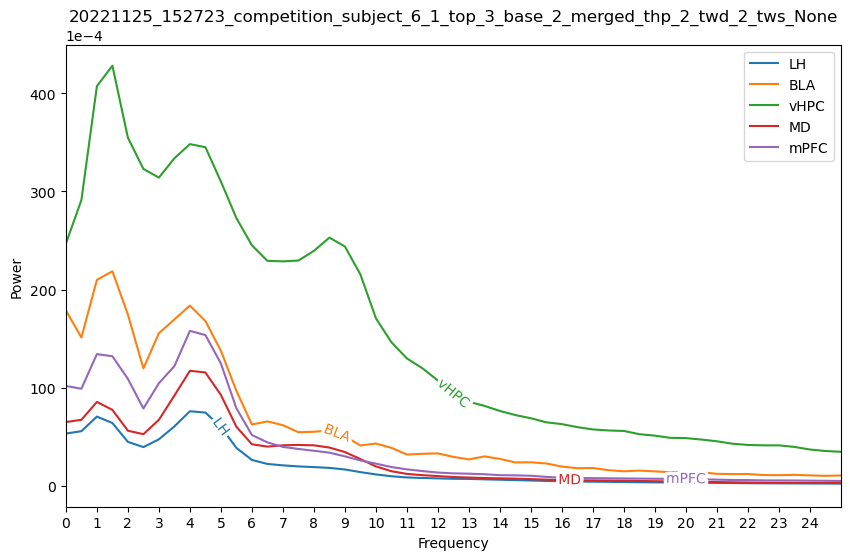

time_halfbandwidth_product: 2, time_window_duration: 2,         tws_ratio: 0.5, time_window_step 1.0
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_2_tws_1.0_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_2_tws_1.0_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_2_tws_1.0_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_2_tws_1.0_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

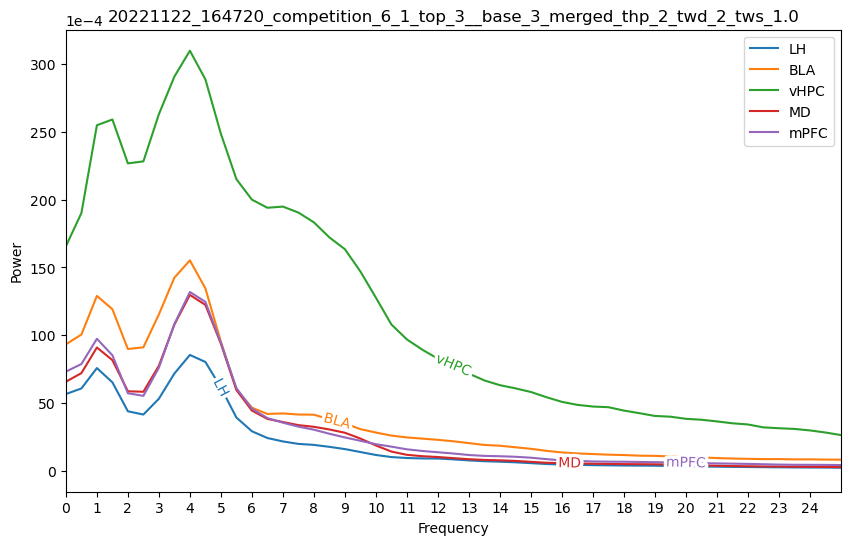

20221122_161341_omission_subject_6_1_top_4_base_2_thp_2_twd_2_tws_1.0.png


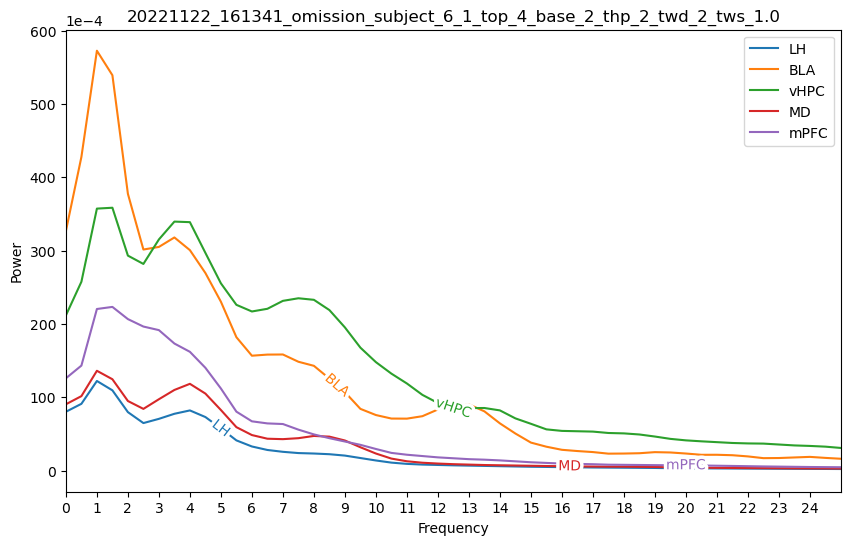

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_2_twd_2_tws_1.0.png


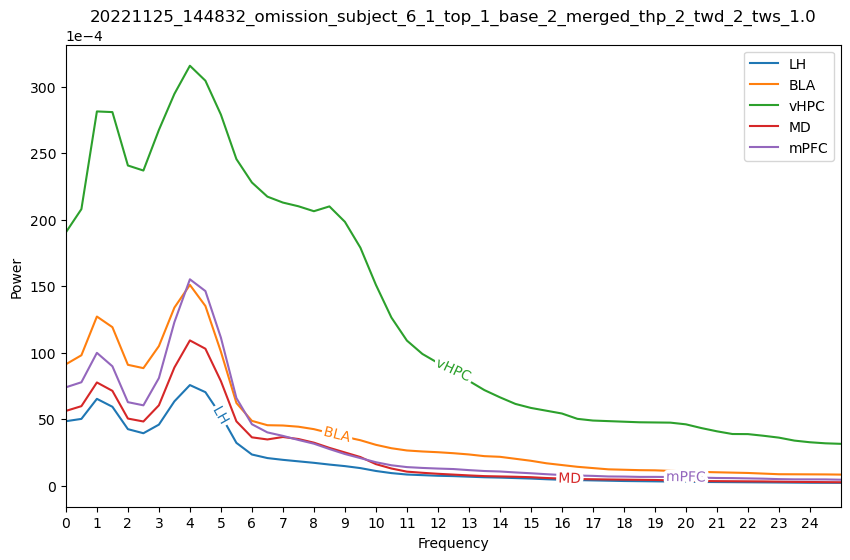

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_2_twd_2_tws_1.0.png


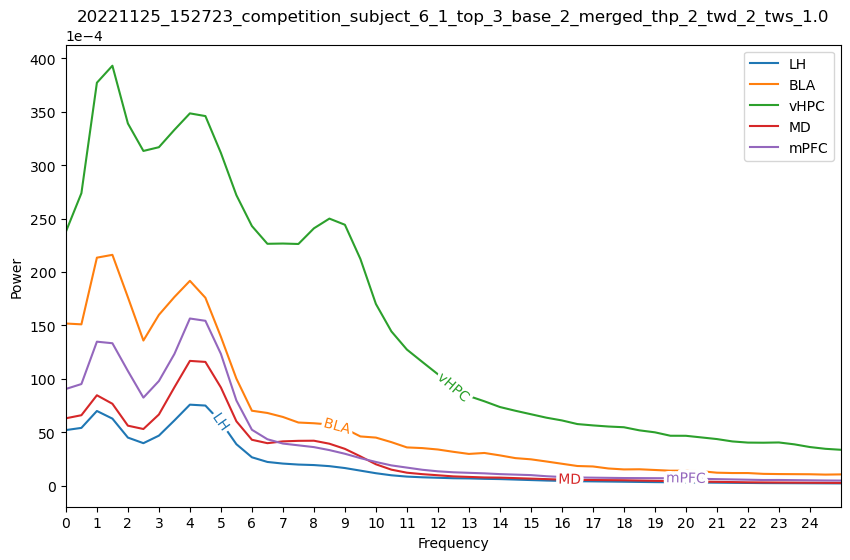

time_halfbandwidth_product: 2, time_window_duration: 2,         tws_ratio: 0.9, time_window_step 1.8
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_2_tws_1.8_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_2_tws_1.8_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_2_tws_1.8_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_2_tws_1.8_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

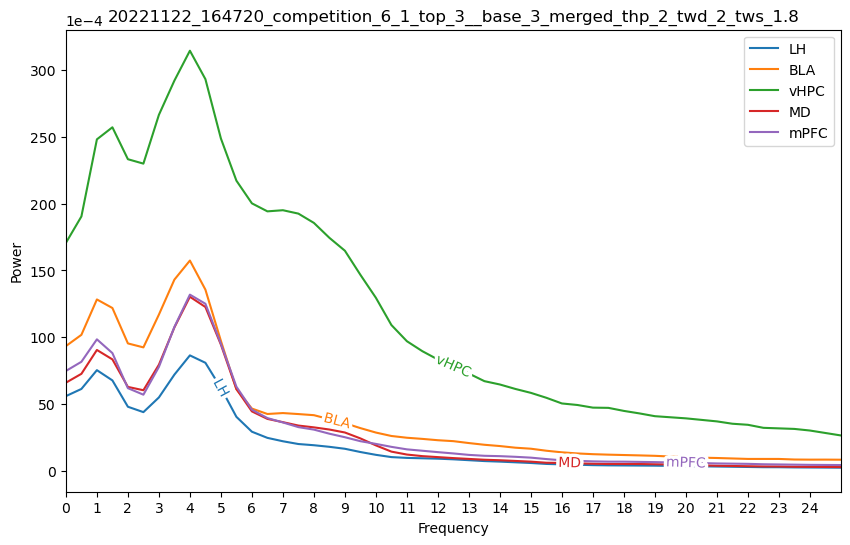

20221122_161341_omission_subject_6_1_top_4_base_2_thp_2_twd_2_tws_1.8.png


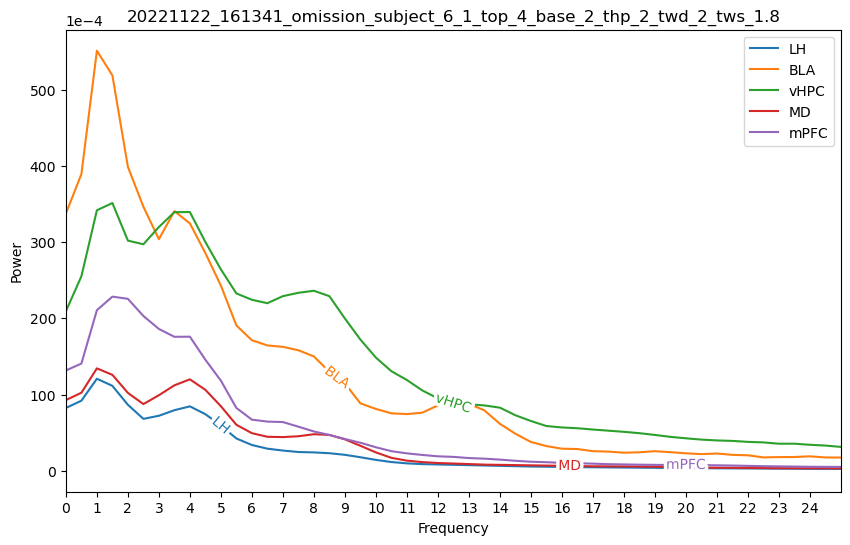

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_2_twd_2_tws_1.8.png


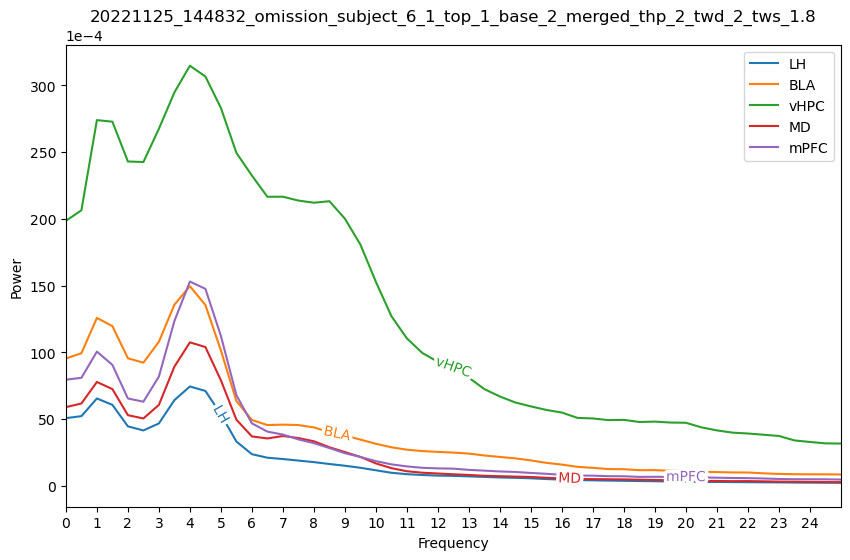

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_2_twd_2_tws_1.8.png


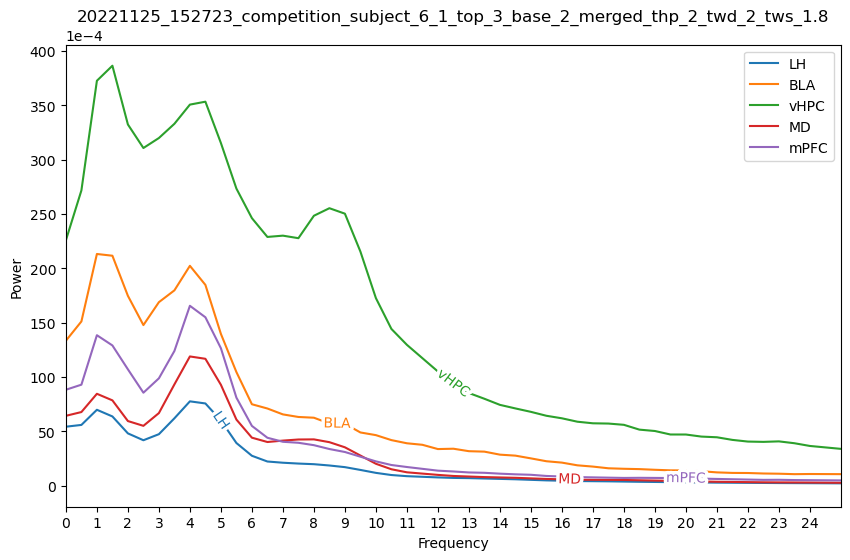

time_halfbandwidth_product: 2, time_window_duration: 3,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_3_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_3_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_3_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_3_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

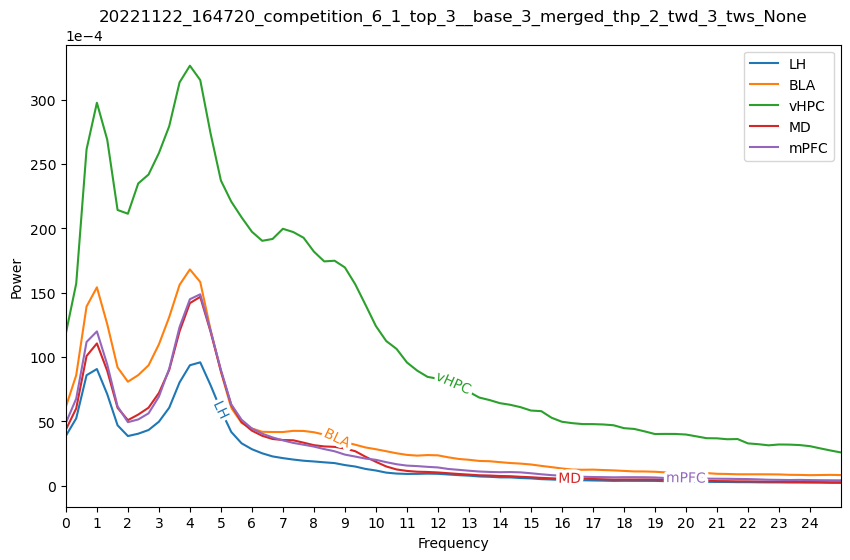

20221122_161341_omission_subject_6_1_top_4_base_2_thp_2_twd_3_tws_None.png


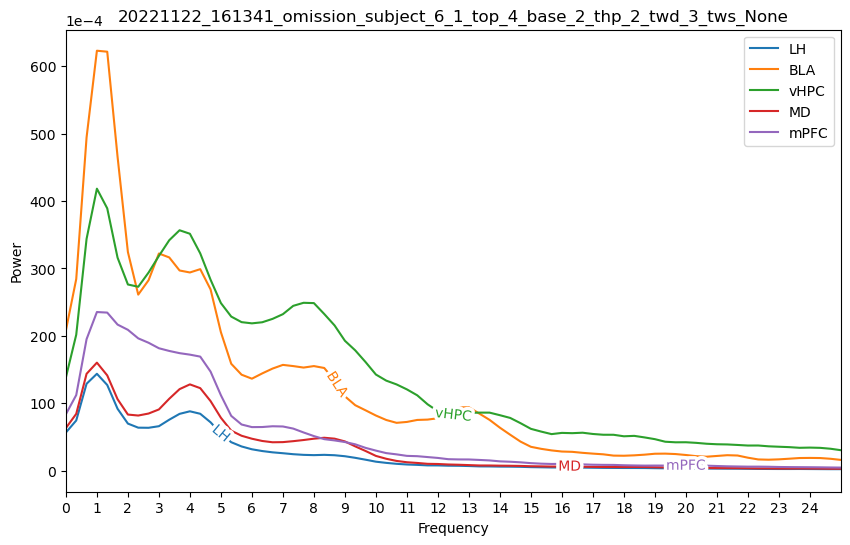

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_2_twd_3_tws_None.png


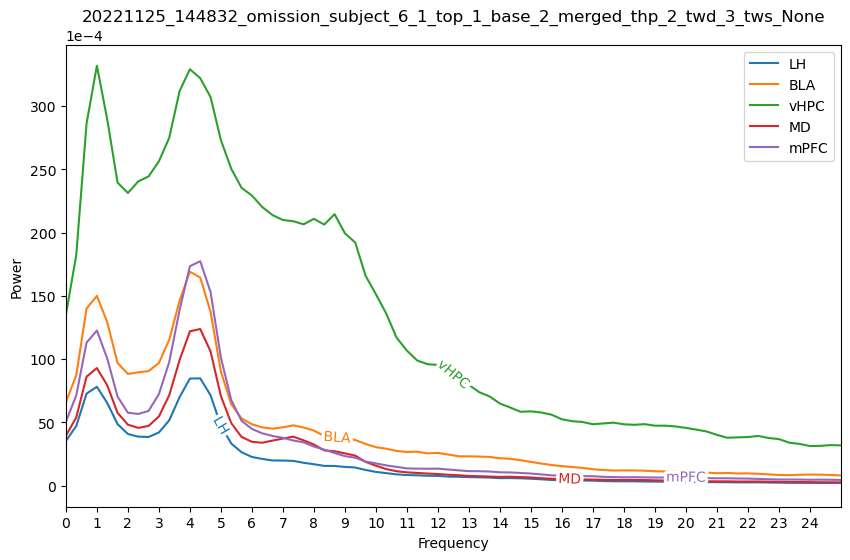

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_2_twd_3_tws_None.png


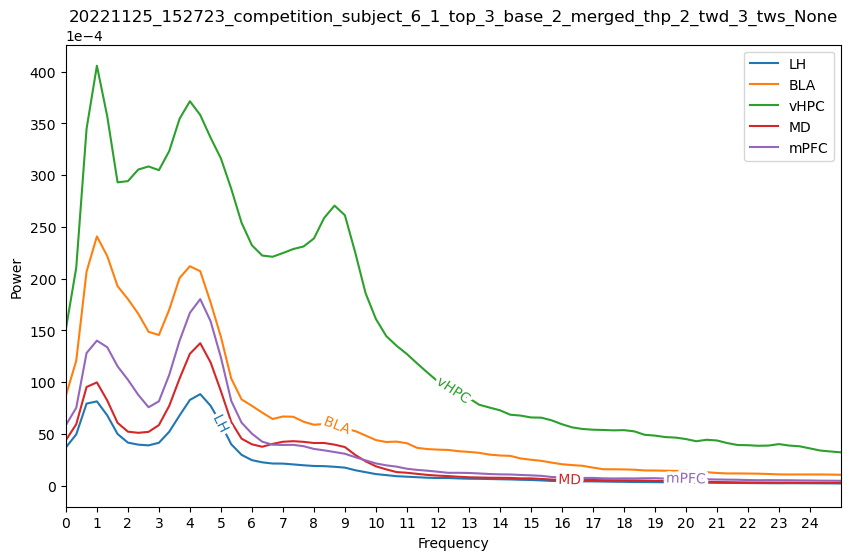

time_halfbandwidth_product: 2, time_window_duration: 3,         tws_ratio: 0.5, time_window_step 1.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_3_tws_1.5_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_3_tws_1.5_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_3_tws_1.5_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_3_tws_1.5_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

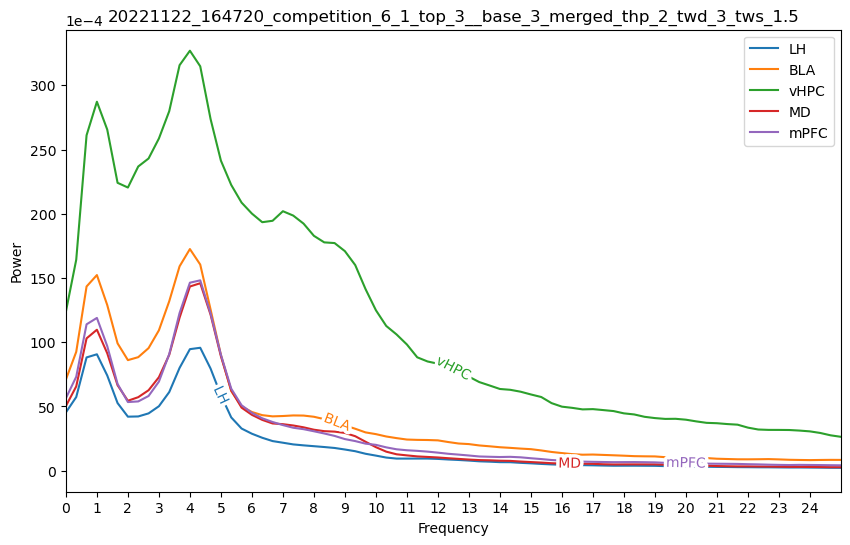

20221122_161341_omission_subject_6_1_top_4_base_2_thp_2_twd_3_tws_1.5.png


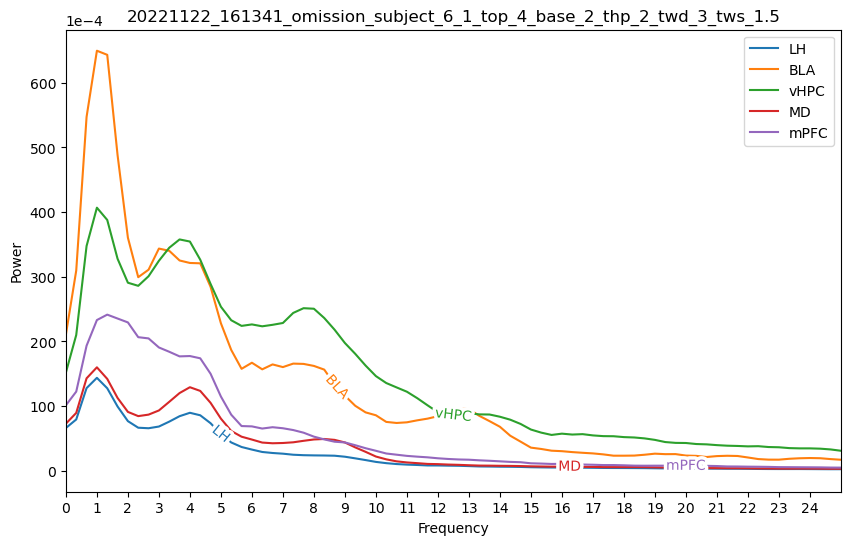

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_2_twd_3_tws_1.5.png


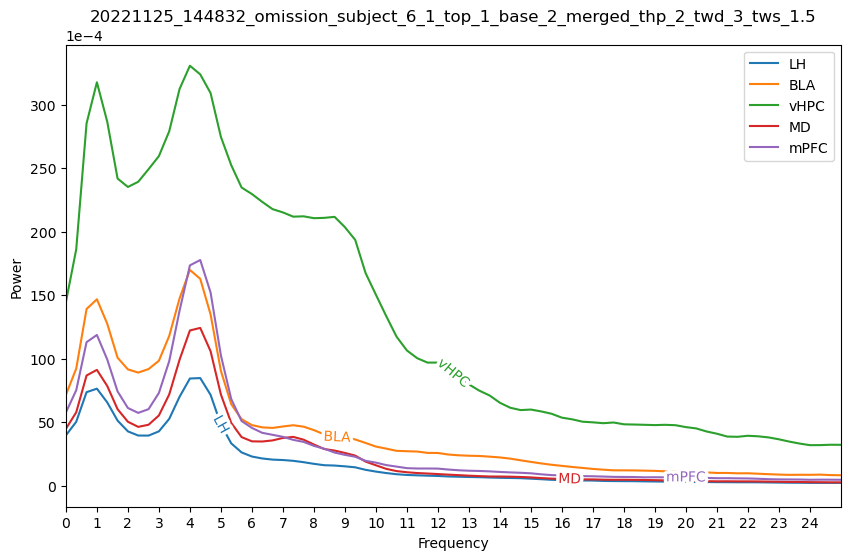

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_2_twd_3_tws_1.5.png


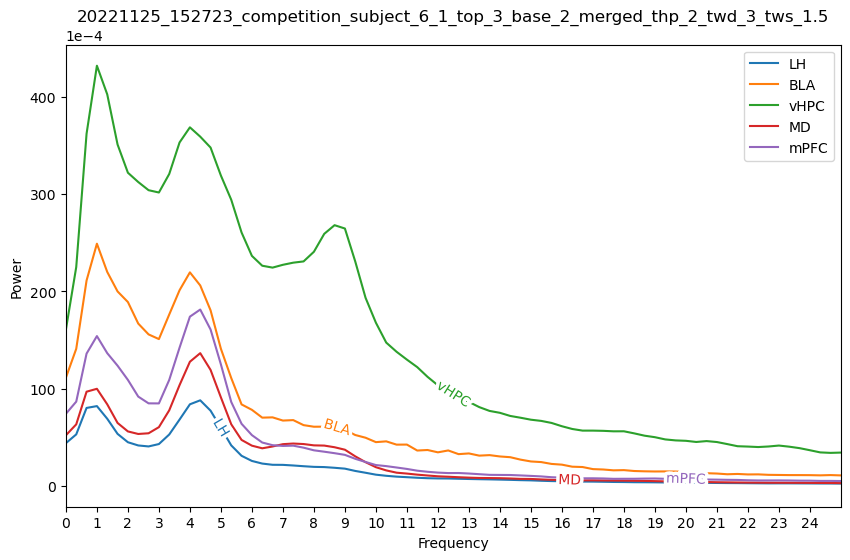

time_halfbandwidth_product: 2, time_window_duration: 3,         tws_ratio: 0.9, time_window_step 2.7
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_3_tws_2.7_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_3_tws_2.7_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_3_tws_2.7_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_3_tws_2.7_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

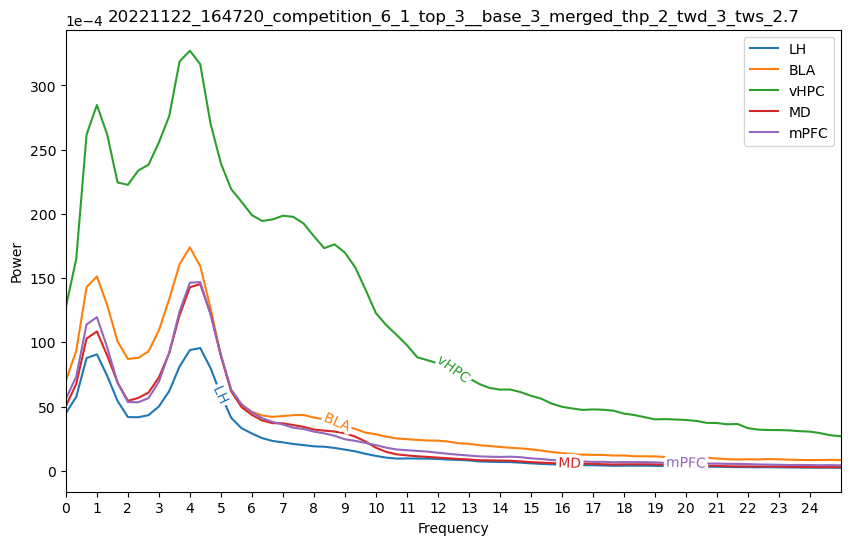

20221122_161341_omission_subject_6_1_top_4_base_2_thp_2_twd_3_tws_2.7.png


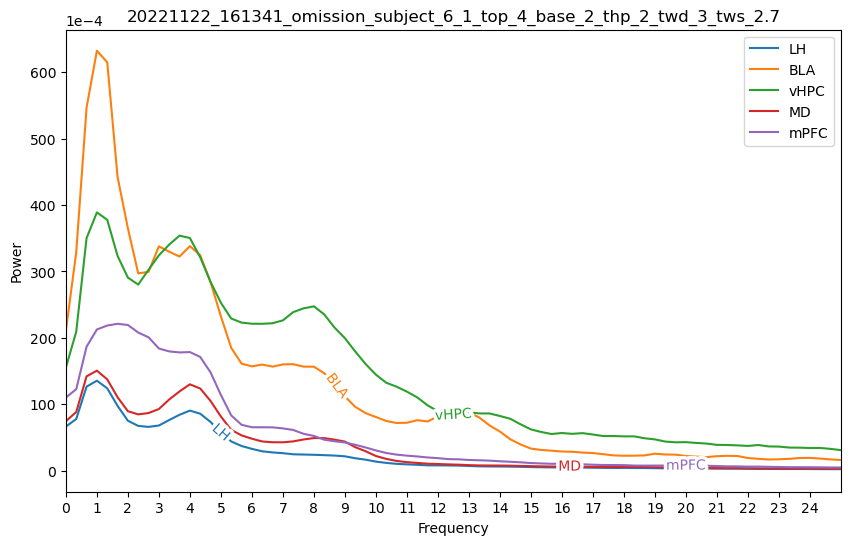

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_2_twd_3_tws_2.7.png


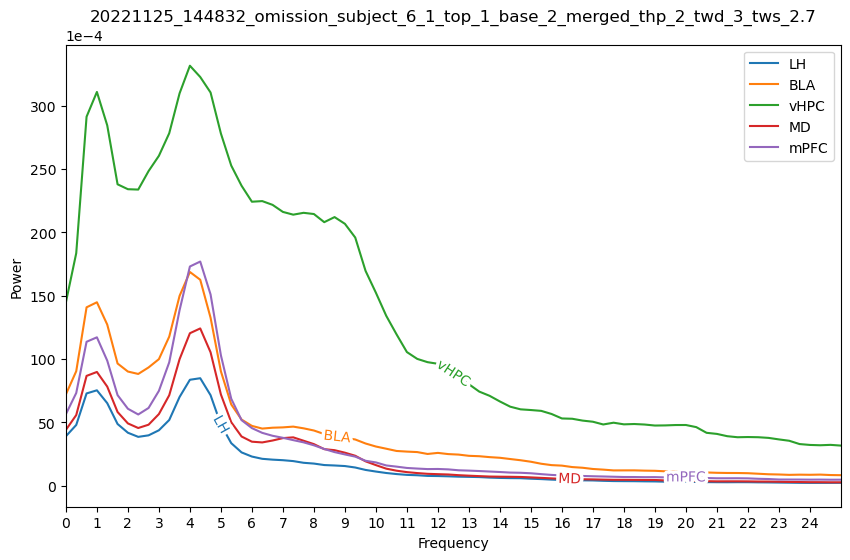

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_2_twd_3_tws_2.7.png


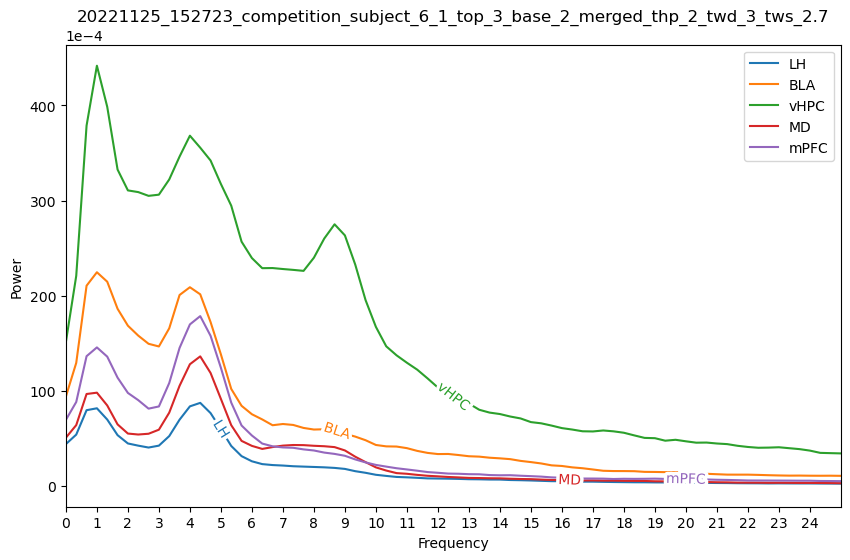

time_halfbandwidth_product: 2, time_window_duration: 5,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_5_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_5_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_5_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_5_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

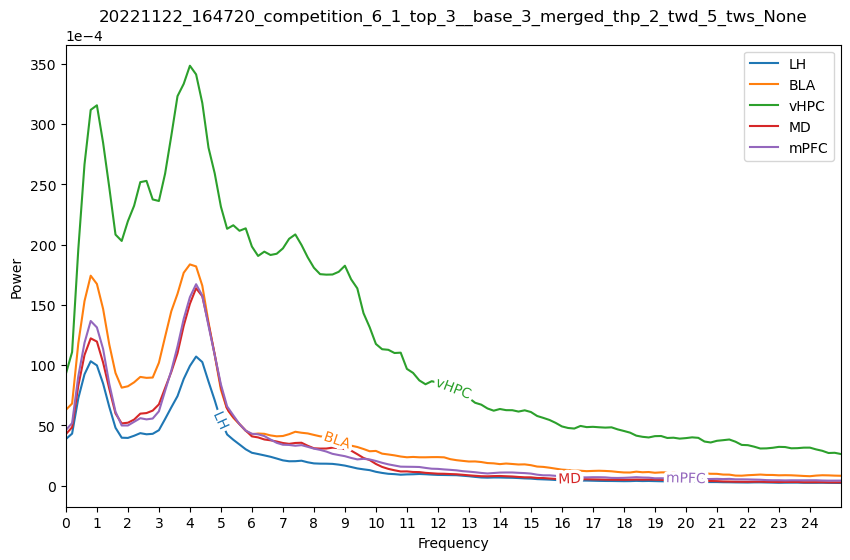

20221122_161341_omission_subject_6_1_top_4_base_2_thp_2_twd_5_tws_None.png


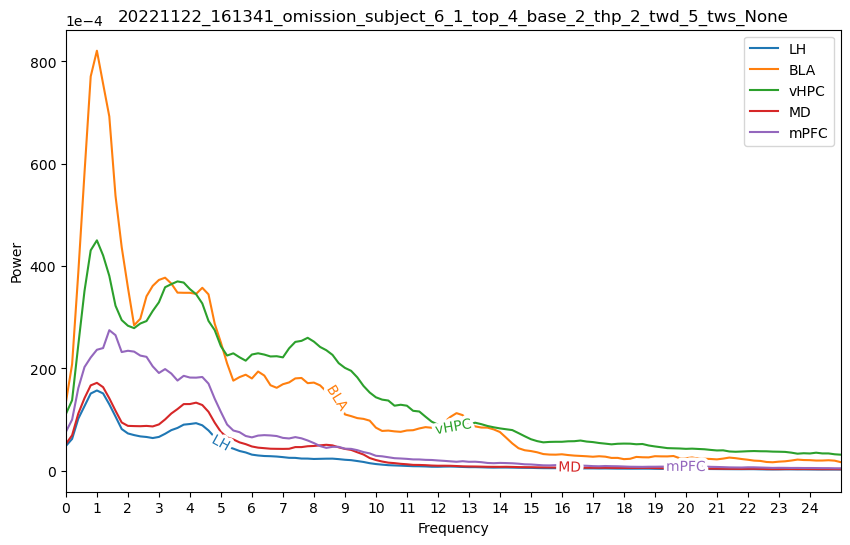

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_2_twd_5_tws_None.png


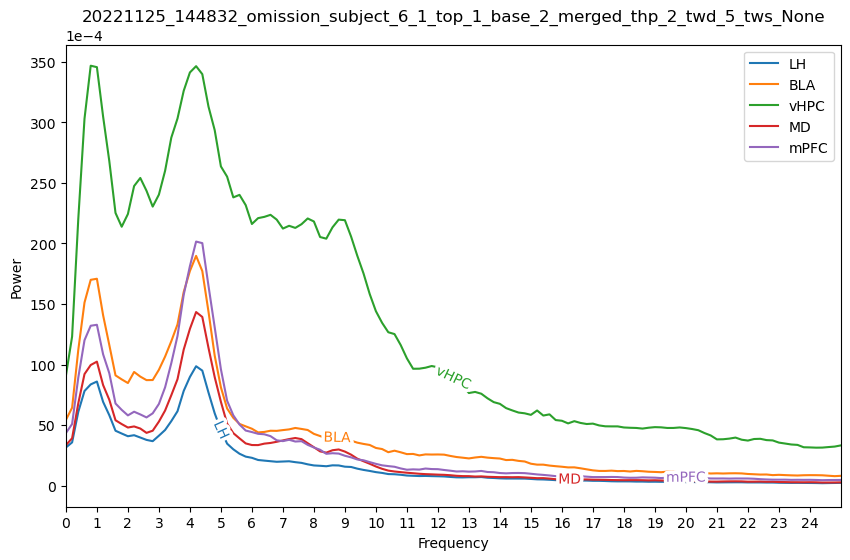

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_2_twd_5_tws_None.png


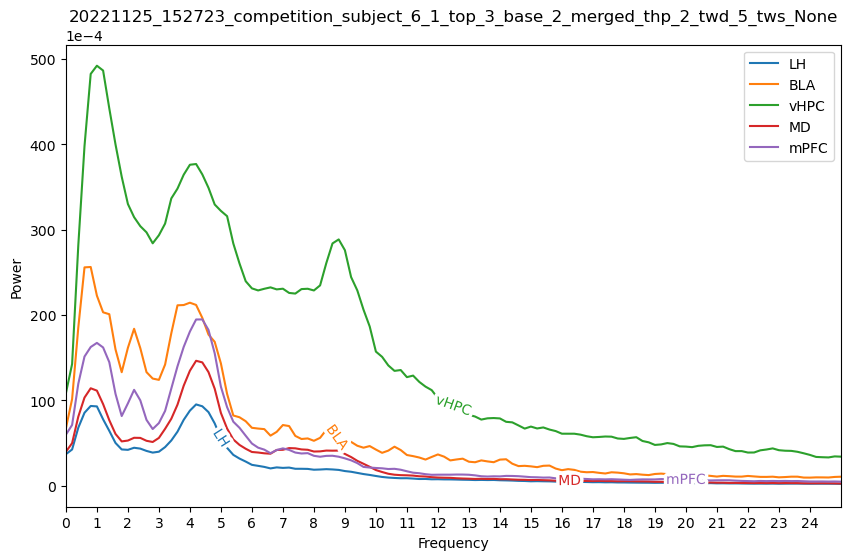

time_halfbandwidth_product: 2, time_window_duration: 5,         tws_ratio: 0.5, time_window_step 2.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_5_tws_2.5_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_5_tws_2.5_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_5_tws_2.5_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_5_tws_2.5_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

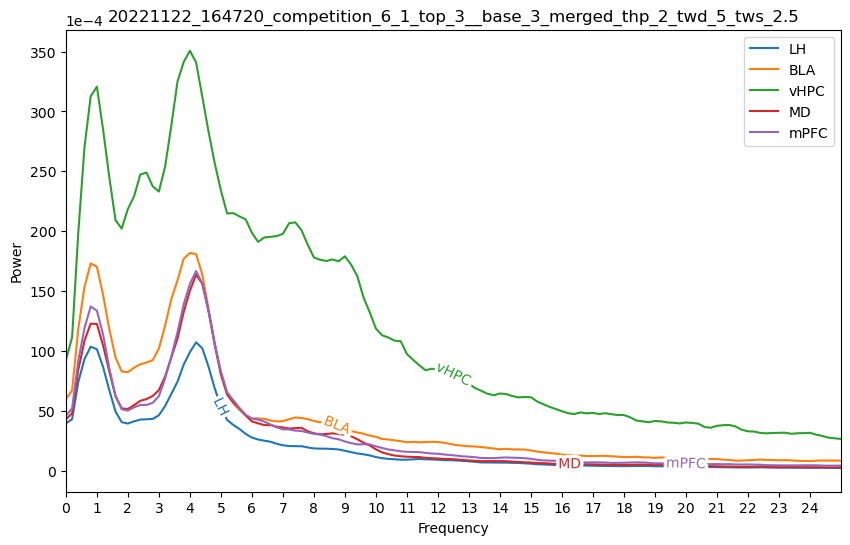

20221122_161341_omission_subject_6_1_top_4_base_2_thp_2_twd_5_tws_2.5.png


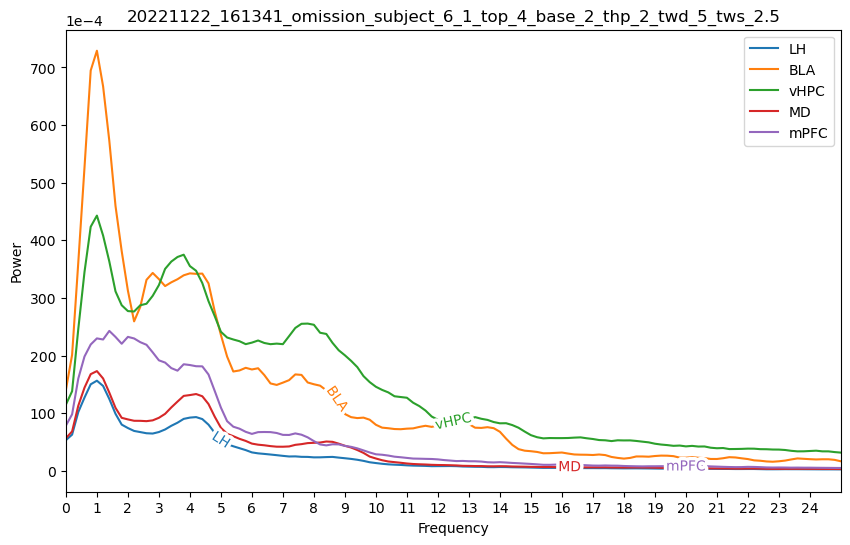

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_2_twd_5_tws_2.5.png


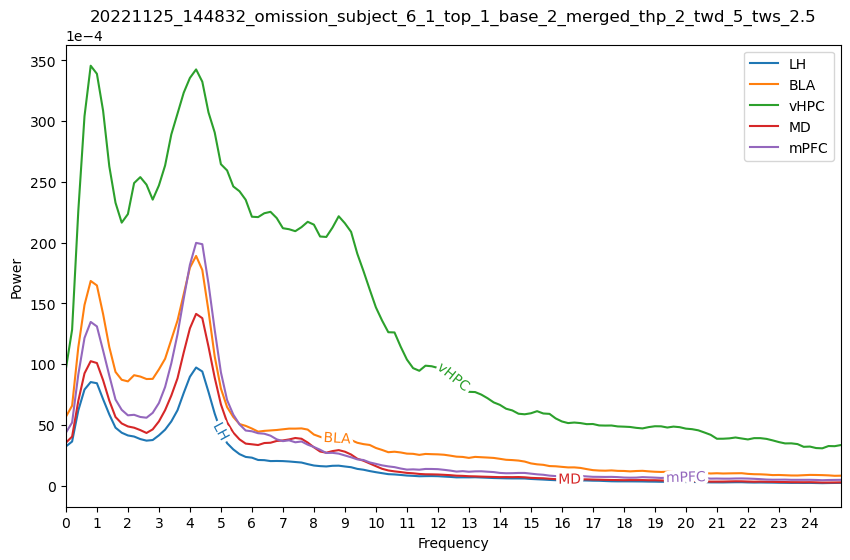

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_2_twd_5_tws_2.5.png


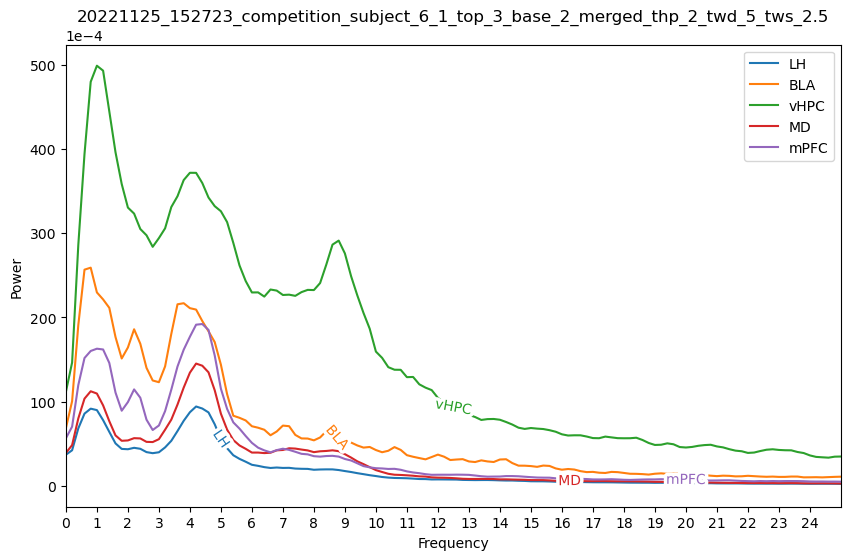

time_halfbandwidth_product: 2, time_window_duration: 5,         tws_ratio: 0.9, time_window_step 4.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_5_tws_4.5_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_5_tws_4.5_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_5_tws_4.5_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_5_tws_4.5_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

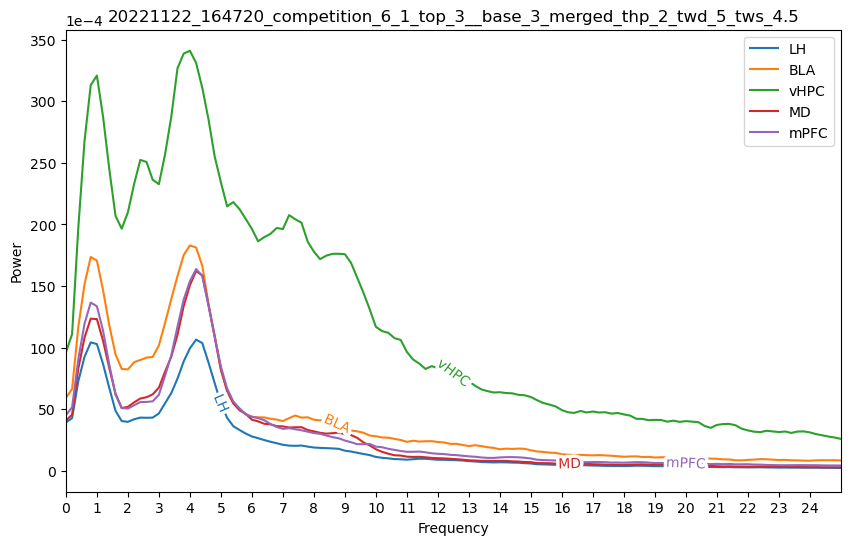

20221122_161341_omission_subject_6_1_top_4_base_2_thp_2_twd_5_tws_4.5.png


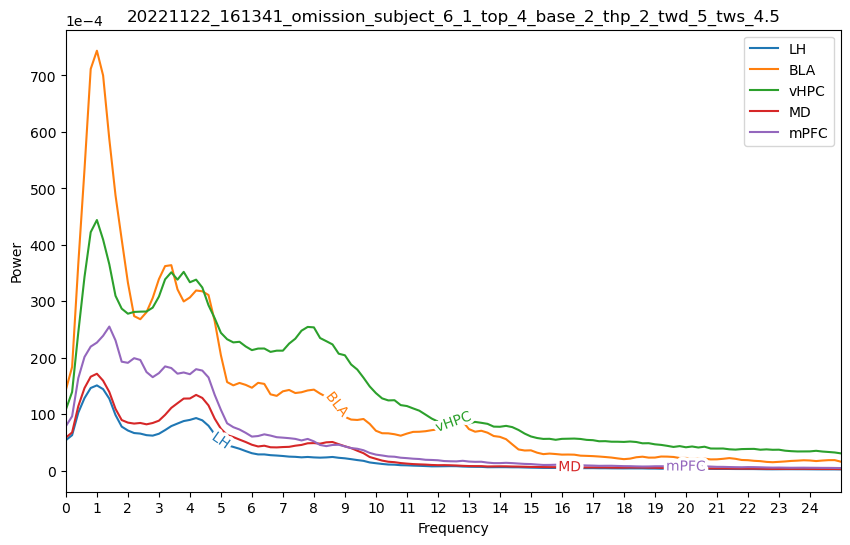

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_2_twd_5_tws_4.5.png


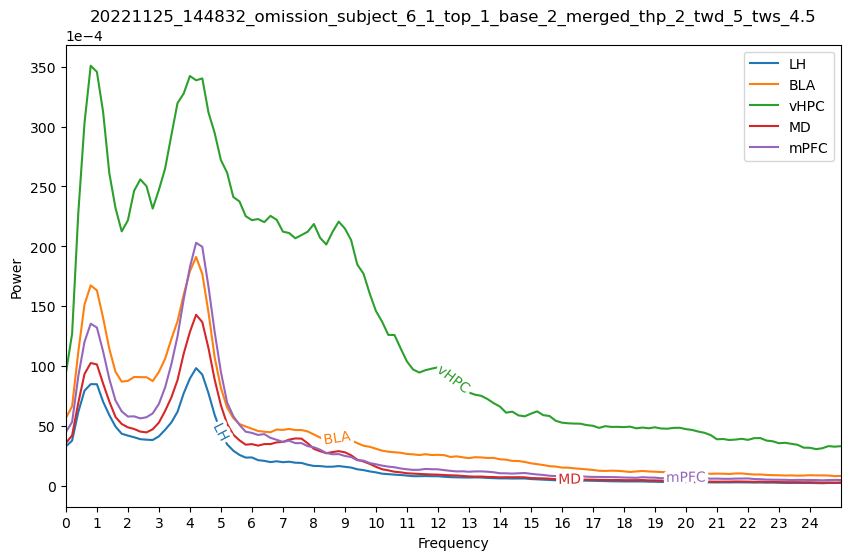

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_2_twd_5_tws_4.5.png


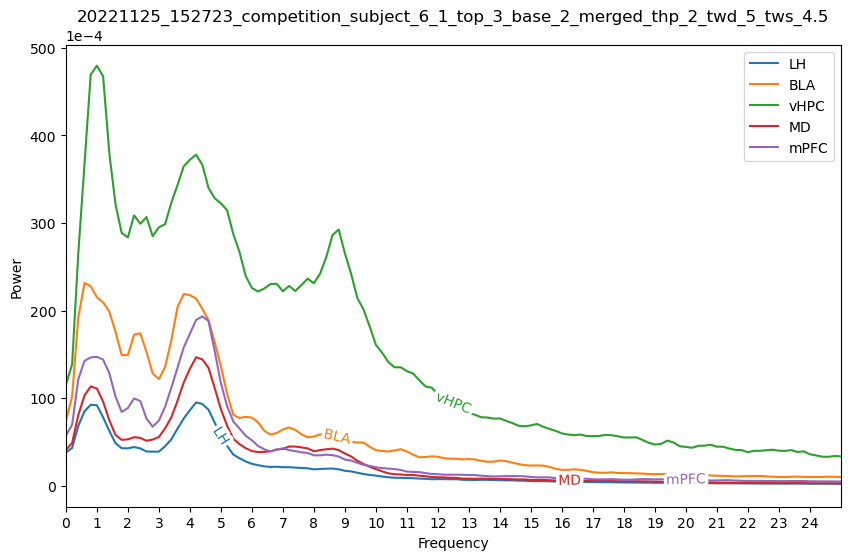

time_halfbandwidth_product: 2, time_window_duration: 7,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_7_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_7_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_7_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_7_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

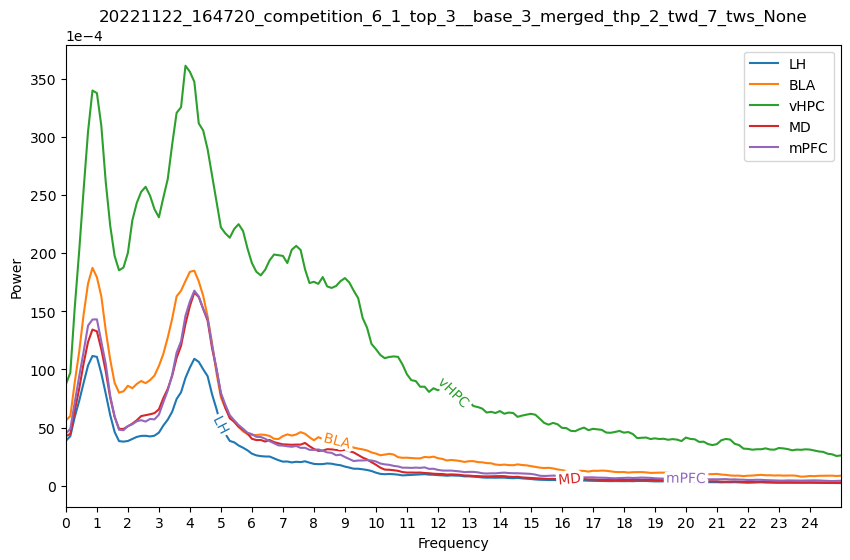

20221122_161341_omission_subject_6_1_top_4_base_2_thp_2_twd_7_tws_None.png


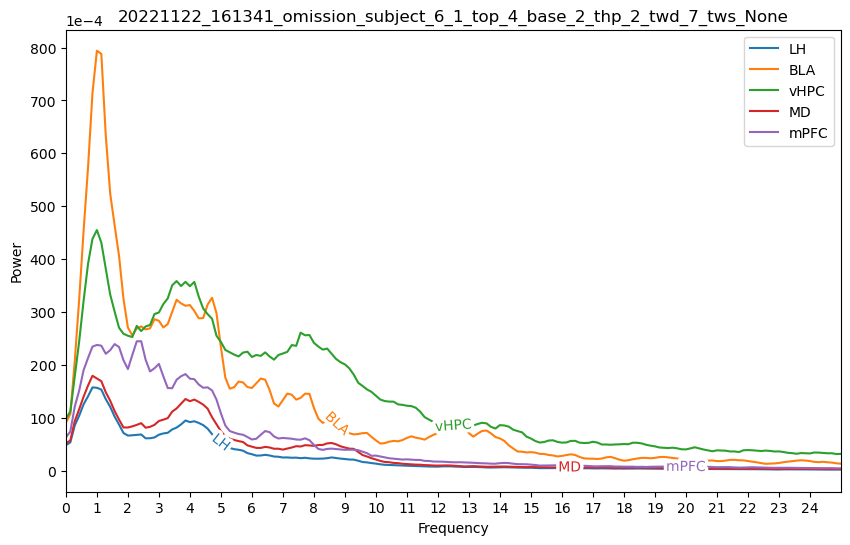

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_2_twd_7_tws_None.png


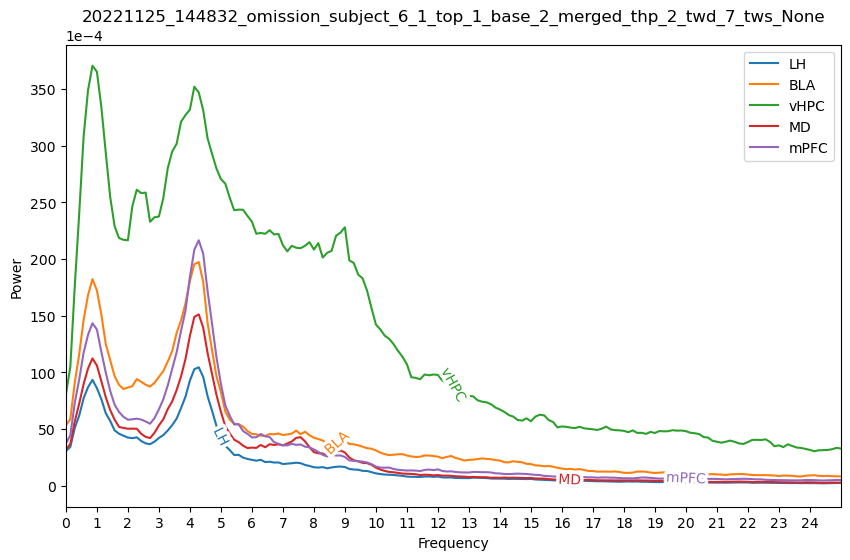

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_2_twd_7_tws_None.png


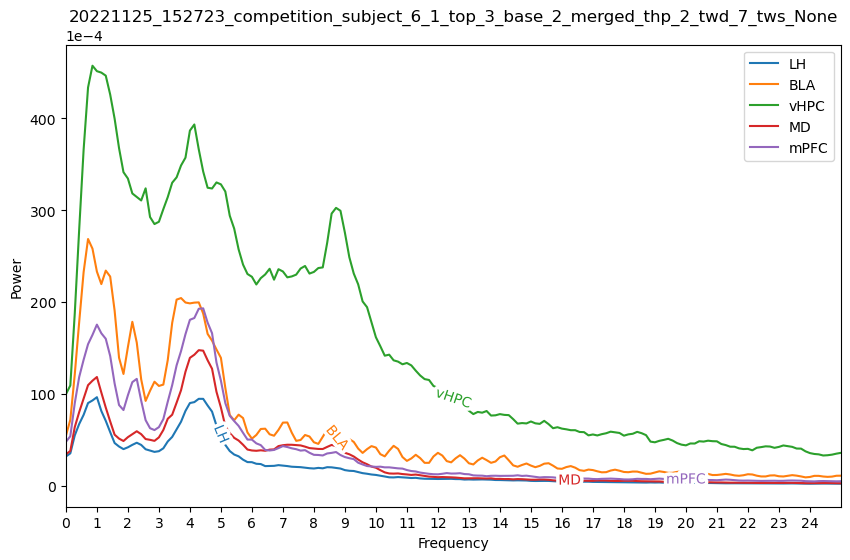

time_halfbandwidth_product: 2, time_window_duration: 7,         tws_ratio: 0.5, time_window_step 3.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_7_tws_3.5_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_7_tws_3.5_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_7_tws_3.5_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_7_tws_3.5_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

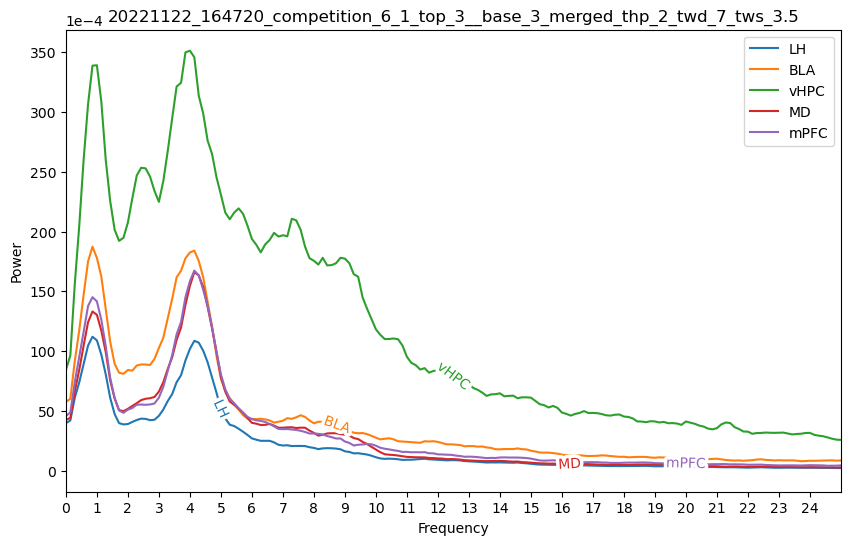

20221122_161341_omission_subject_6_1_top_4_base_2_thp_2_twd_7_tws_3.5.png


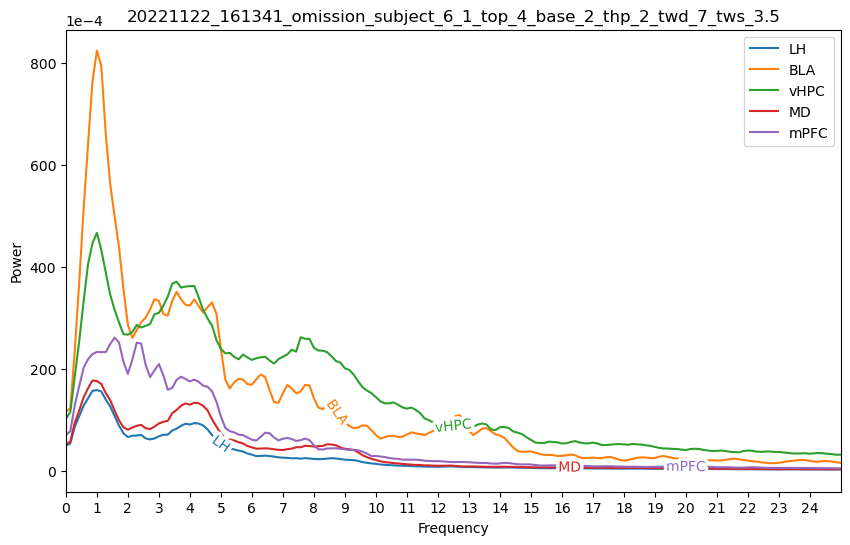

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_2_twd_7_tws_3.5.png


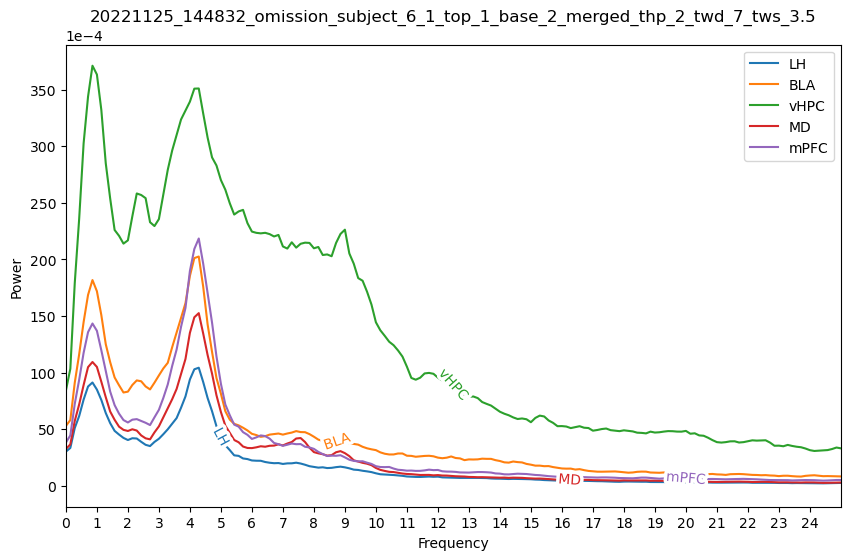

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_2_twd_7_tws_3.5.png


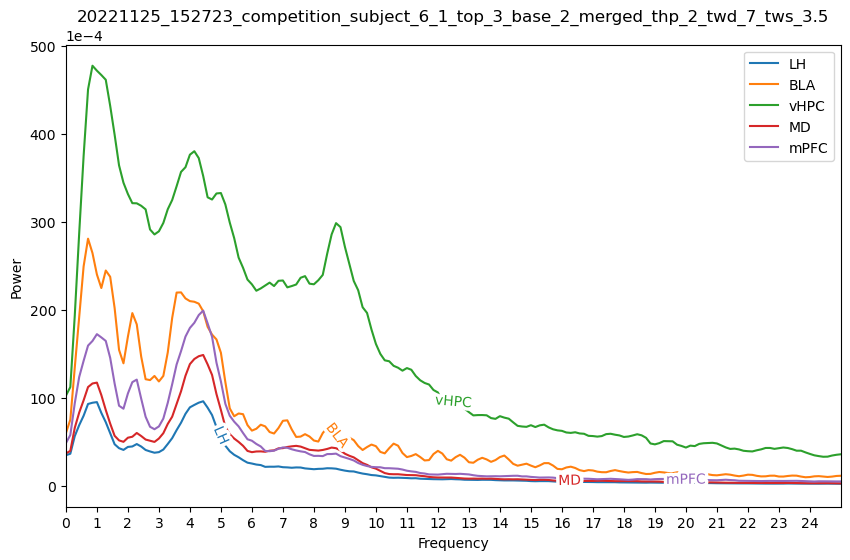

time_halfbandwidth_product: 2, time_window_duration: 7,         tws_ratio: 0.9, time_window_step 6.3
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_7_tws_6.3_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_7_tws_6.3_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_7_tws_6.3_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_7_tws_6.3_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

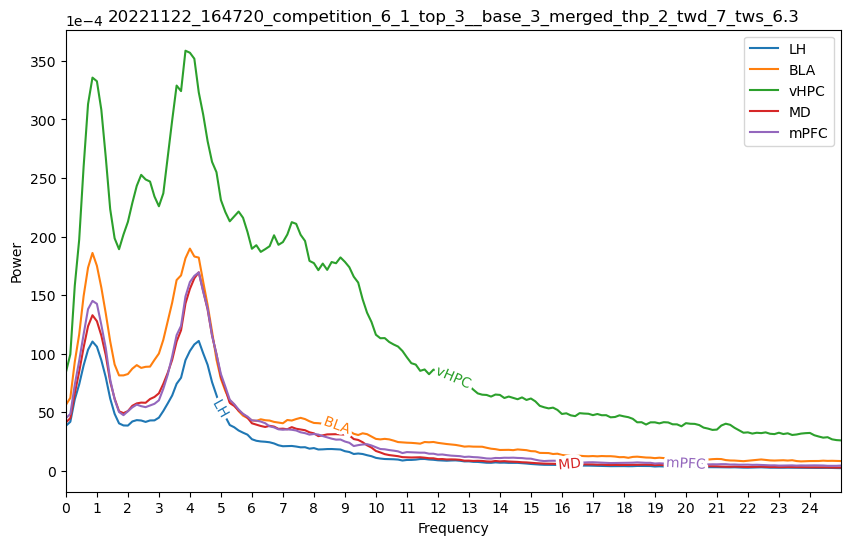

20221122_161341_omission_subject_6_1_top_4_base_2_thp_2_twd_7_tws_6.3.png


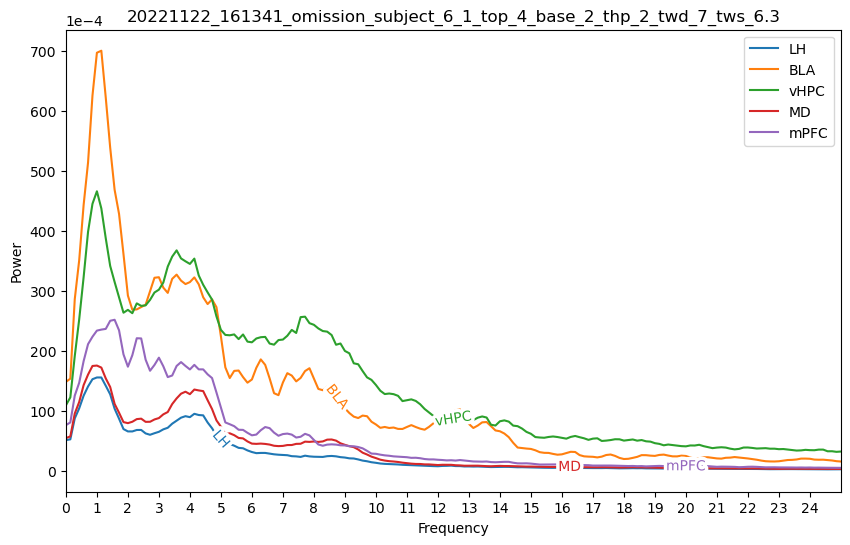

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_2_twd_7_tws_6.3.png


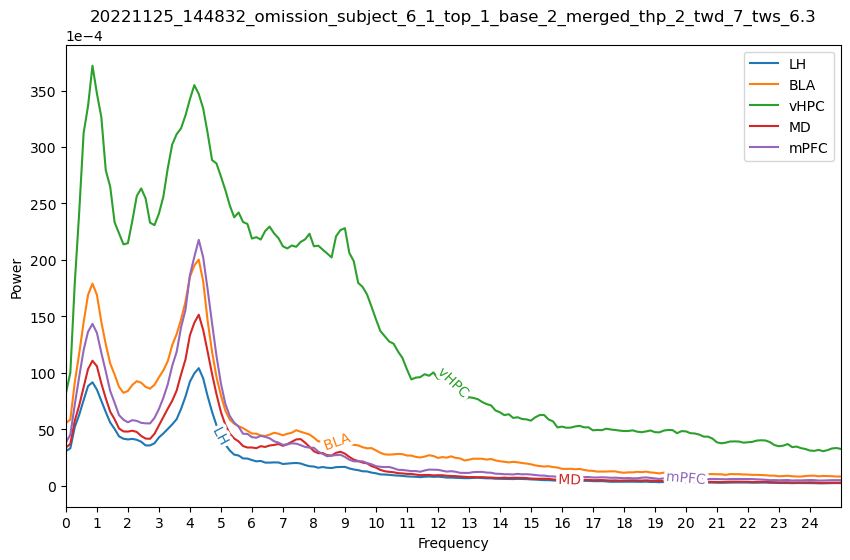

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_2_twd_7_tws_6.3.png


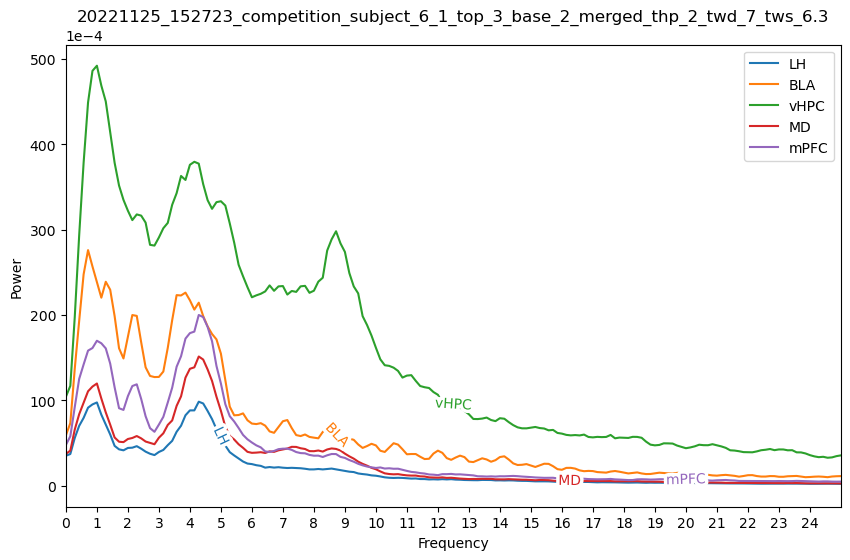

time_halfbandwidth_product: 2, time_window_duration: 10,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_10_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_10_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_10_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_10_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competiti

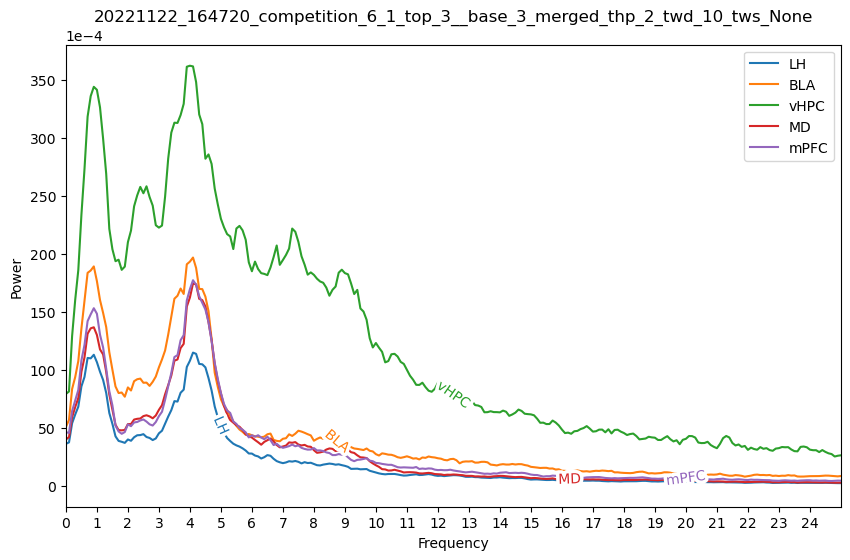

20221122_161341_omission_subject_6_1_top_4_base_2_thp_2_twd_10_tws_None.png


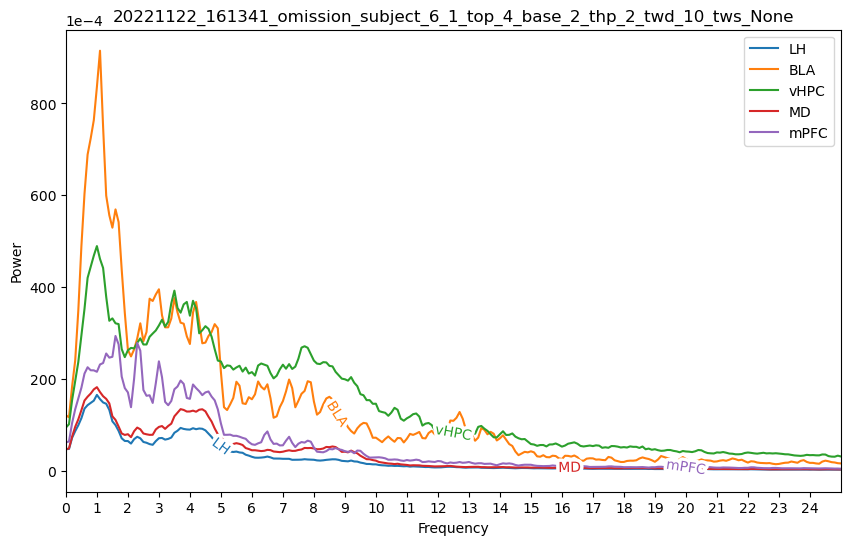

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_2_twd_10_tws_None.png


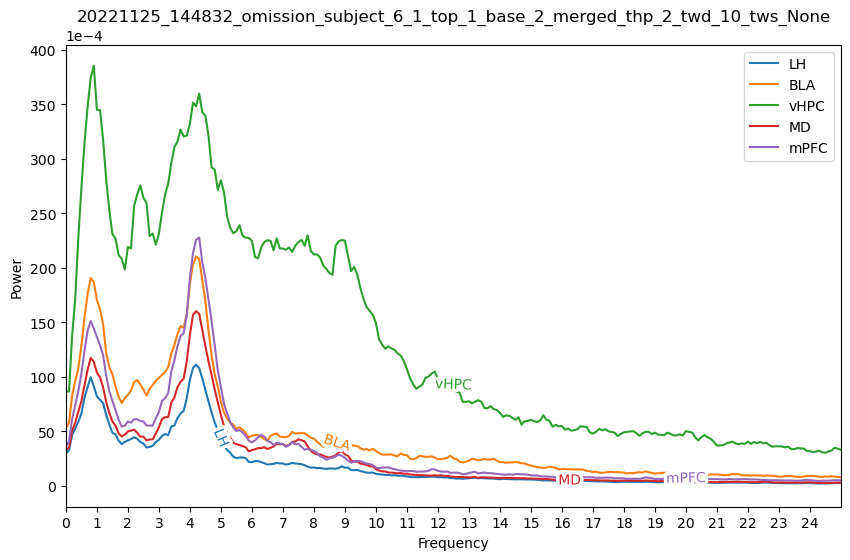

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_2_twd_10_tws_None.png


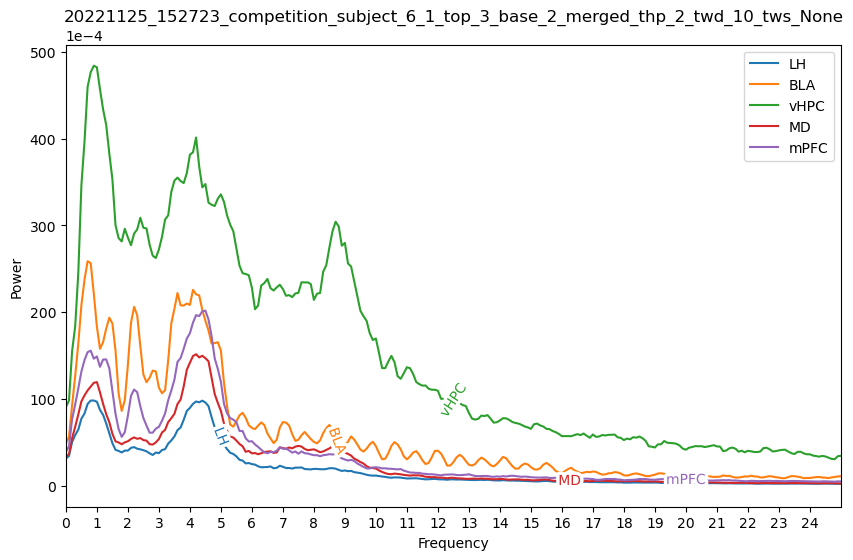

time_halfbandwidth_product: 2, time_window_duration: 10,         tws_ratio: 0.5, time_window_step 5.0
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_10_tws_5.0_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_10_tws_5.0_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_10_tws_5.0_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_10_tws_5.0_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1

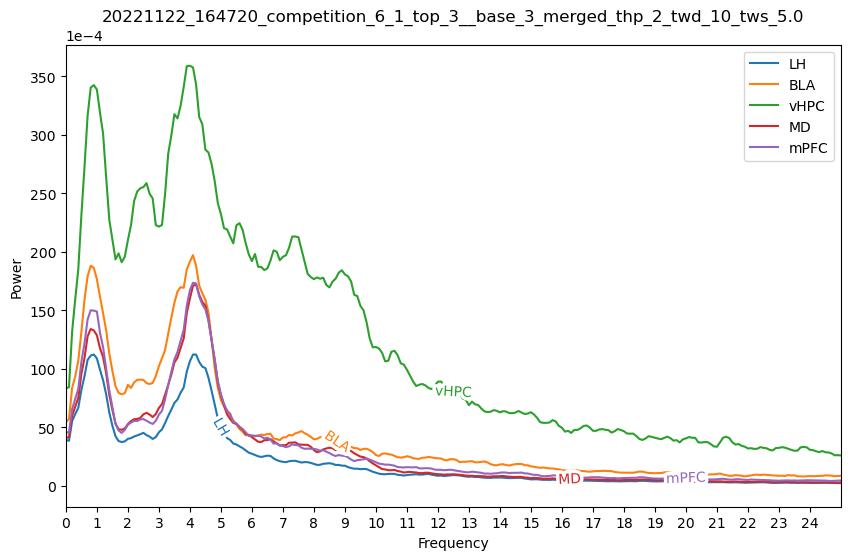

20221122_161341_omission_subject_6_1_top_4_base_2_thp_2_twd_10_tws_5.0.png


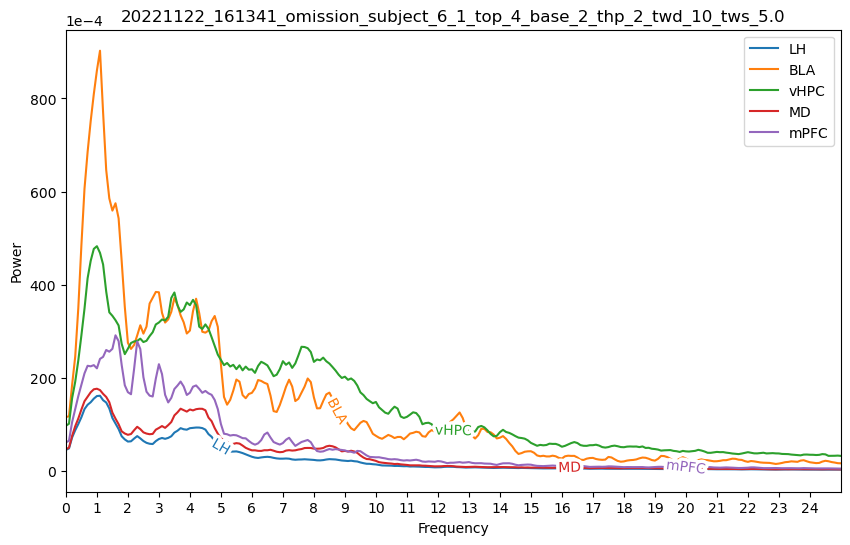

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_2_twd_10_tws_5.0.png


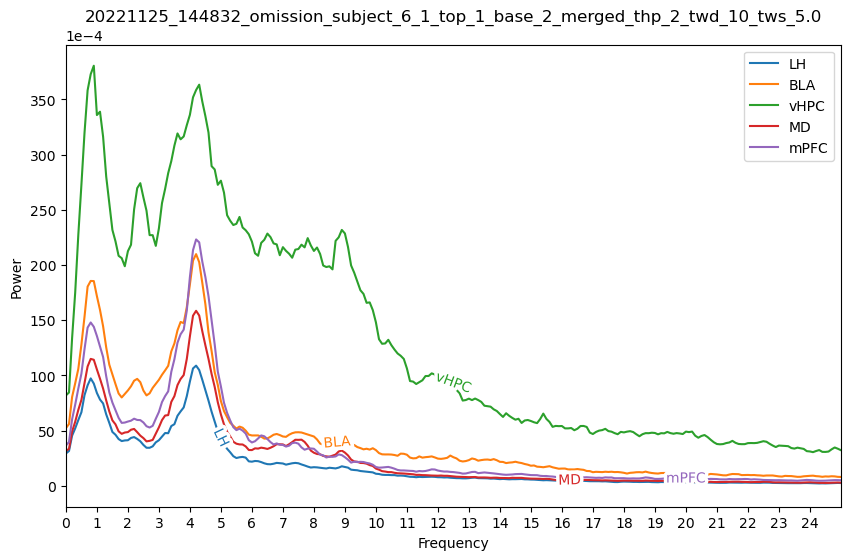

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_2_twd_10_tws_5.0.png


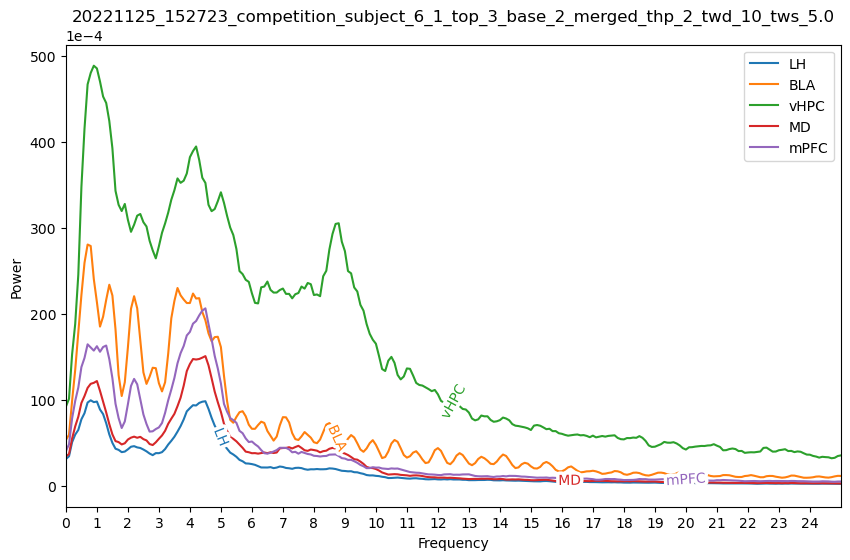

time_halfbandwidth_product: 2, time_window_duration: 10,         tws_ratio: 0.9, time_window_step 9.0
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_10_tws_9.0_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_10_tws_9.0_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_10_tws_9.0_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_2_twd_10_tws_9.0_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1

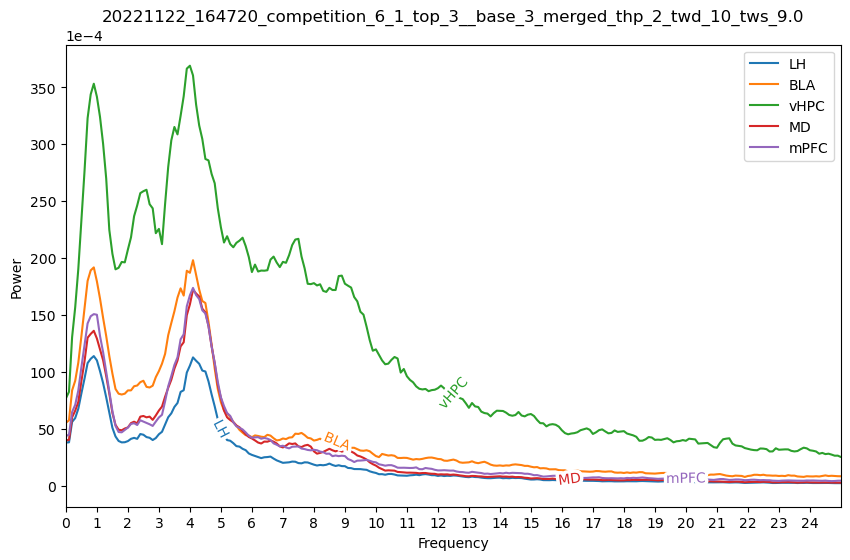

20221122_161341_omission_subject_6_1_top_4_base_2_thp_2_twd_10_tws_9.0.png


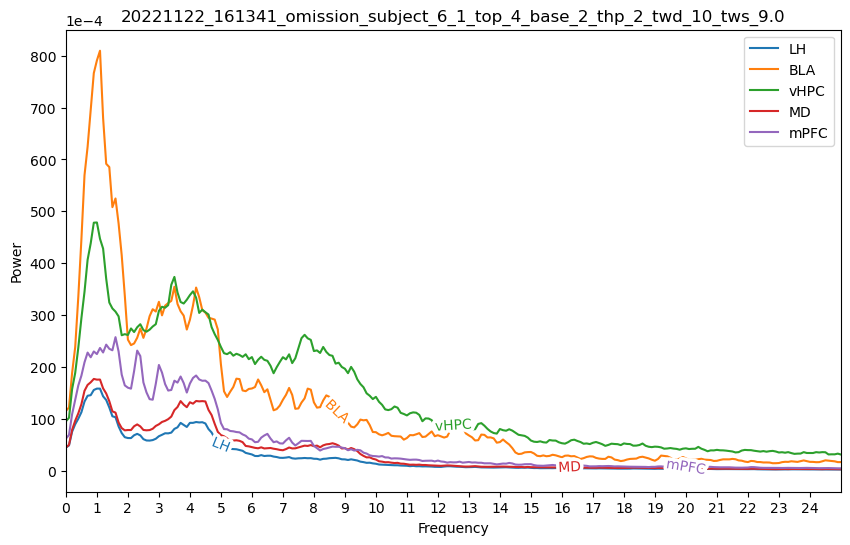

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_2_twd_10_tws_9.0.png


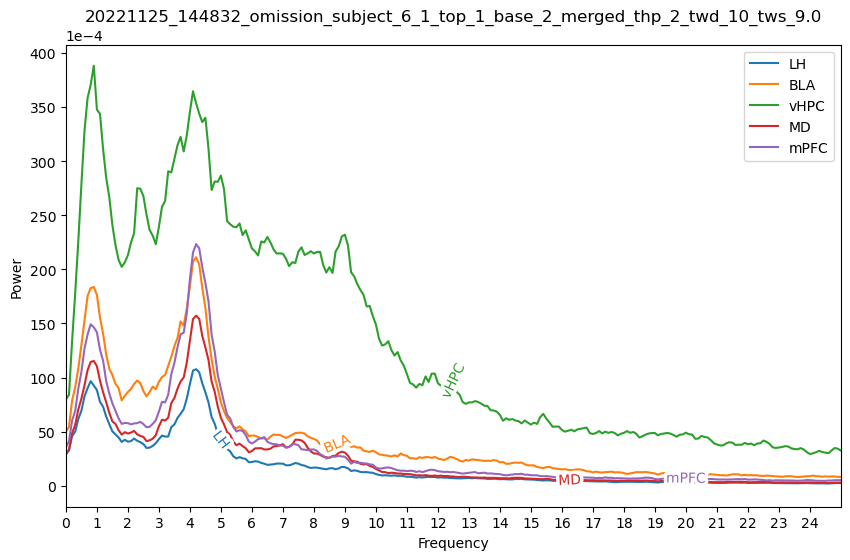

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_2_twd_10_tws_9.0.png


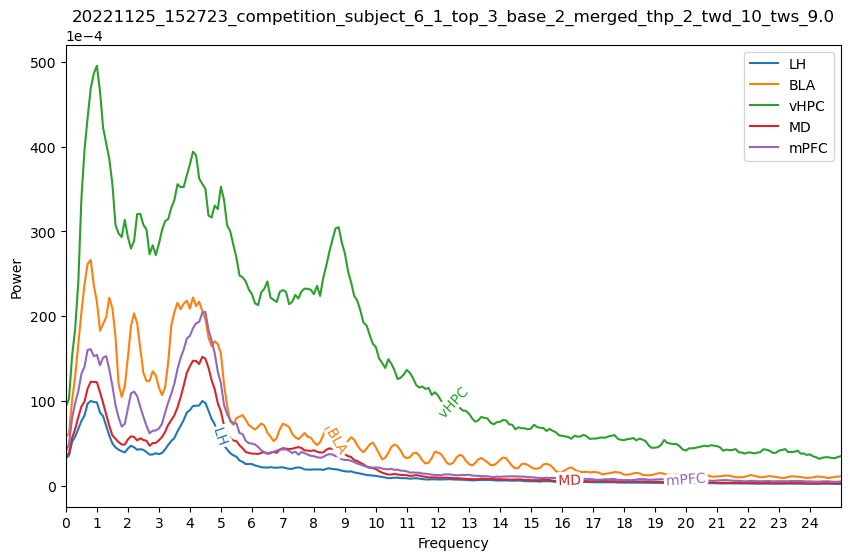

time_halfbandwidth_product: 3, time_window_duration: 1,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_1_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_1_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_1_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_1_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

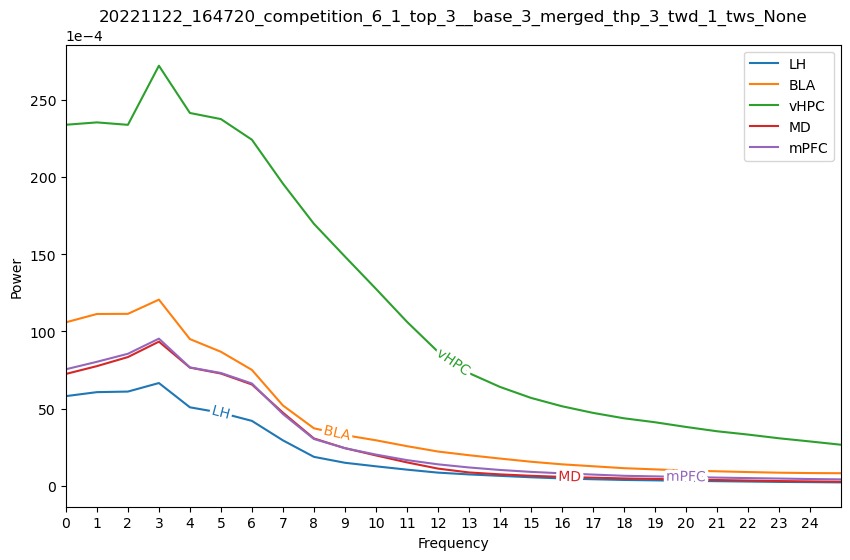

20221122_161341_omission_subject_6_1_top_4_base_2_thp_3_twd_1_tws_None.png


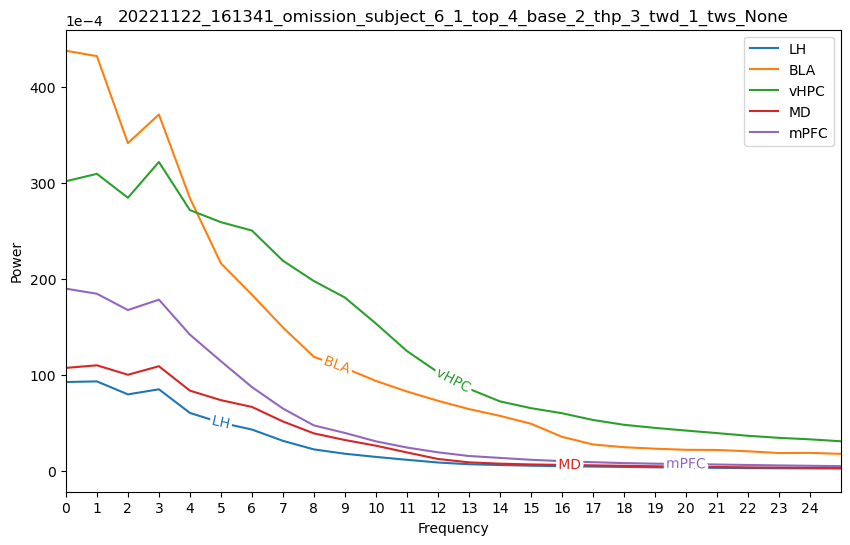

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_3_twd_1_tws_None.png


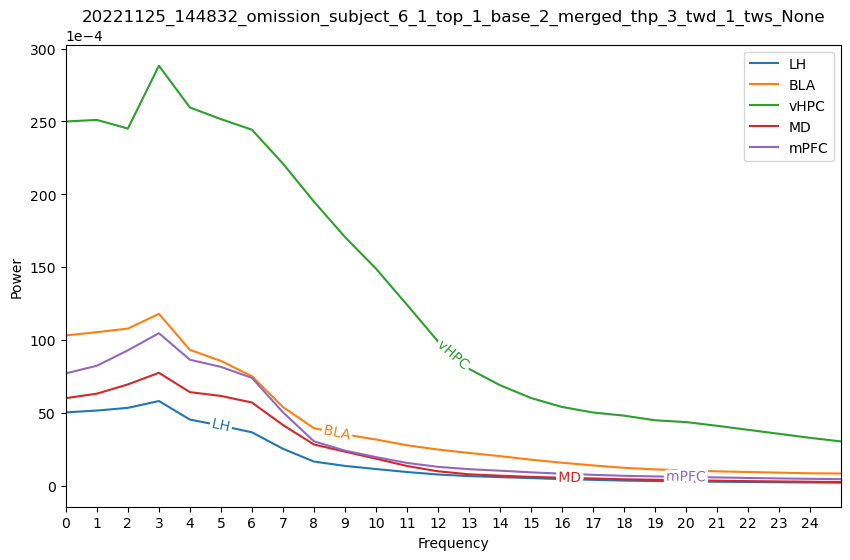

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_3_twd_1_tws_None.png


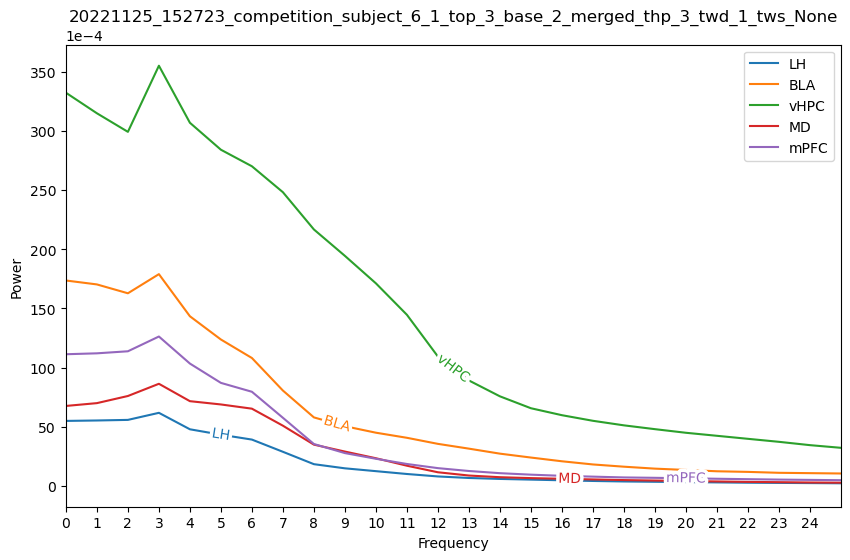

time_halfbandwidth_product: 3, time_window_duration: 1,         tws_ratio: 0.5, time_window_step 0.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_1_tws_0.5_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_1_tws_0.5_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_1_tws_0.5_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_1_tws_0.5_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

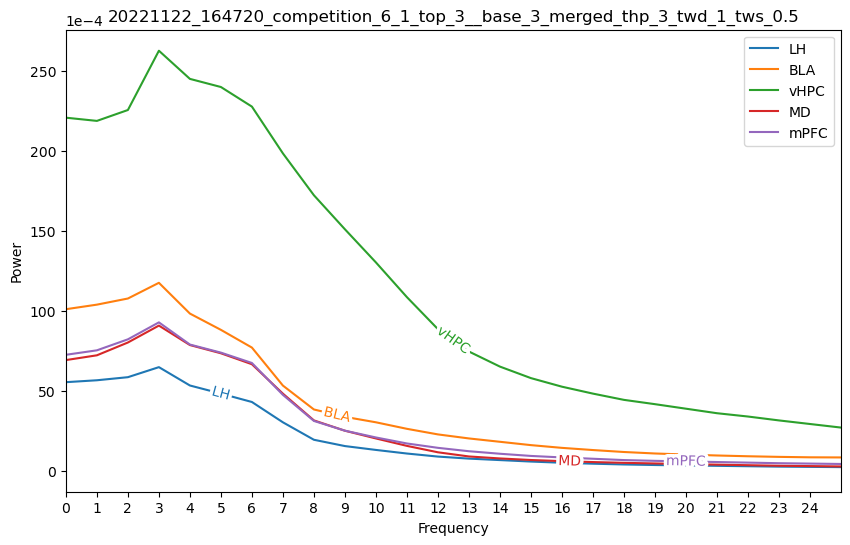

20221122_161341_omission_subject_6_1_top_4_base_2_thp_3_twd_1_tws_0.5.png


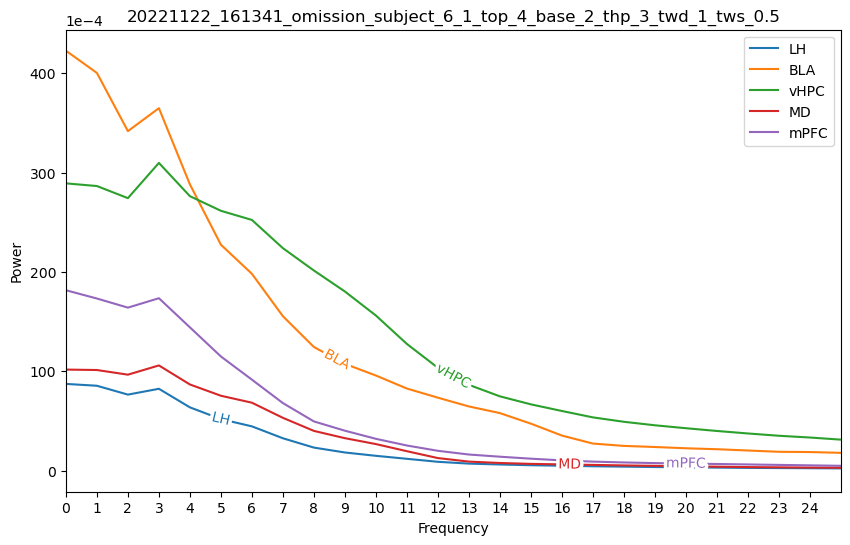

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_3_twd_1_tws_0.5.png


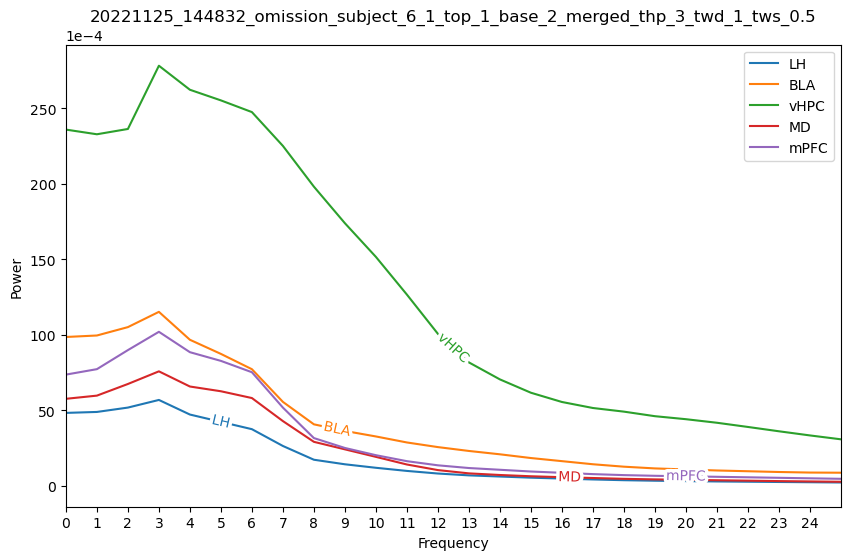

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_3_twd_1_tws_0.5.png


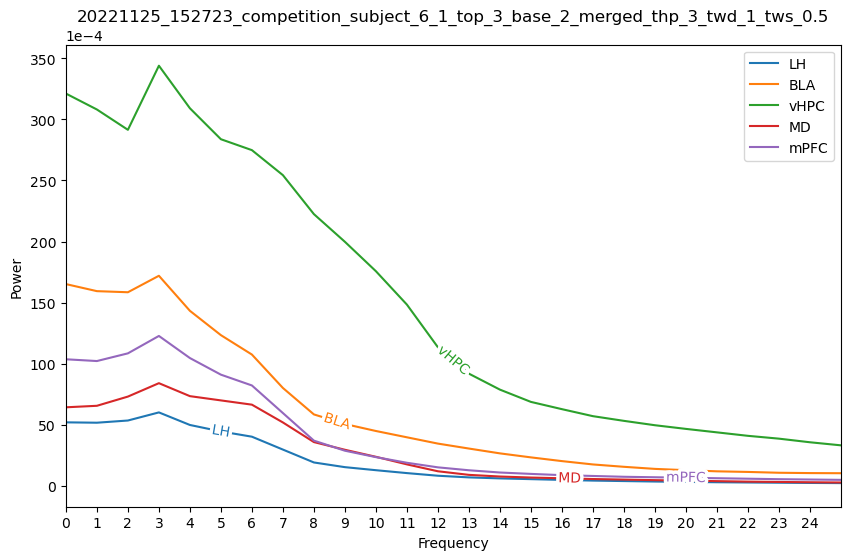

time_halfbandwidth_product: 3, time_window_duration: 1,         tws_ratio: 0.9, time_window_step 0.9
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_1_tws_0.9_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_1_tws_0.9_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_1_tws_0.9_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_1_tws_0.9_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

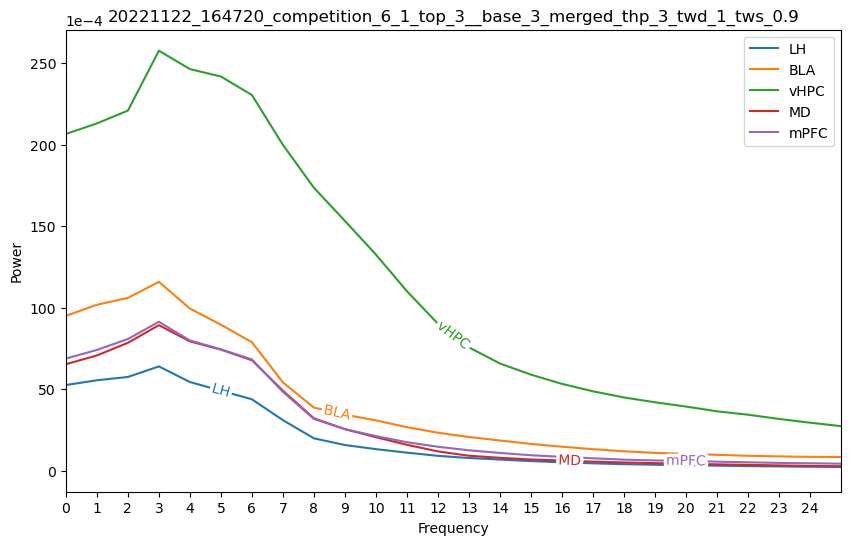

20221122_161341_omission_subject_6_1_top_4_base_2_thp_3_twd_1_tws_0.9.png


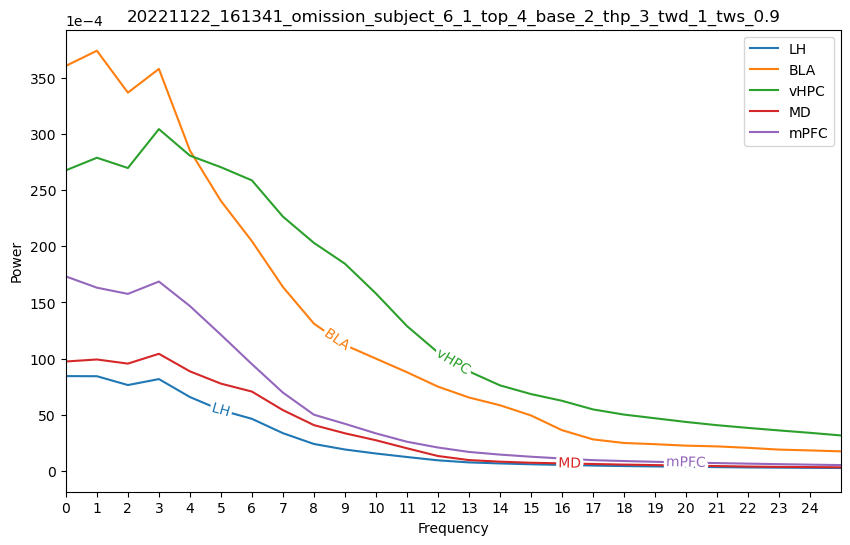

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_3_twd_1_tws_0.9.png


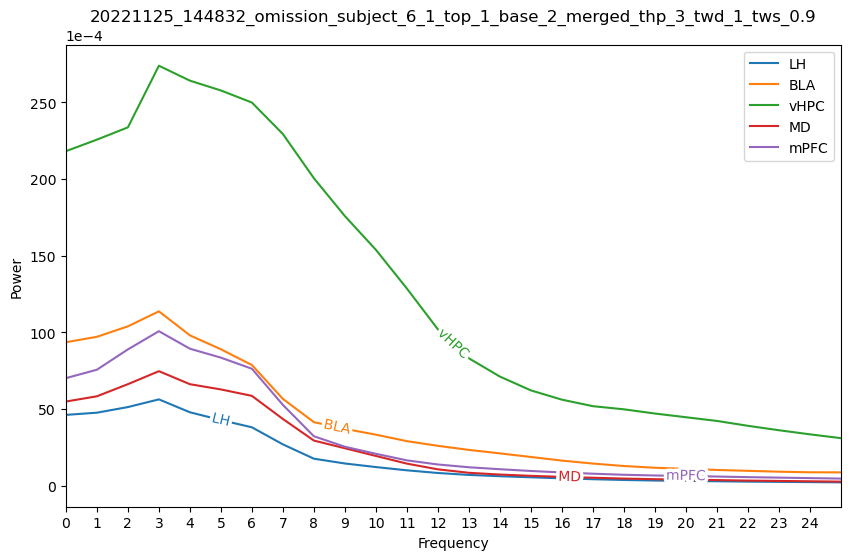

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_3_twd_1_tws_0.9.png


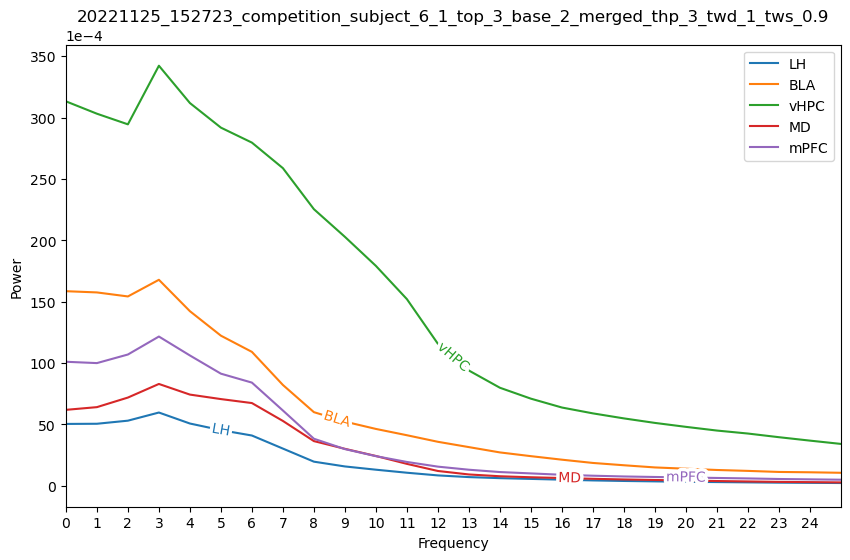

time_halfbandwidth_product: 3, time_window_duration: 2,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_2_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_2_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_2_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_2_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

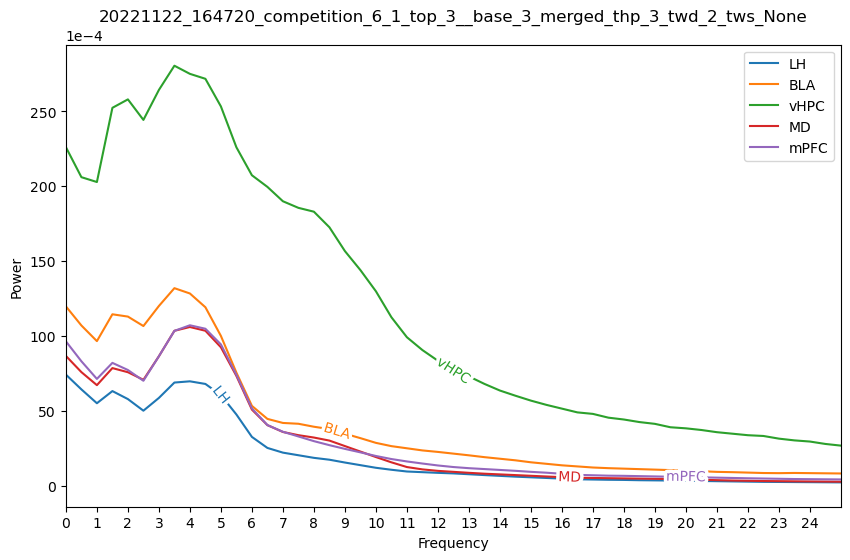

20221122_161341_omission_subject_6_1_top_4_base_2_thp_3_twd_2_tws_None.png


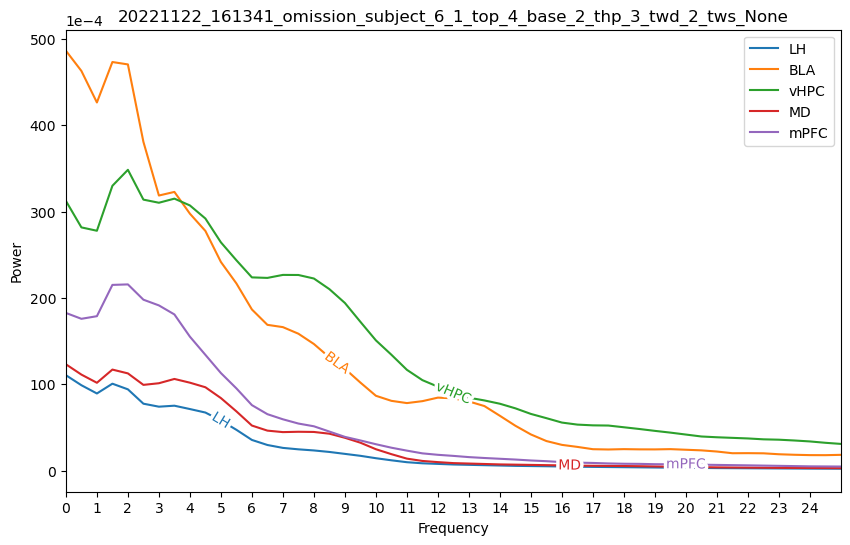

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_3_twd_2_tws_None.png


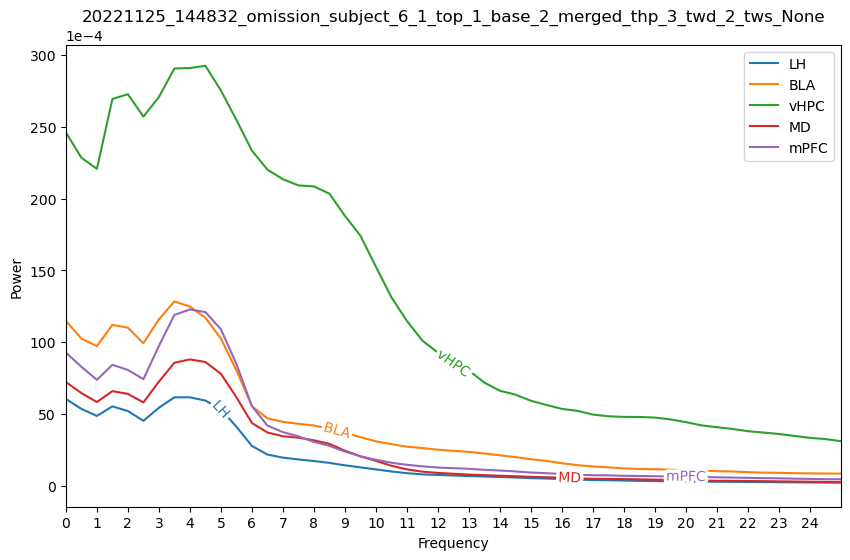

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_3_twd_2_tws_None.png


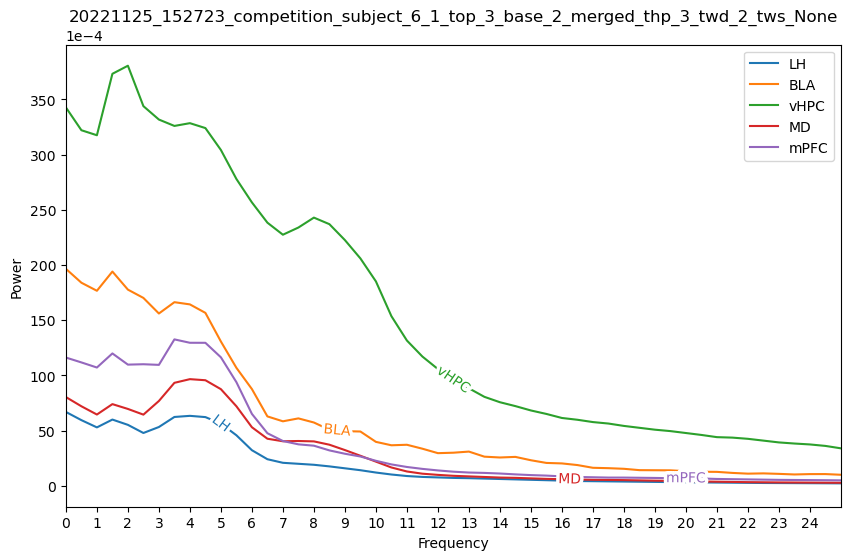

time_halfbandwidth_product: 3, time_window_duration: 2,         tws_ratio: 0.5, time_window_step 1.0
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_2_tws_1.0_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_2_tws_1.0_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_2_tws_1.0_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_2_tws_1.0_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

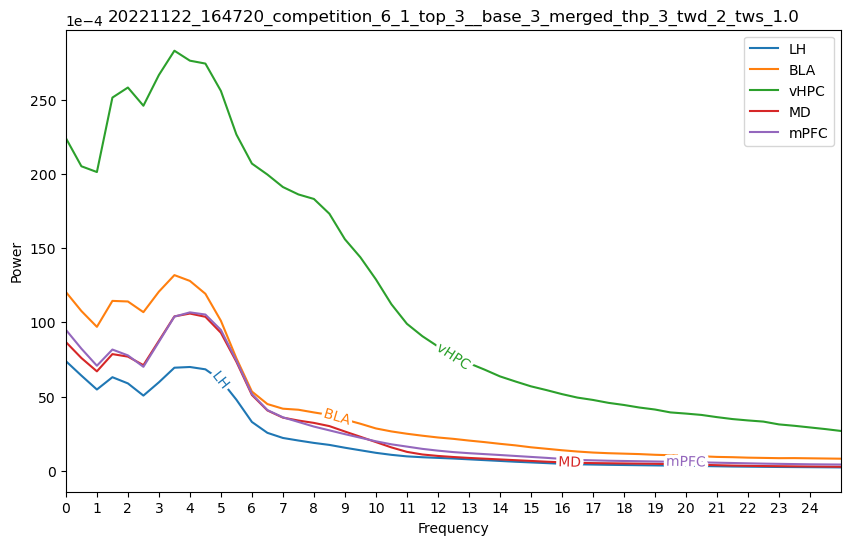

20221122_161341_omission_subject_6_1_top_4_base_2_thp_3_twd_2_tws_1.0.png


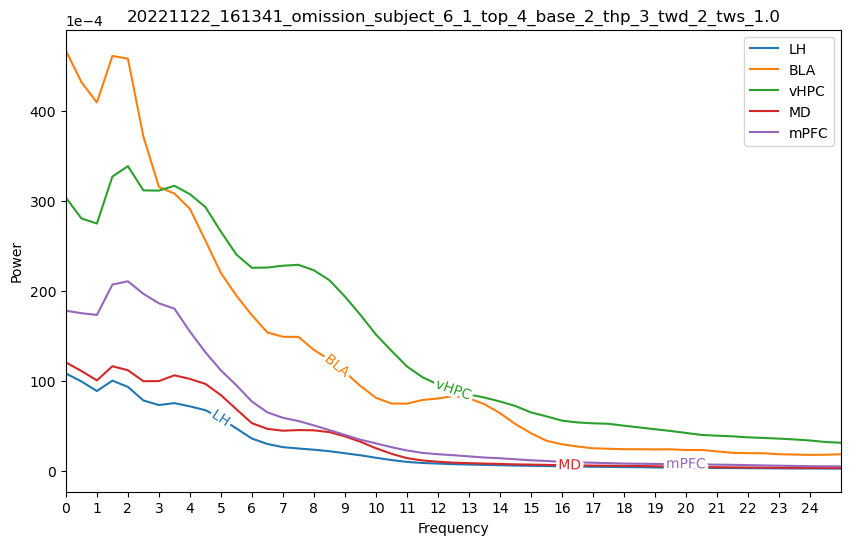

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_3_twd_2_tws_1.0.png


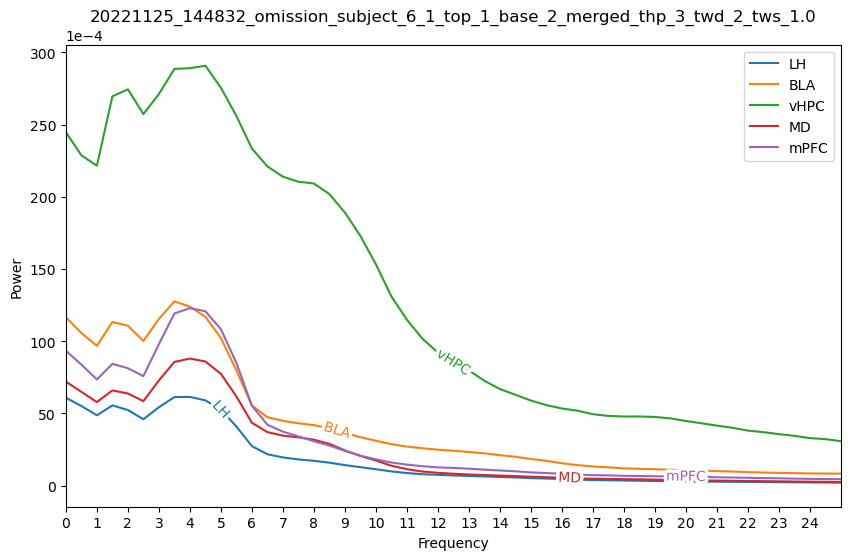

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_3_twd_2_tws_1.0.png


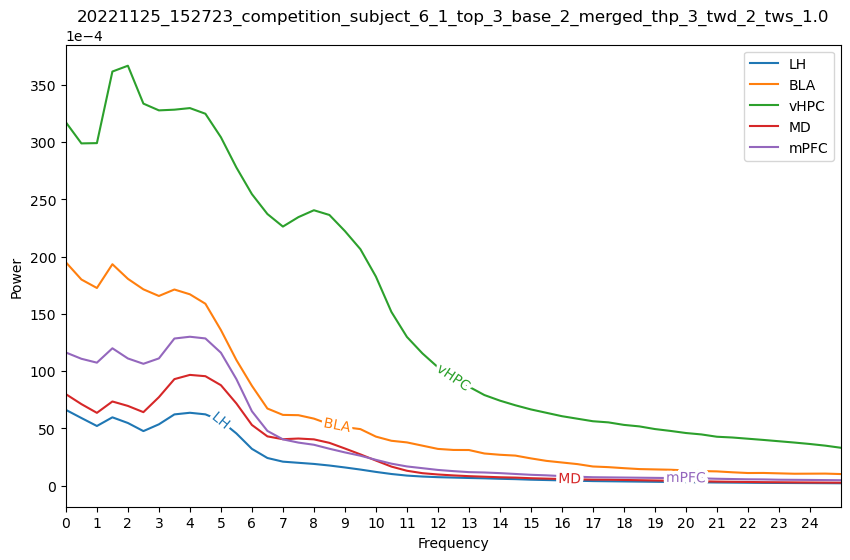

time_halfbandwidth_product: 3, time_window_duration: 2,         tws_ratio: 0.9, time_window_step 1.8
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_2_tws_1.8_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_2_tws_1.8_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_2_tws_1.8_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_2_tws_1.8_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

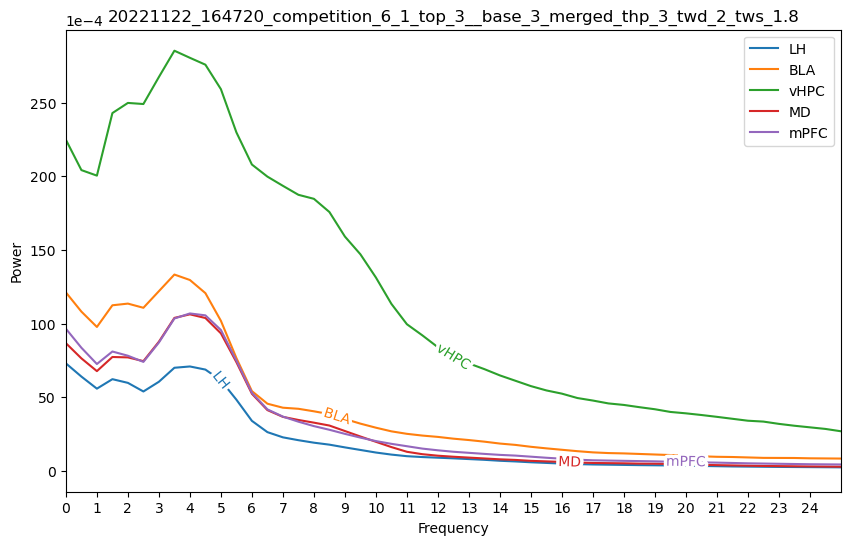

20221122_161341_omission_subject_6_1_top_4_base_2_thp_3_twd_2_tws_1.8.png


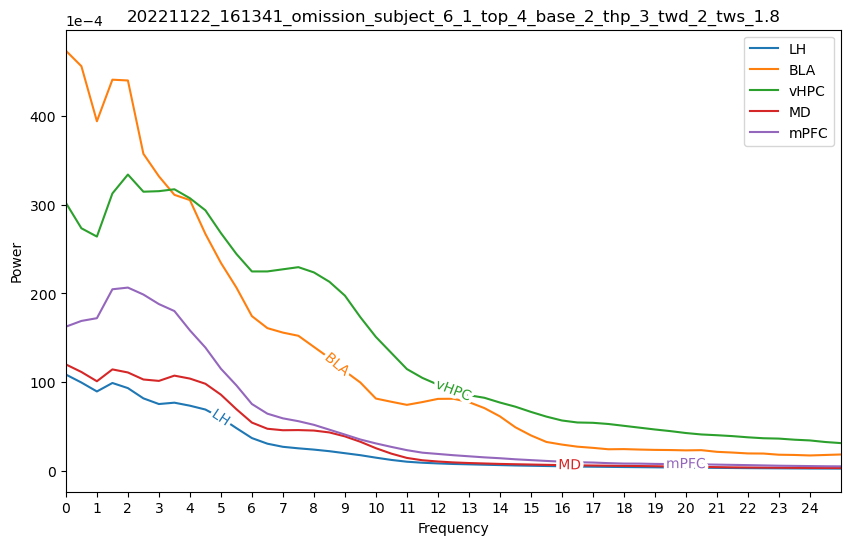

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_3_twd_2_tws_1.8.png


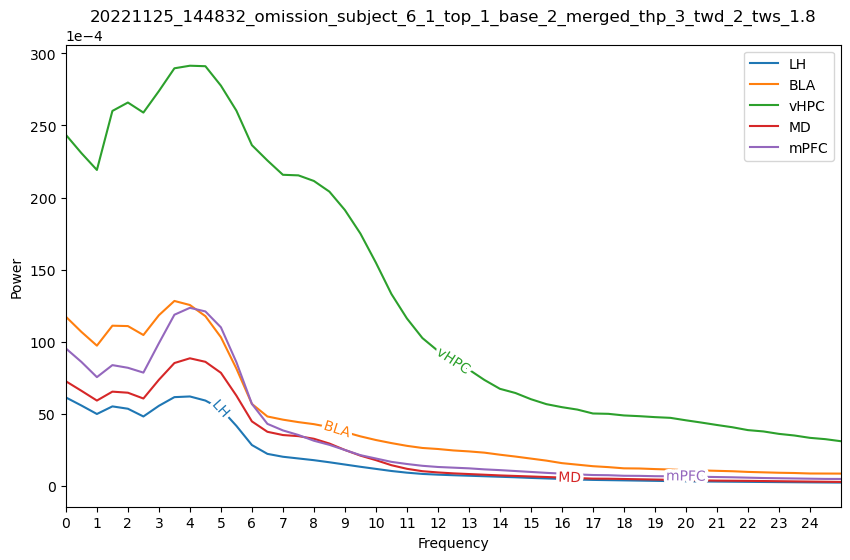

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_3_twd_2_tws_1.8.png


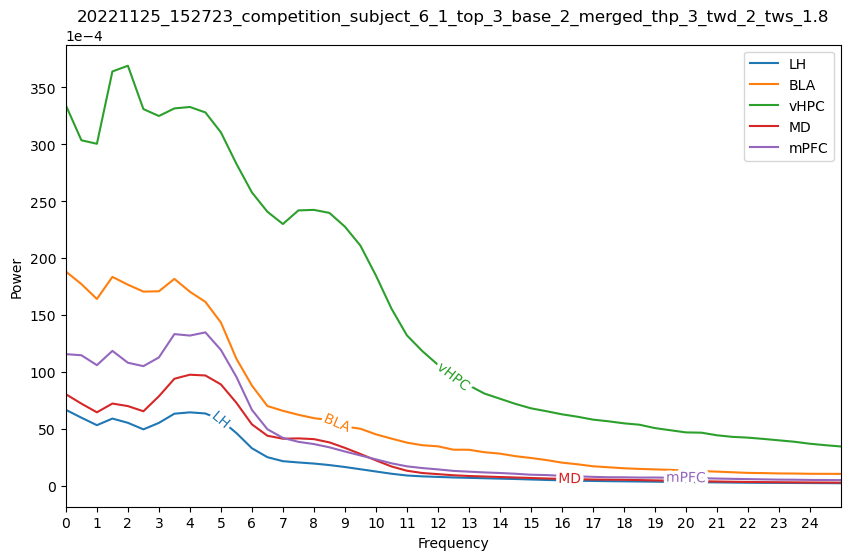

time_halfbandwidth_product: 3, time_window_duration: 3,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_3_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_3_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_3_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_3_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

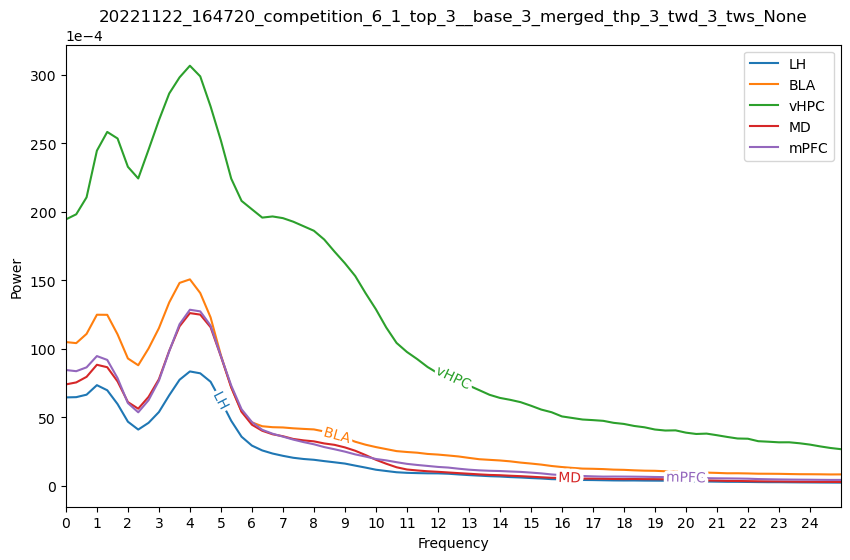

20221122_161341_omission_subject_6_1_top_4_base_2_thp_3_twd_3_tws_None.png


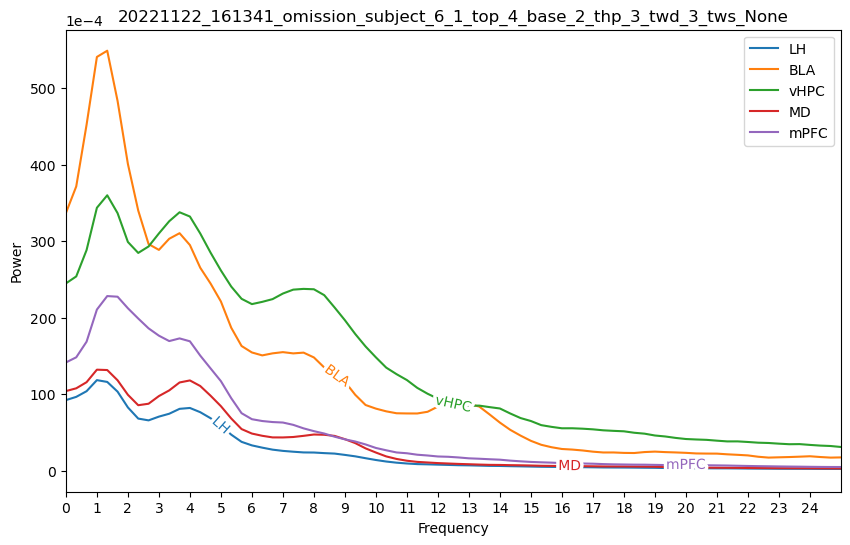

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_3_twd_3_tws_None.png


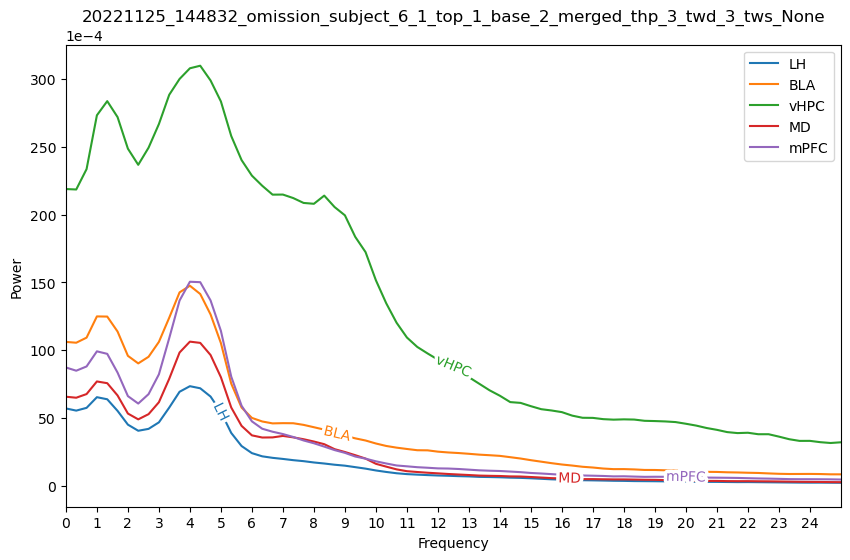

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_3_twd_3_tws_None.png


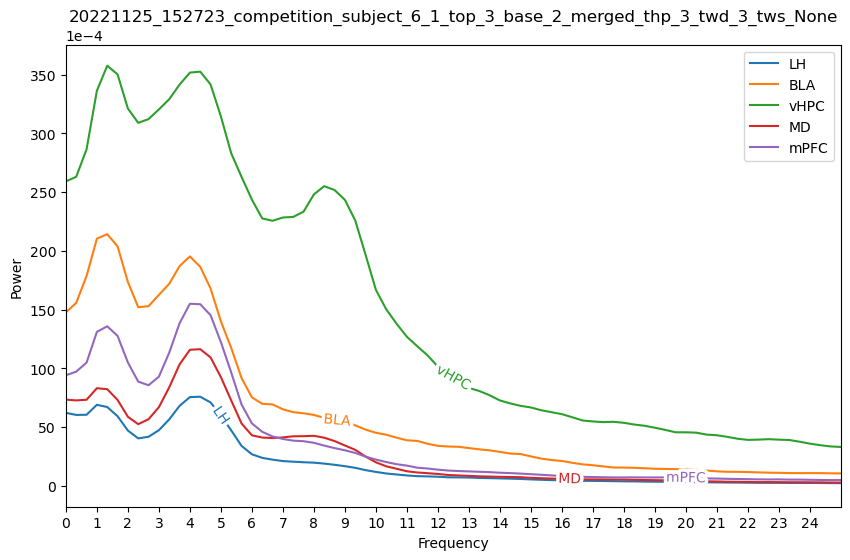

time_halfbandwidth_product: 3, time_window_duration: 3,         tws_ratio: 0.5, time_window_step 1.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_3_tws_1.5_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_3_tws_1.5_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_3_tws_1.5_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_3_tws_1.5_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

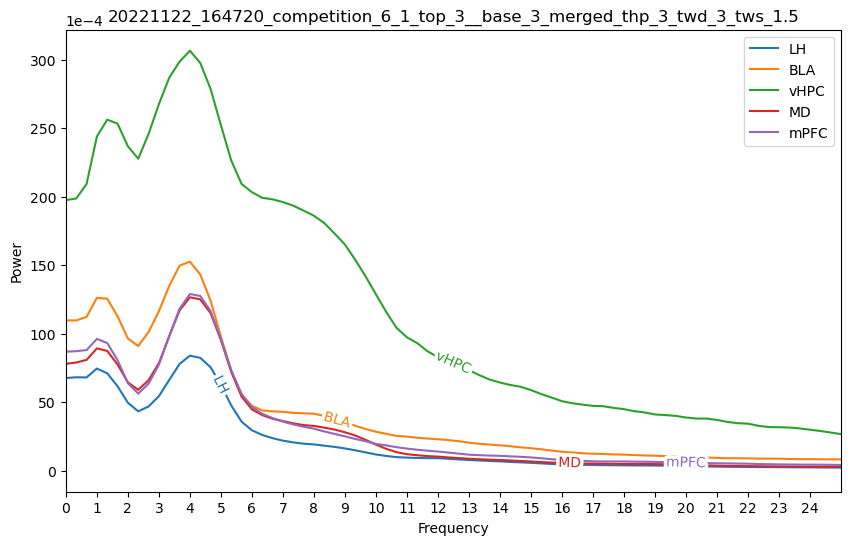

20221122_161341_omission_subject_6_1_top_4_base_2_thp_3_twd_3_tws_1.5.png


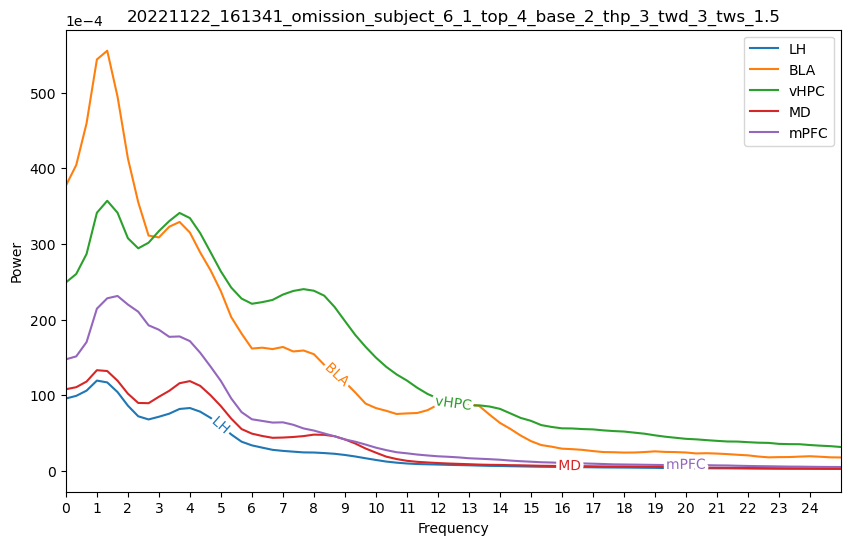

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_3_twd_3_tws_1.5.png


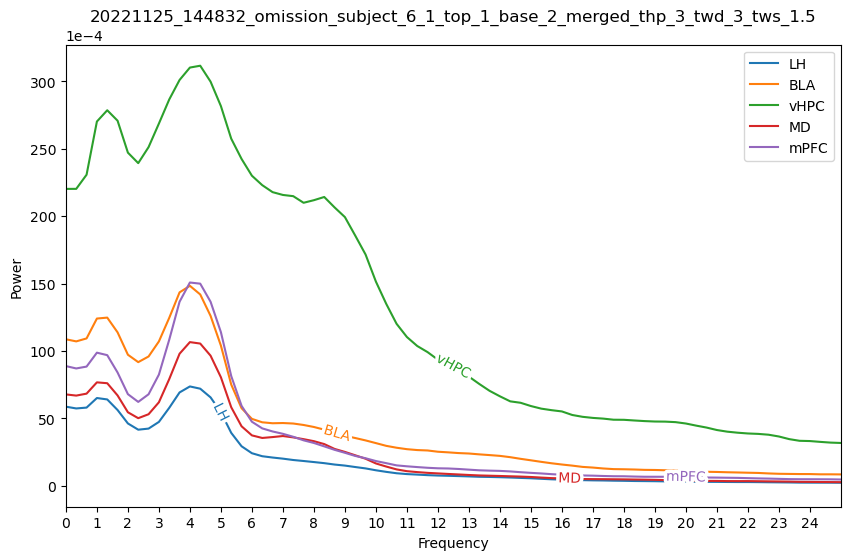

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_3_twd_3_tws_1.5.png


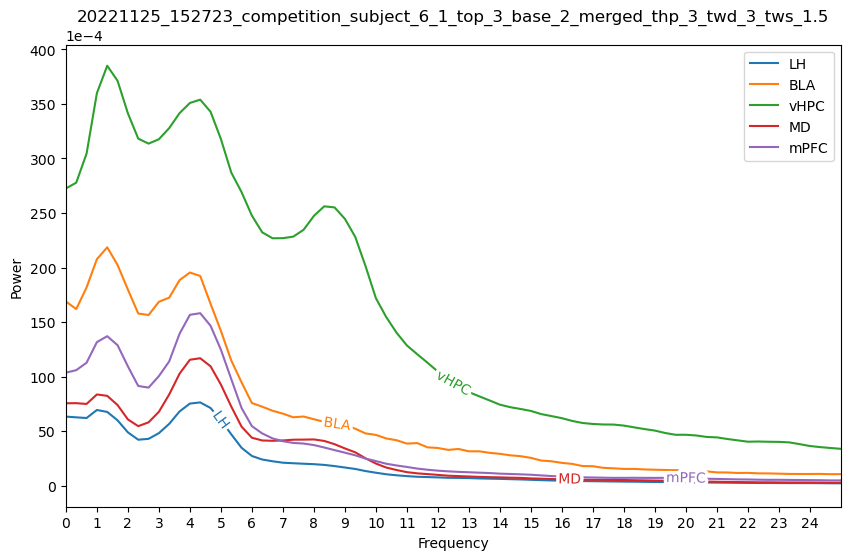

time_halfbandwidth_product: 3, time_window_duration: 3,         tws_ratio: 0.9, time_window_step 2.7
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_3_tws_2.7_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_3_tws_2.7_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_3_tws_2.7_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_3_tws_2.7_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

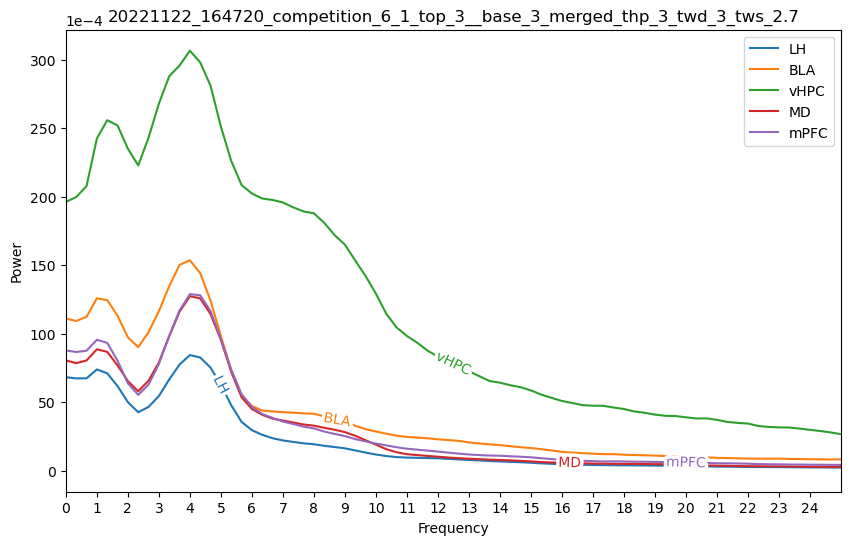

20221122_161341_omission_subject_6_1_top_4_base_2_thp_3_twd_3_tws_2.7.png


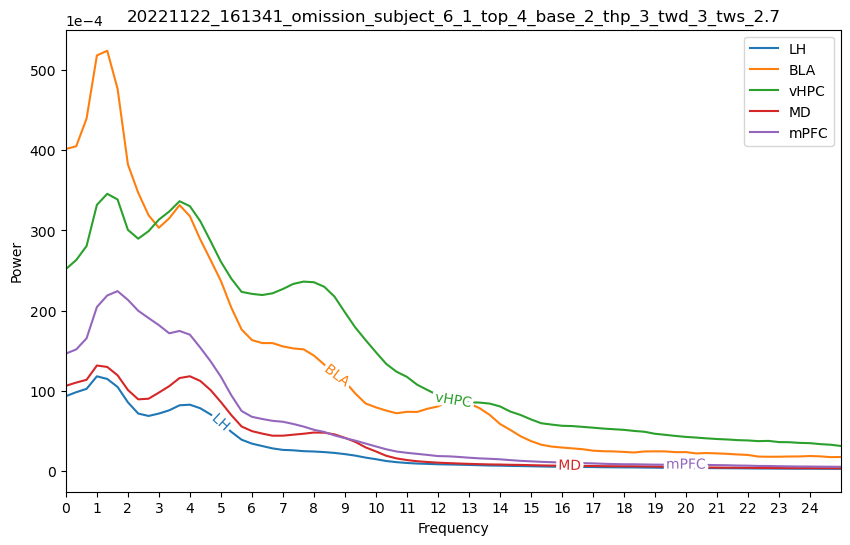

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_3_twd_3_tws_2.7.png


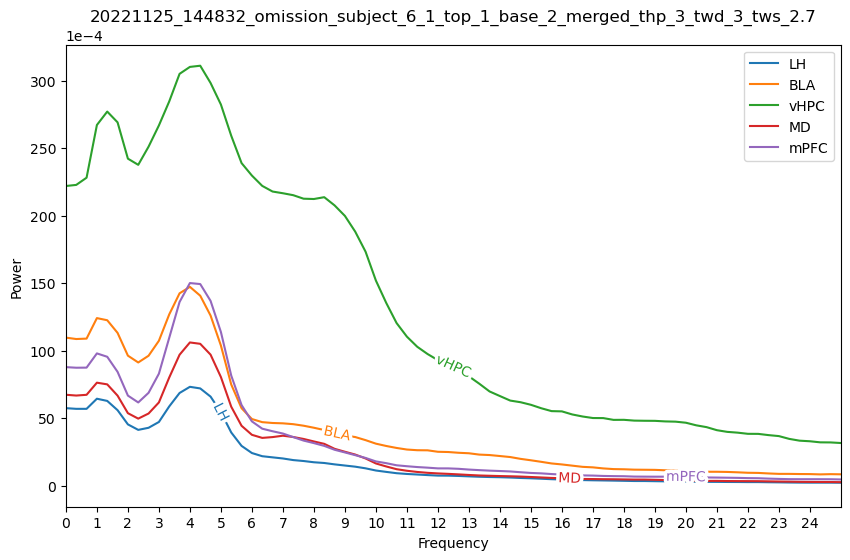

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_3_twd_3_tws_2.7.png


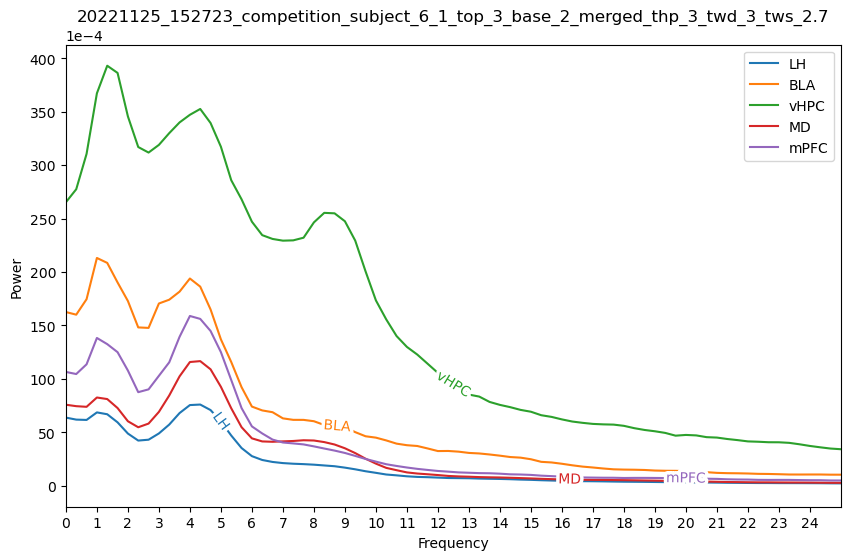

time_halfbandwidth_product: 3, time_window_duration: 5,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_5_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_5_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_5_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_5_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

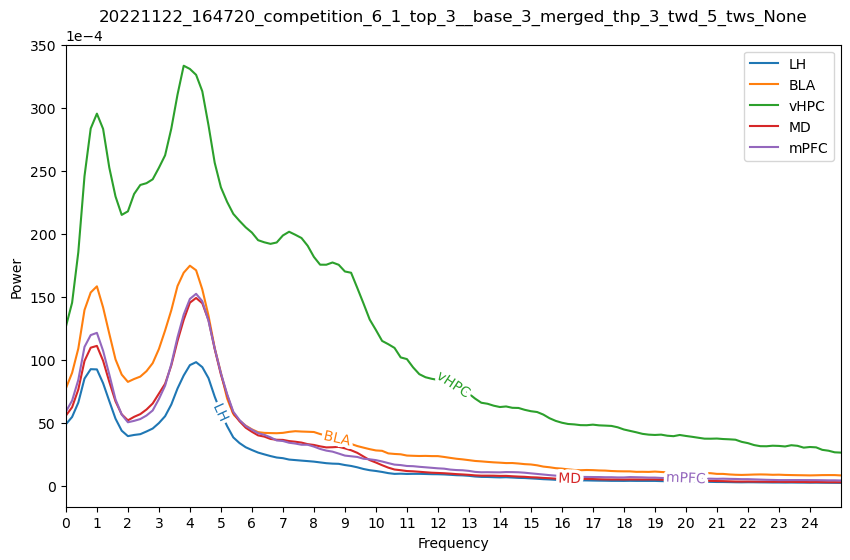

20221122_161341_omission_subject_6_1_top_4_base_2_thp_3_twd_5_tws_None.png


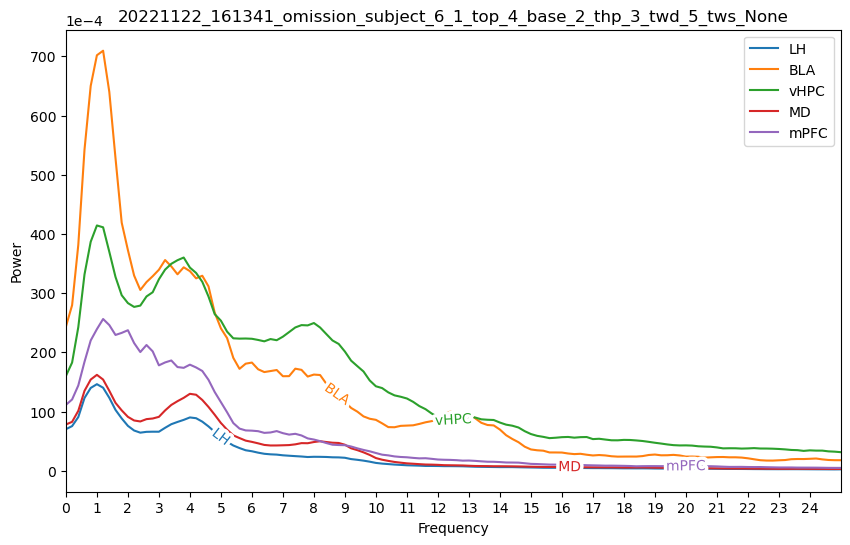

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_3_twd_5_tws_None.png


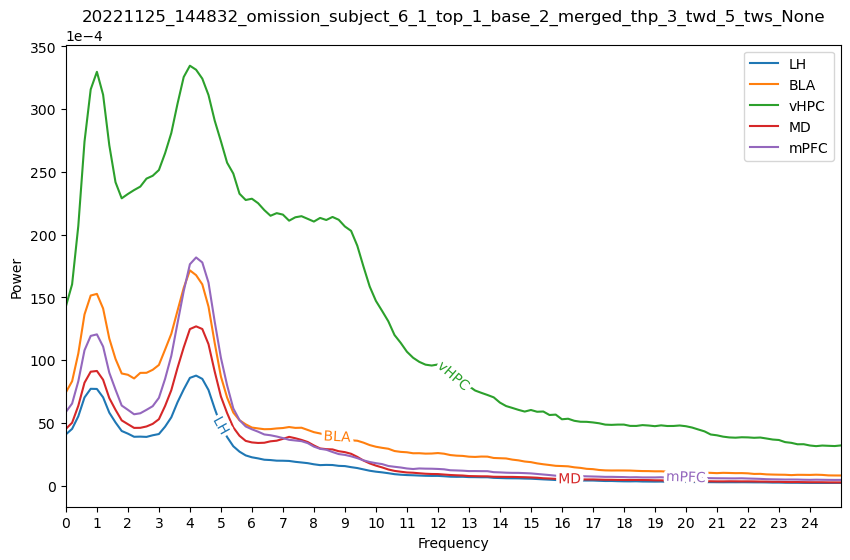

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_3_twd_5_tws_None.png


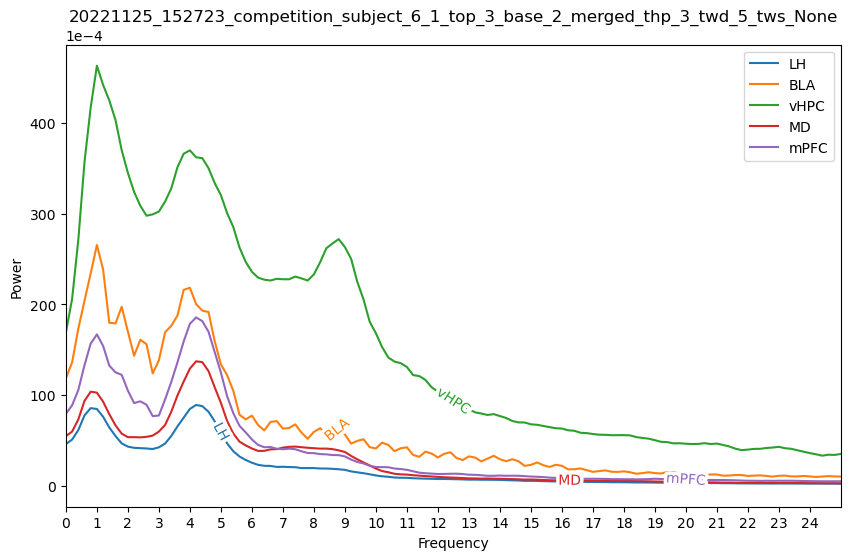

time_halfbandwidth_product: 3, time_window_duration: 5,         tws_ratio: 0.5, time_window_step 2.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_5_tws_2.5_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_5_tws_2.5_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_5_tws_2.5_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_5_tws_2.5_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

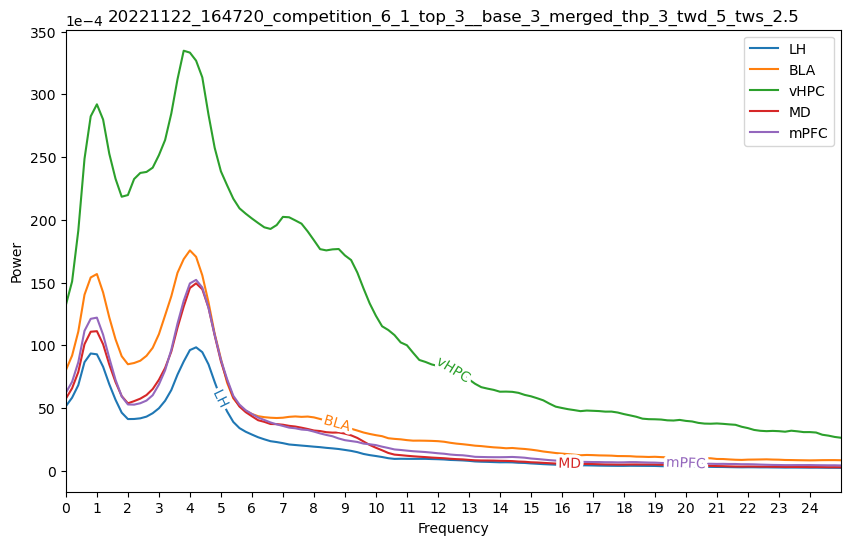

20221122_161341_omission_subject_6_1_top_4_base_2_thp_3_twd_5_tws_2.5.png


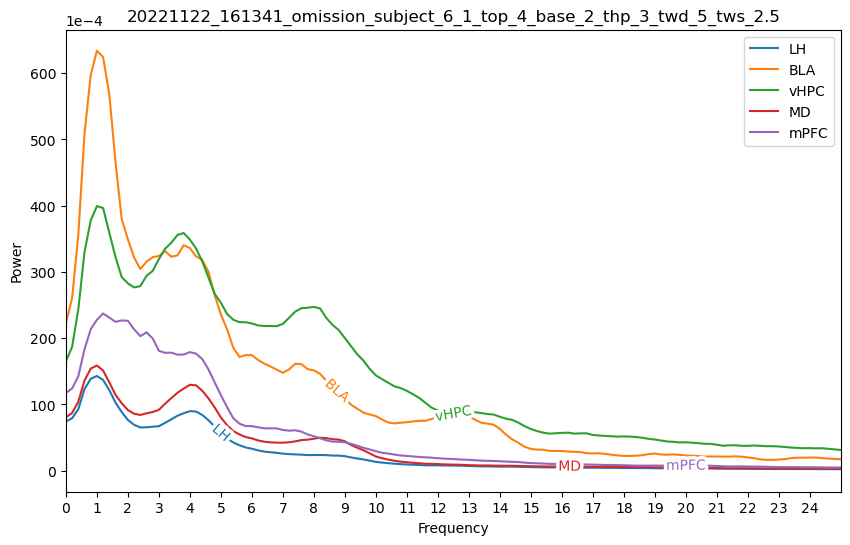

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_3_twd_5_tws_2.5.png


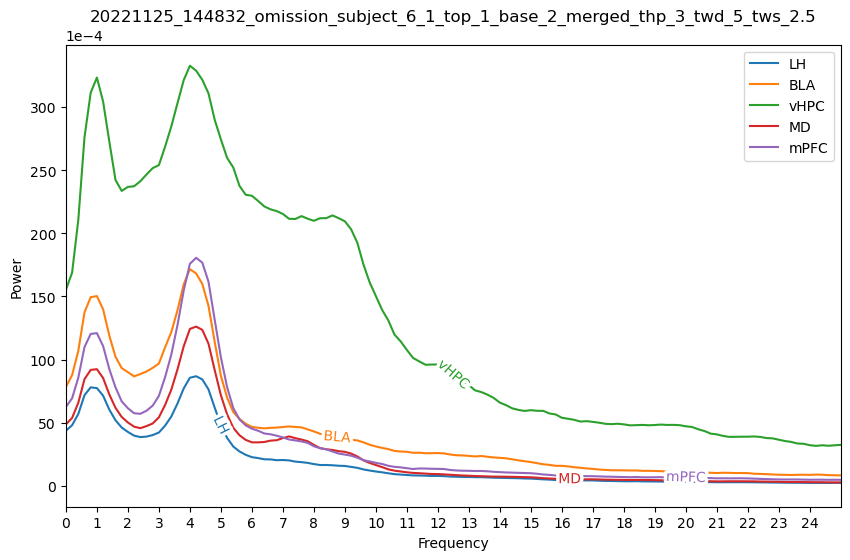

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_3_twd_5_tws_2.5.png


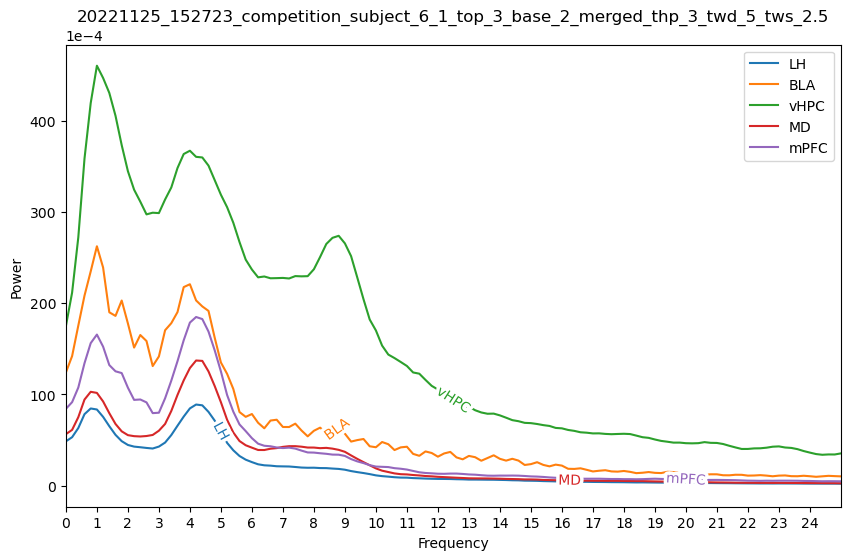

time_halfbandwidth_product: 3, time_window_duration: 5,         tws_ratio: 0.9, time_window_step 4.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_5_tws_4.5_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_5_tws_4.5_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_5_tws_4.5_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_5_tws_4.5_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

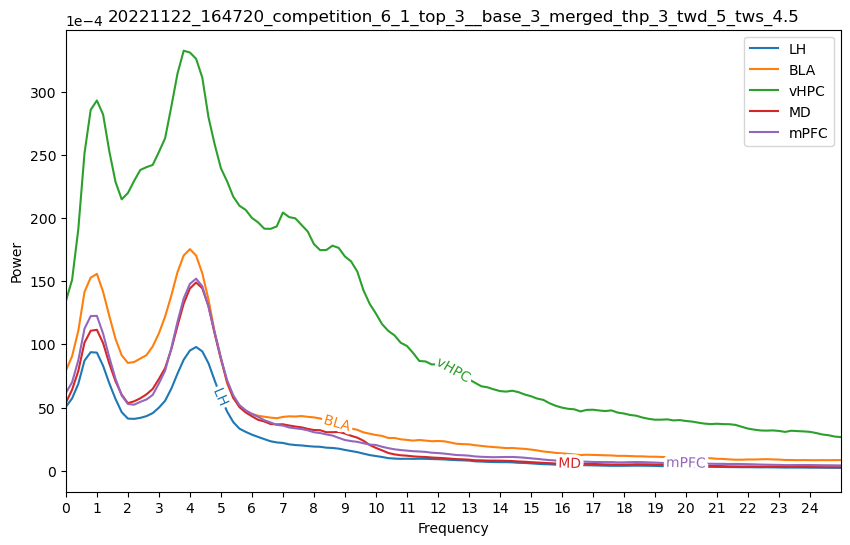

20221122_161341_omission_subject_6_1_top_4_base_2_thp_3_twd_5_tws_4.5.png


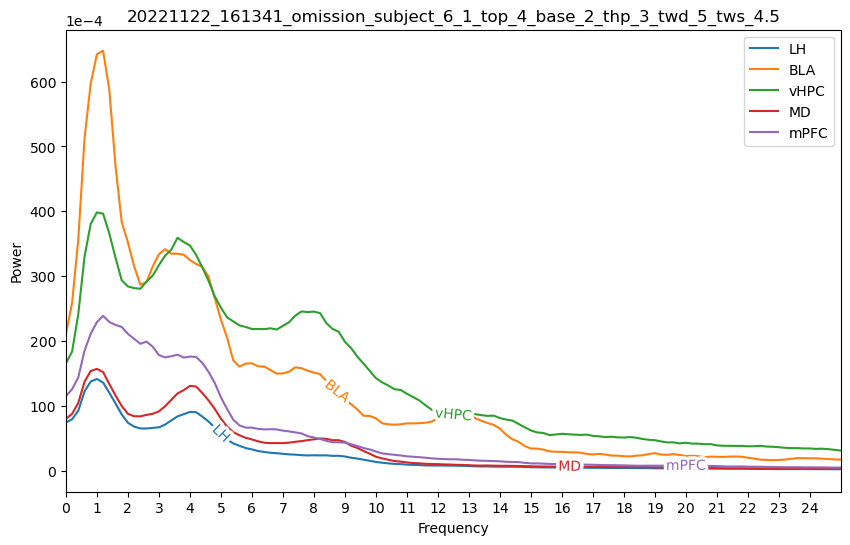

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_3_twd_5_tws_4.5.png


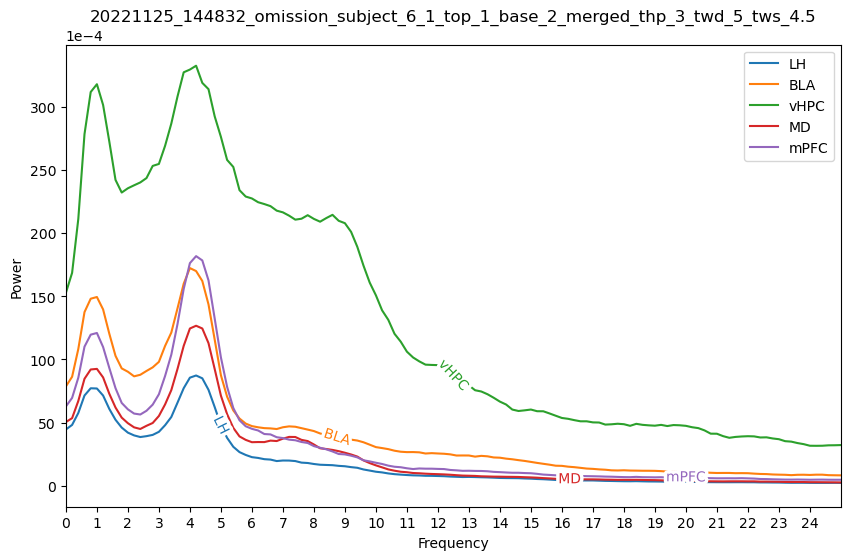

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_3_twd_5_tws_4.5.png


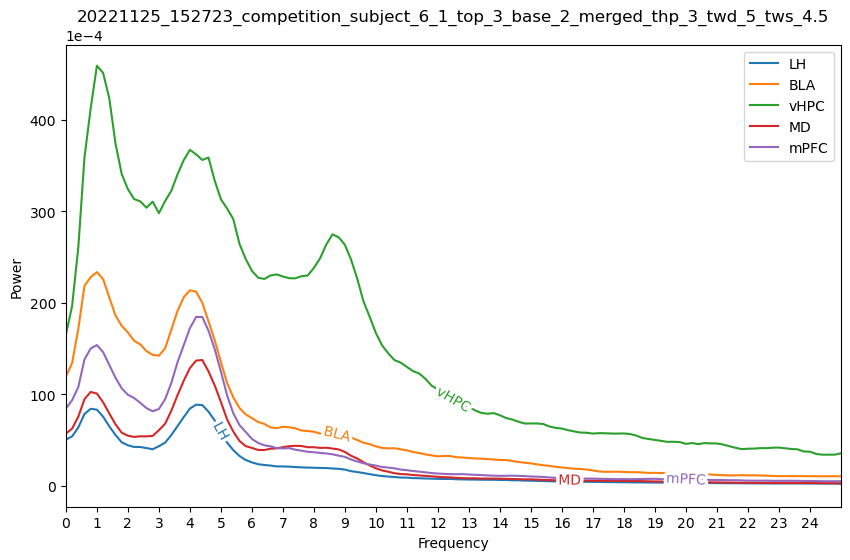

time_halfbandwidth_product: 3, time_window_duration: 7,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_7_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_7_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_7_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_7_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

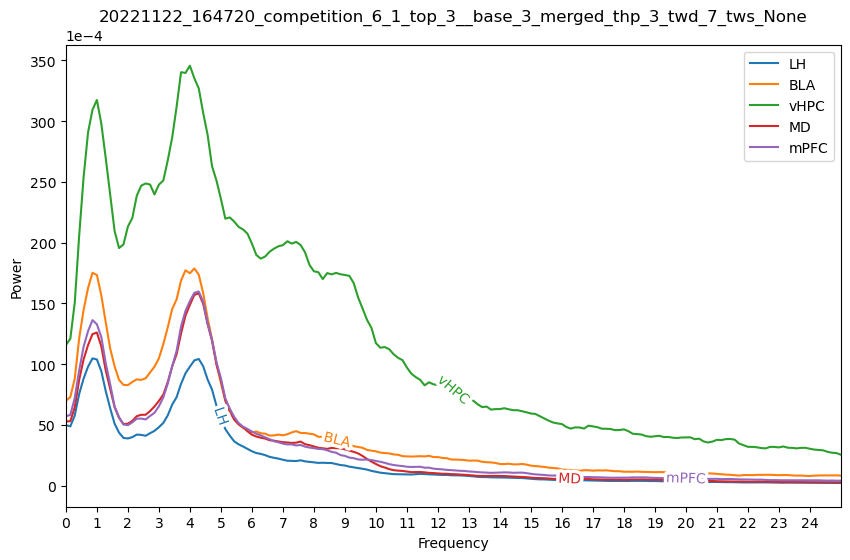

20221122_161341_omission_subject_6_1_top_4_base_2_thp_3_twd_7_tws_None.png


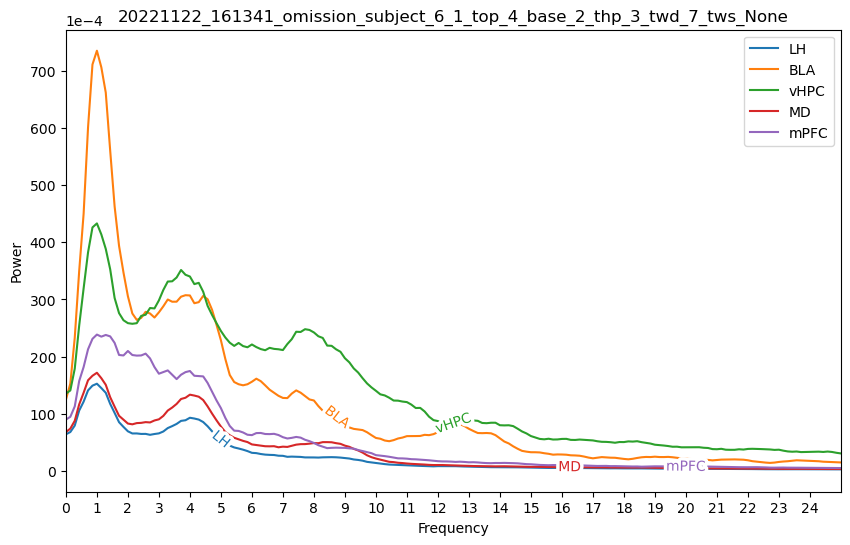

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_3_twd_7_tws_None.png


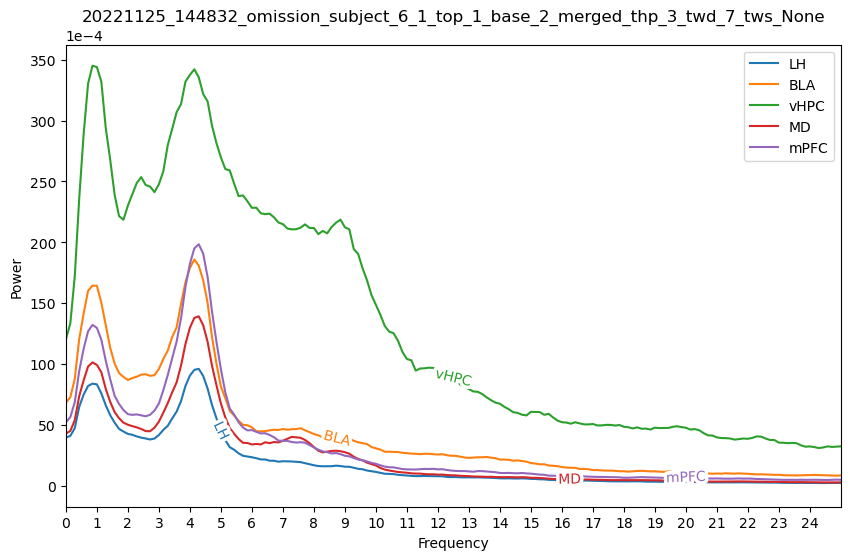

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_3_twd_7_tws_None.png


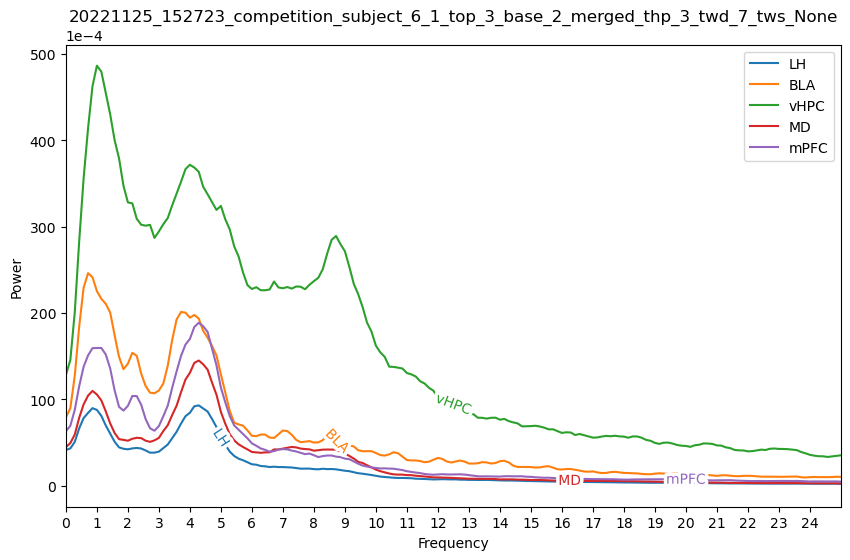

time_halfbandwidth_product: 3, time_window_duration: 7,         tws_ratio: 0.5, time_window_step 3.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_7_tws_3.5_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_7_tws_3.5_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_7_tws_3.5_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_7_tws_3.5_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

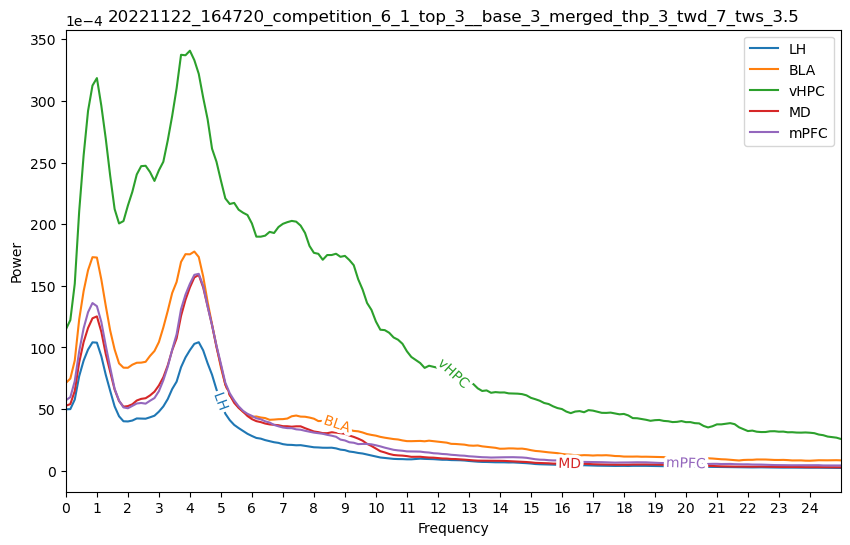

20221122_161341_omission_subject_6_1_top_4_base_2_thp_3_twd_7_tws_3.5.png


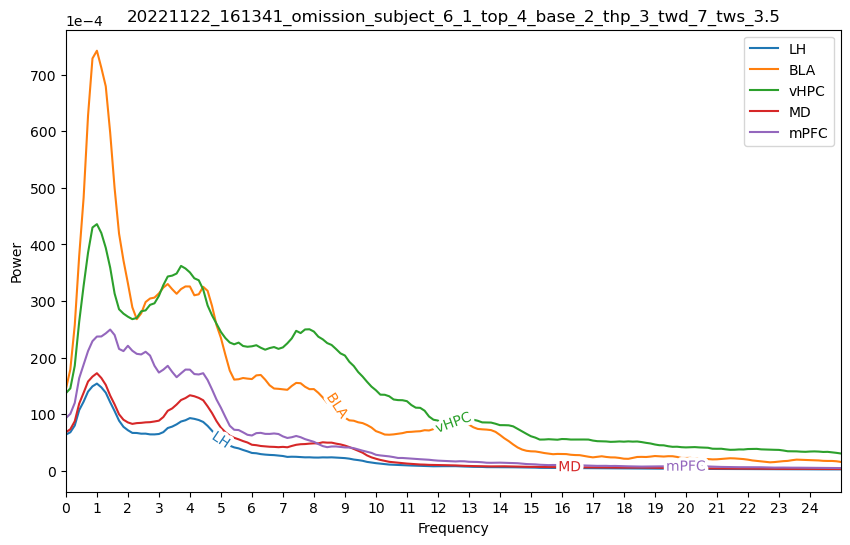

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_3_twd_7_tws_3.5.png


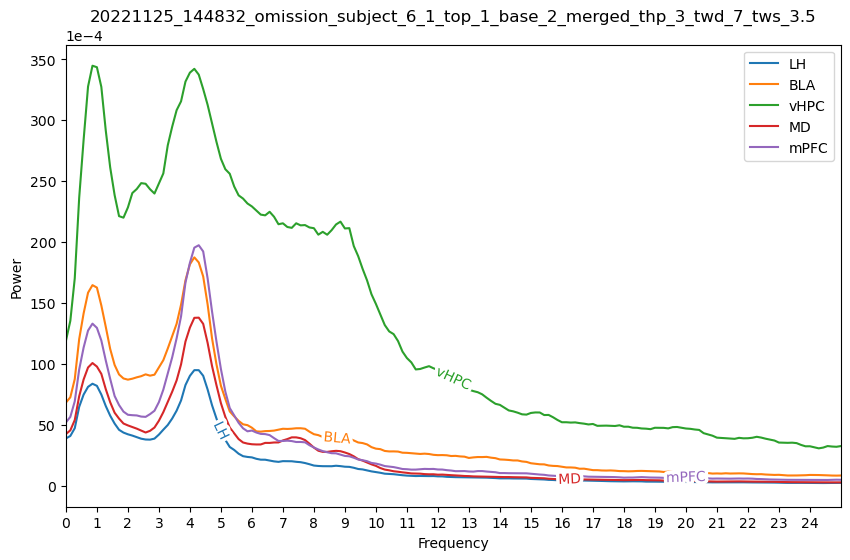

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_3_twd_7_tws_3.5.png


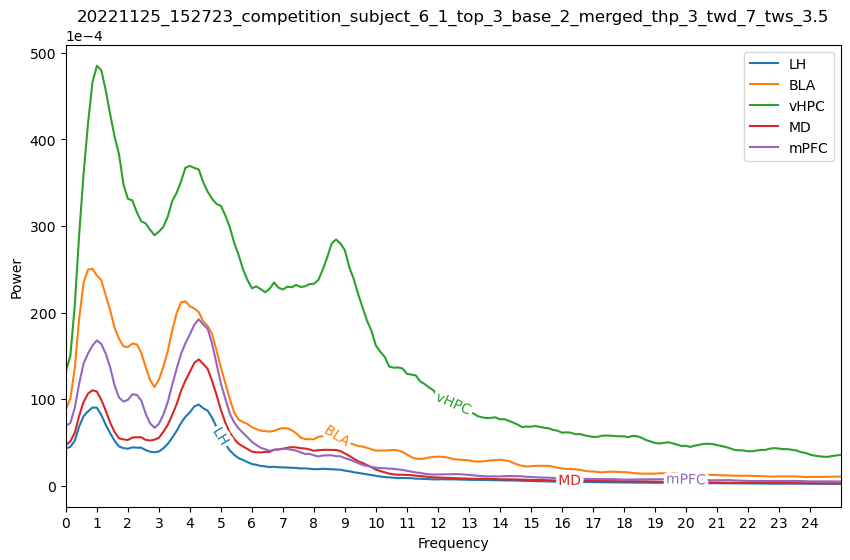

time_halfbandwidth_product: 3, time_window_duration: 7,         tws_ratio: 0.9, time_window_step 6.3
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_7_tws_6.3_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_7_tws_6.3_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_7_tws_6.3_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_7_tws_6.3_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

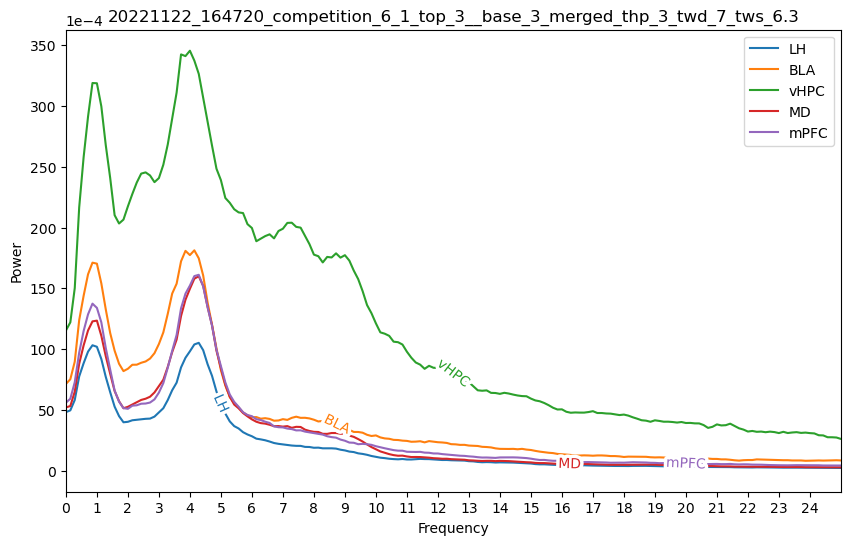

20221122_161341_omission_subject_6_1_top_4_base_2_thp_3_twd_7_tws_6.3.png


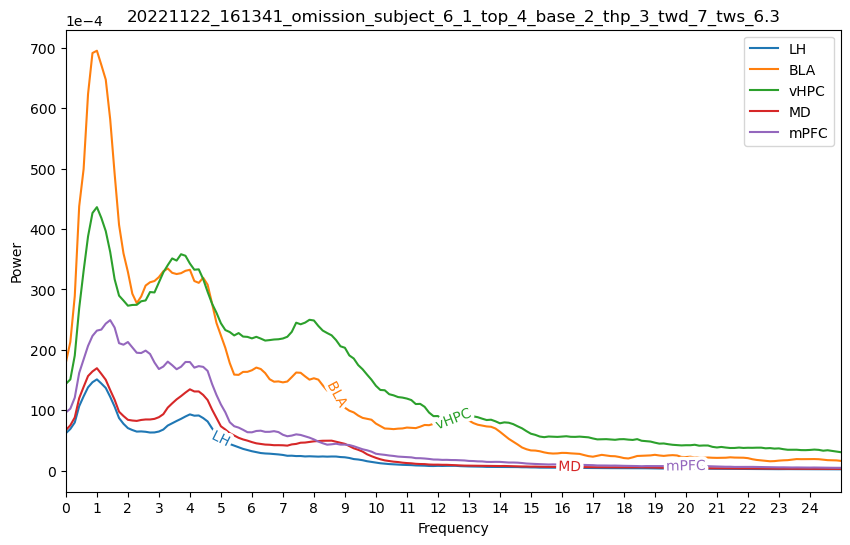

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_3_twd_7_tws_6.3.png


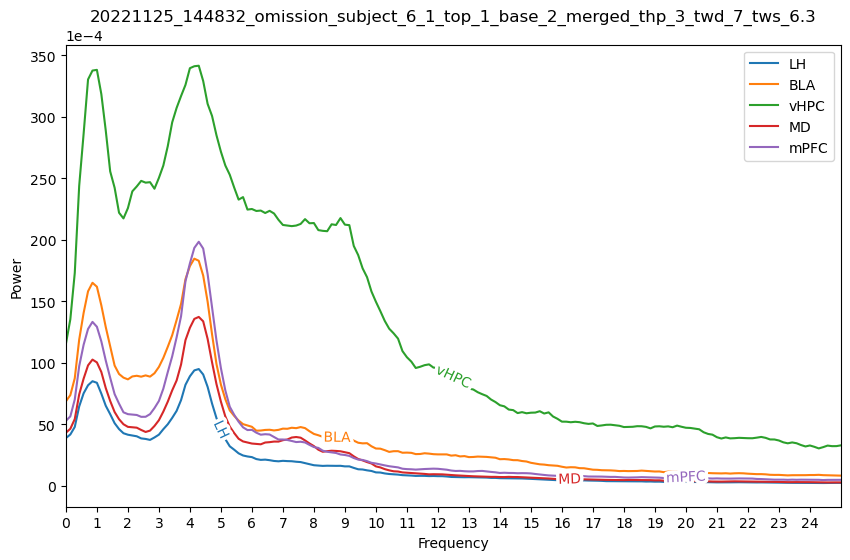

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_3_twd_7_tws_6.3.png


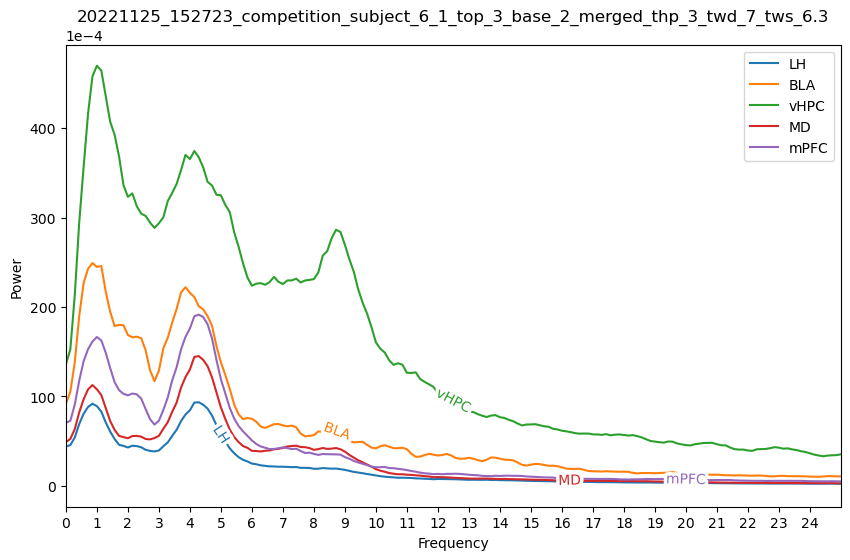

time_halfbandwidth_product: 3, time_window_duration: 10,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_10_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_10_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_10_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_10_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competiti

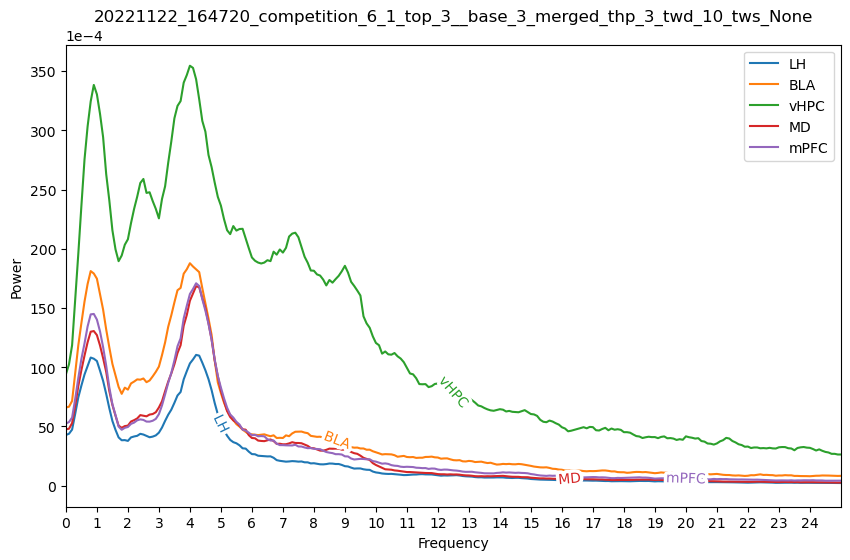

20221122_161341_omission_subject_6_1_top_4_base_2_thp_3_twd_10_tws_None.png


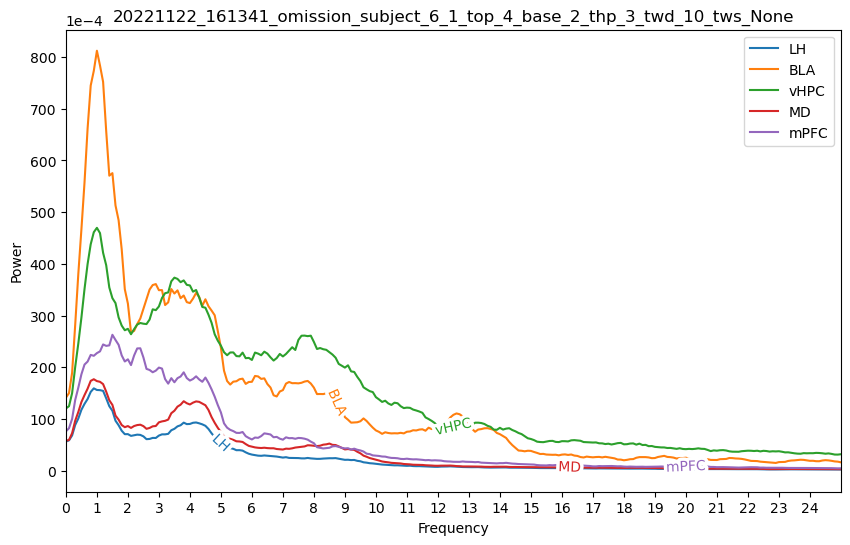

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_3_twd_10_tws_None.png


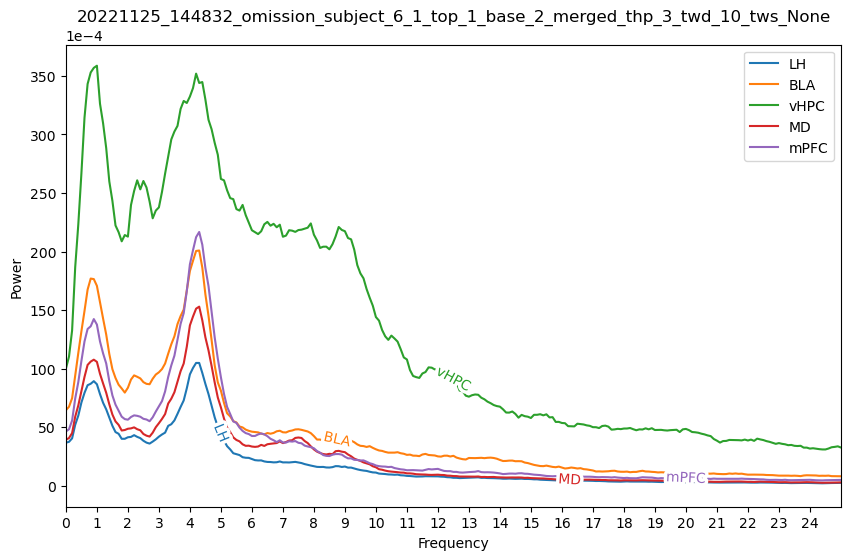

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_3_twd_10_tws_None.png


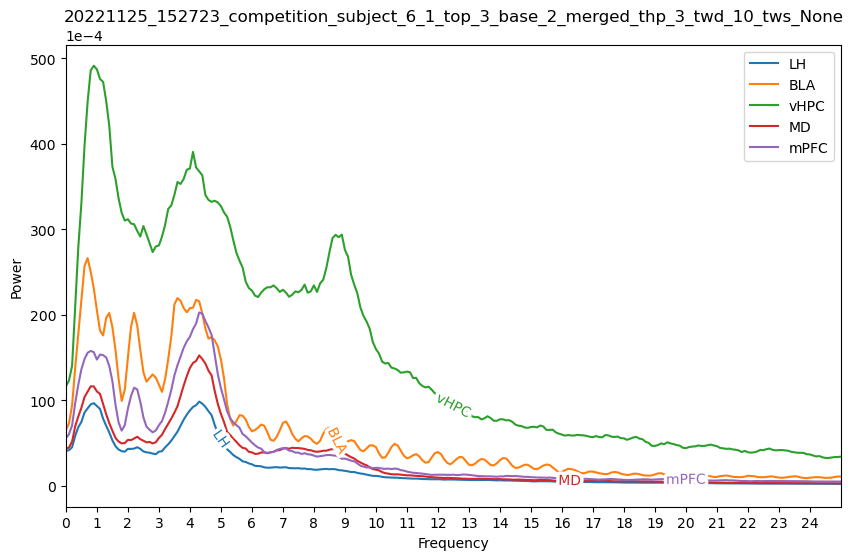

time_halfbandwidth_product: 3, time_window_duration: 10,         tws_ratio: 0.5, time_window_step 5.0
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_10_tws_5.0_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_10_tws_5.0_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_10_tws_5.0_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_10_tws_5.0_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1

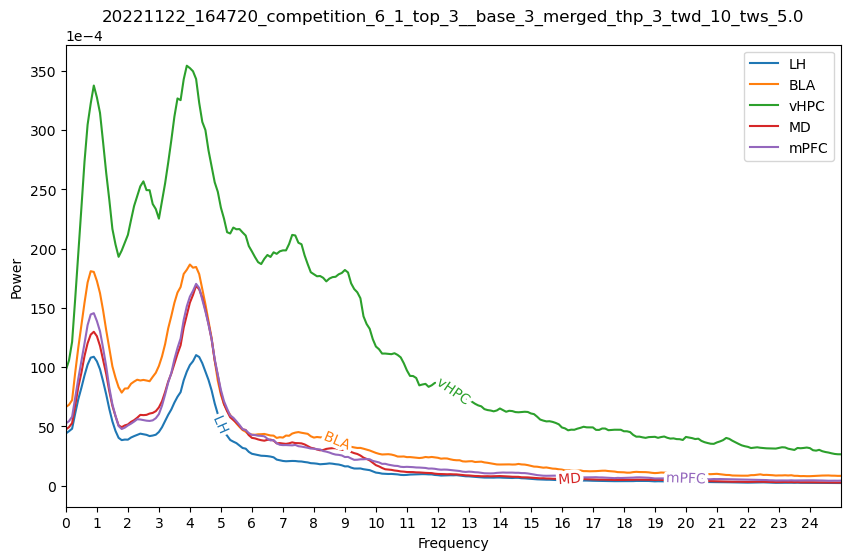

20221122_161341_omission_subject_6_1_top_4_base_2_thp_3_twd_10_tws_5.0.png


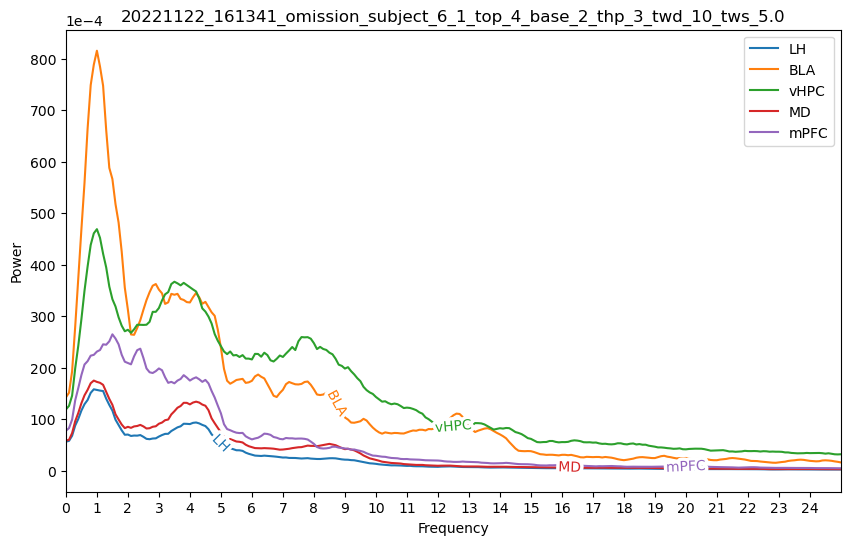

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_3_twd_10_tws_5.0.png


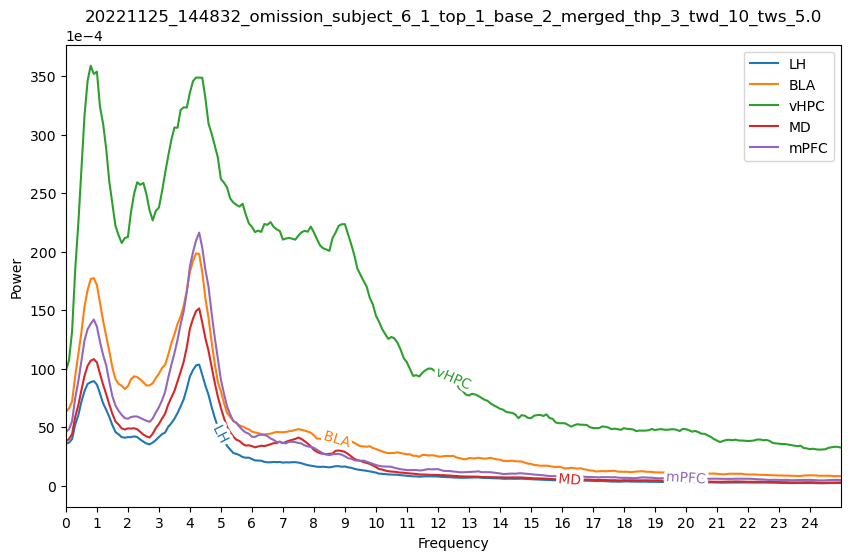

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_3_twd_10_tws_5.0.png


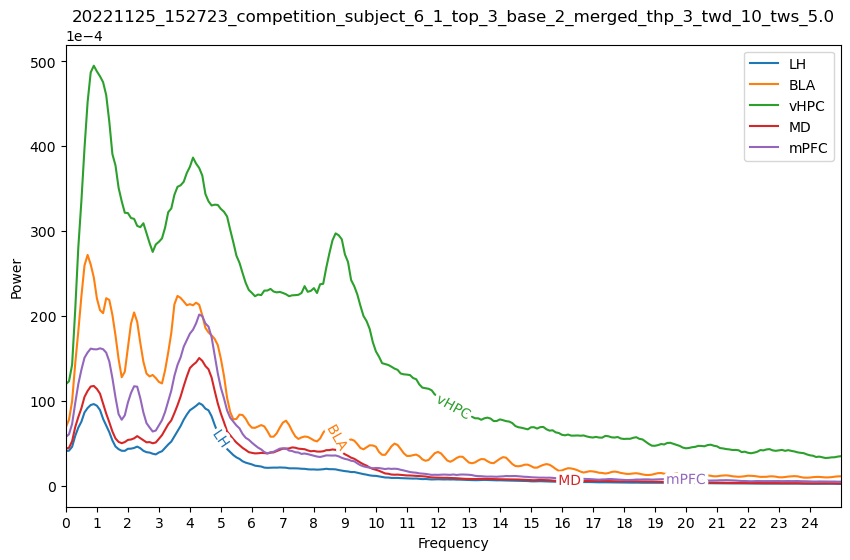

time_halfbandwidth_product: 3, time_window_duration: 10,         tws_ratio: 0.9, time_window_step 9.0
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_10_tws_9.0_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_10_tws_9.0_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_10_tws_9.0_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_3_twd_10_tws_9.0_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1

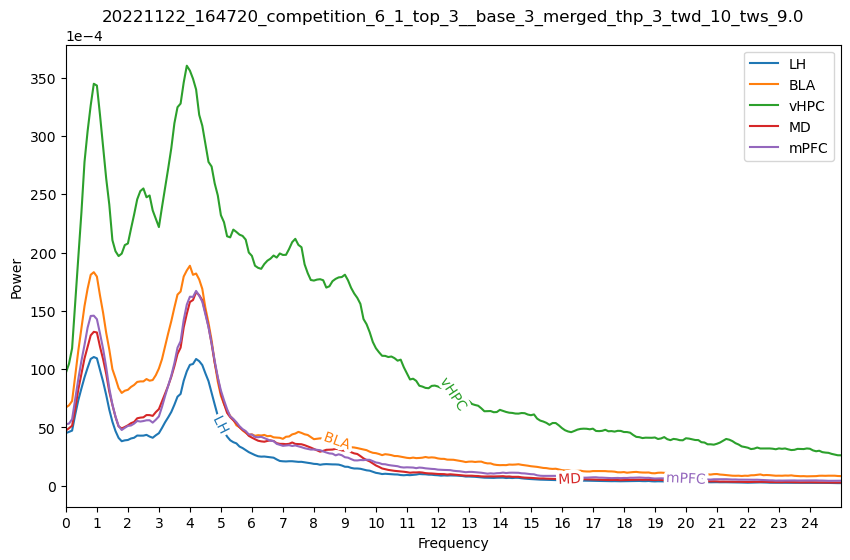

20221122_161341_omission_subject_6_1_top_4_base_2_thp_3_twd_10_tws_9.0.png


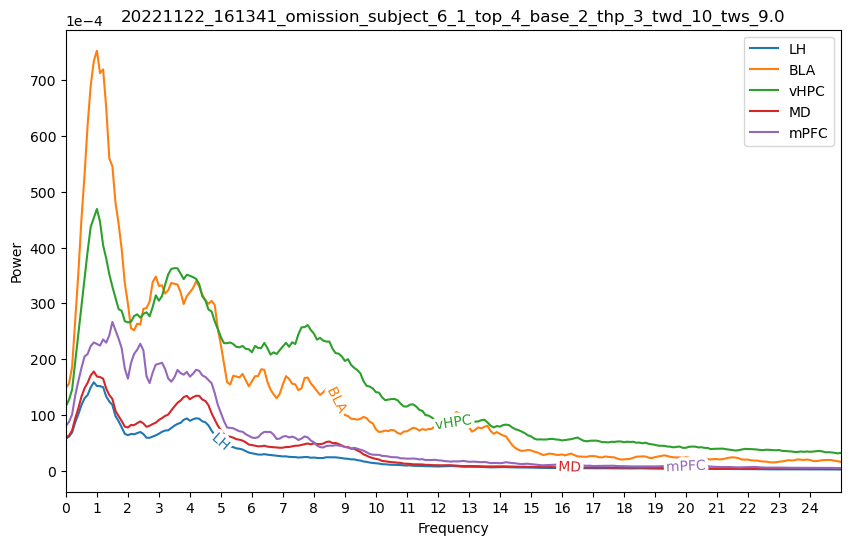

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_3_twd_10_tws_9.0.png


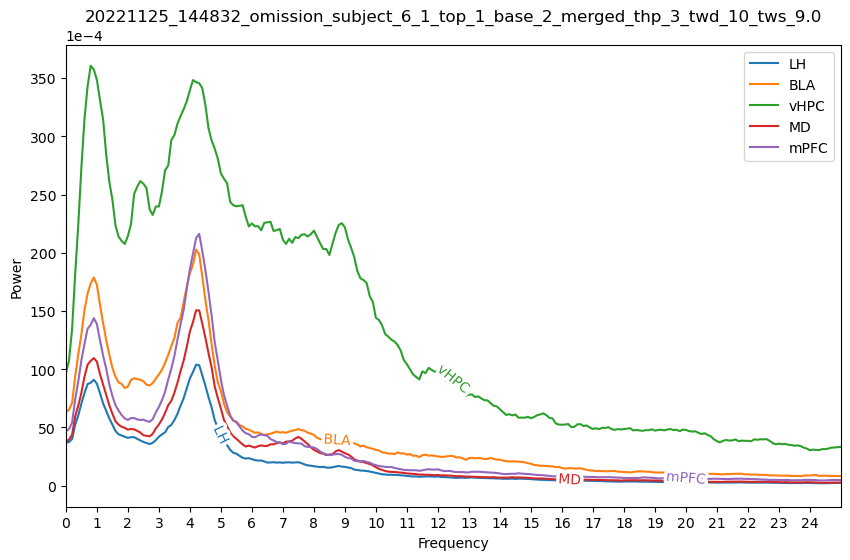

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_3_twd_10_tws_9.0.png


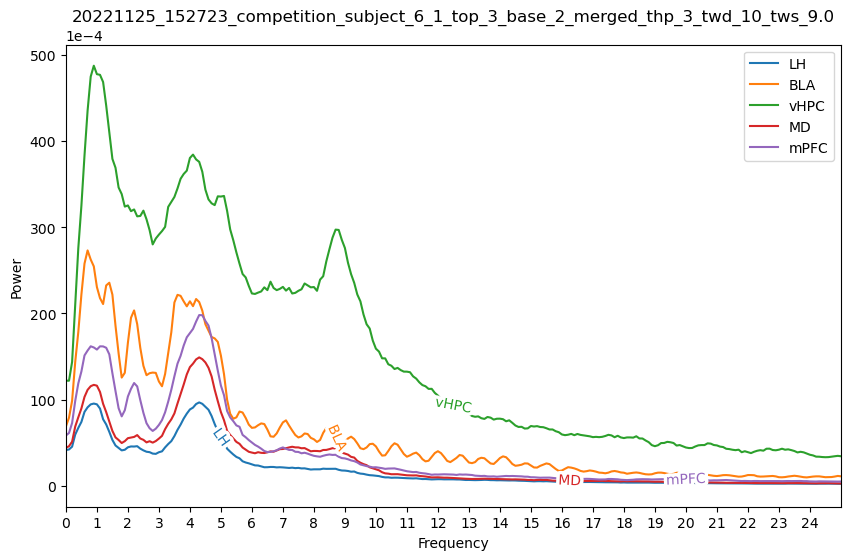

time_halfbandwidth_product: 5, time_window_duration: 1,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_1_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_1_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_1_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_1_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

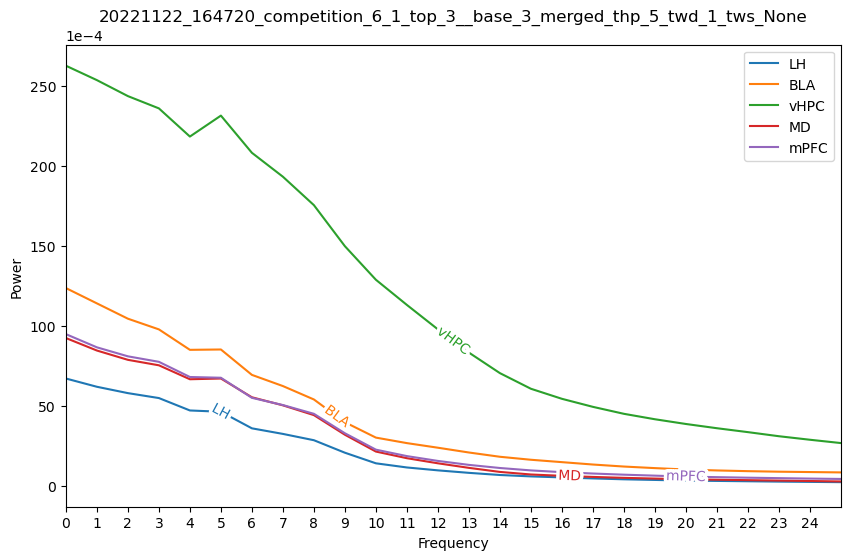

20221122_161341_omission_subject_6_1_top_4_base_2_thp_5_twd_1_tws_None.png


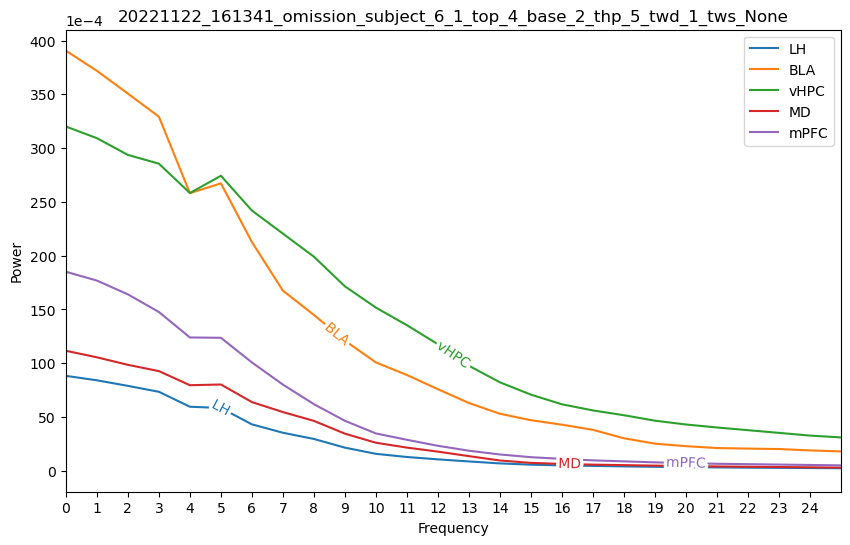

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_5_twd_1_tws_None.png


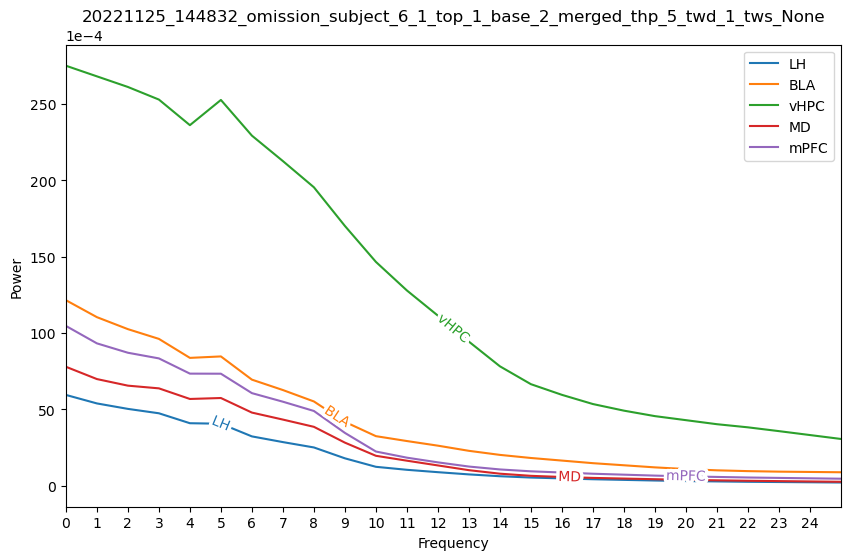

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_5_twd_1_tws_None.png


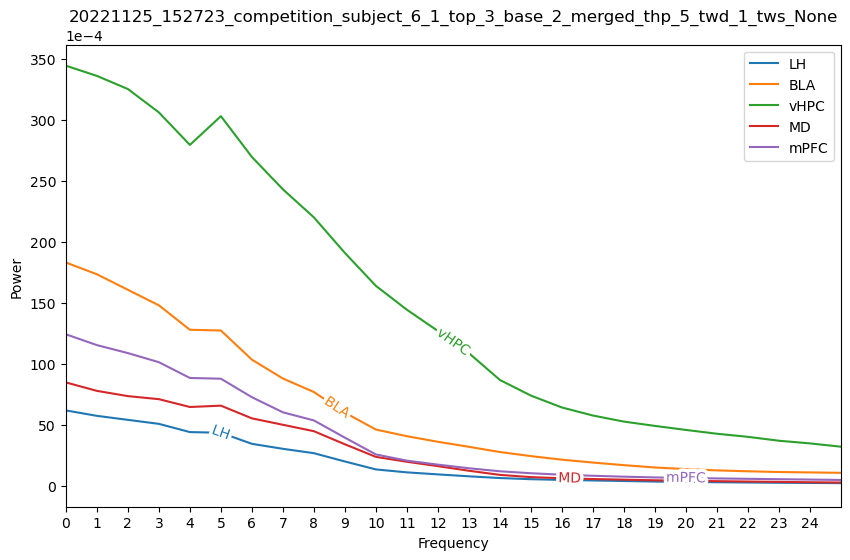

time_halfbandwidth_product: 5, time_window_duration: 1,         tws_ratio: 0.5, time_window_step 0.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_1_tws_0.5_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_1_tws_0.5_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_1_tws_0.5_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_1_tws_0.5_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

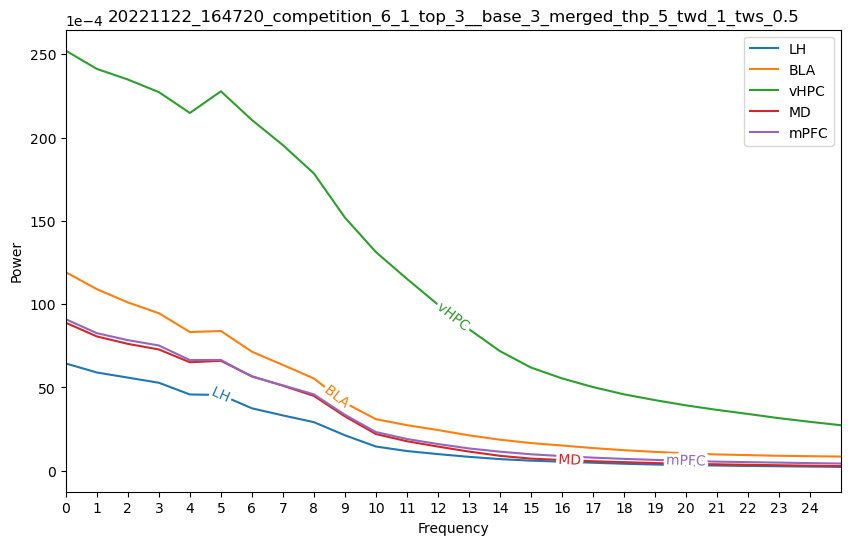

20221122_161341_omission_subject_6_1_top_4_base_2_thp_5_twd_1_tws_0.5.png


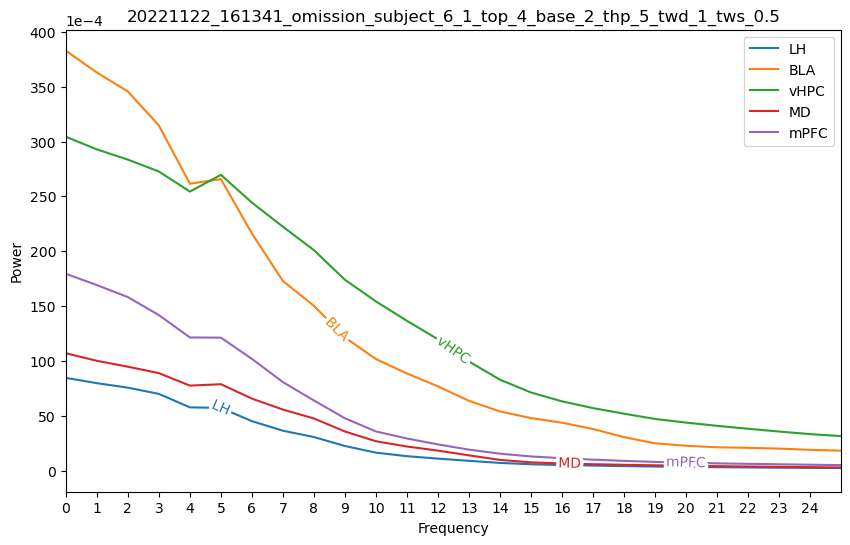

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_5_twd_1_tws_0.5.png


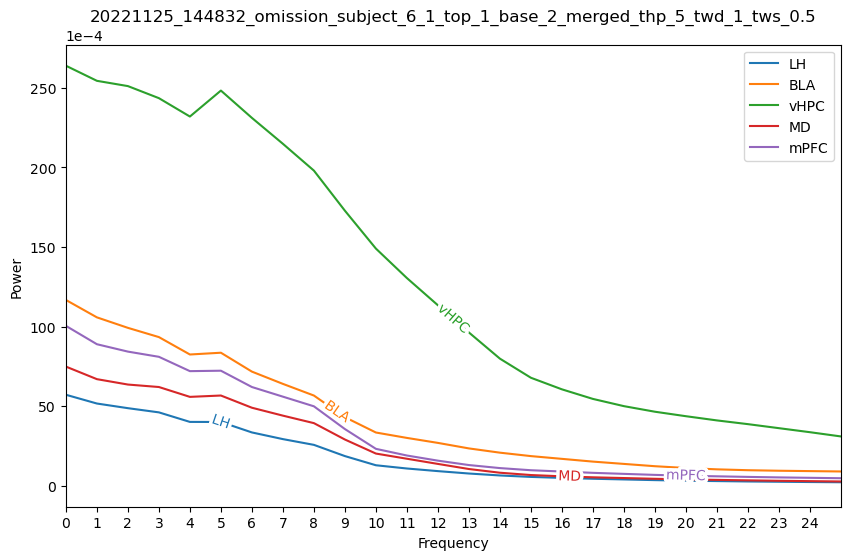

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_5_twd_1_tws_0.5.png


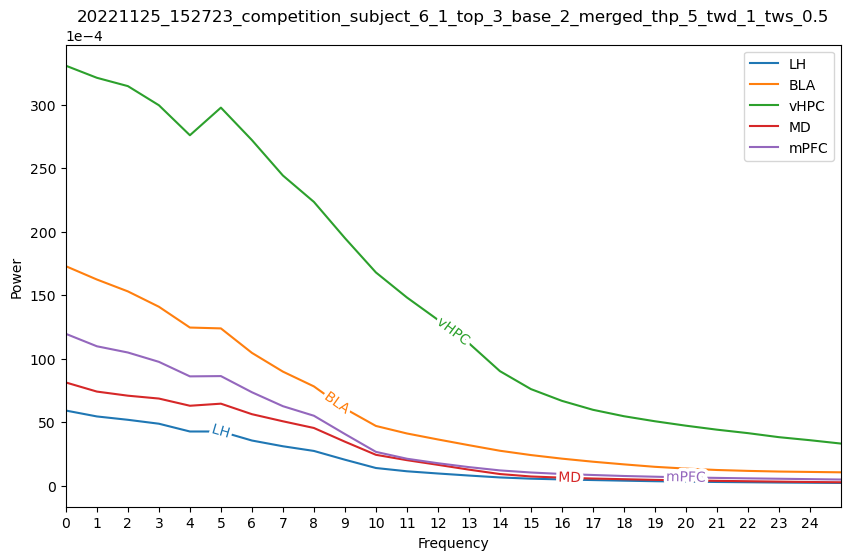

time_halfbandwidth_product: 5, time_window_duration: 1,         tws_ratio: 0.9, time_window_step 0.9
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_1_tws_0.9_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_1_tws_0.9_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_1_tws_0.9_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_1_tws_0.9_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

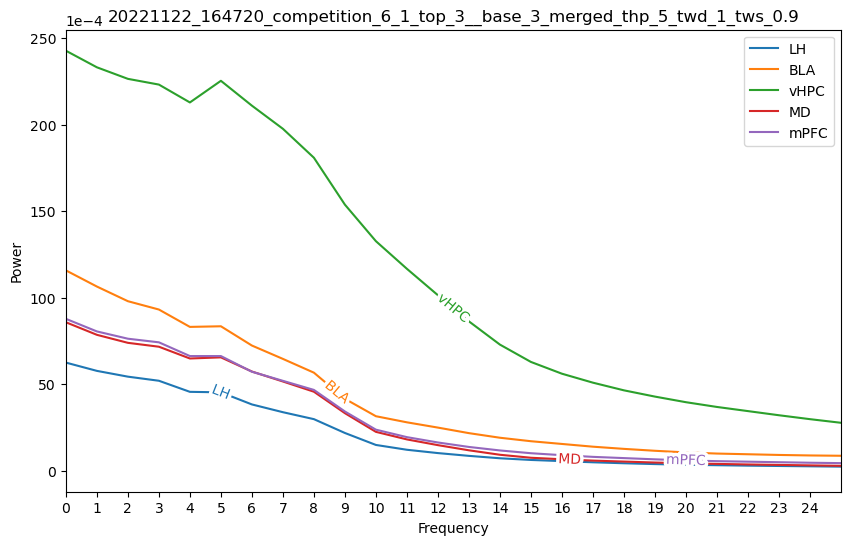

20221122_161341_omission_subject_6_1_top_4_base_2_thp_5_twd_1_tws_0.9.png


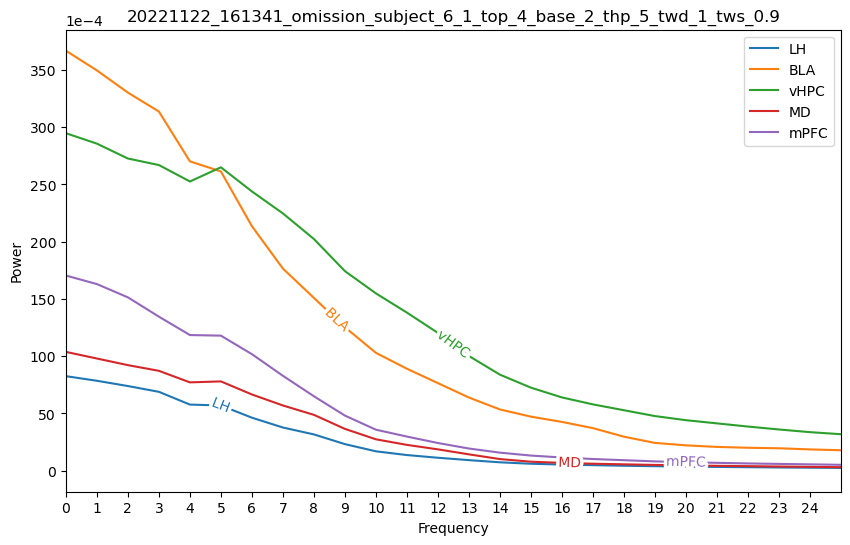

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_5_twd_1_tws_0.9.png


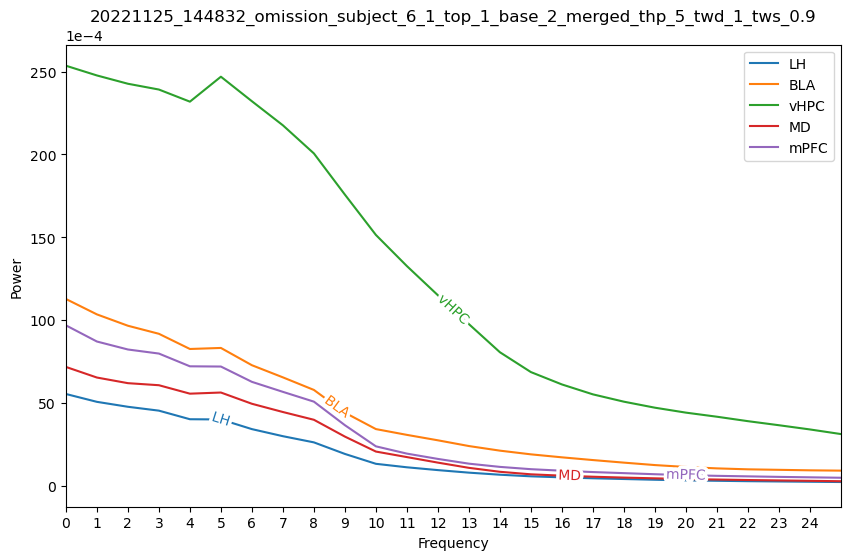

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_5_twd_1_tws_0.9.png


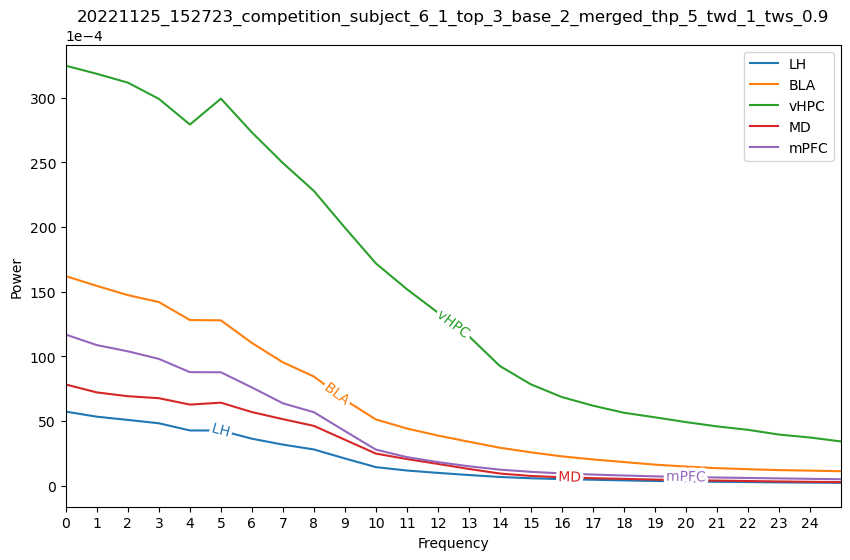

time_halfbandwidth_product: 5, time_window_duration: 2,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_2_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_2_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_2_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_2_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

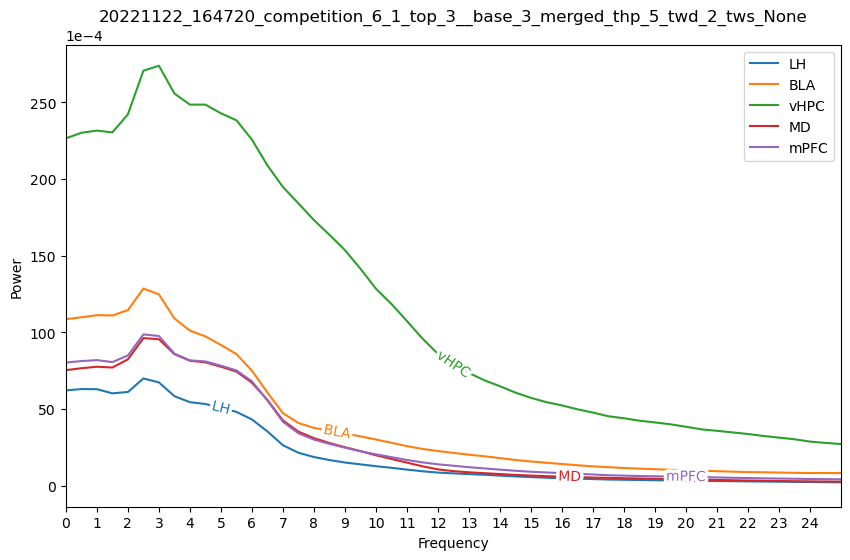

20221122_161341_omission_subject_6_1_top_4_base_2_thp_5_twd_2_tws_None.png


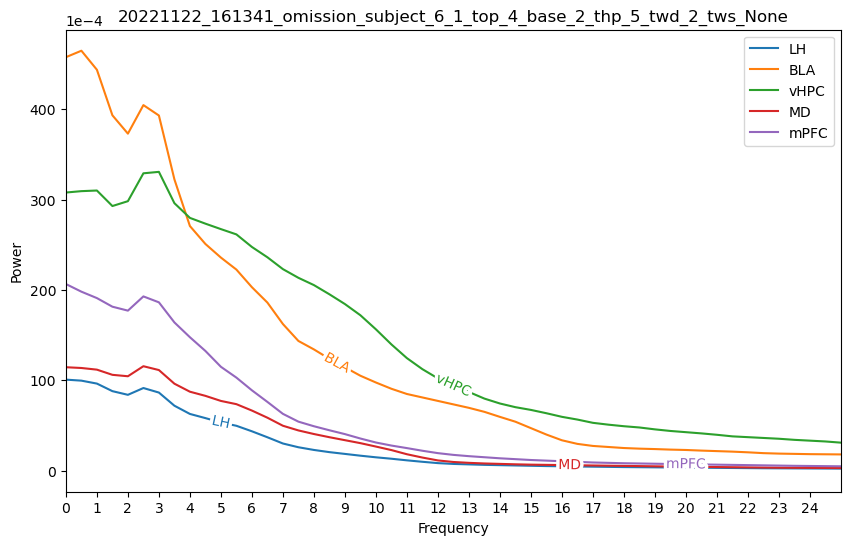

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_5_twd_2_tws_None.png


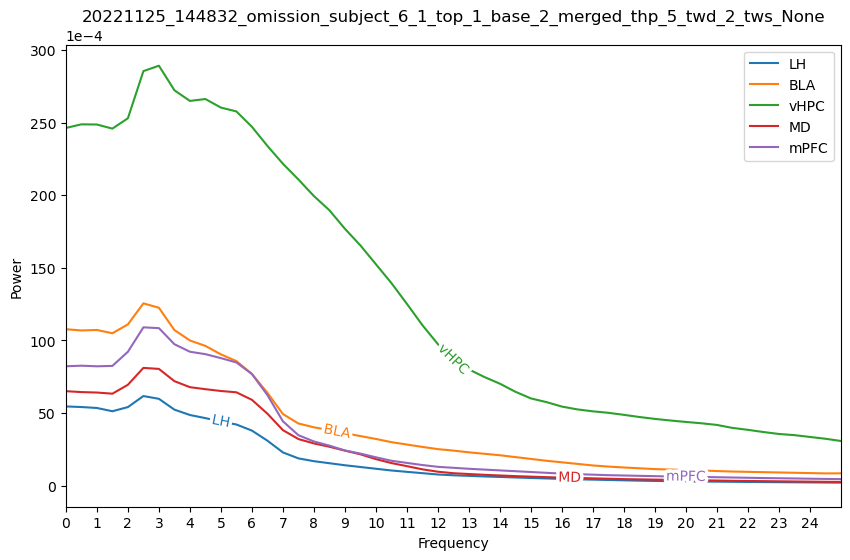

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_5_twd_2_tws_None.png


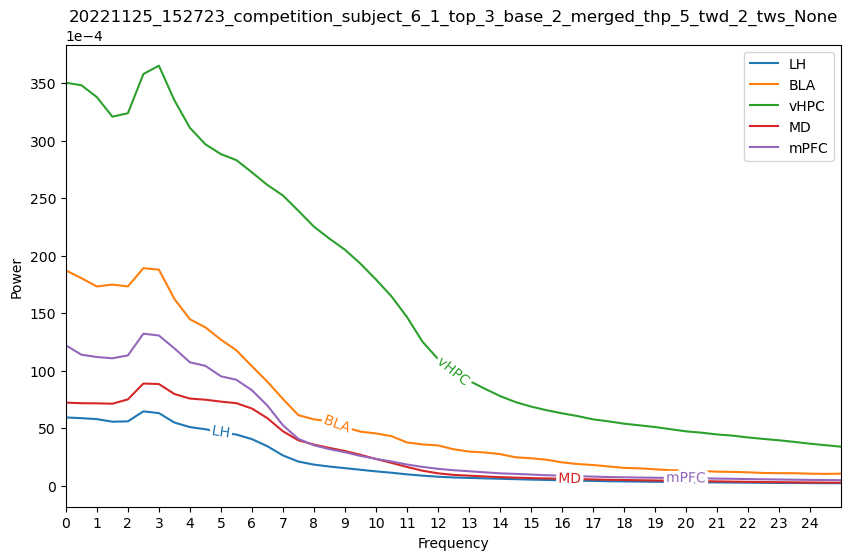

time_halfbandwidth_product: 5, time_window_duration: 2,         tws_ratio: 0.5, time_window_step 1.0
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_2_tws_1.0_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_2_tws_1.0_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_2_tws_1.0_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_2_tws_1.0_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

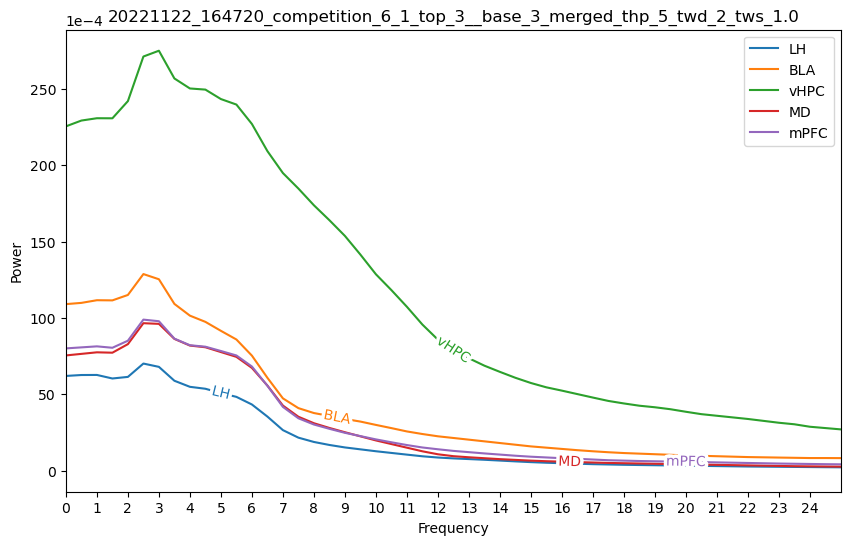

20221122_161341_omission_subject_6_1_top_4_base_2_thp_5_twd_2_tws_1.0.png


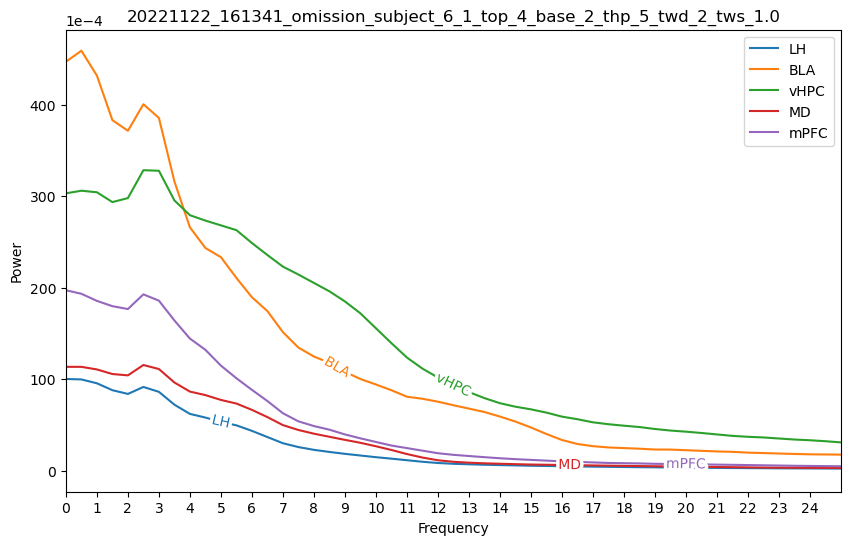

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_5_twd_2_tws_1.0.png


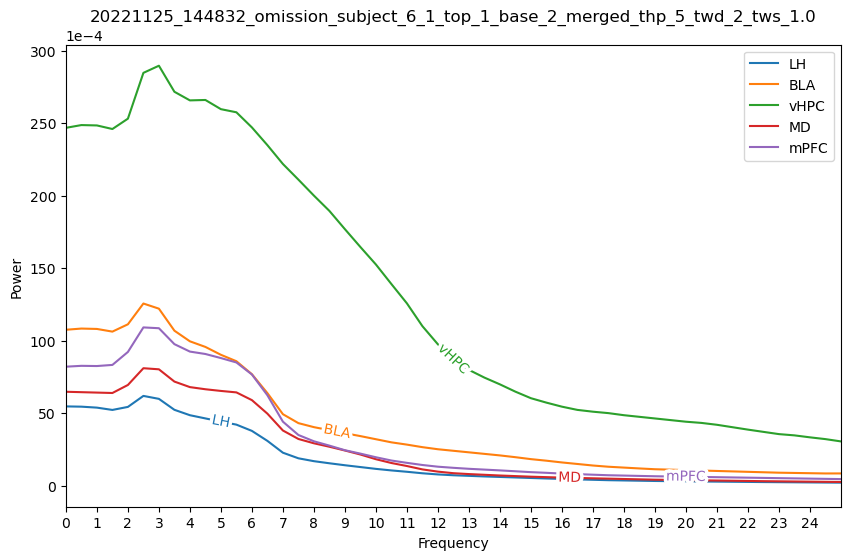

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_5_twd_2_tws_1.0.png


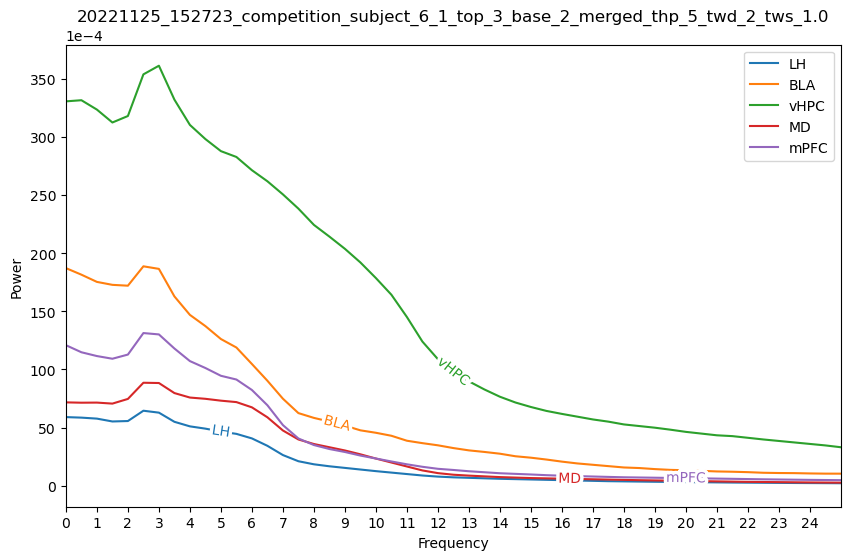

time_halfbandwidth_product: 5, time_window_duration: 2,         tws_ratio: 0.9, time_window_step 1.8
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_2_tws_1.8_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_2_tws_1.8_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_2_tws_1.8_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_2_tws_1.8_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

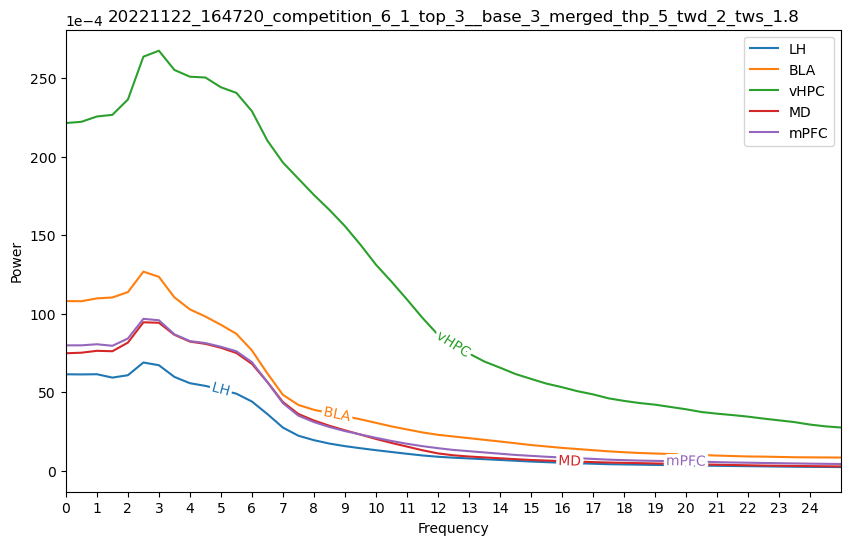

20221122_161341_omission_subject_6_1_top_4_base_2_thp_5_twd_2_tws_1.8.png


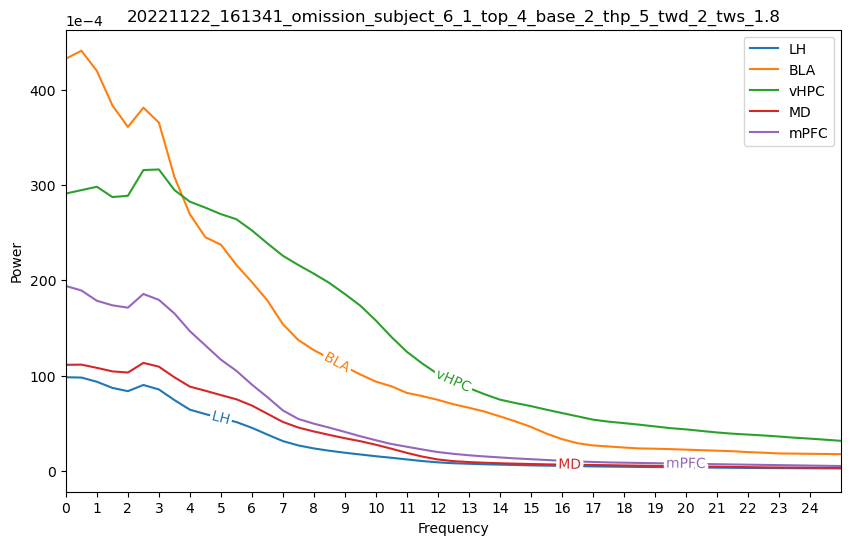

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_5_twd_2_tws_1.8.png


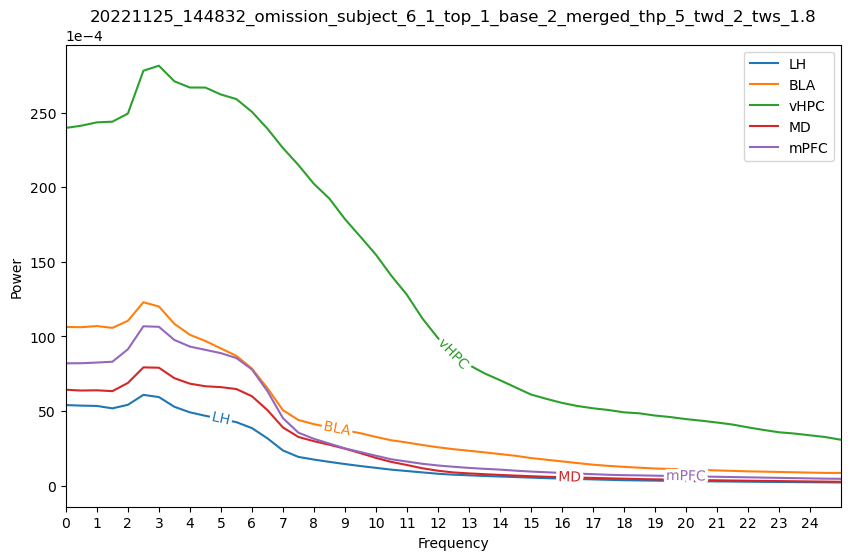

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_5_twd_2_tws_1.8.png


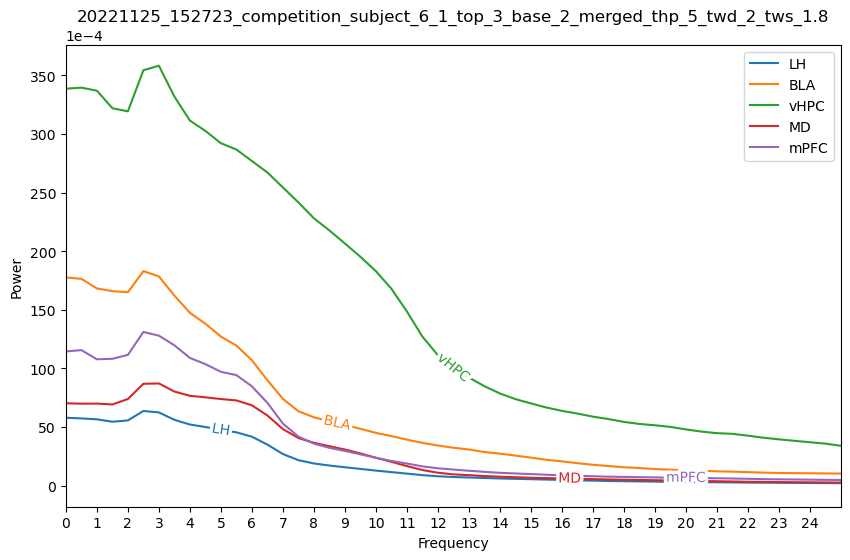

time_halfbandwidth_product: 5, time_window_duration: 3,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_3_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_3_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_3_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_3_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

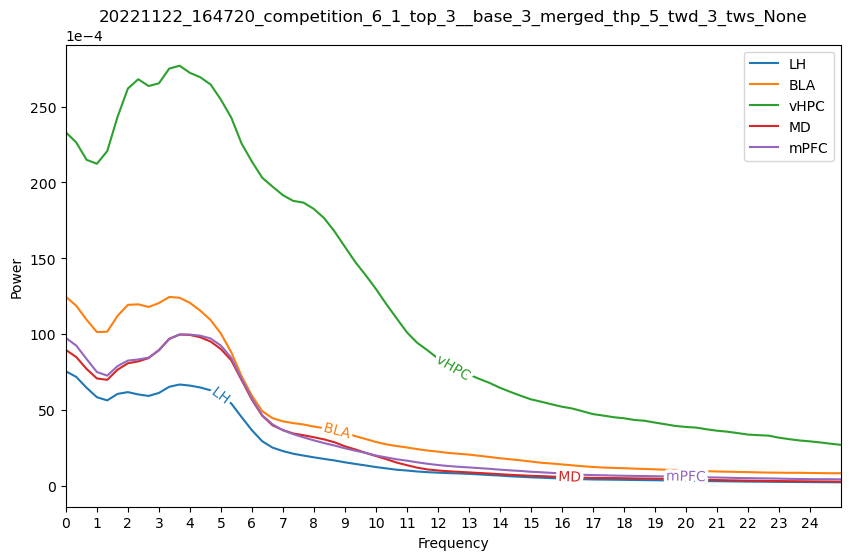

20221122_161341_omission_subject_6_1_top_4_base_2_thp_5_twd_3_tws_None.png


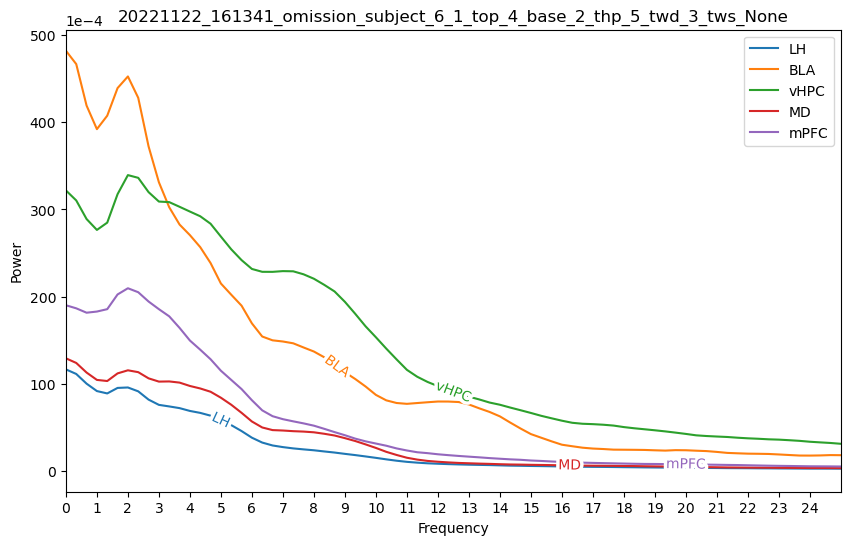

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_5_twd_3_tws_None.png


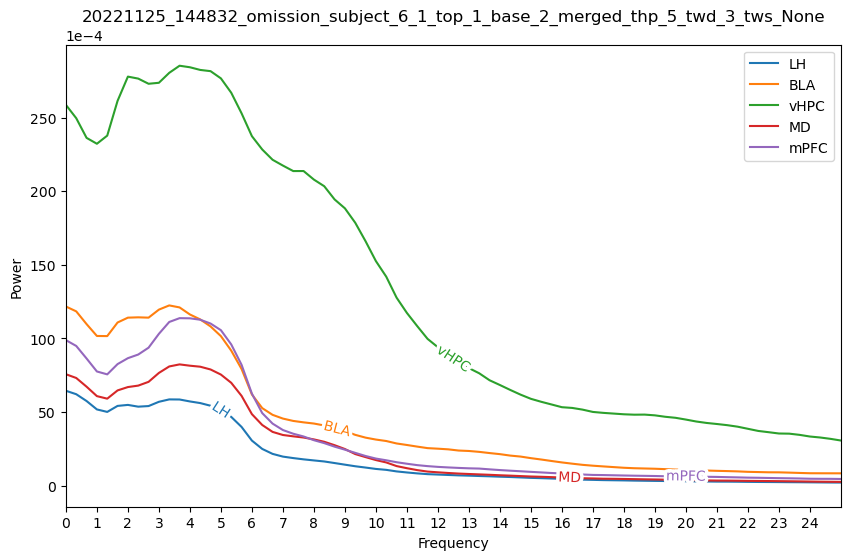

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_5_twd_3_tws_None.png


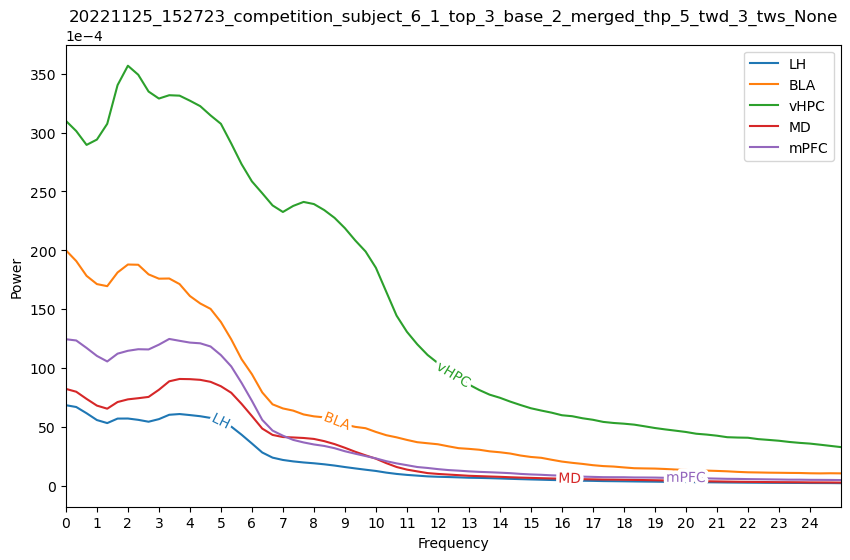

time_halfbandwidth_product: 5, time_window_duration: 3,         tws_ratio: 0.5, time_window_step 1.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_3_tws_1.5_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_3_tws_1.5_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_3_tws_1.5_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_3_tws_1.5_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

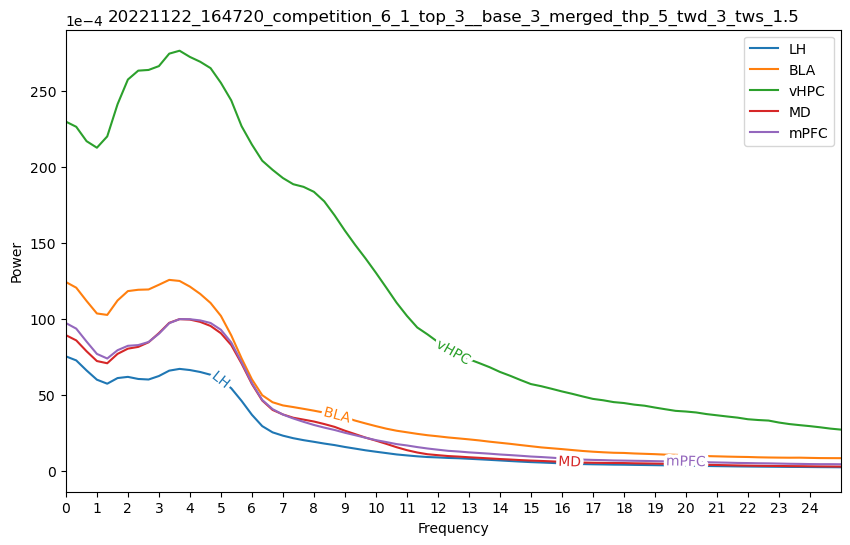

20221122_161341_omission_subject_6_1_top_4_base_2_thp_5_twd_3_tws_1.5.png


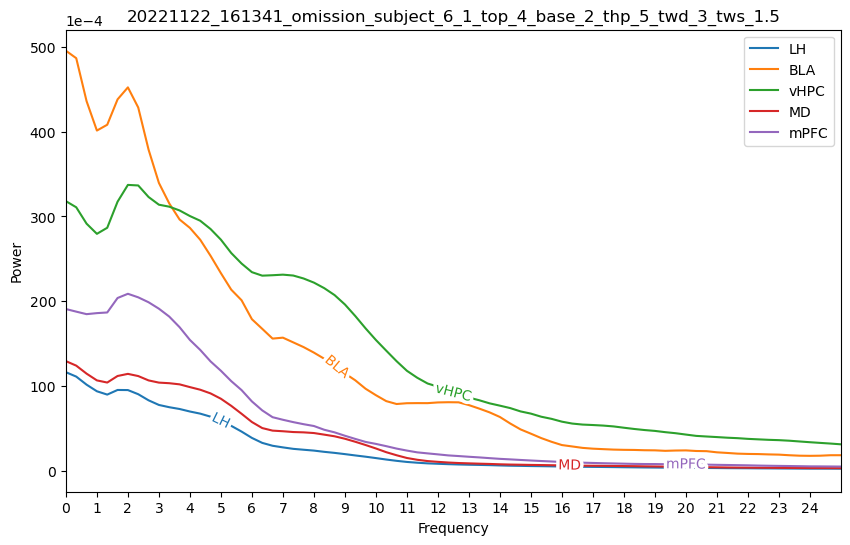

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_5_twd_3_tws_1.5.png


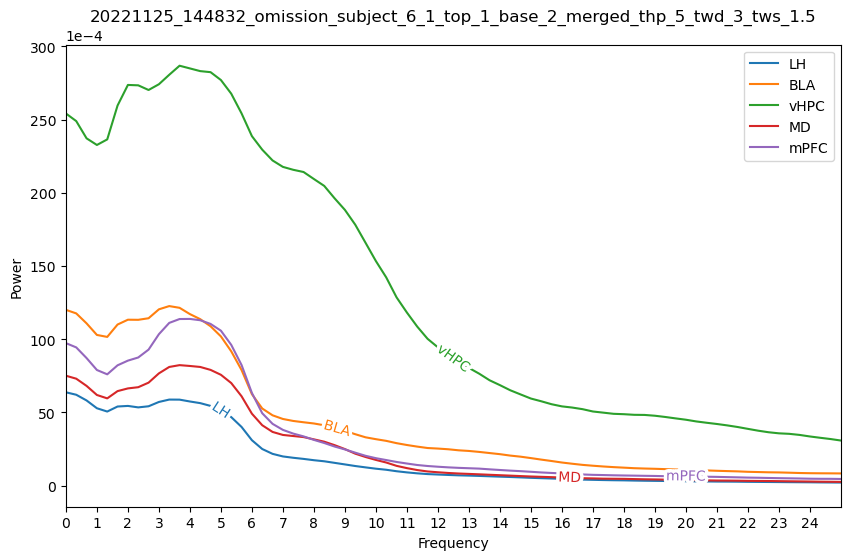

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_5_twd_3_tws_1.5.png


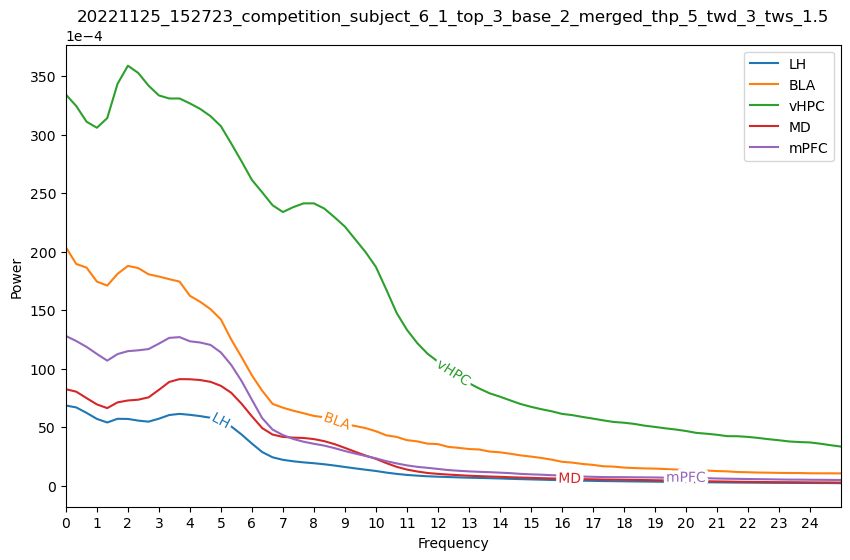

time_halfbandwidth_product: 5, time_window_duration: 3,         tws_ratio: 0.9, time_window_step 2.7
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_3_tws_2.7_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_3_tws_2.7_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_3_tws_2.7_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_3_tws_2.7_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

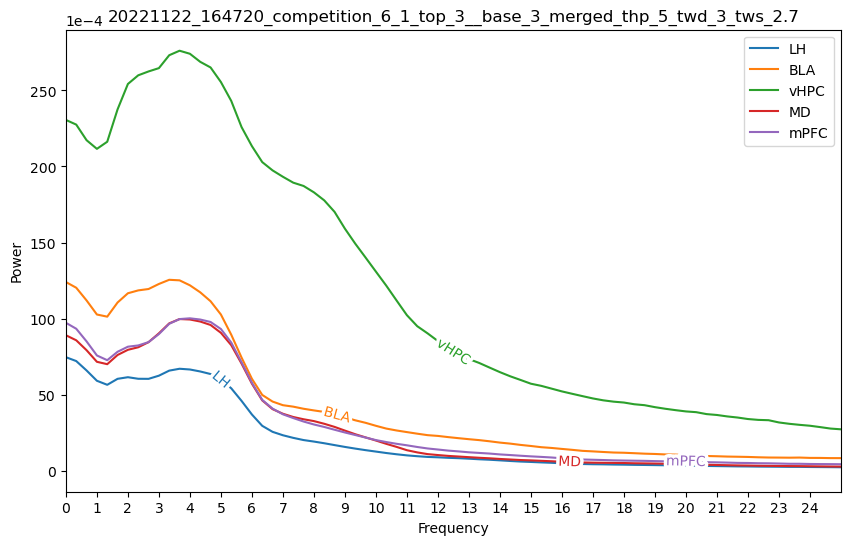

20221122_161341_omission_subject_6_1_top_4_base_2_thp_5_twd_3_tws_2.7.png


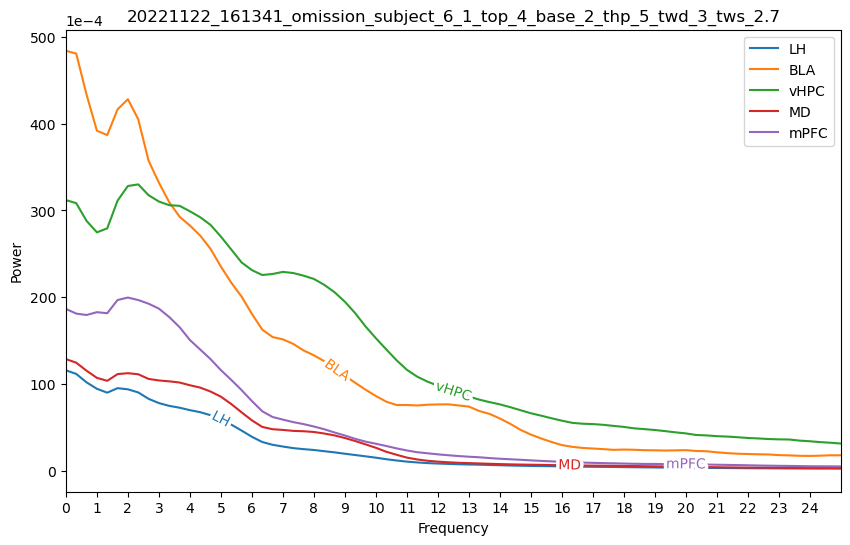

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_5_twd_3_tws_2.7.png


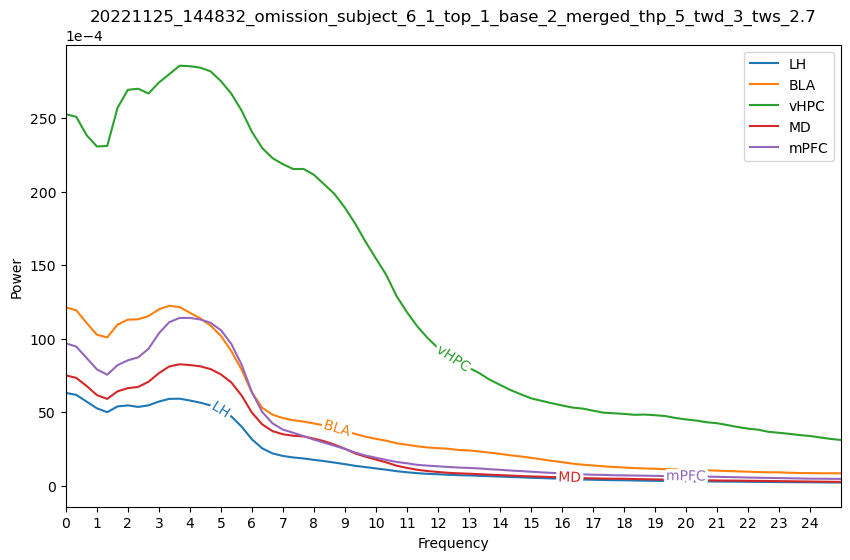

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_5_twd_3_tws_2.7.png


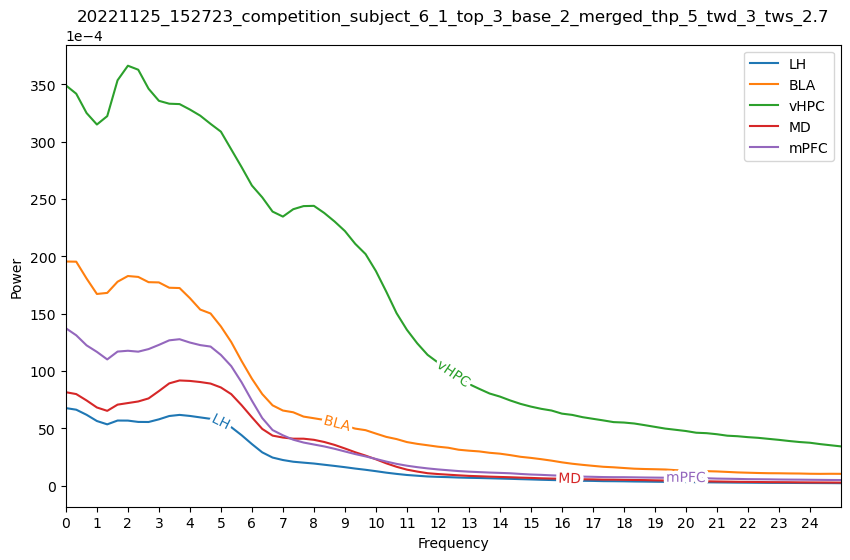

time_halfbandwidth_product: 5, time_window_duration: 5,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_5_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_5_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_5_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_5_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

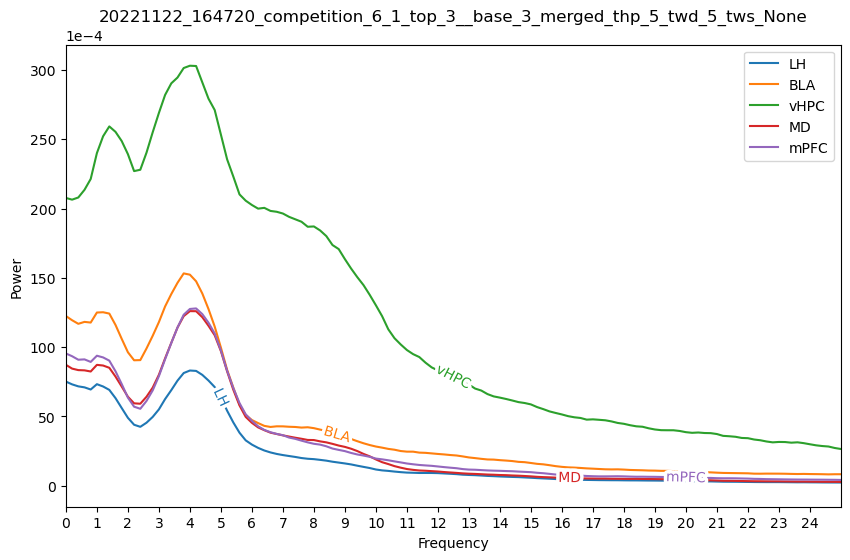

20221122_161341_omission_subject_6_1_top_4_base_2_thp_5_twd_5_tws_None.png


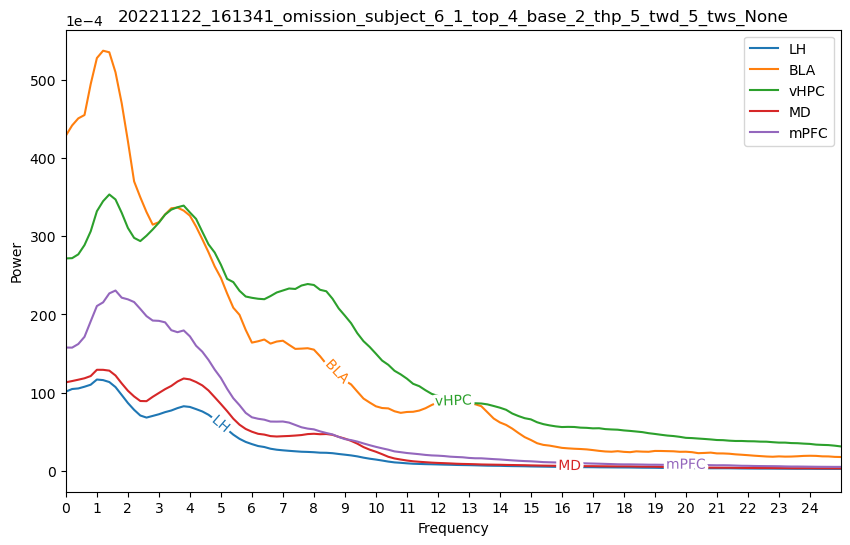

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_5_twd_5_tws_None.png


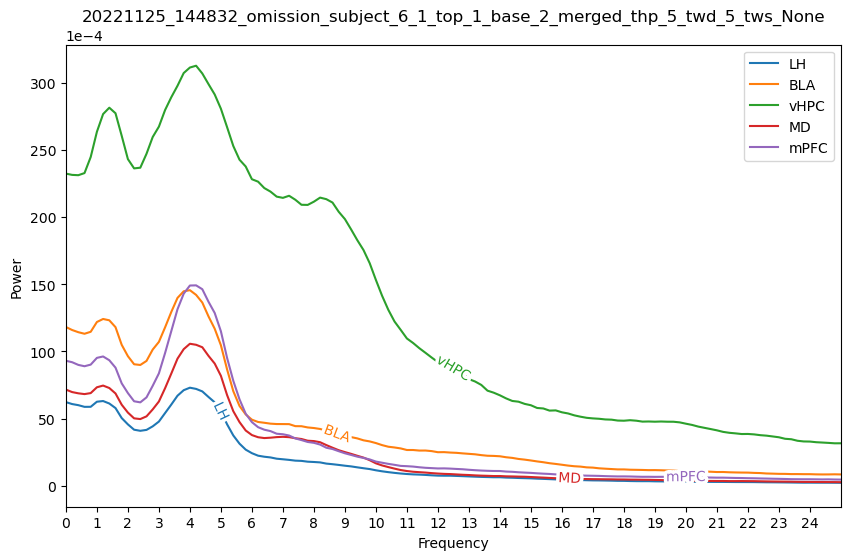

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_5_twd_5_tws_None.png


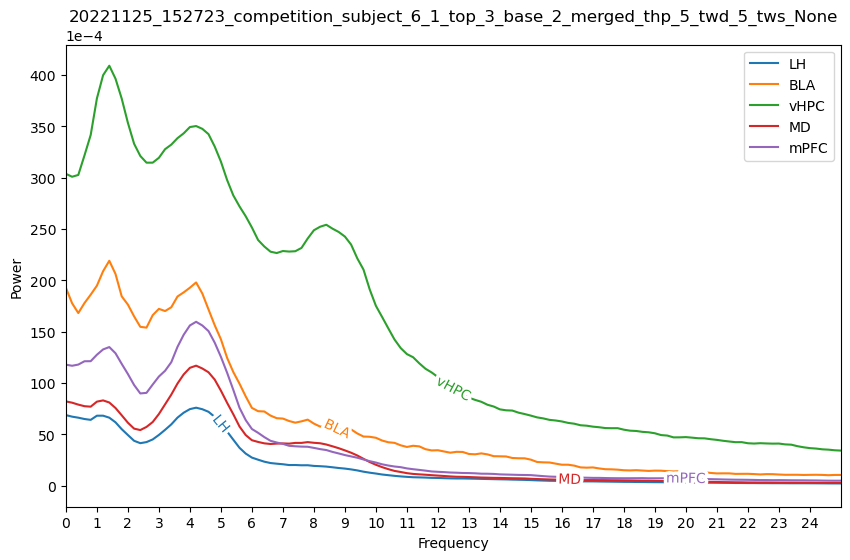

time_halfbandwidth_product: 5, time_window_duration: 5,         tws_ratio: 0.5, time_window_step 2.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_5_tws_2.5_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_5_tws_2.5_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_5_tws_2.5_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_5_tws_2.5_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

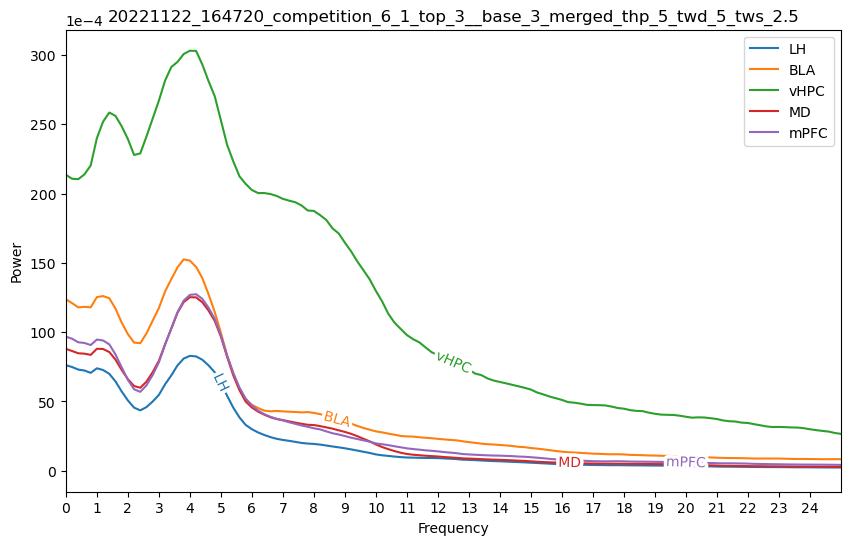

20221122_161341_omission_subject_6_1_top_4_base_2_thp_5_twd_5_tws_2.5.png


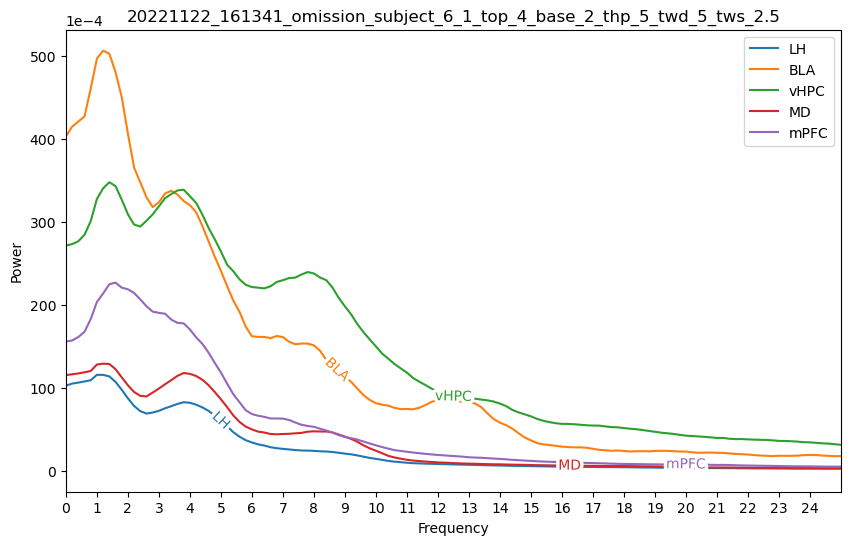

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_5_twd_5_tws_2.5.png


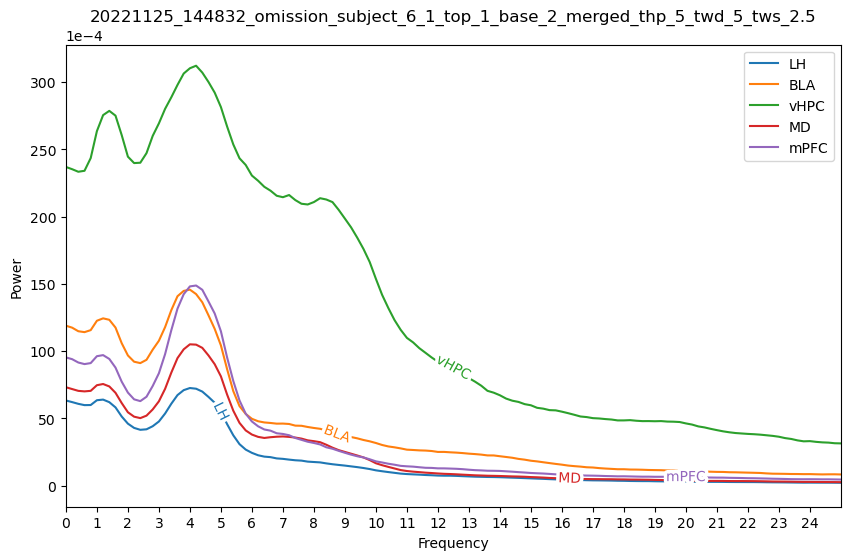

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_5_twd_5_tws_2.5.png


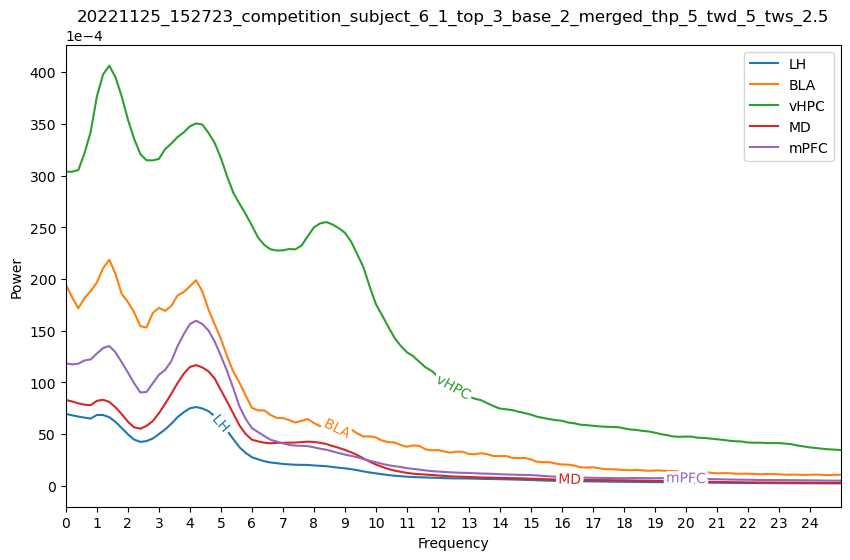

time_halfbandwidth_product: 5, time_window_duration: 5,         tws_ratio: 0.9, time_window_step 4.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_5_tws_4.5_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_5_tws_4.5_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_5_tws_4.5_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_5_tws_4.5_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

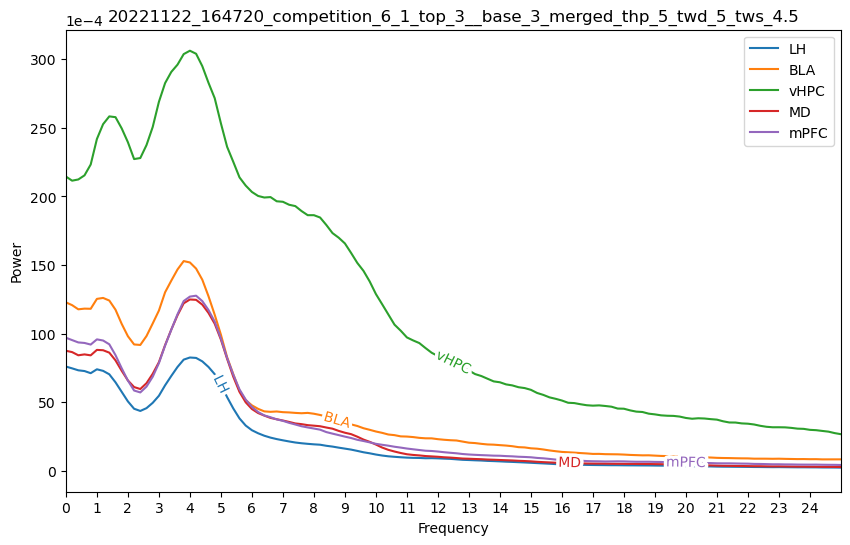

20221122_161341_omission_subject_6_1_top_4_base_2_thp_5_twd_5_tws_4.5.png


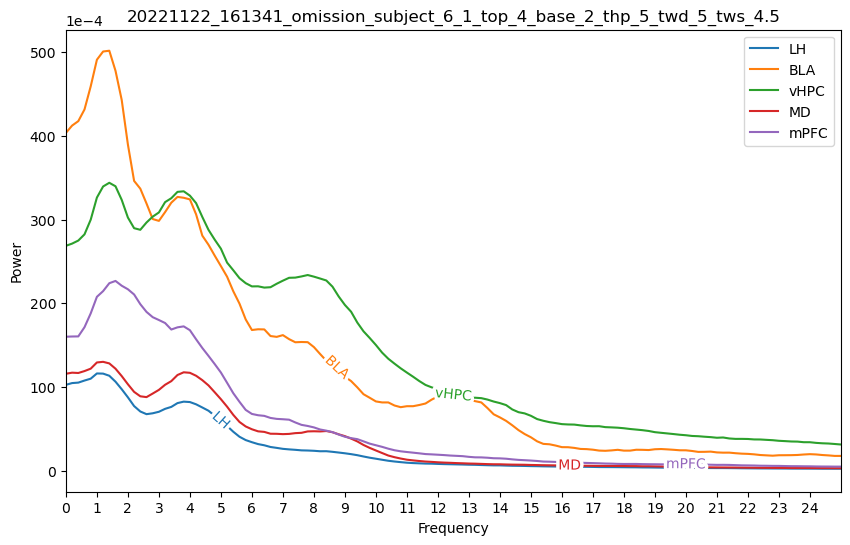

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_5_twd_5_tws_4.5.png


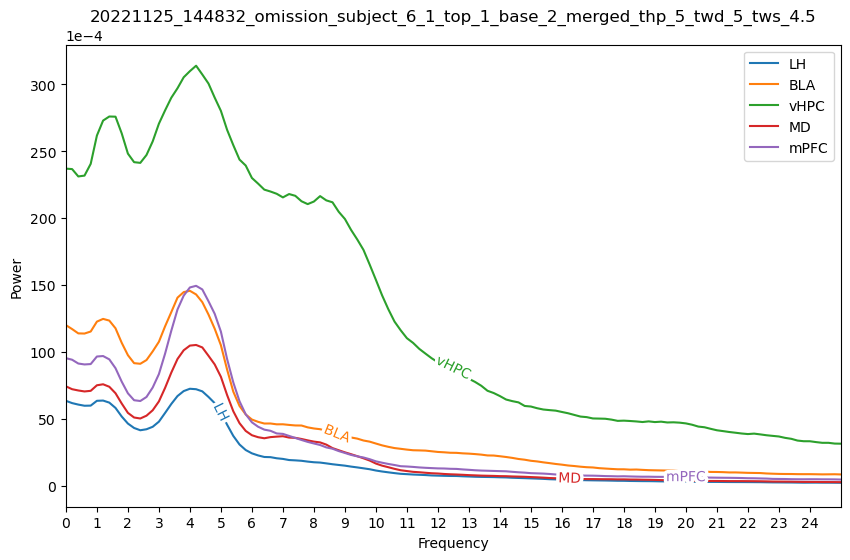

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_5_twd_5_tws_4.5.png


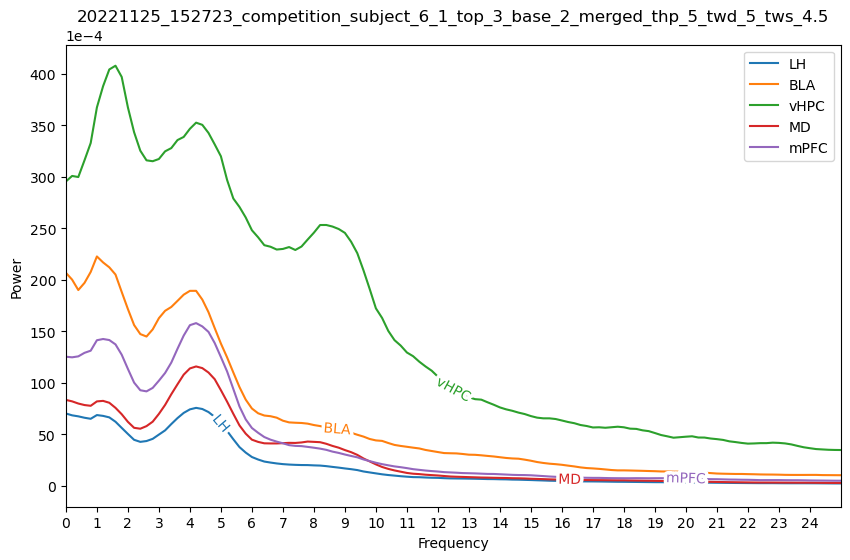

time_halfbandwidth_product: 5, time_window_duration: 7,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_7_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_7_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_7_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_7_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

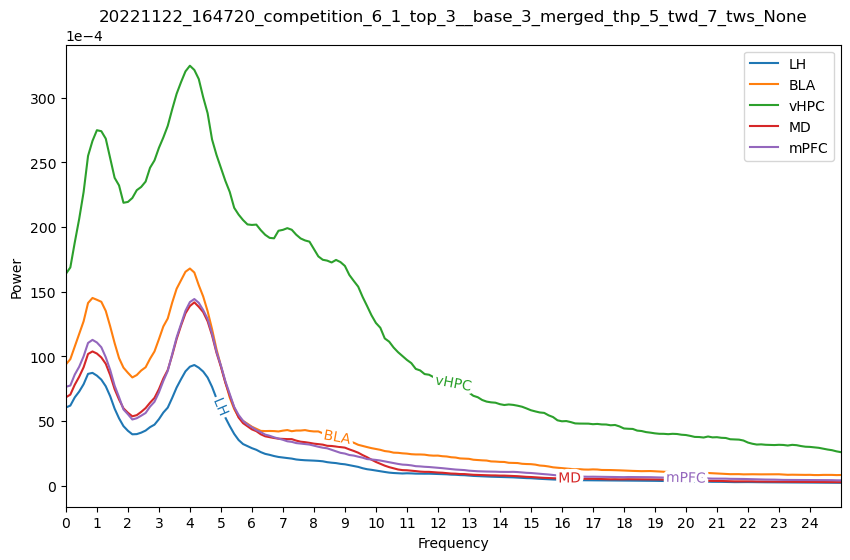

20221122_161341_omission_subject_6_1_top_4_base_2_thp_5_twd_7_tws_None.png


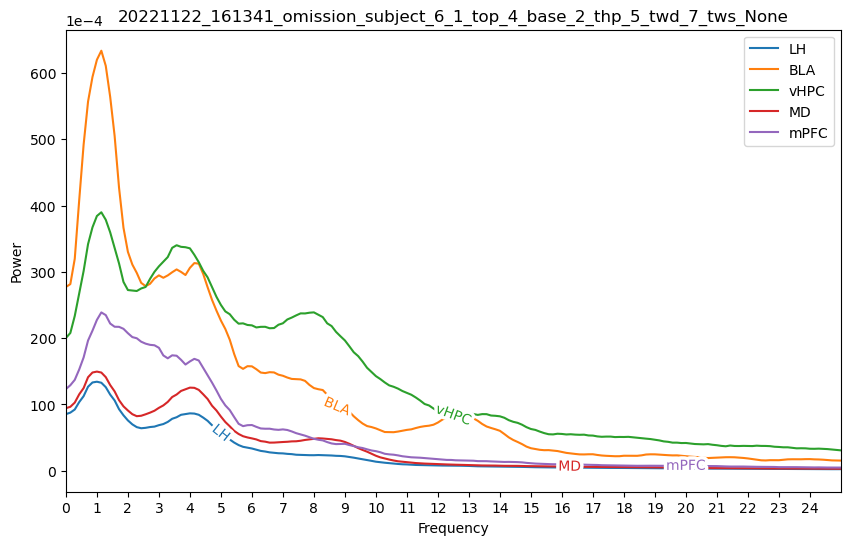

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_5_twd_7_tws_None.png


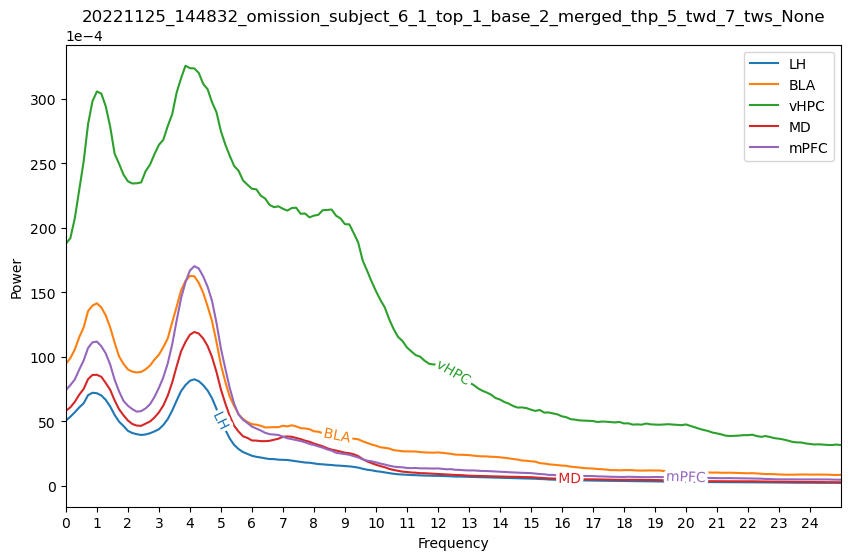

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_5_twd_7_tws_None.png


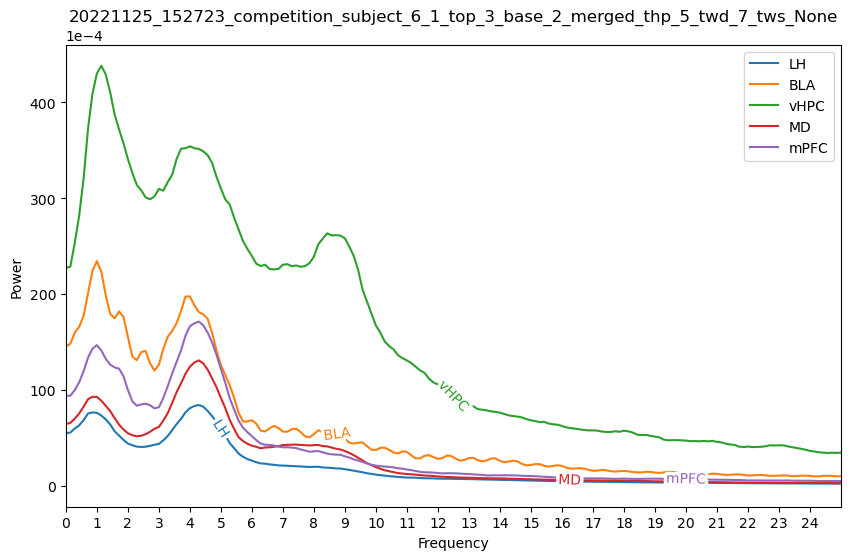

time_halfbandwidth_product: 5, time_window_duration: 7,         tws_ratio: 0.5, time_window_step 3.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_7_tws_3.5_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_7_tws_3.5_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_7_tws_3.5_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_7_tws_3.5_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

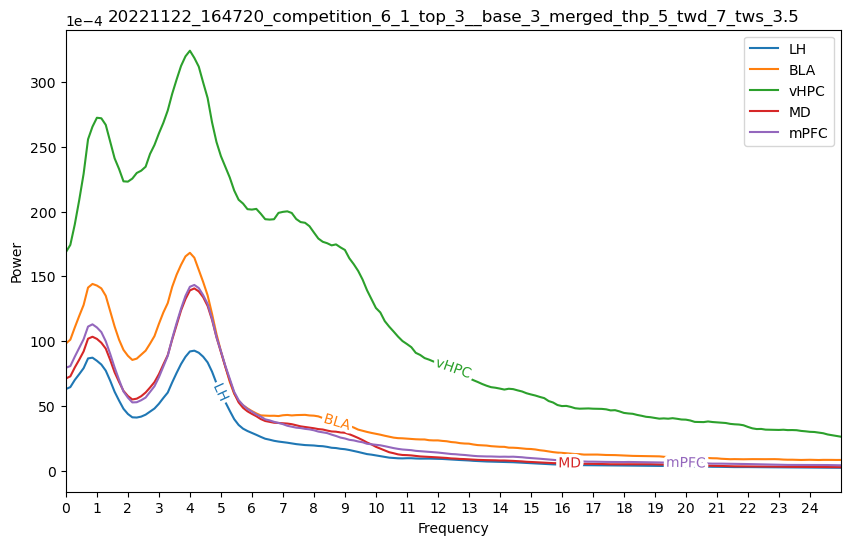

20221122_161341_omission_subject_6_1_top_4_base_2_thp_5_twd_7_tws_3.5.png


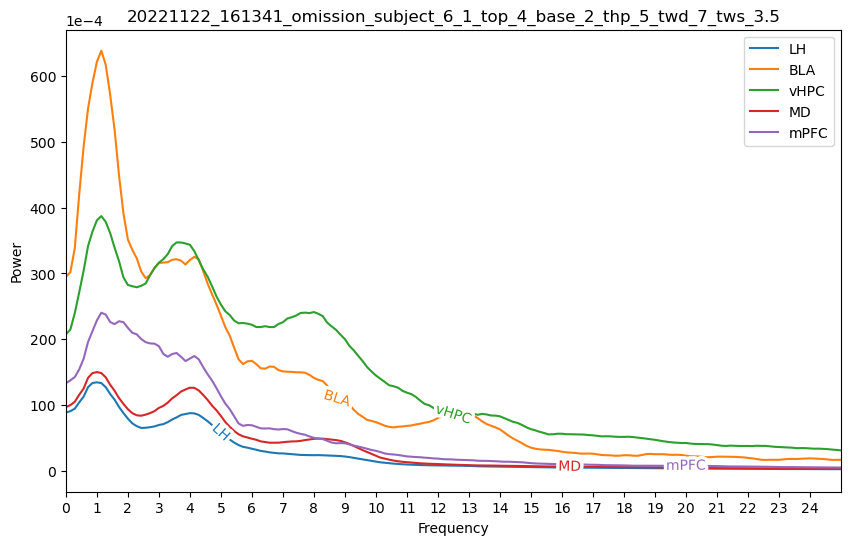

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_5_twd_7_tws_3.5.png


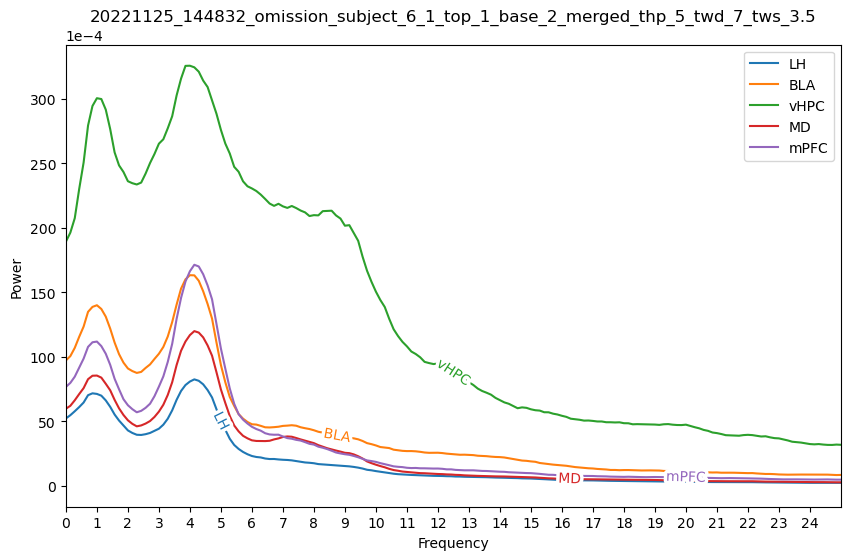

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_5_twd_7_tws_3.5.png


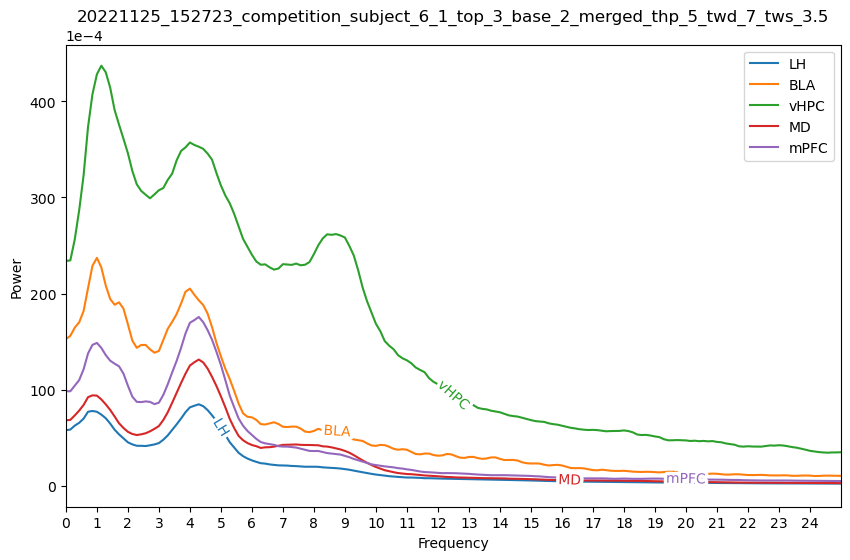

time_halfbandwidth_product: 5, time_window_duration: 7,         tws_ratio: 0.9, time_window_step 6.3
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_7_tws_6.3_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_7_tws_6.3_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_7_tws_6.3_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_7_tws_6.3_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

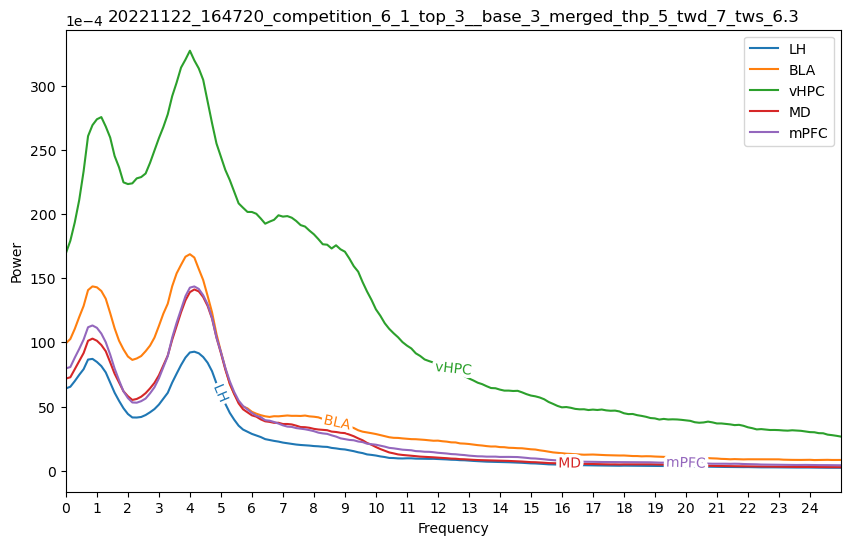

20221122_161341_omission_subject_6_1_top_4_base_2_thp_5_twd_7_tws_6.3.png


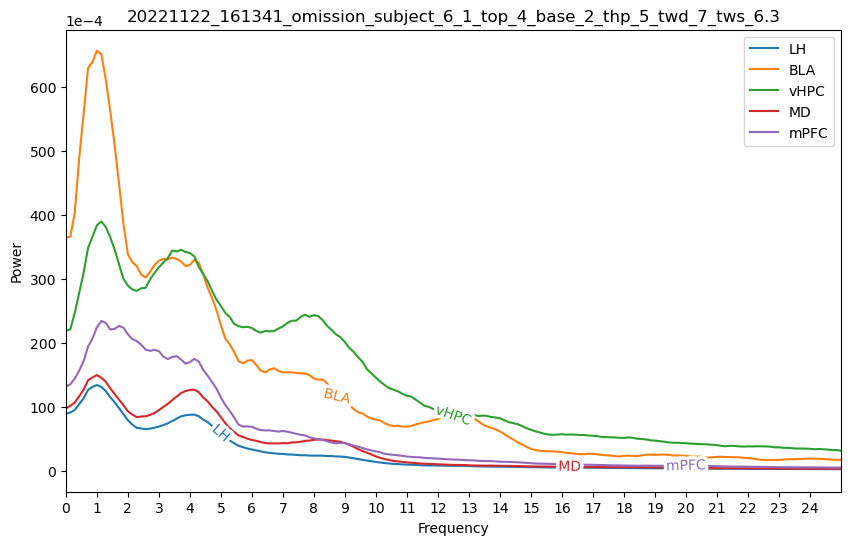

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_5_twd_7_tws_6.3.png


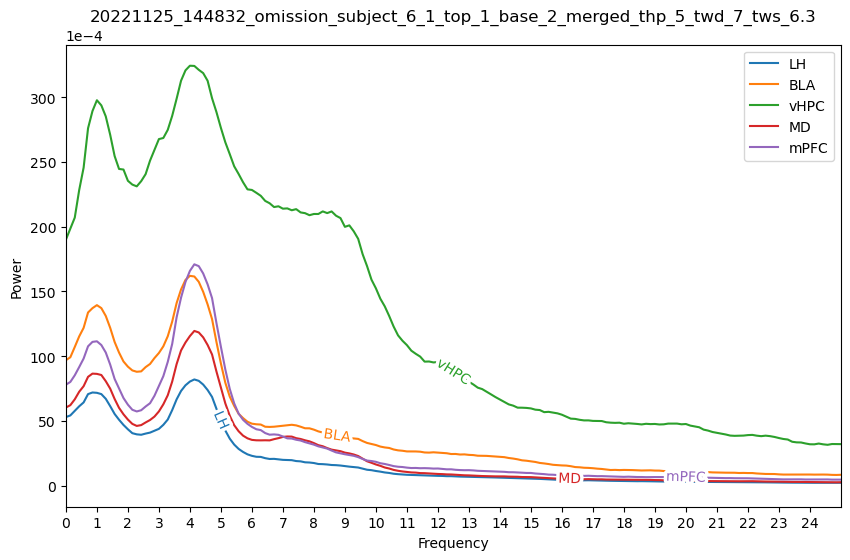

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_5_twd_7_tws_6.3.png


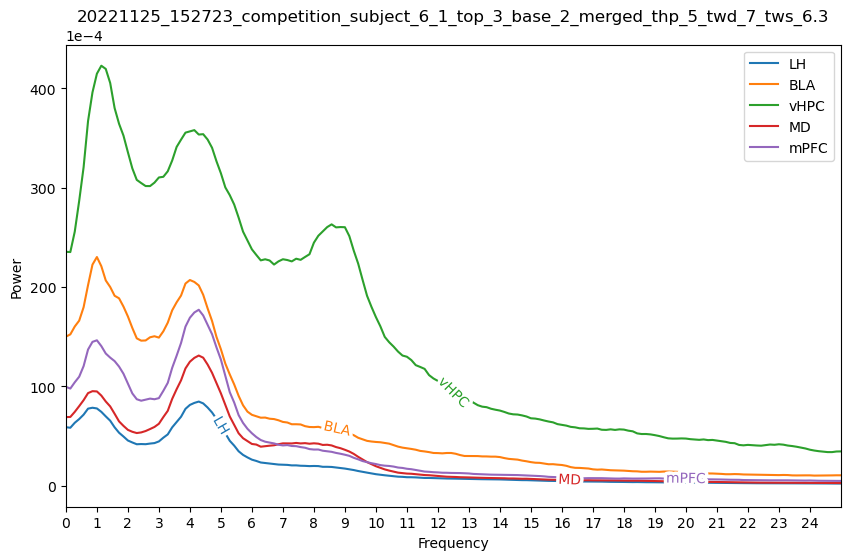

time_halfbandwidth_product: 5, time_window_duration: 10,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_10_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_10_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_10_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_10_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competiti

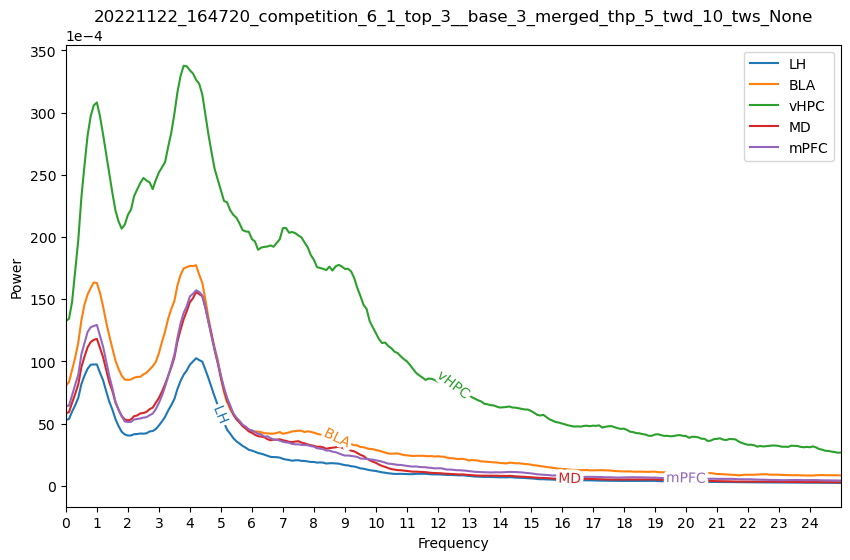

20221122_161341_omission_subject_6_1_top_4_base_2_thp_5_twd_10_tws_None.png


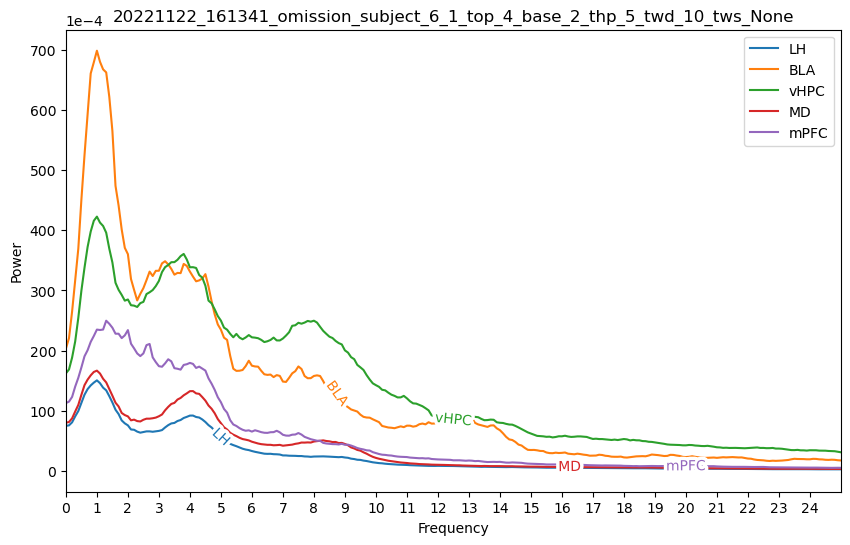

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_5_twd_10_tws_None.png


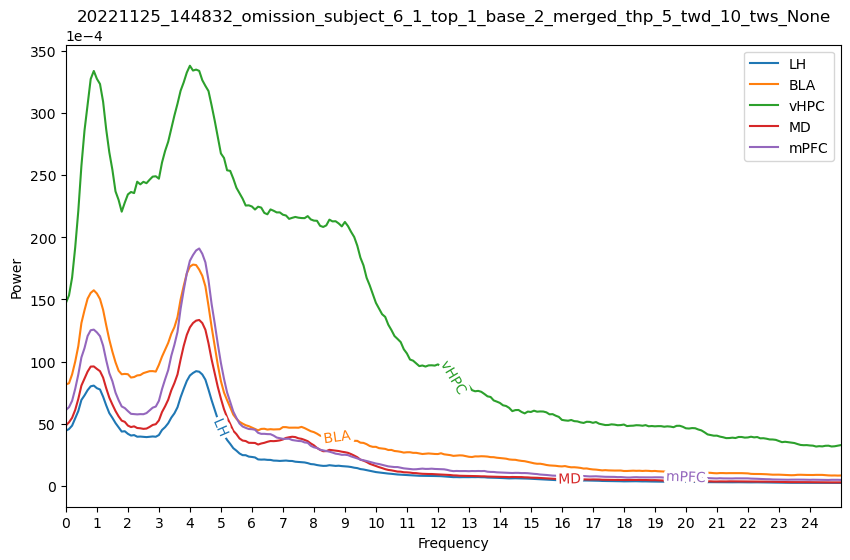

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_5_twd_10_tws_None.png


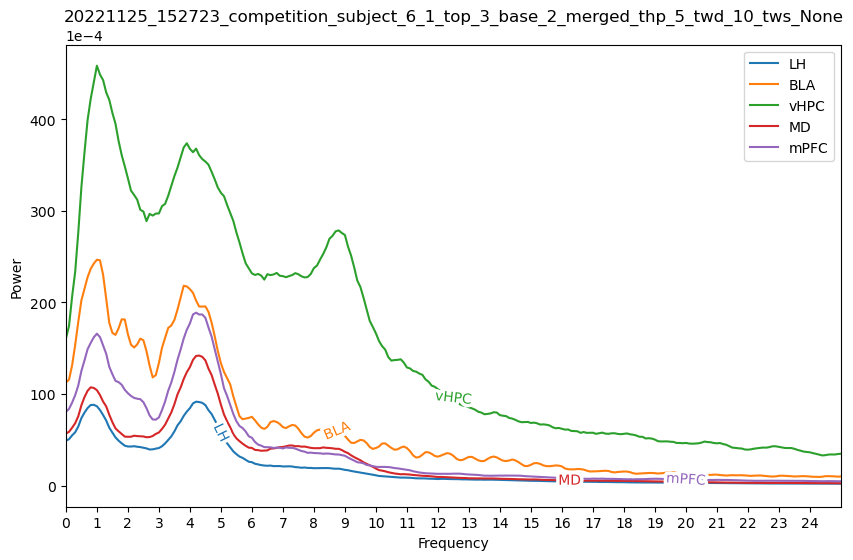

time_halfbandwidth_product: 5, time_window_duration: 10,         tws_ratio: 0.5, time_window_step 5.0
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_10_tws_5.0_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_10_tws_5.0_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_10_tws_5.0_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_10_tws_5.0_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1

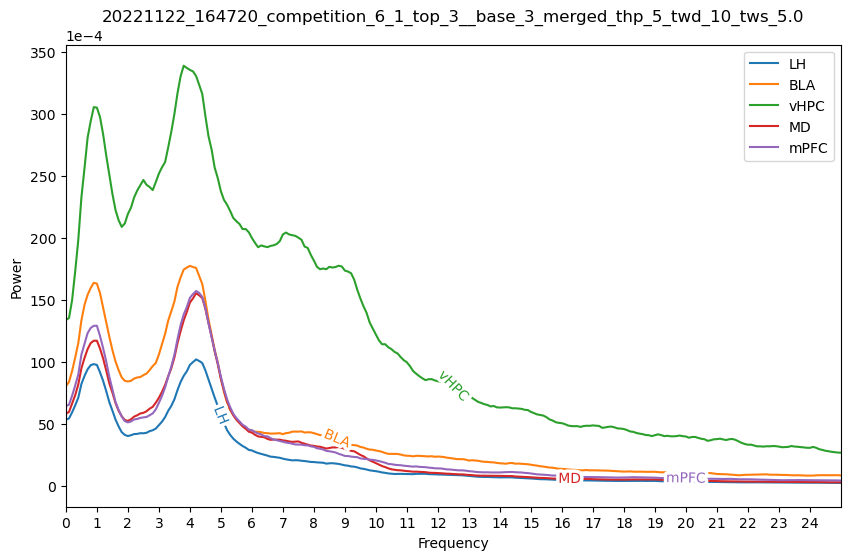

20221122_161341_omission_subject_6_1_top_4_base_2_thp_5_twd_10_tws_5.0.png


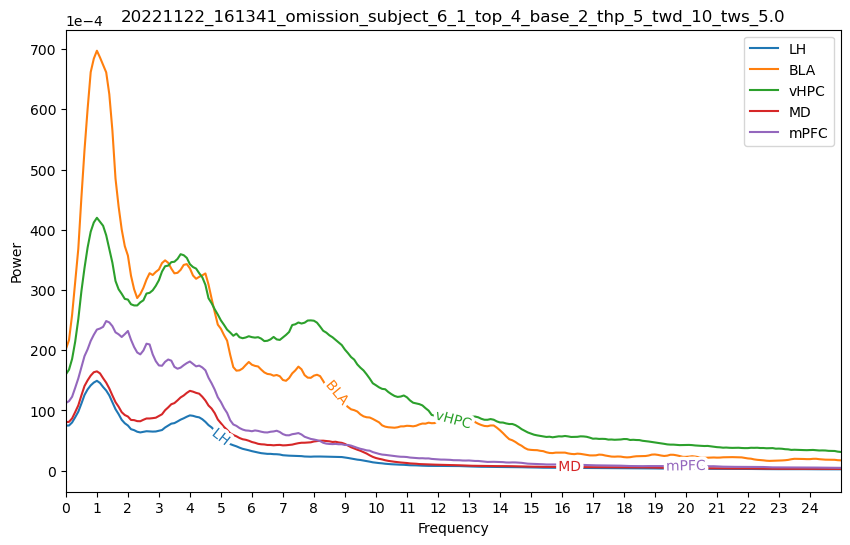

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_5_twd_10_tws_5.0.png


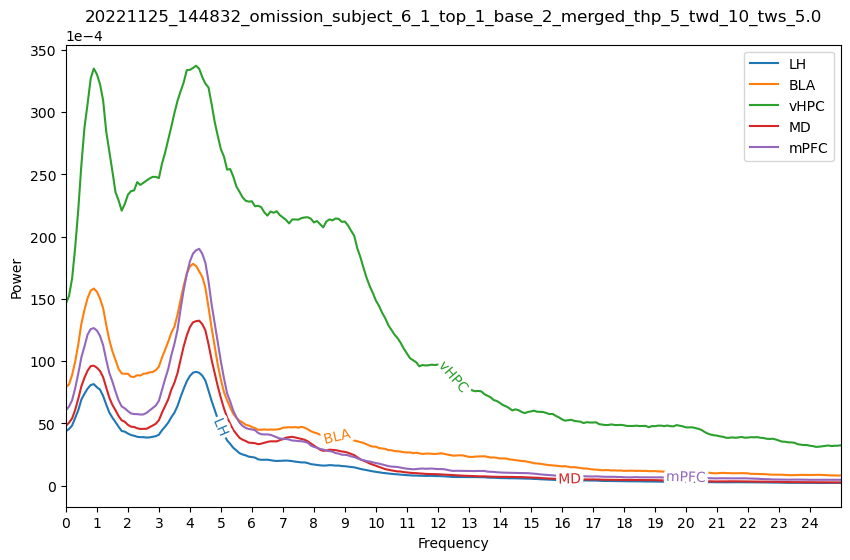

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_5_twd_10_tws_5.0.png


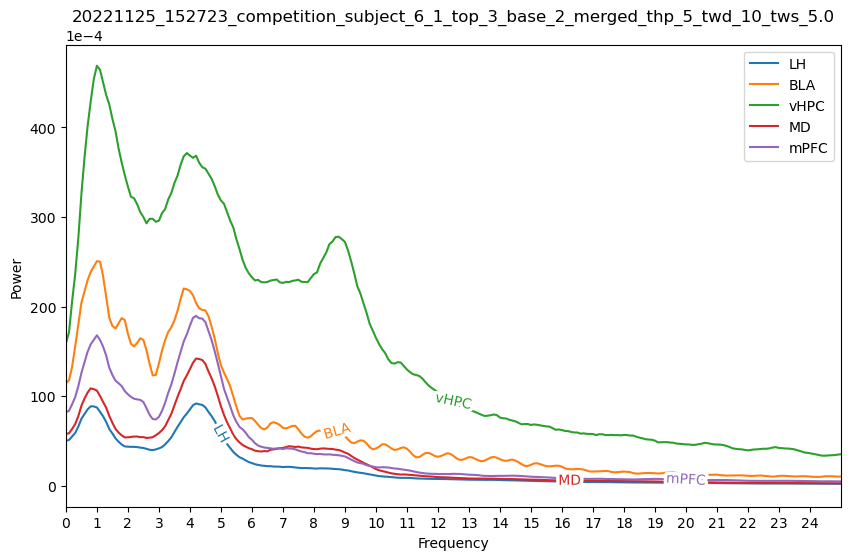

time_halfbandwidth_product: 5, time_window_duration: 10,         tws_ratio: 0.9, time_window_step 9.0
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_10_tws_9.0_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_10_tws_9.0_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_10_tws_9.0_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_5_twd_10_tws_9.0_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1

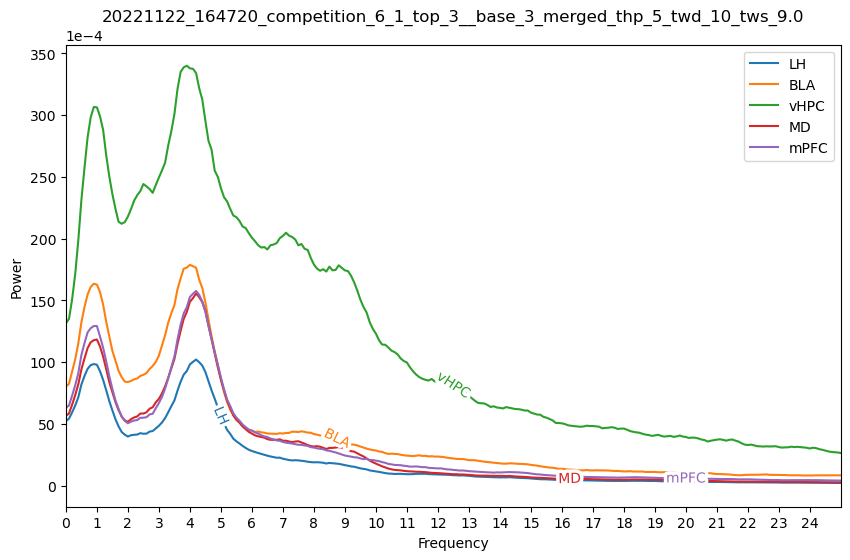

20221122_161341_omission_subject_6_1_top_4_base_2_thp_5_twd_10_tws_9.0.png


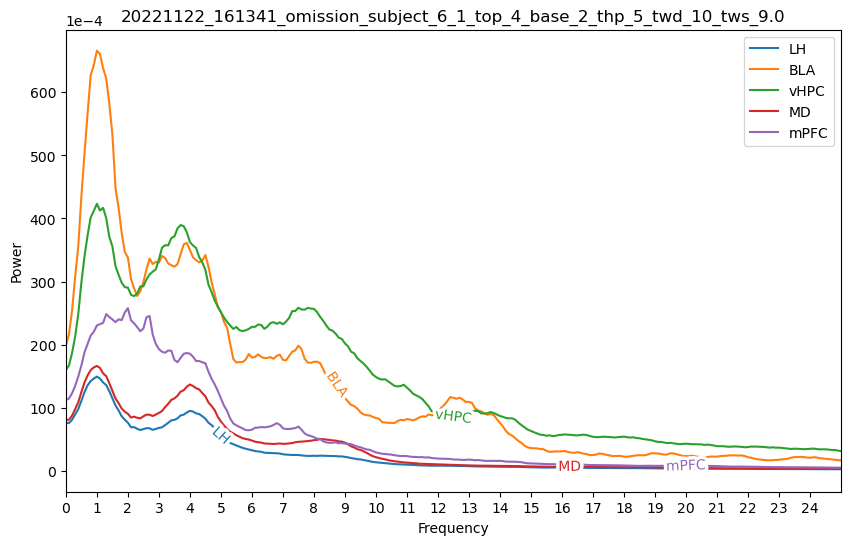

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_5_twd_10_tws_9.0.png


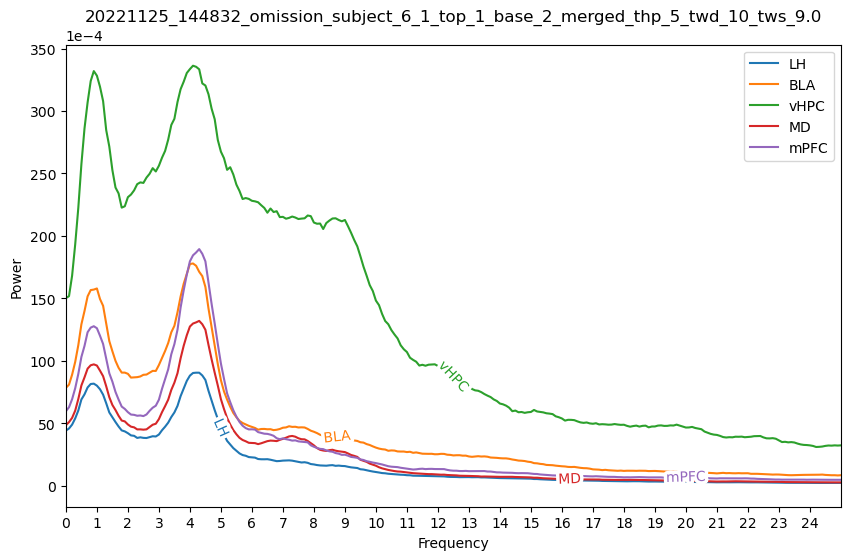

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_5_twd_10_tws_9.0.png


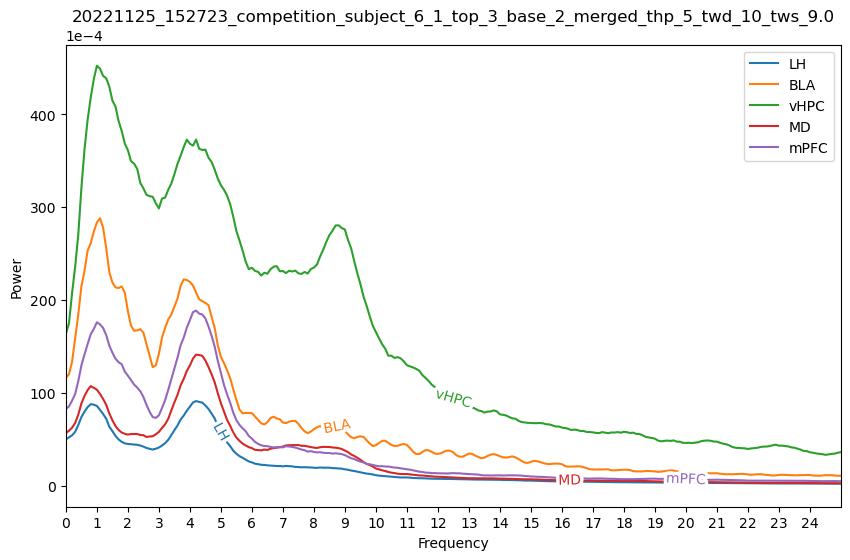

time_halfbandwidth_product: 7, time_window_duration: 1,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_1_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_1_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_1_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_1_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

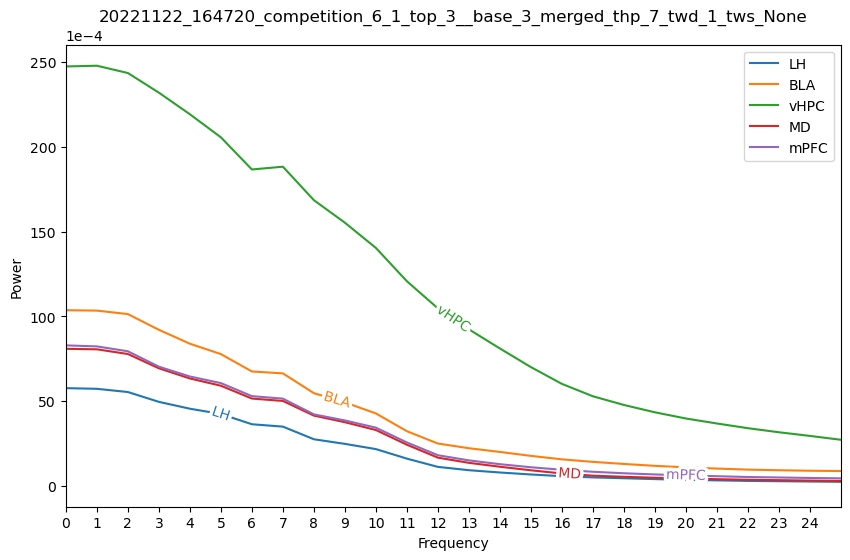

20221122_161341_omission_subject_6_1_top_4_base_2_thp_7_twd_1_tws_None.png


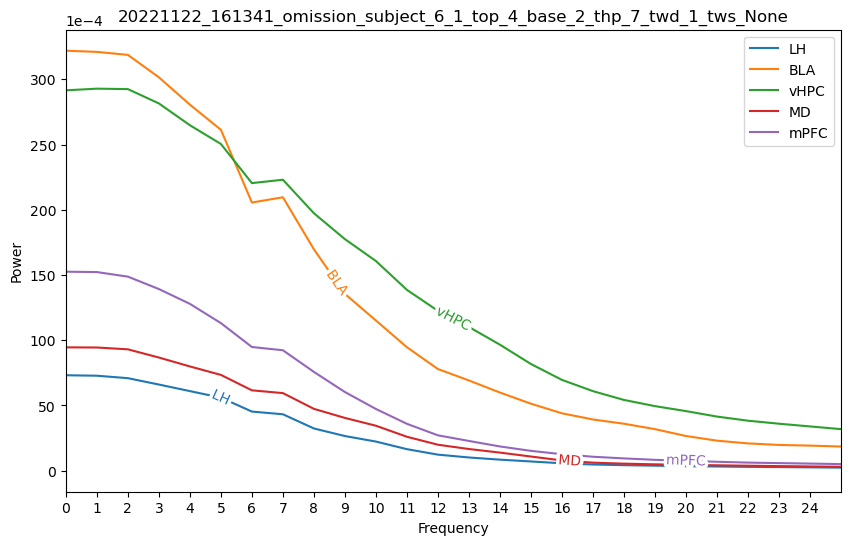

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_7_twd_1_tws_None.png


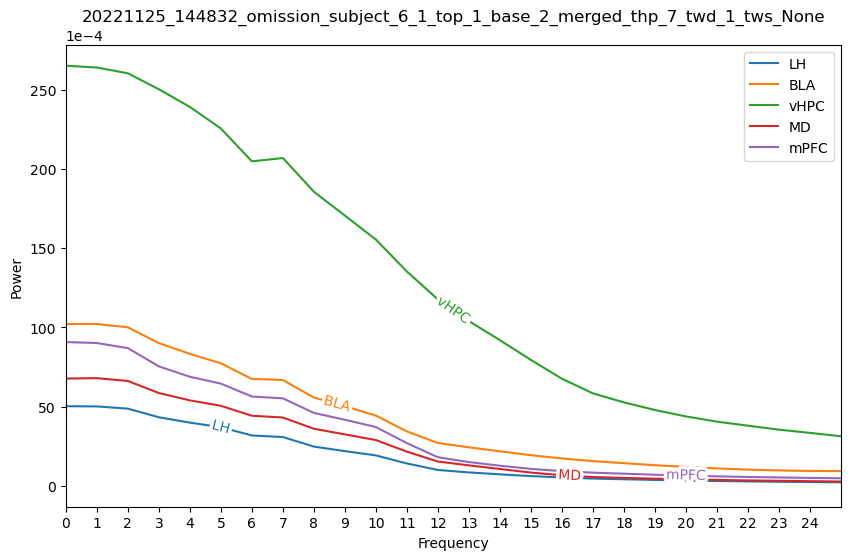

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_1_tws_None.png


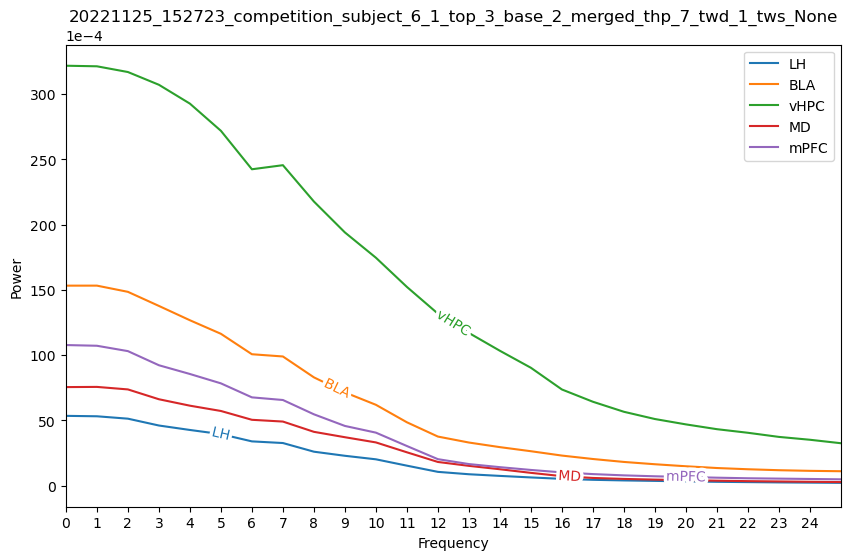

time_halfbandwidth_product: 7, time_window_duration: 1,         tws_ratio: 0.5, time_window_step 0.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_1_tws_0.5_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_1_tws_0.5_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_1_tws_0.5_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_1_tws_0.5_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

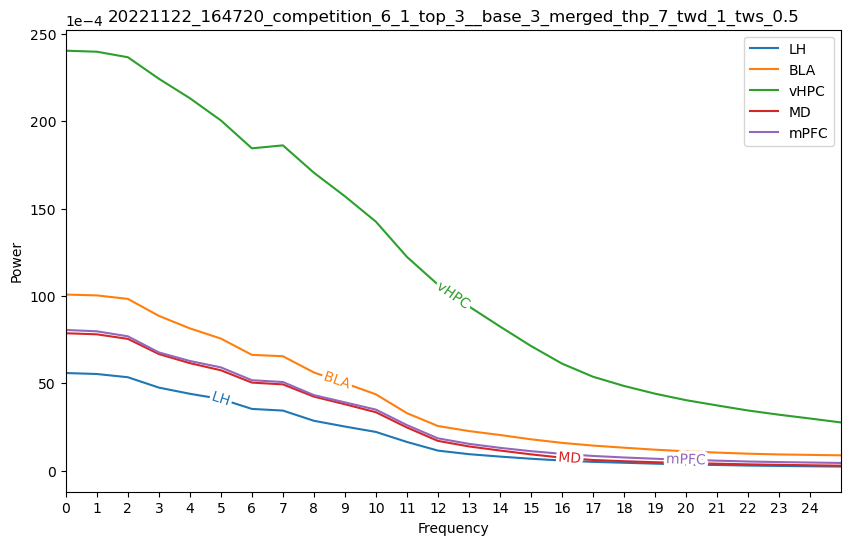

20221122_161341_omission_subject_6_1_top_4_base_2_thp_7_twd_1_tws_0.5.png


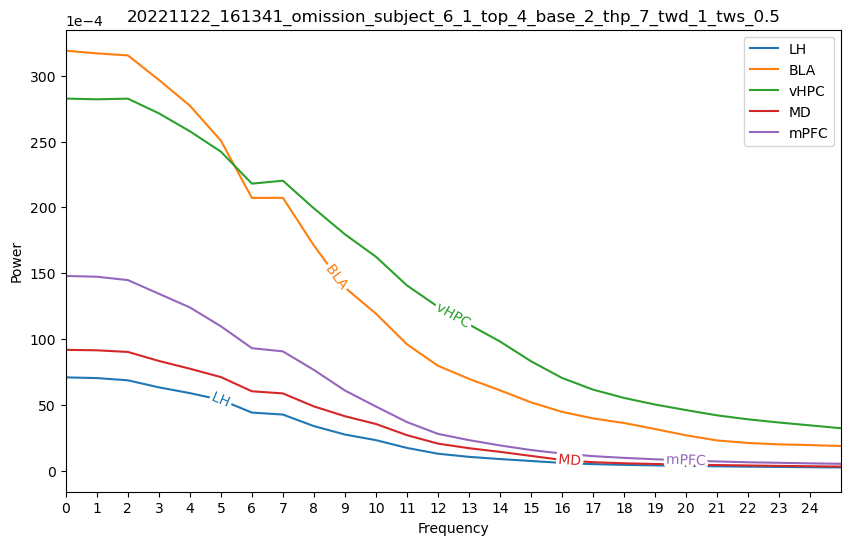

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_7_twd_1_tws_0.5.png


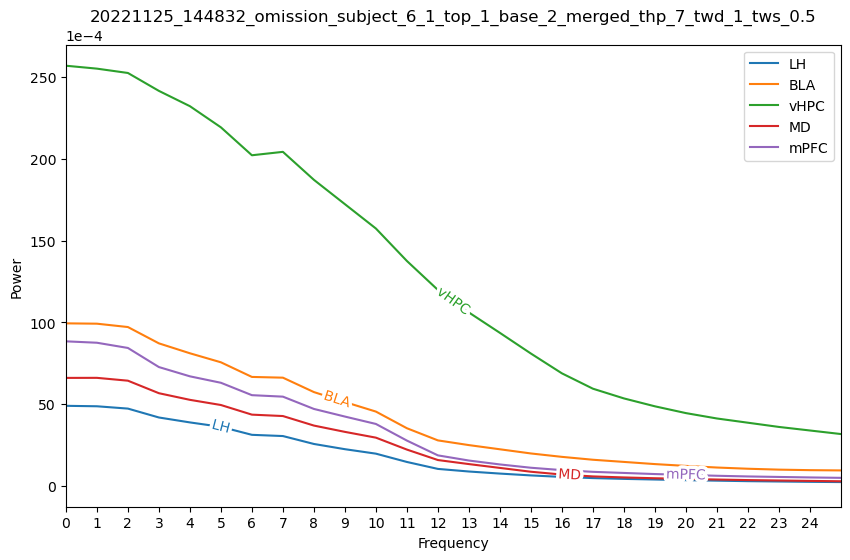

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_7_twd_1_tws_0.5.png


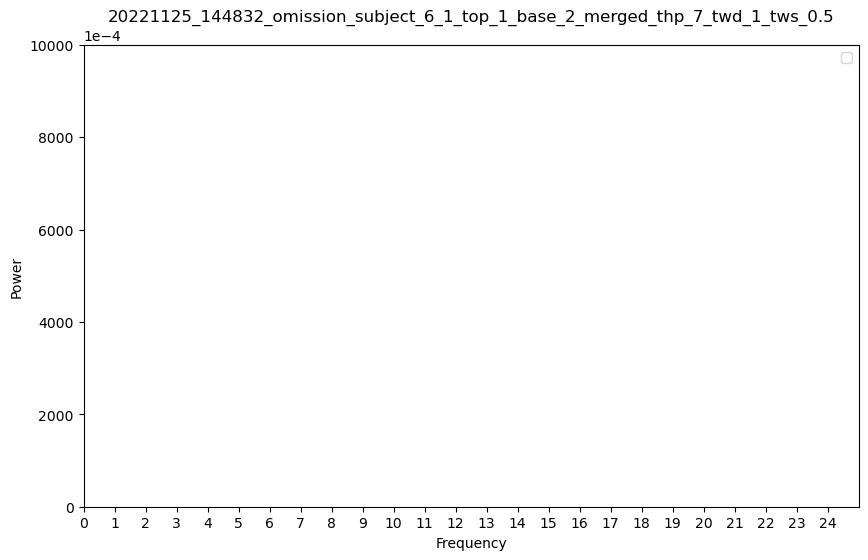

time_halfbandwidth_product: 7, time_window_duration: 1,         tws_ratio: 0.9, time_window_step 0.9
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_1_tws_0.9_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_1_tws_0.9_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_1_tws_0.9_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_1_tws_0.9_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

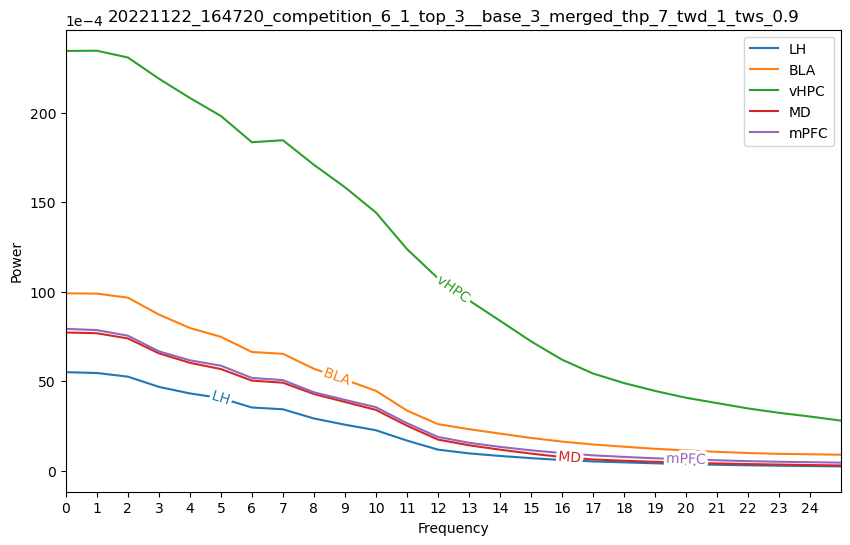

20221122_161341_omission_subject_6_1_top_4_base_2_thp_7_twd_1_tws_0.9.png


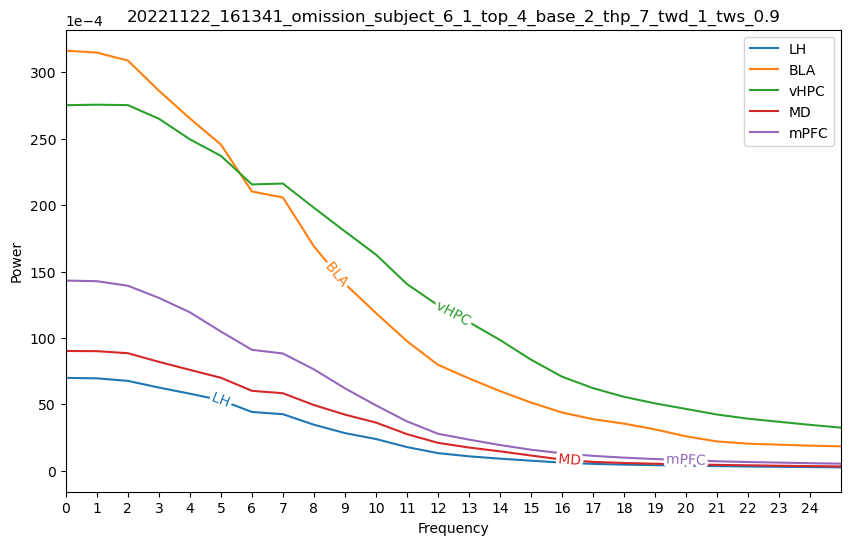

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_7_twd_1_tws_0.9.png


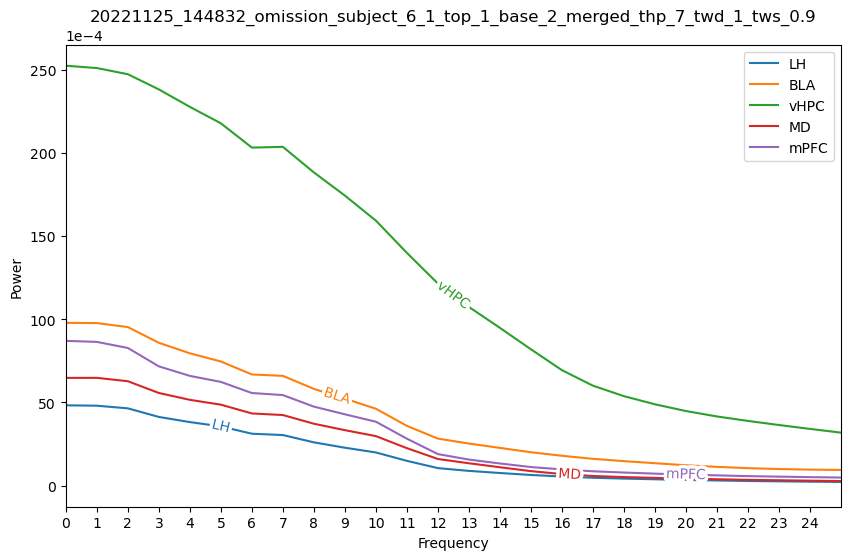

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_1_tws_0.9.png


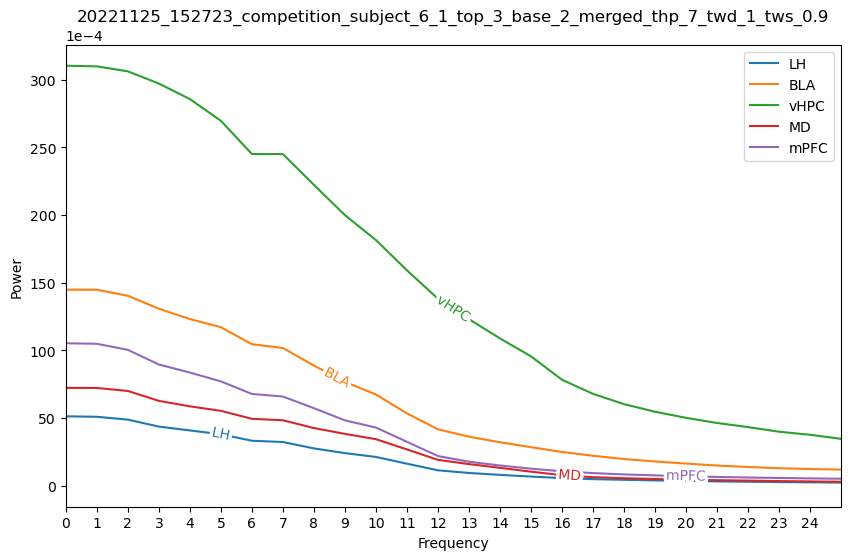

time_halfbandwidth_product: 7, time_window_duration: 2,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_2_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_2_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_2_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_2_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

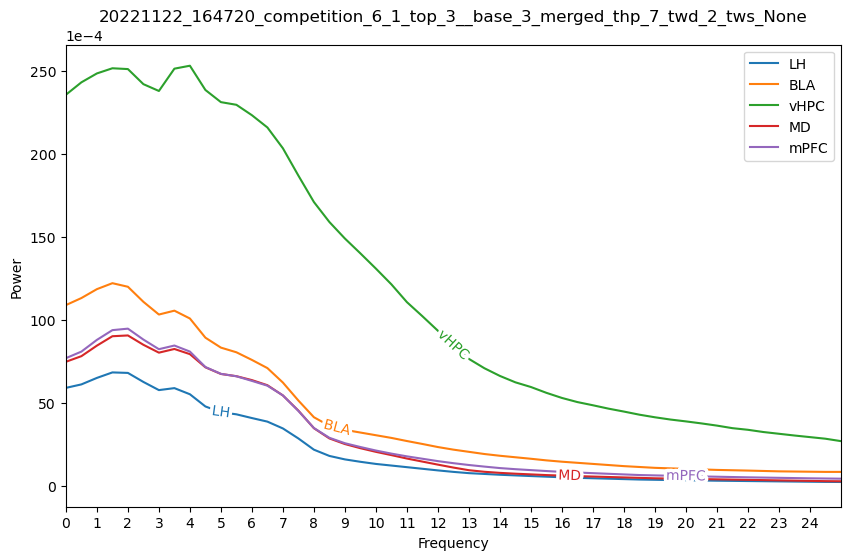

20221122_161341_omission_subject_6_1_top_4_base_2_thp_7_twd_2_tws_None.png


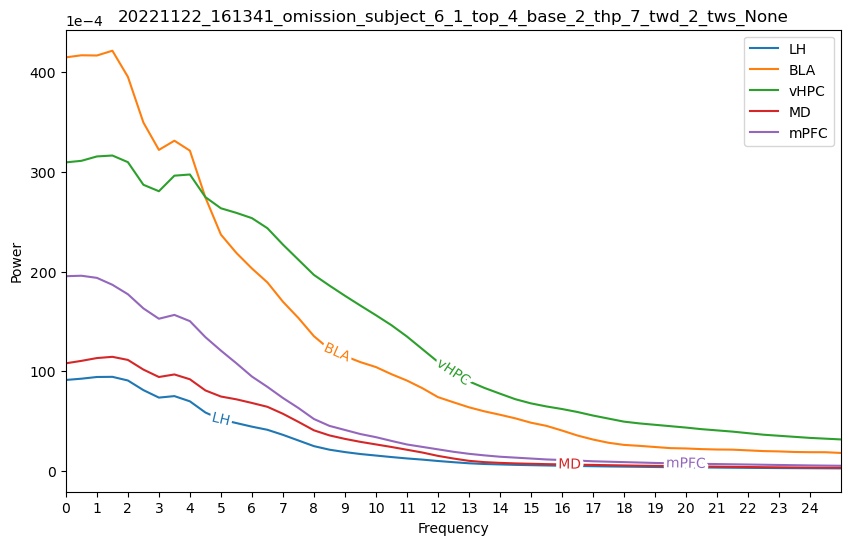

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_7_twd_2_tws_None.png


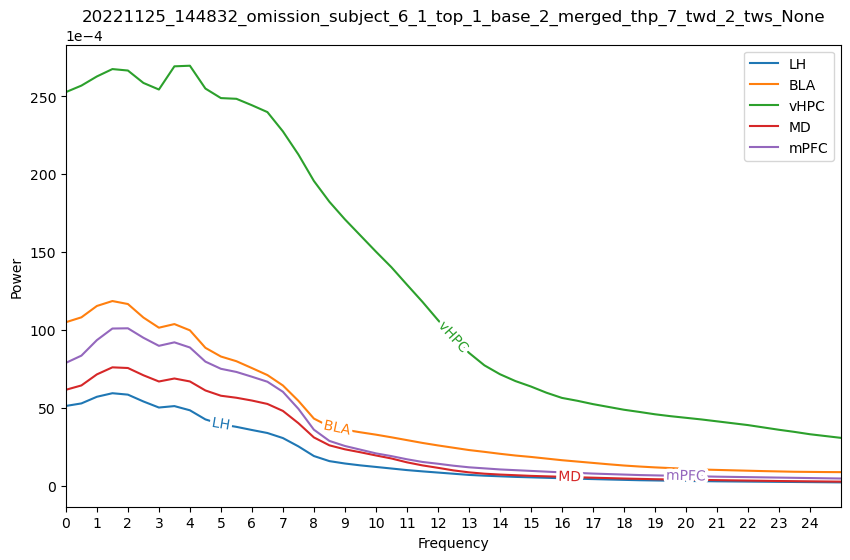

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_2_tws_None.png


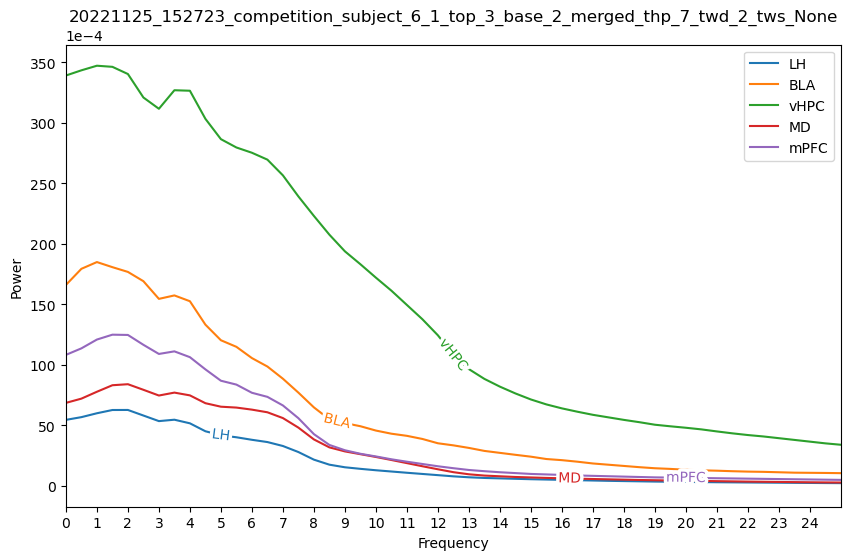

time_halfbandwidth_product: 7, time_window_duration: 2,         tws_ratio: 0.5, time_window_step 1.0
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 664,768,000 bytes (allocated so far: 9,465,364,480 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 664,768,000 bytes (allocated so far: 9,465,364,480 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 15
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 664,768,000 bytes (allocated so far: 9,465,364,480 bytes).
LFP File Path: ./

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Out of memory allocating 573,664,256 bytes (allocated so far: 9,752,595,968 bytes).
20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_2_tws_None.png


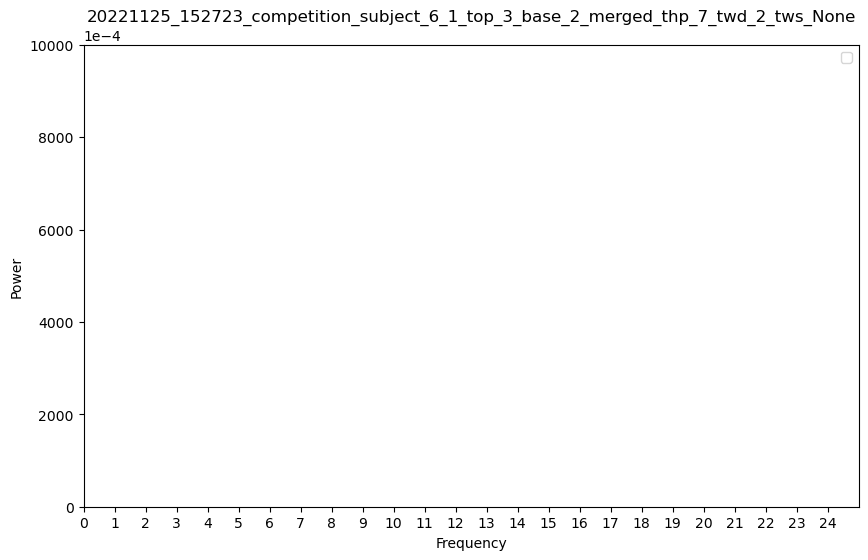

20221122_161341_omission_subject_6_1_top_4_base_2_thp_7_twd_2_tws_1.0.png


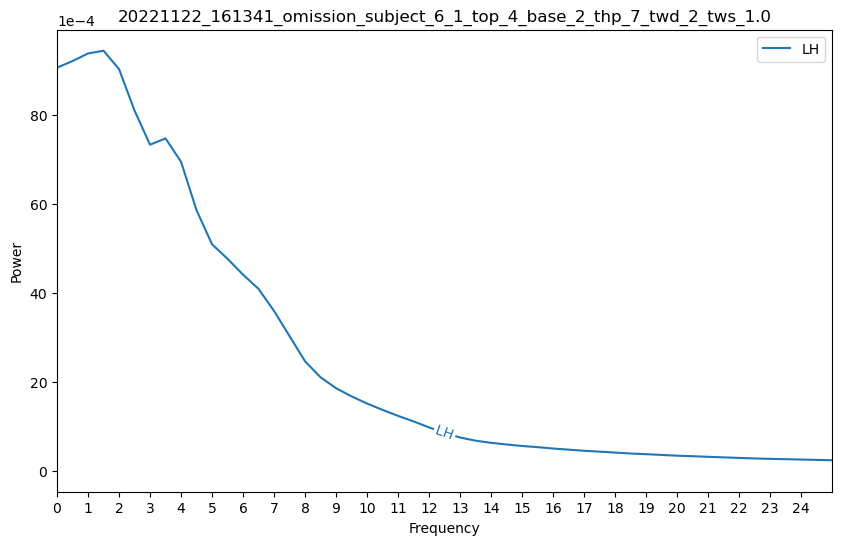

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221122_161341_omission_subject_6_1_top_4_base_2_thp_7_twd_2_tws_1.0.png


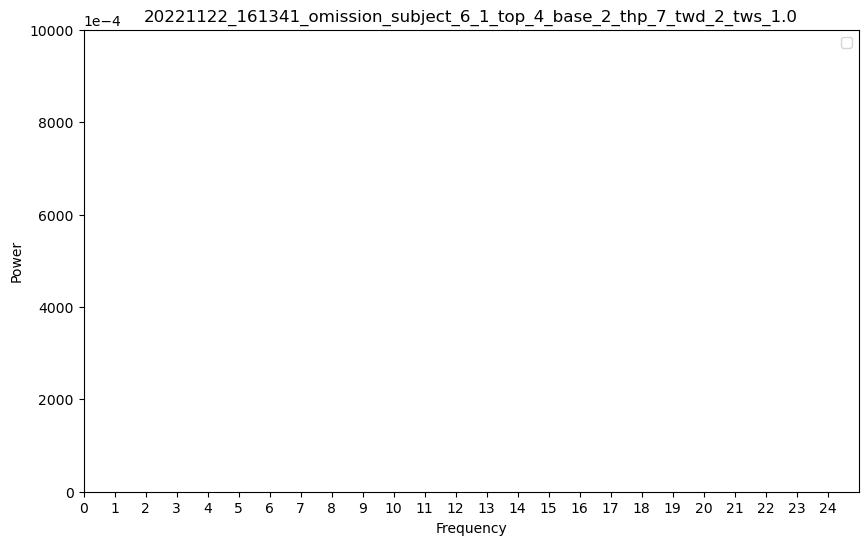

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221122_161341_omission_subject_6_1_top_4_base_2_thp_7_twd_2_tws_1.0.png


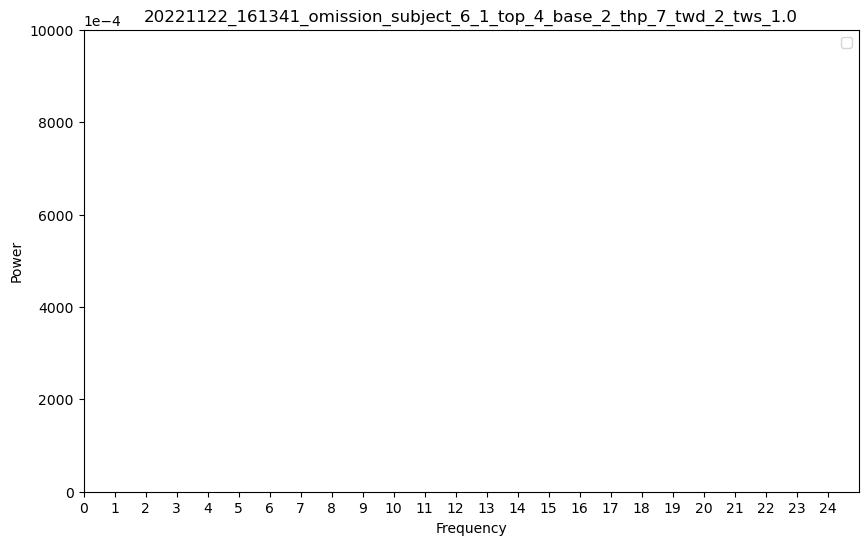

time_halfbandwidth_product: 7, time_window_duration: 2,         tws_ratio: 0.9, time_window_step 1.8
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 369,408,000 bytes (allocated so far: 9,752,595,968 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 369,408,000 bytes (allocated so far: 9,752,595,968 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 15
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 369,408,000 bytes (allocated so far: 9,752,595,968 bytes).
LFP File Path: ./

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


(1380136,)
calculating multitaper
calculating connectivity
20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_2_tws_1.8_ch_21.frequencies.npy
20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_2_tws_1.8_ch_21.power.npy
20221122_161341_omission_subject_6_1_top_4_base_2_thp_7_twd_2_tws_1.0.png


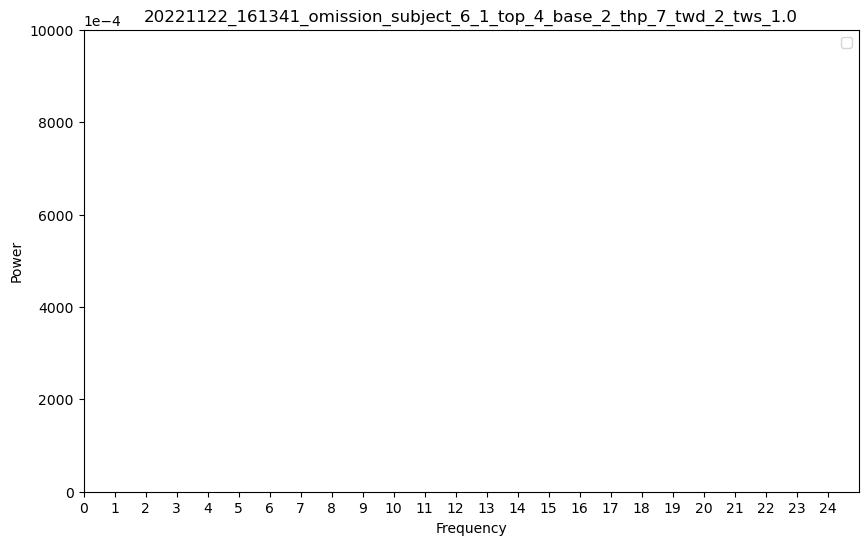

20221122_161341_omission_subject_6_1_top_4_base_2_thp_7_twd_2_tws_1.8.png


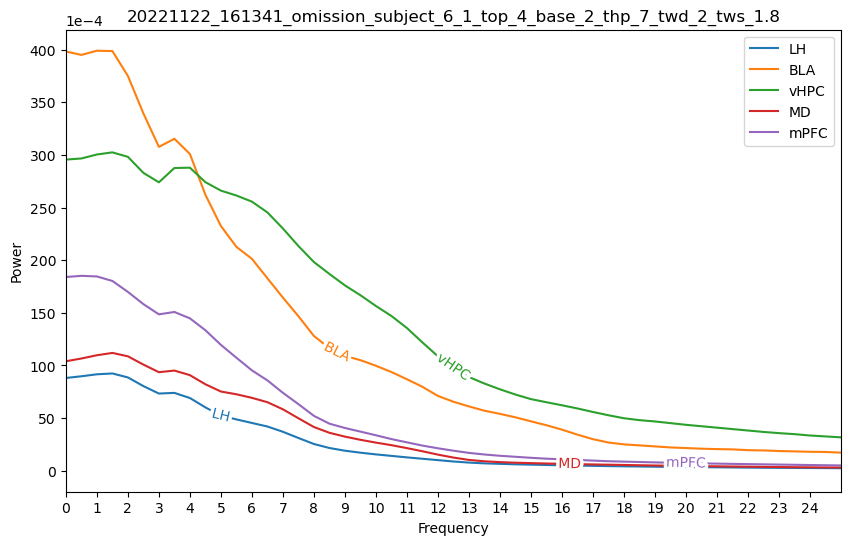

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_7_twd_2_tws_1.8.png


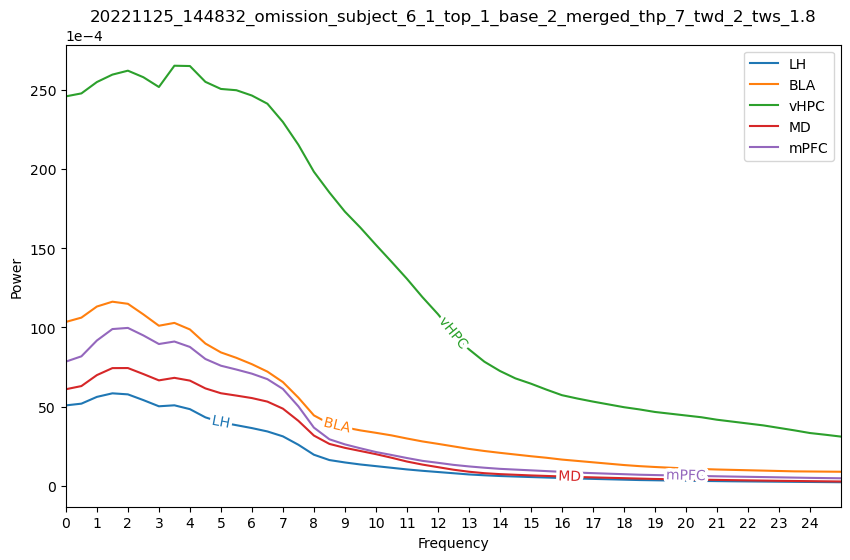

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_2_tws_1.8.png


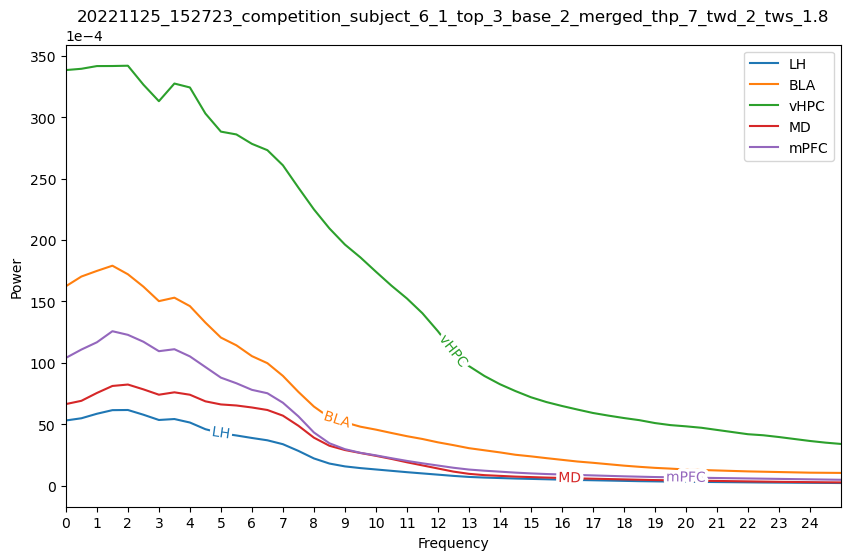

time_halfbandwidth_product: 7, time_window_duration: 3,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_3_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_3_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_3_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_3_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

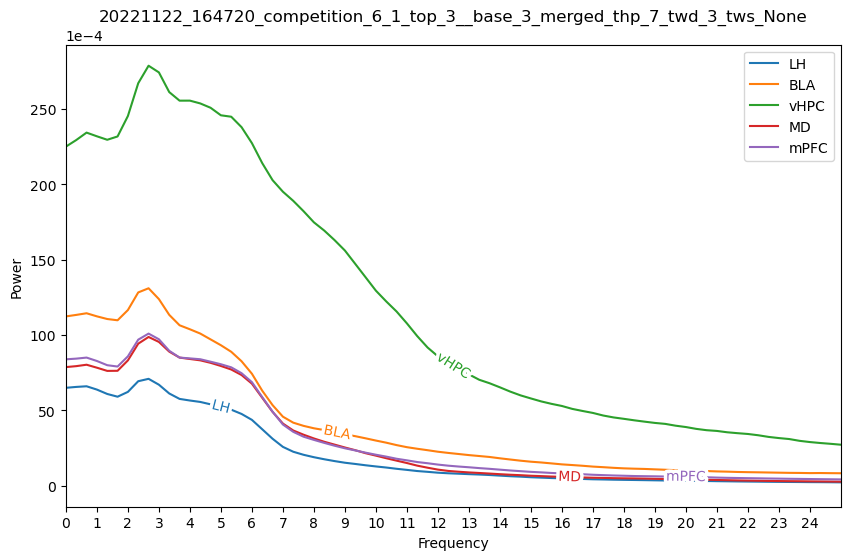

20221122_161341_omission_subject_6_1_top_4_base_2_thp_7_twd_3_tws_None.png


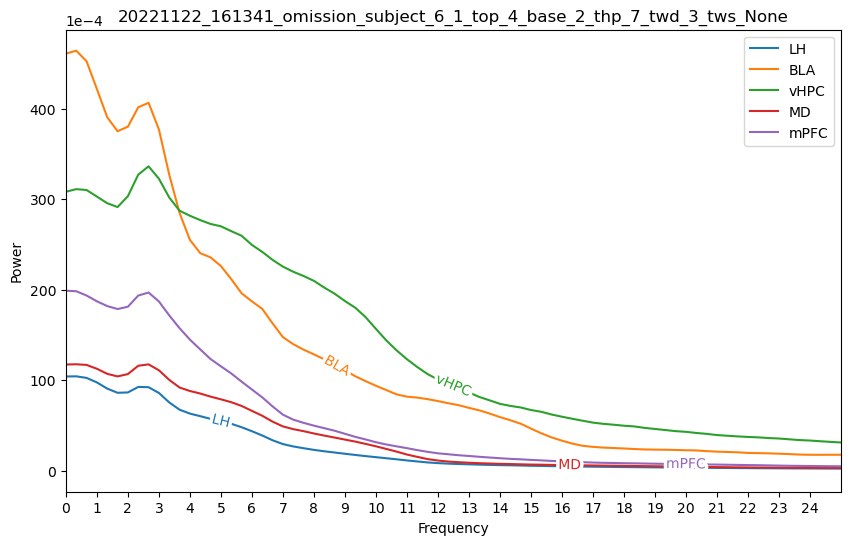

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_7_twd_3_tws_None.png


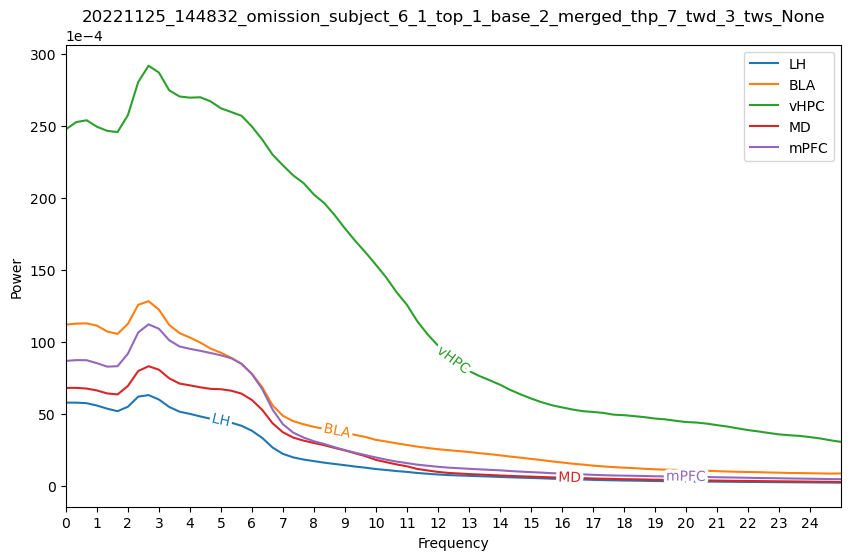

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_3_tws_None.png


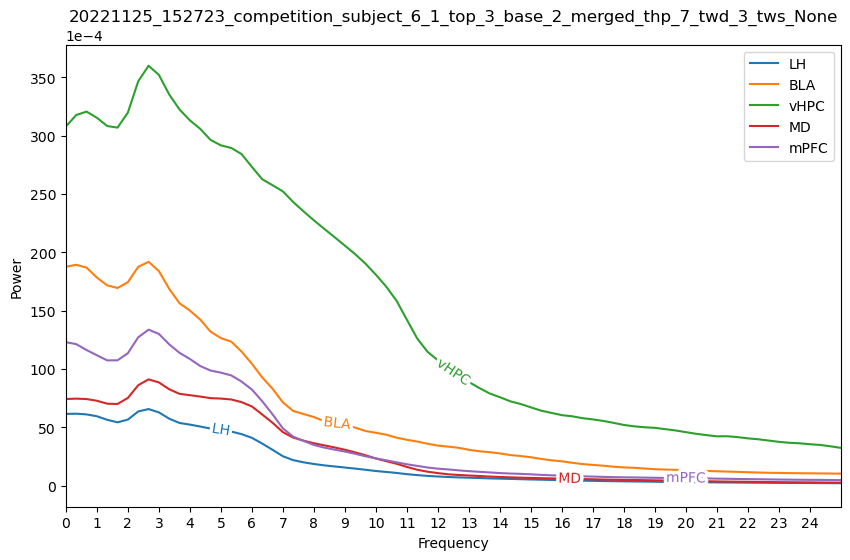

time_halfbandwidth_product: 7, time_window_duration: 3,         tws_ratio: 0.5, time_window_step 1.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_3_tws_1.5_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_3_tws_1.5_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 664,560,128 bytes (allocated so far: 9,956,932,096 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 15
(1599198,)
calculating multitaper
calculating connectivity
O

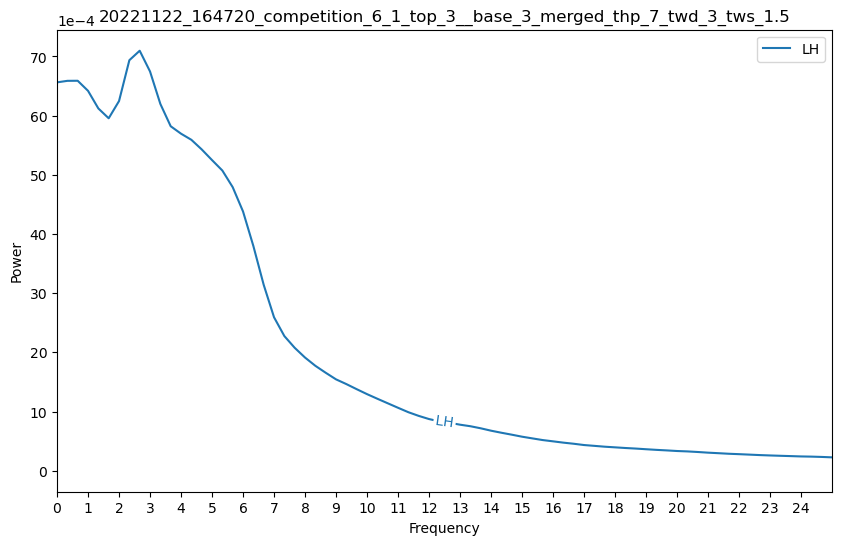

20221122_161341_omission_subject_6_1_top_4_base_2_thp_7_twd_3_tws_1.5.png


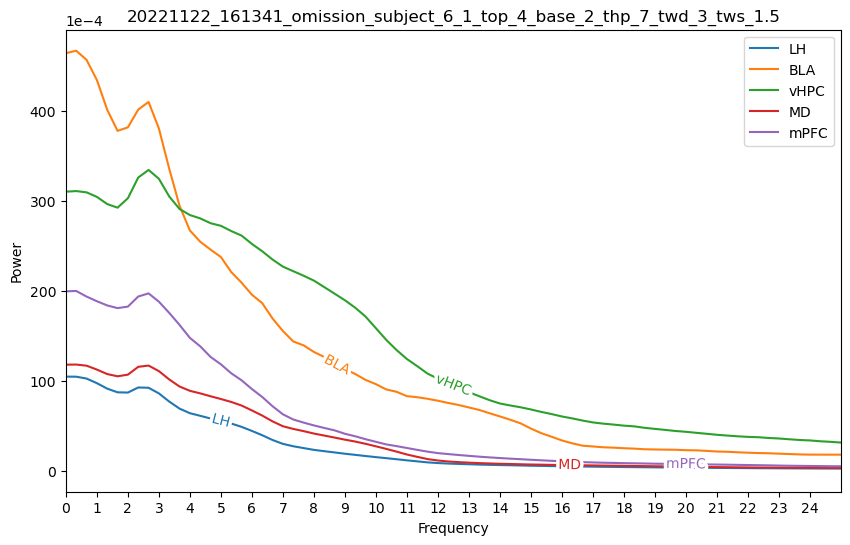

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221122_161341_omission_subject_6_1_top_4_base_2_thp_7_twd_3_tws_1.5.png


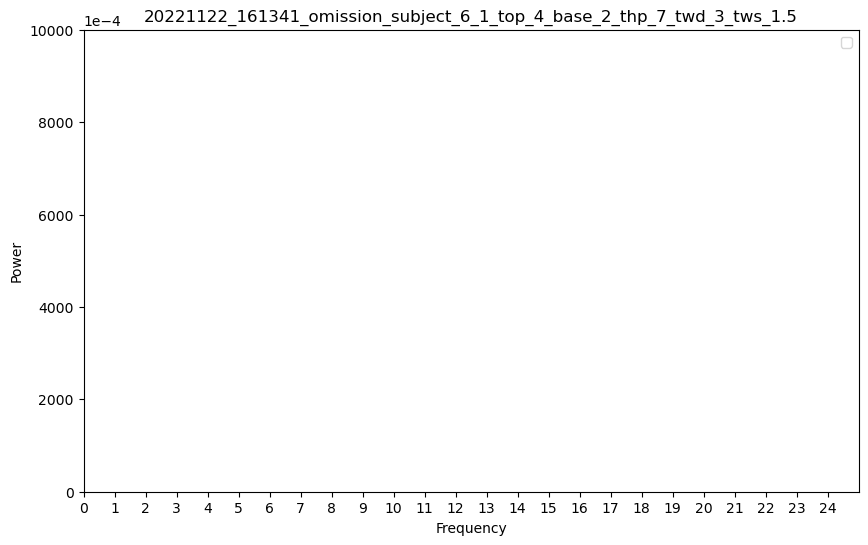

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221122_161341_omission_subject_6_1_top_4_base_2_thp_7_twd_3_tws_1.5.png


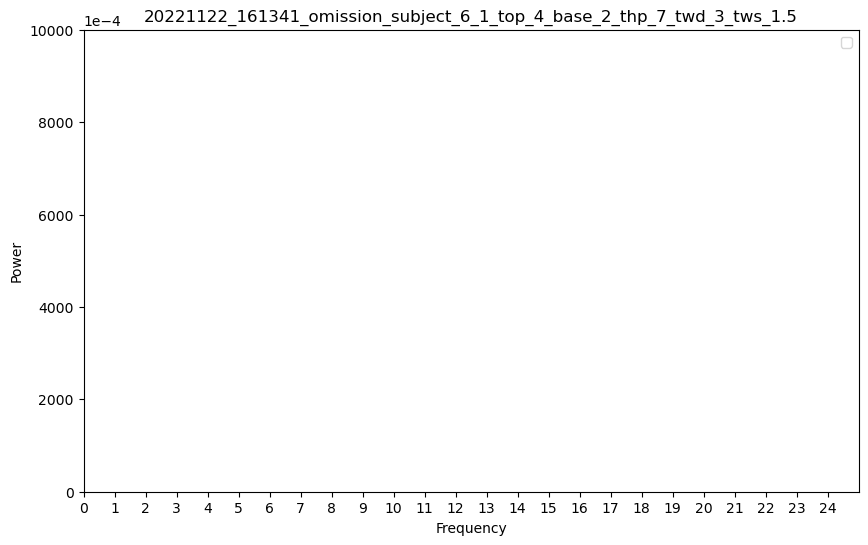

time_halfbandwidth_product: 7, time_window_duration: 3,         tws_ratio: 0.9, time_window_step 2.7
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_3_tws_2.7_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_3_tws_2.7_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_3_tws_2.7_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_3_tws_2.7_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

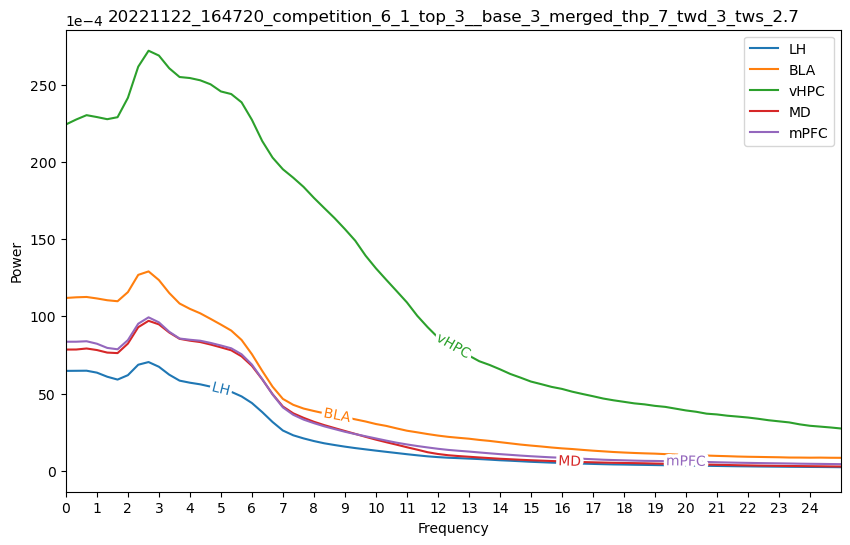

20221122_161341_omission_subject_6_1_top_4_base_2_thp_7_twd_3_tws_2.7.png


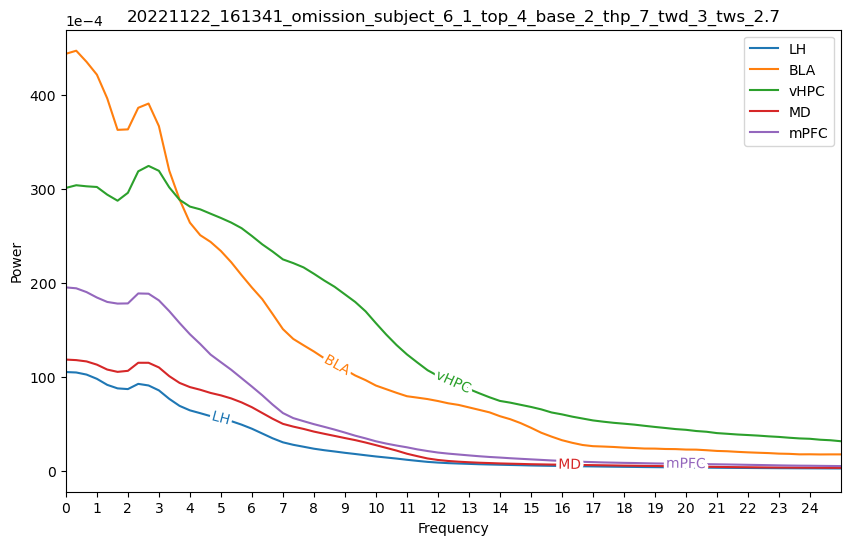

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_7_twd_3_tws_2.7.png


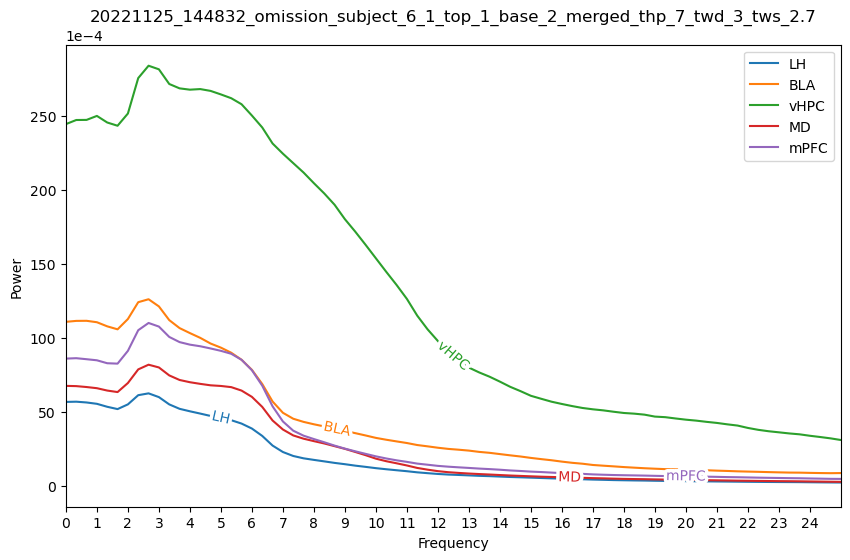

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_3_tws_2.7.png


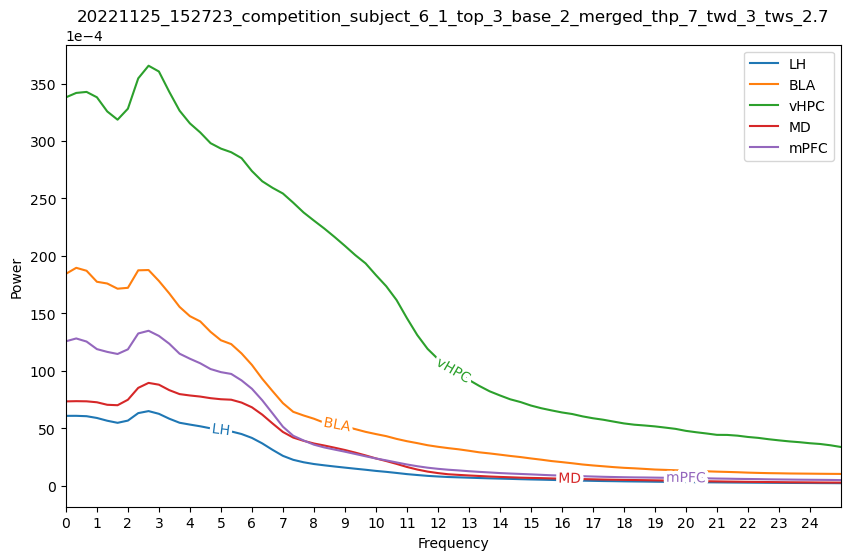

time_halfbandwidth_product: 7, time_window_duration: 5,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_5_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_5_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_5_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_5_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

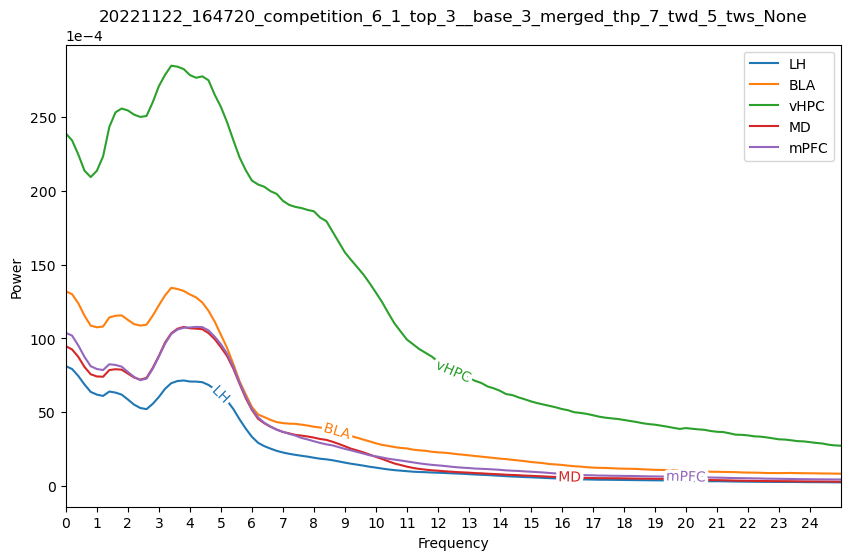

20221122_161341_omission_subject_6_1_top_4_base_2_thp_7_twd_5_tws_None.png


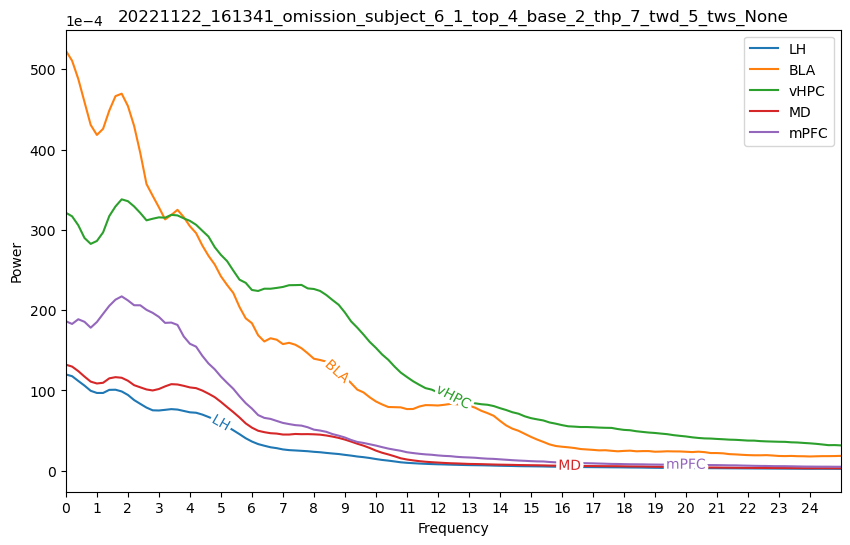

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_7_twd_5_tws_None.png


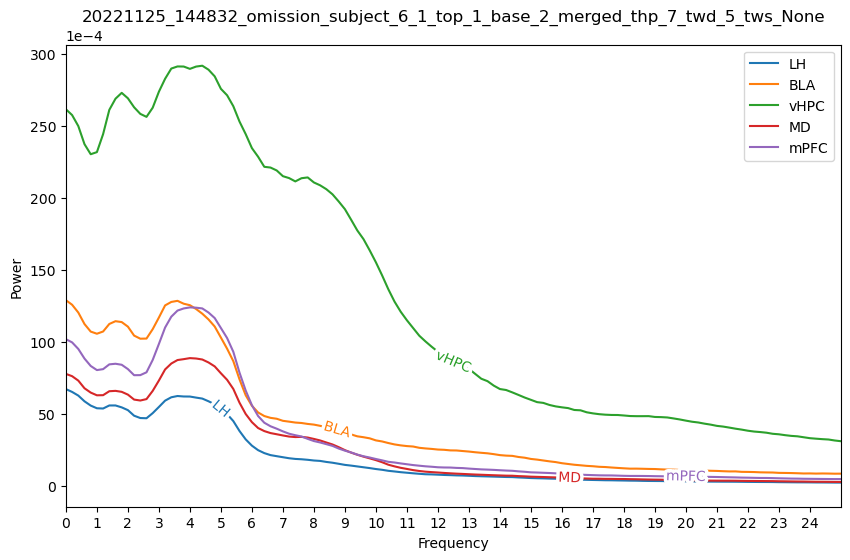

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_5_tws_None.png


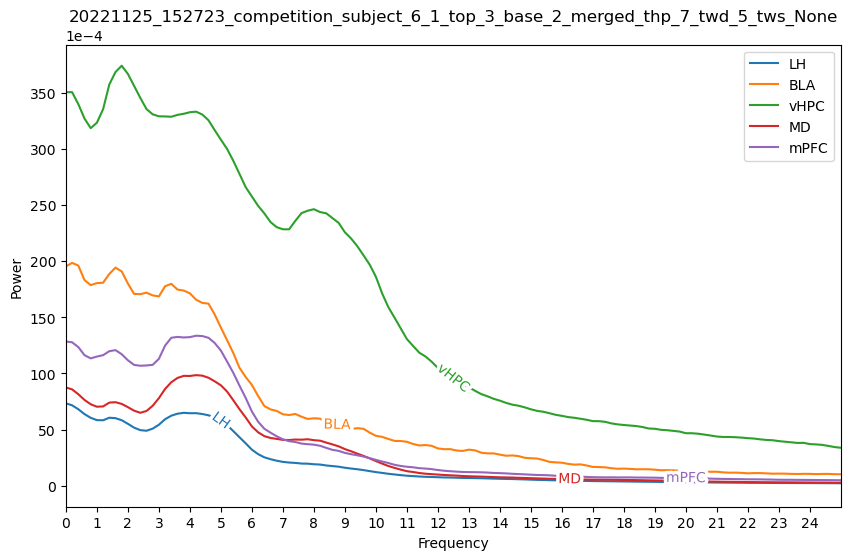

time_halfbandwidth_product: 7, time_window_duration: 5,         tws_ratio: 0.5, time_window_step 2.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 663,520,256 bytes (allocated so far: 9,983,139,328 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 663,520,256 bytes (allocated so far: 9,522,915,328 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 15
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 663,520,256 bytes (allocated so far: 9,522,915,328 bytes).
LFP File Path: ./

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_5_tws_2.5_ch_21.frequencies.npy
20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_5_tws_2.5_ch_21.power.npy
20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_5_tws_None.png


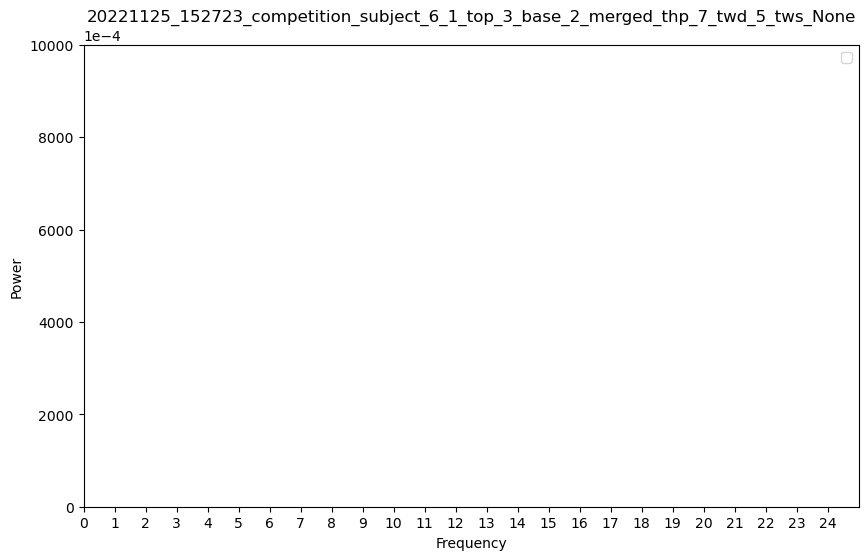

20221122_161341_omission_subject_6_1_top_4_base_2_thp_7_twd_5_tws_2.5.png


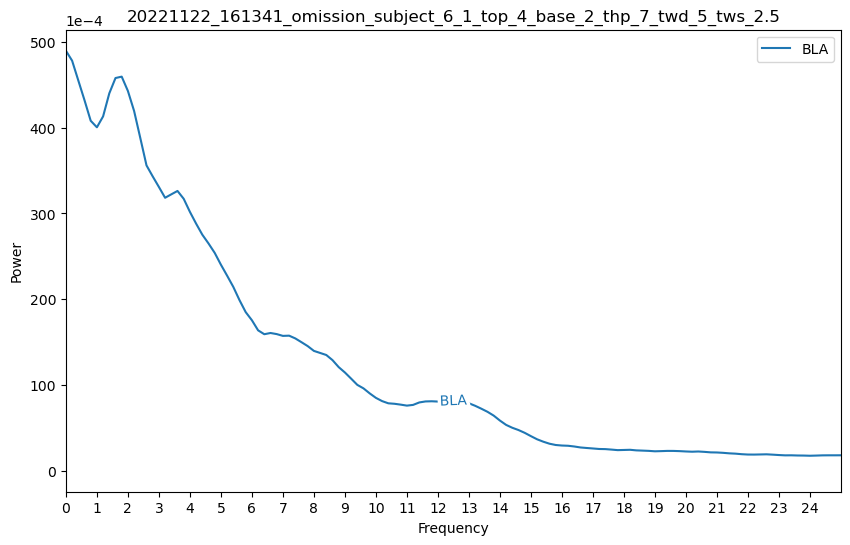

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_7_twd_5_tws_2.5.png


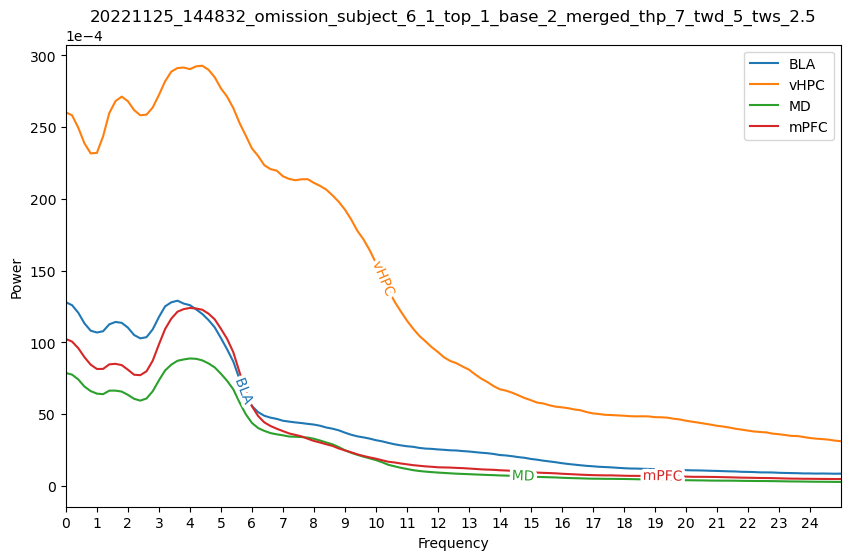

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_5_tws_2.5.png


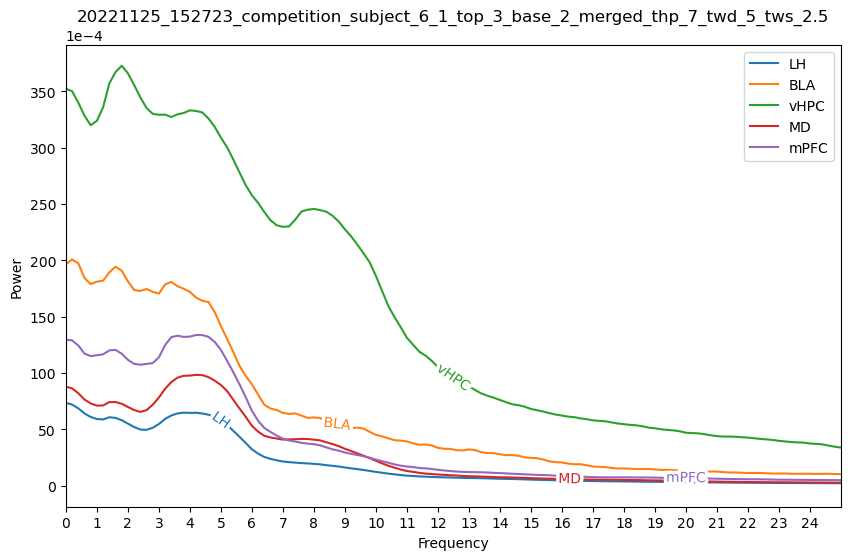

time_halfbandwidth_product: 7, time_window_duration: 5,         tws_ratio: 0.9, time_window_step 4.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_5_tws_4.5_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_5_tws_4.5_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_5_tws_4.5_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_5_tws_4.5_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

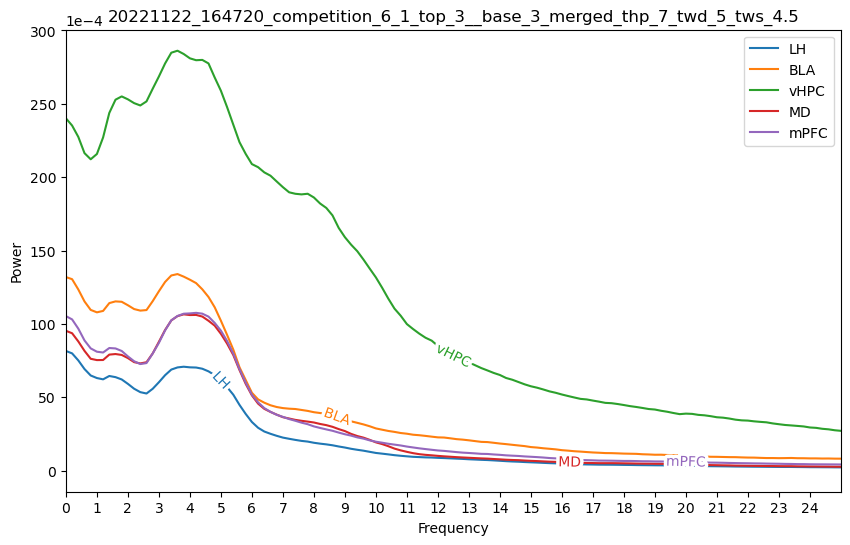

20221122_161341_omission_subject_6_1_top_4_base_2_thp_7_twd_5_tws_4.5.png


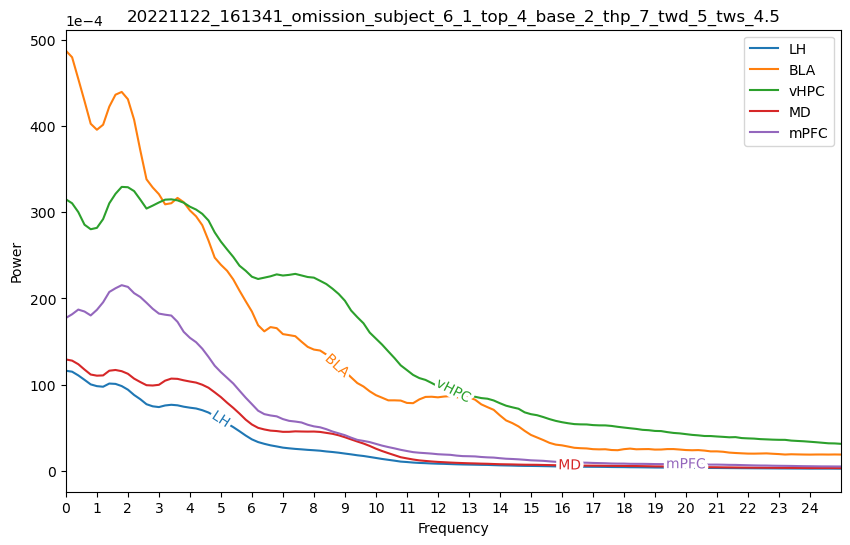

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_7_twd_5_tws_4.5.png


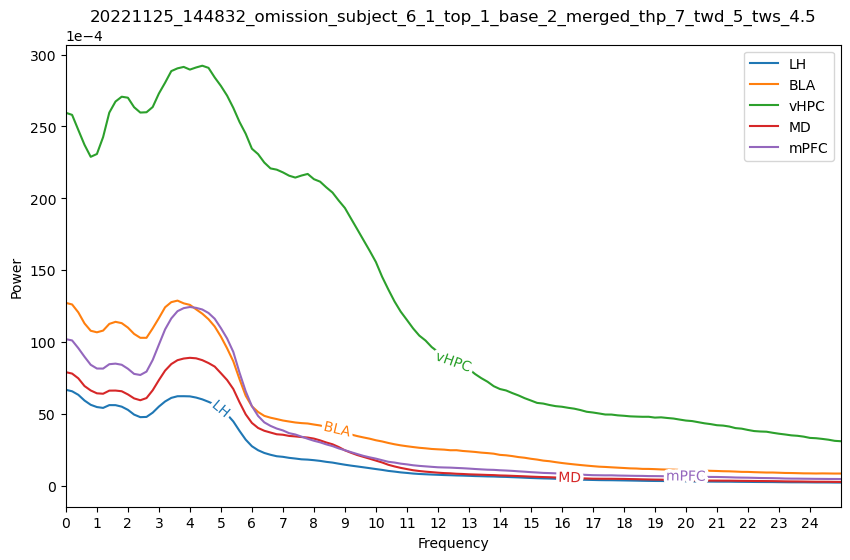

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_5_tws_4.5.png


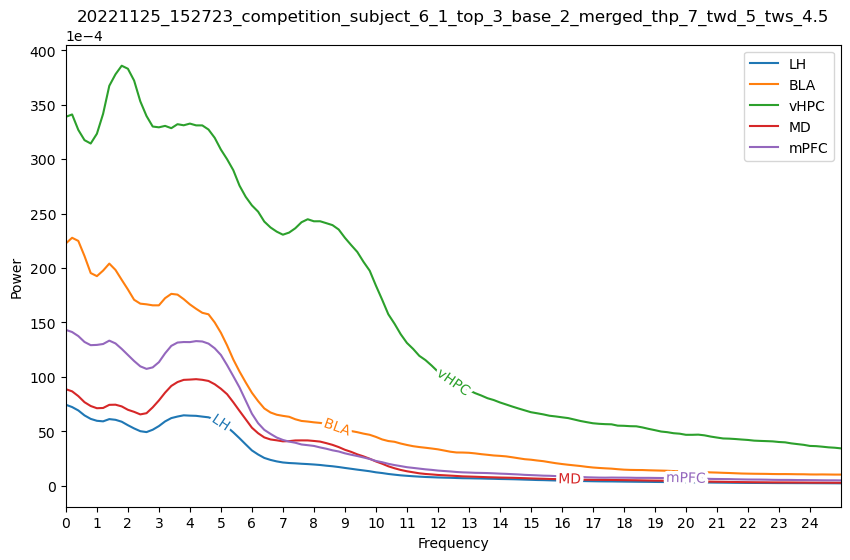

time_halfbandwidth_product: 7, time_window_duration: 7,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_7_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_7_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_7_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_7_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_

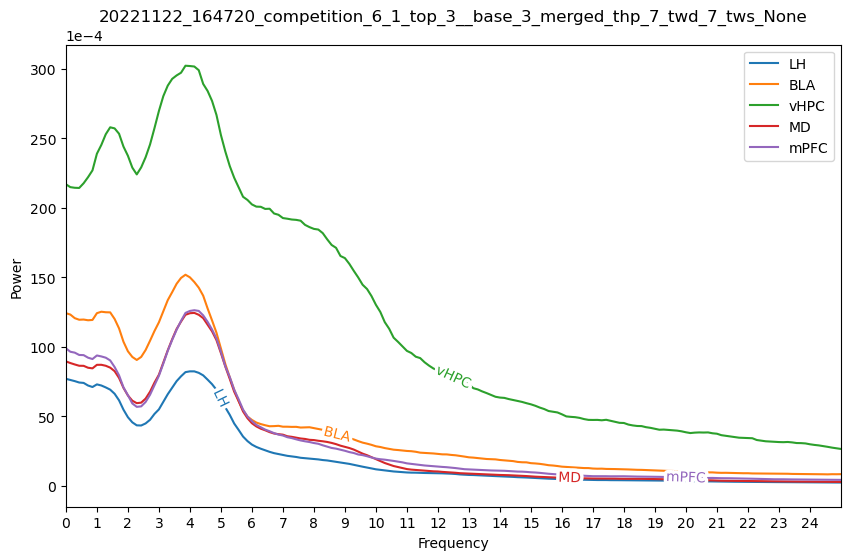

20221122_161341_omission_subject_6_1_top_4_base_2_thp_7_twd_7_tws_None.png


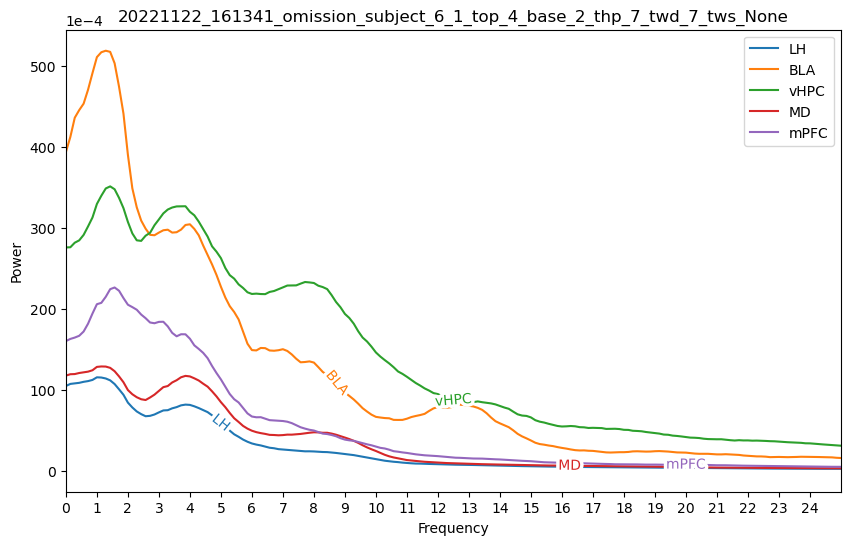

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_7_twd_7_tws_None.png


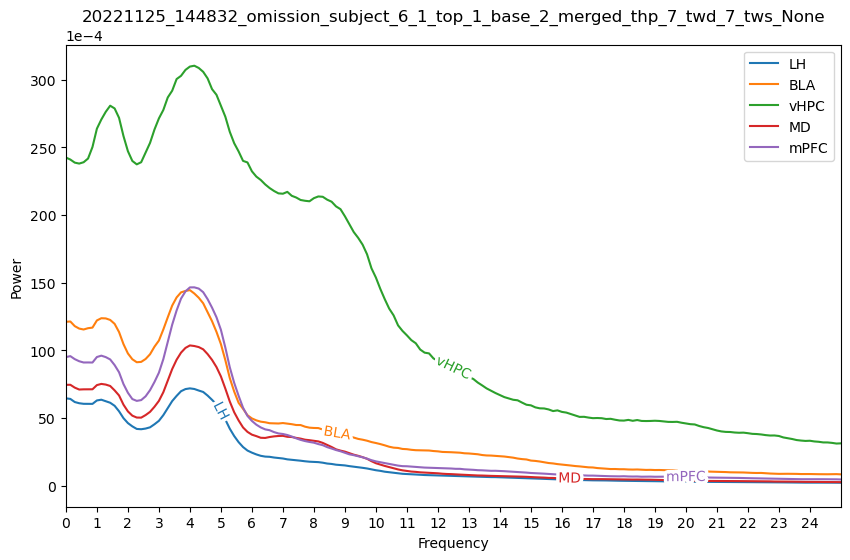

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_7_tws_None.png


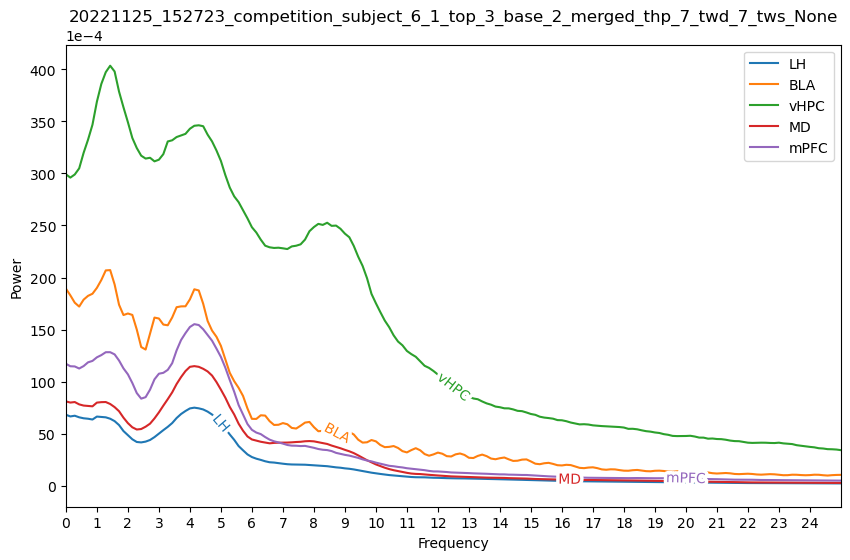

time_halfbandwidth_product: 7, time_window_duration: 7,         tws_ratio: 0.5, time_window_step 3.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 662,480,384 bytes (allocated so far: 9,842,387,456 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 662,480,384 bytes (allocated so far: 9,842,387,456 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 15
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 662,480,384 bytes (allocated so far: 9,842,387,456 bytes).
LFP File Path: ./

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Out of memory allocating 572,208,128 bytes (allocated so far: 10,036,451,840 bytes).
20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_7_tws_None.png


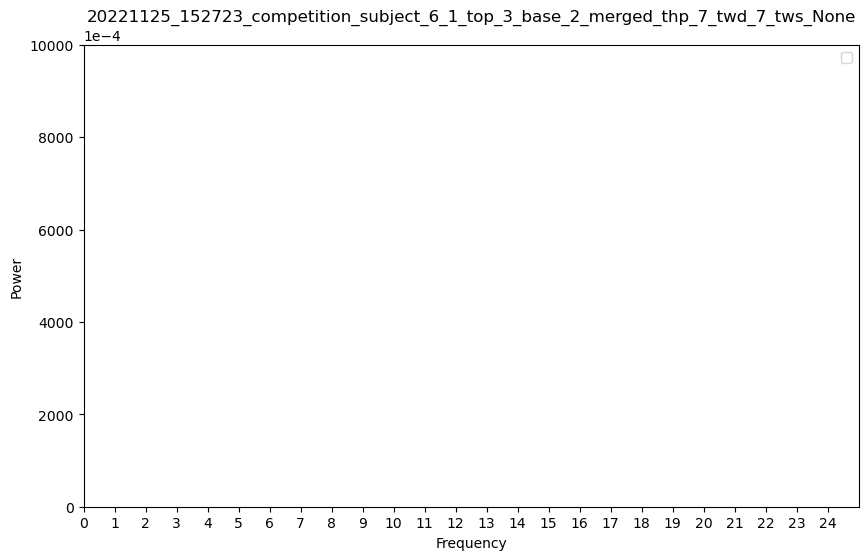

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_7_tws_None.png


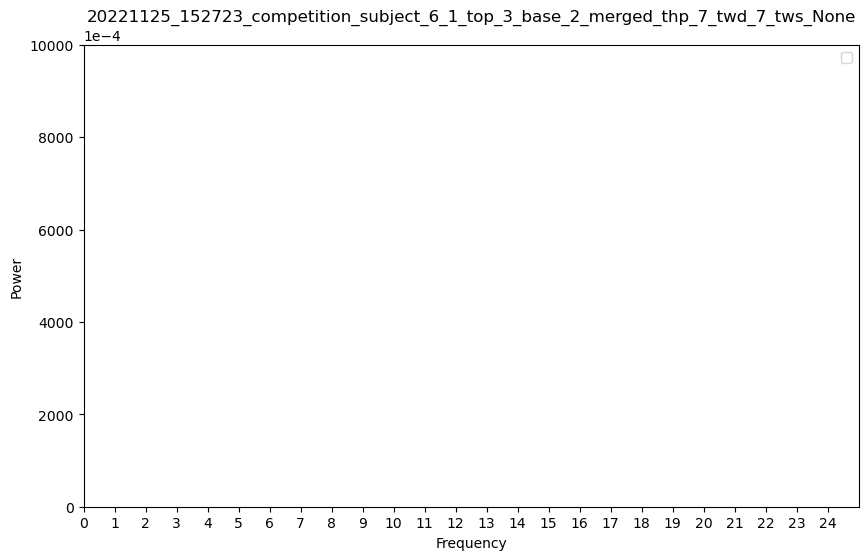

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_7_tws_None.png


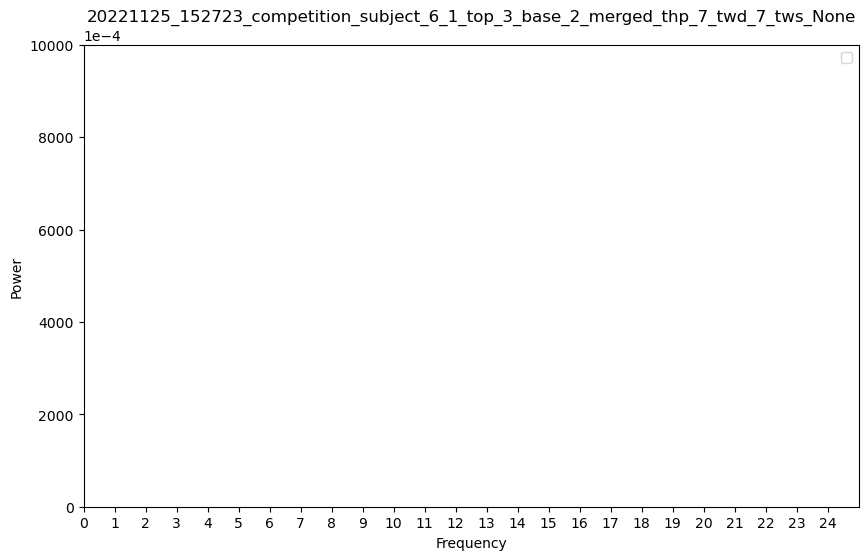

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_7_tws_None.png


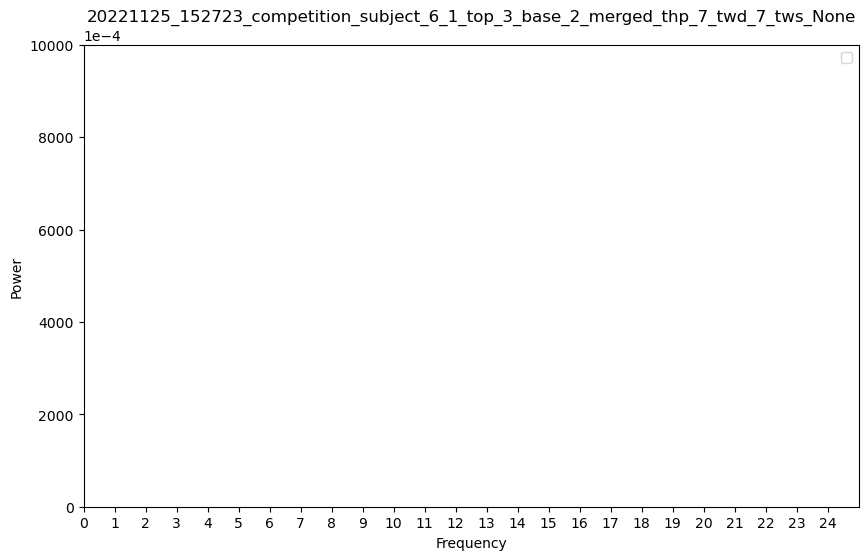

time_halfbandwidth_product: 7, time_window_duration: 7,         tws_ratio: 0.9, time_window_step 6.3
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_7_tws_6.3_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_7_tws_6.3_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_7_tws_6.3_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_7_tws_6.3_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_

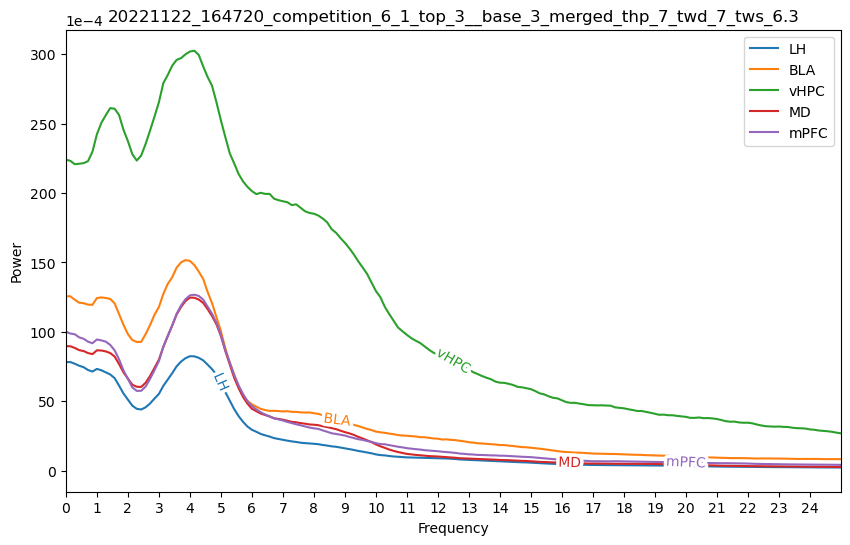

20221122_161341_omission_subject_6_1_top_4_base_2_thp_7_twd_7_tws_6.3.png


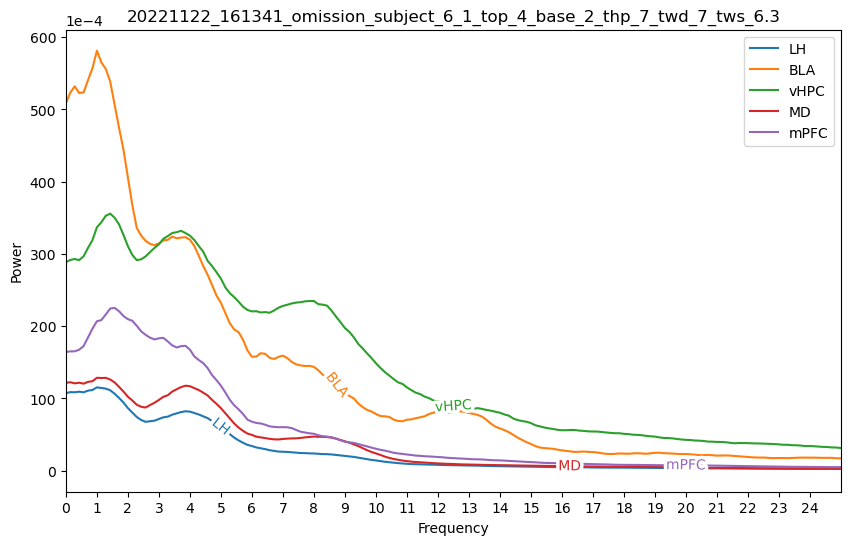

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_7_twd_7_tws_6.3.png


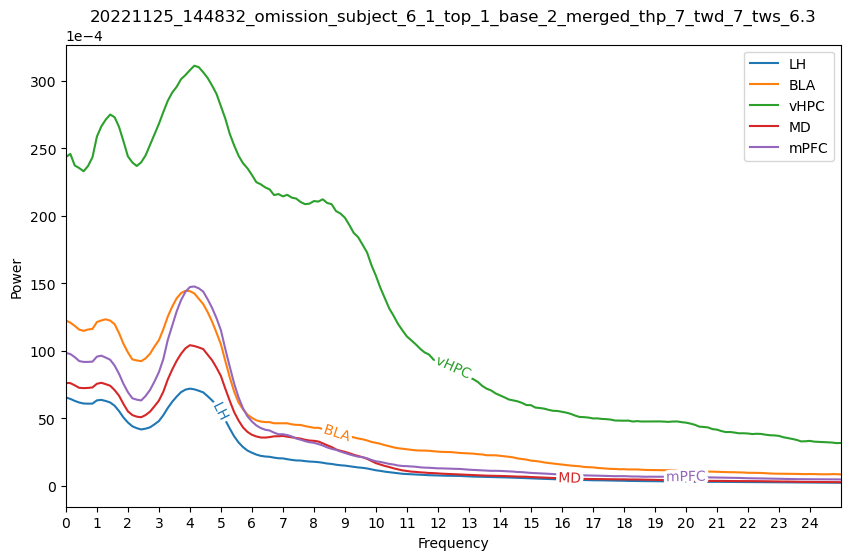

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_7_tws_6.3.png


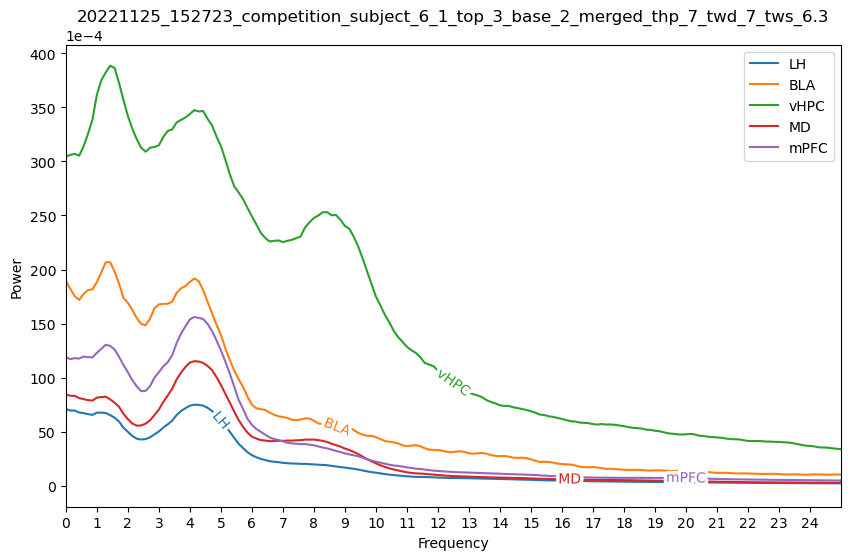

time_halfbandwidth_product: 7, time_window_duration: 10,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_10_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_10_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_10_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_10_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competiti

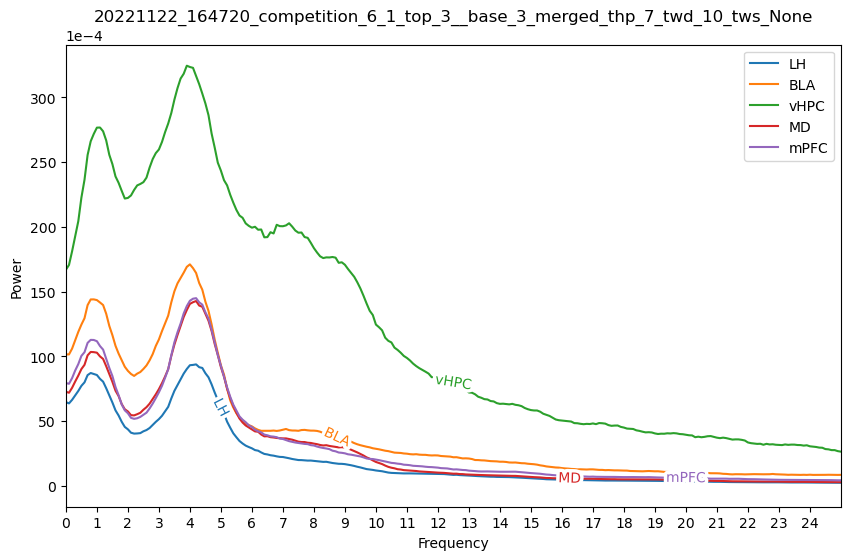

20221122_161341_omission_subject_6_1_top_4_base_2_thp_7_twd_10_tws_None.png


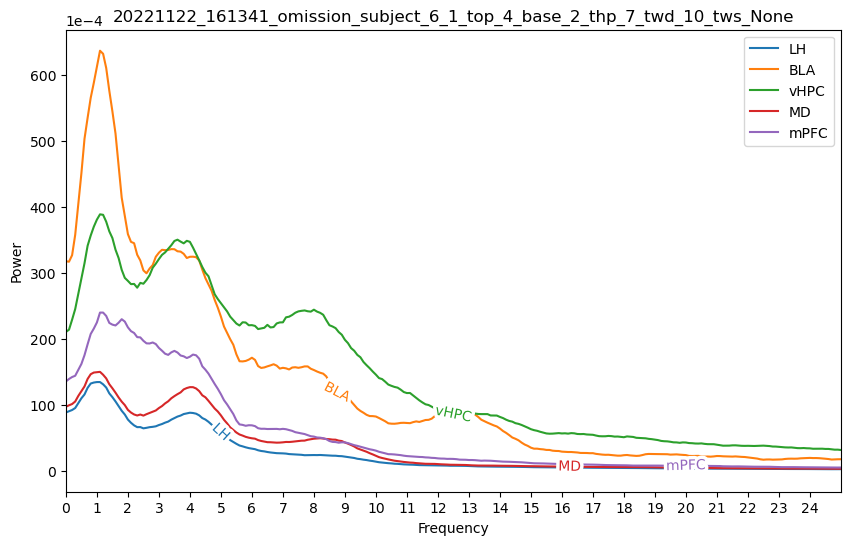

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_7_twd_10_tws_None.png


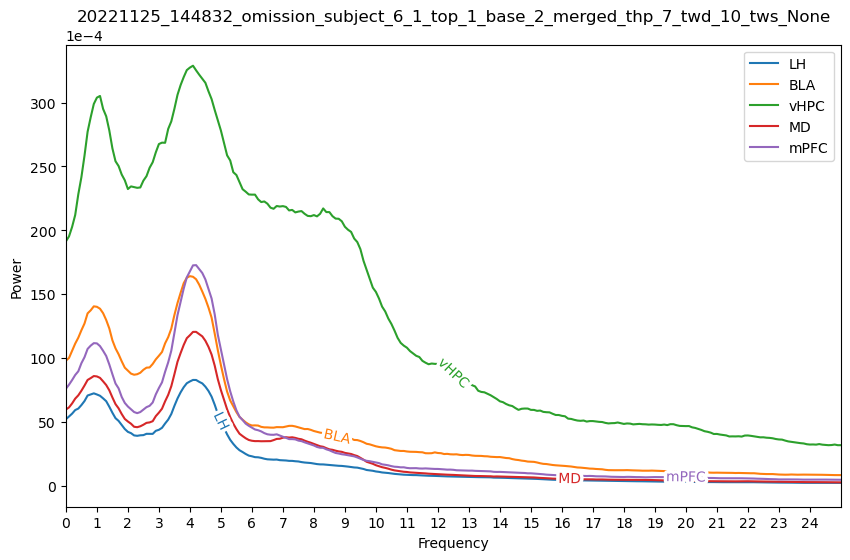

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_None.png


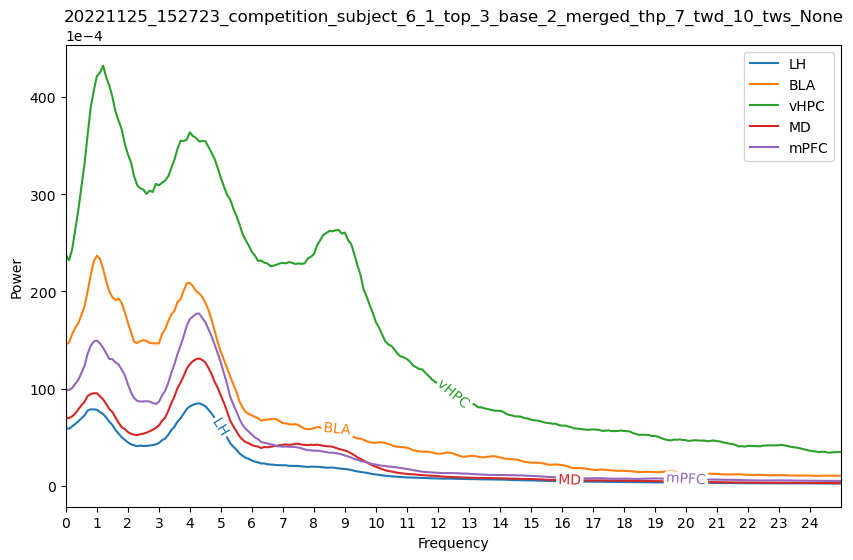

time_halfbandwidth_product: 7, time_window_duration: 10,         tws_ratio: 0.5, time_window_step 5.0
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_10_tws_5.0_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_10_tws_5.0_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_10_tws_5.0_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_10_tws_5.0_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1

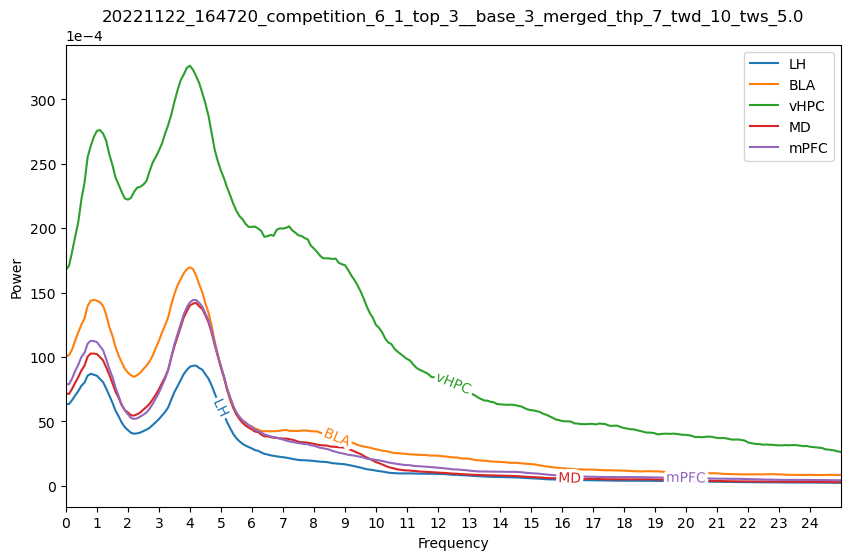

20221122_161341_omission_subject_6_1_top_4_base_2_thp_7_twd_10_tws_5.0.png


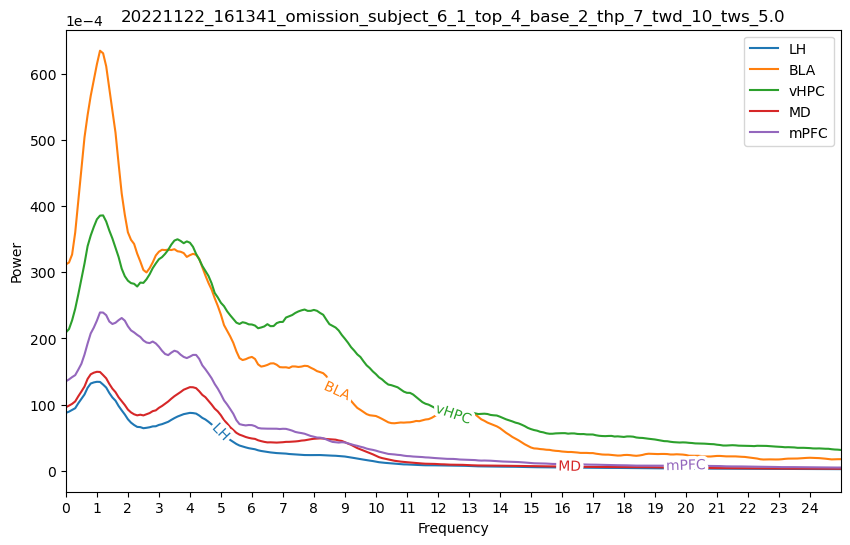

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_7_twd_10_tws_5.0.png


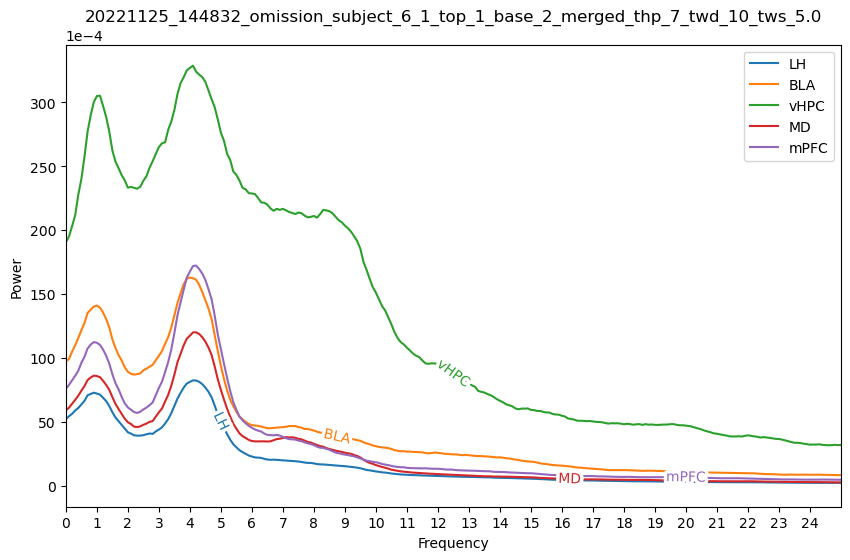

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_7_twd_10_tws_5.0.png


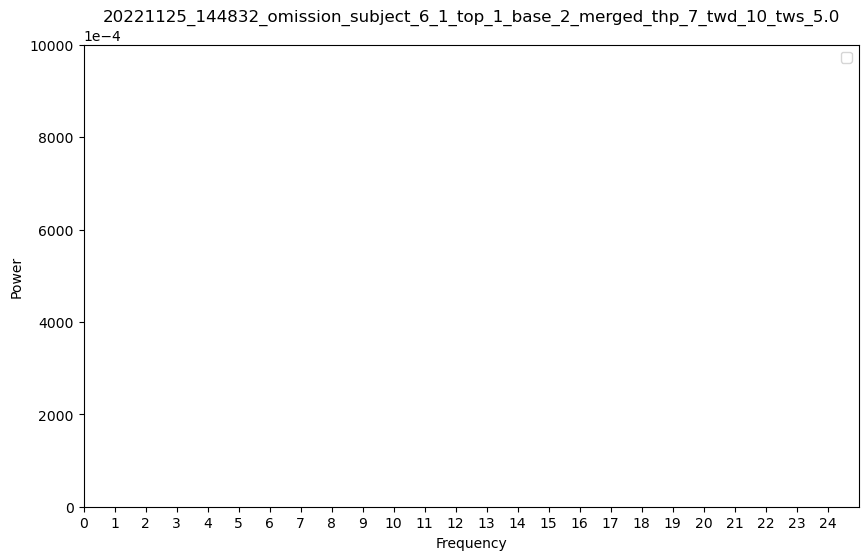

time_halfbandwidth_product: 7, time_window_duration: 10,         tws_ratio: 0.9, time_window_step 9.0
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_10_tws_9.0_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_10_tws_9.0_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_10_tws_9.0_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_7_twd_10_tws_9.0_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1

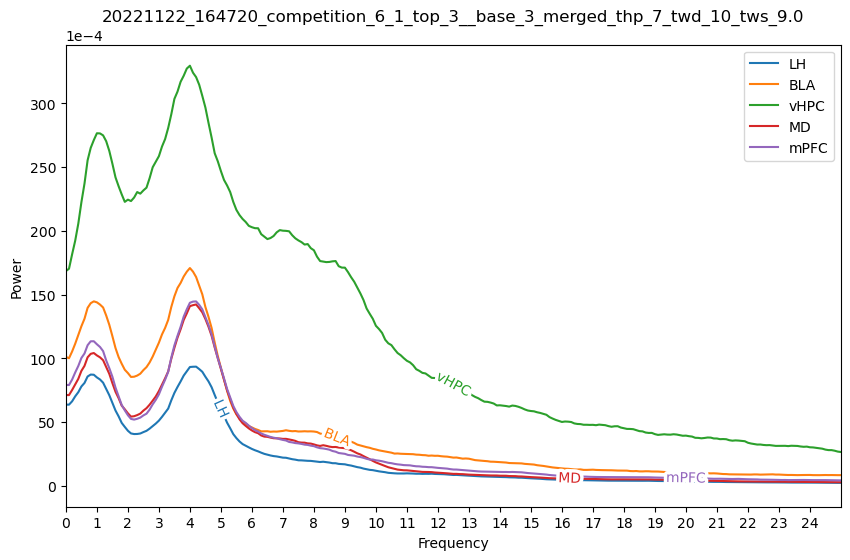

20221122_161341_omission_subject_6_1_top_4_base_2_thp_7_twd_10_tws_9.0.png


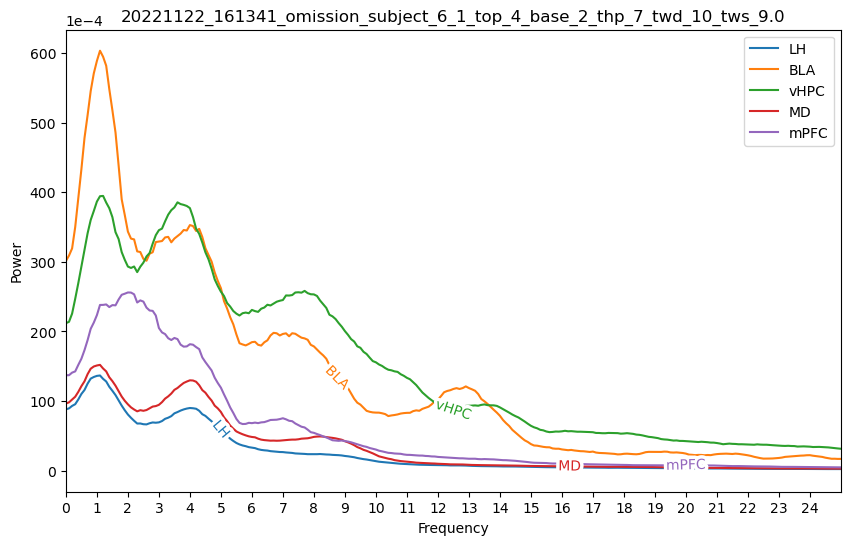

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_7_twd_10_tws_9.0.png


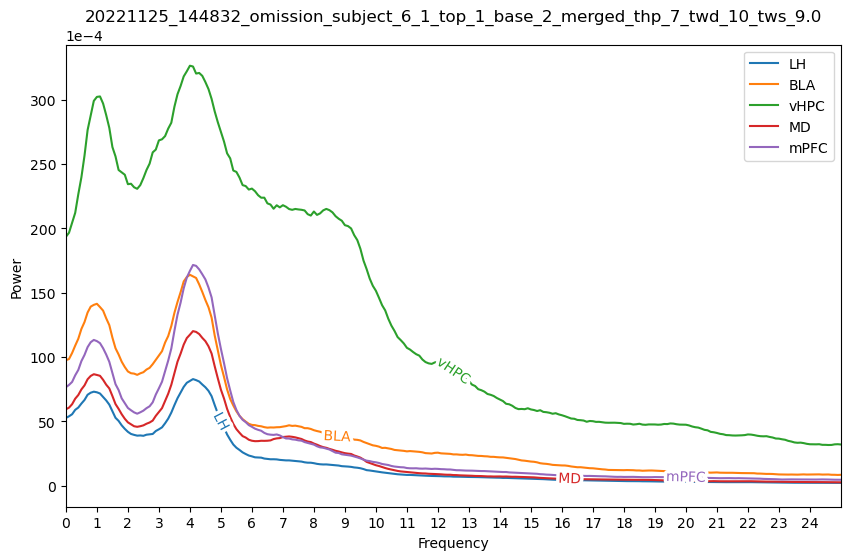

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


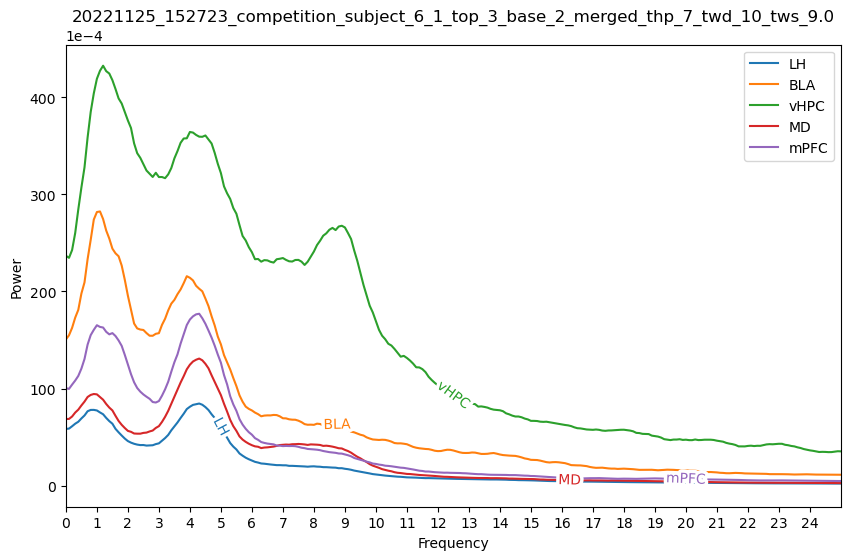

time_halfbandwidth_product: 10, time_window_duration: 1,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 486,096,384 bytes (allocated so far: 9,946,979,840 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 486,096,384 bytes (allocated so far: 9,946,979,840 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 15
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 486,096,384 bytes (allocated so far: 9,946,979,840 bytes).
LFP File Path:

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Out of memory allocating 419,520,000 bytes (allocated so far: 9,946,979,840 bytes).
20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


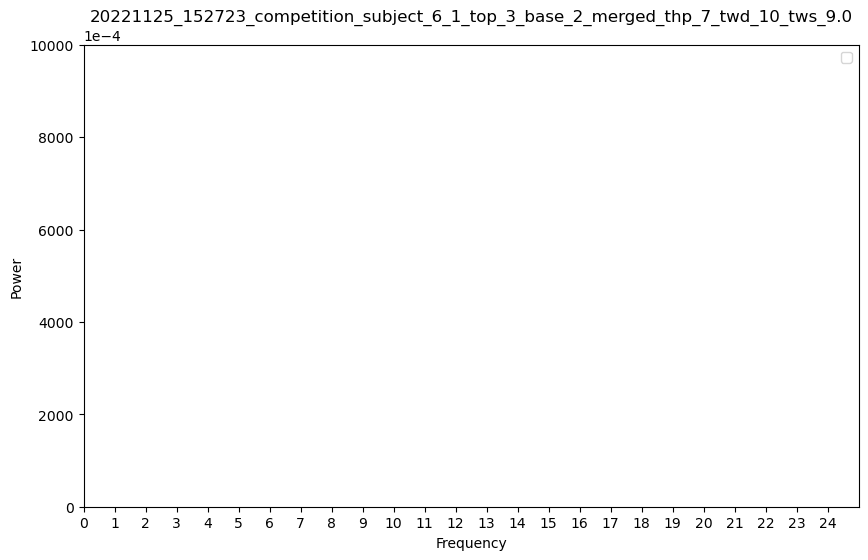

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


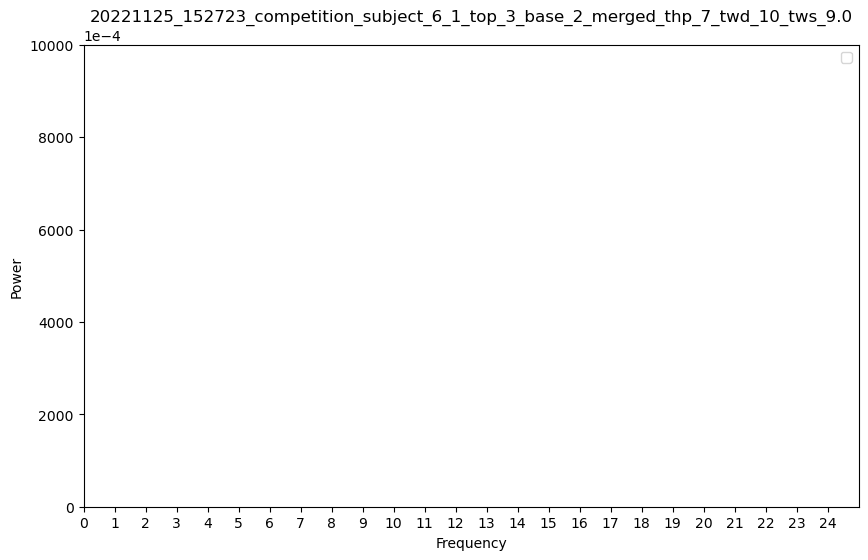

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


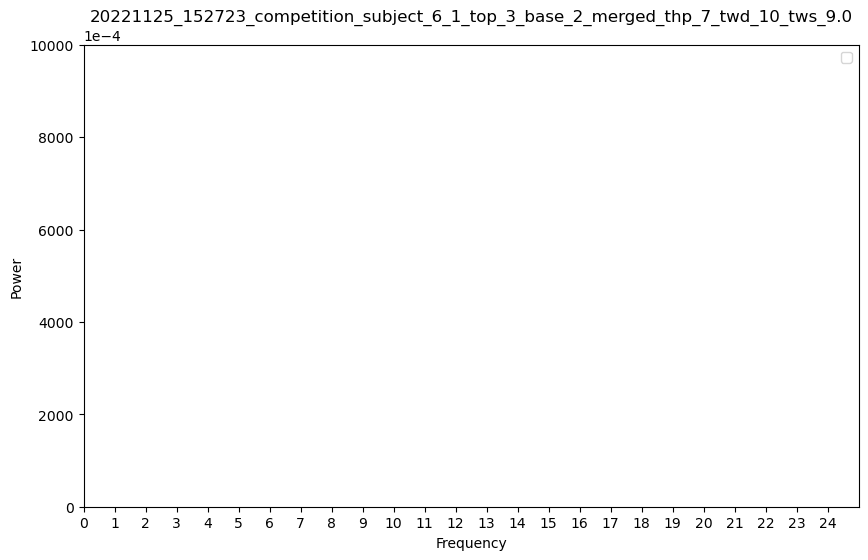

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


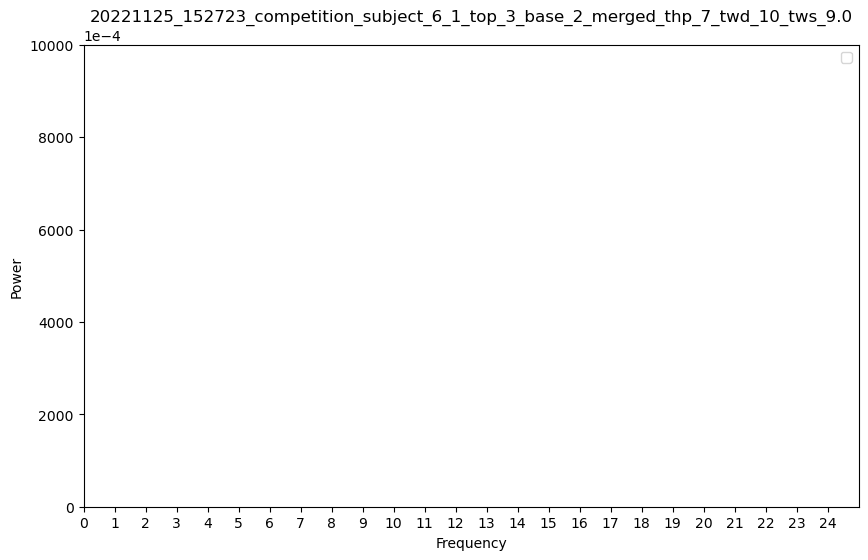

time_halfbandwidth_product: 10, time_window_duration: 1,         tws_ratio: 0.5, time_window_step 0.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 971,888,128 bytes (allocated so far: 9,946,979,840 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 971,888,128 bytes (allocated so far: 9,284,499,456 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 15
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 971,888,128 bytes (allocated so far: 9,284,499,456 bytes).
LFP File Path: .

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Out of memory allocating 838,736,384 bytes (allocated so far: 9,284,499,456 bytes).
20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


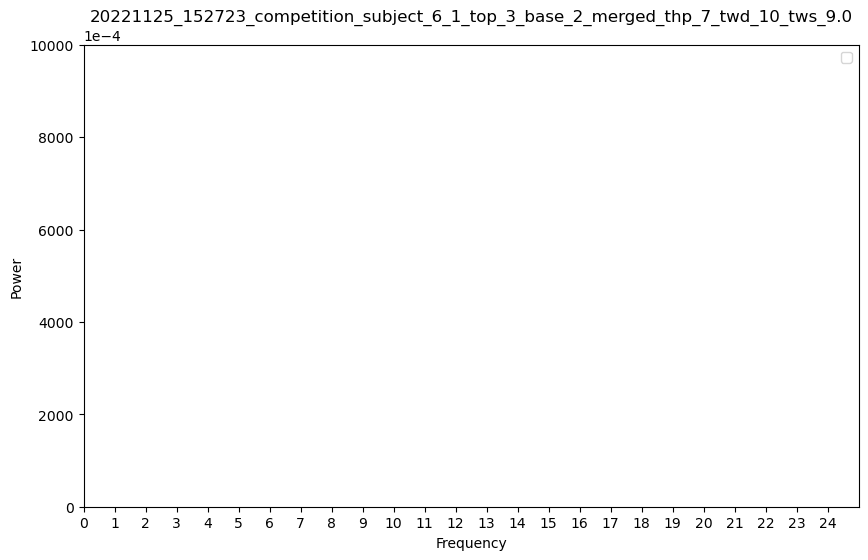

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


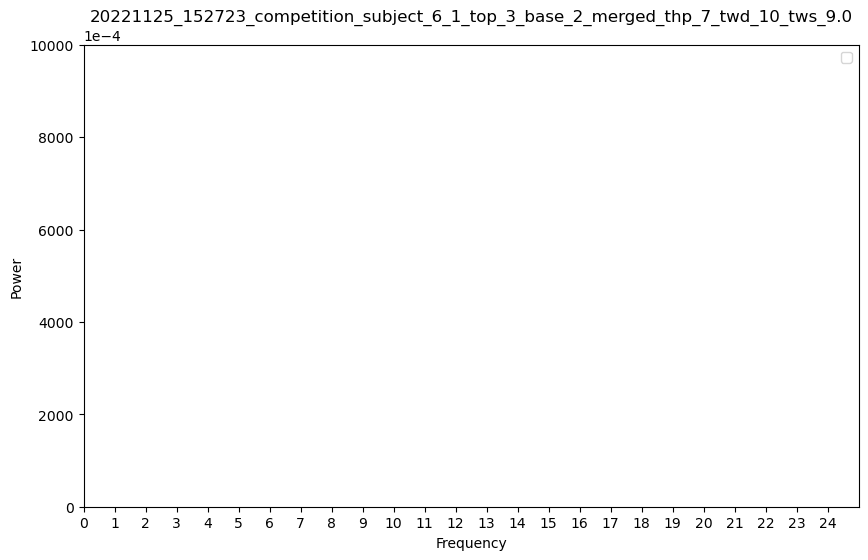

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


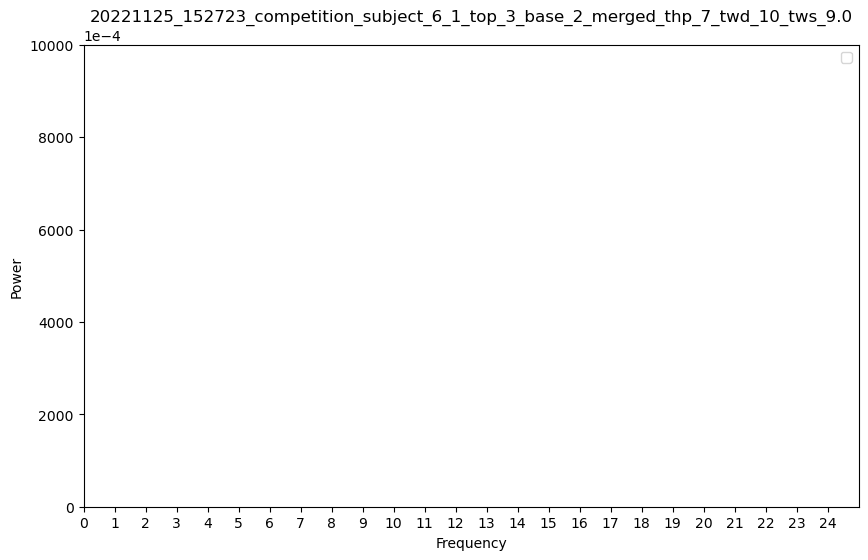

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


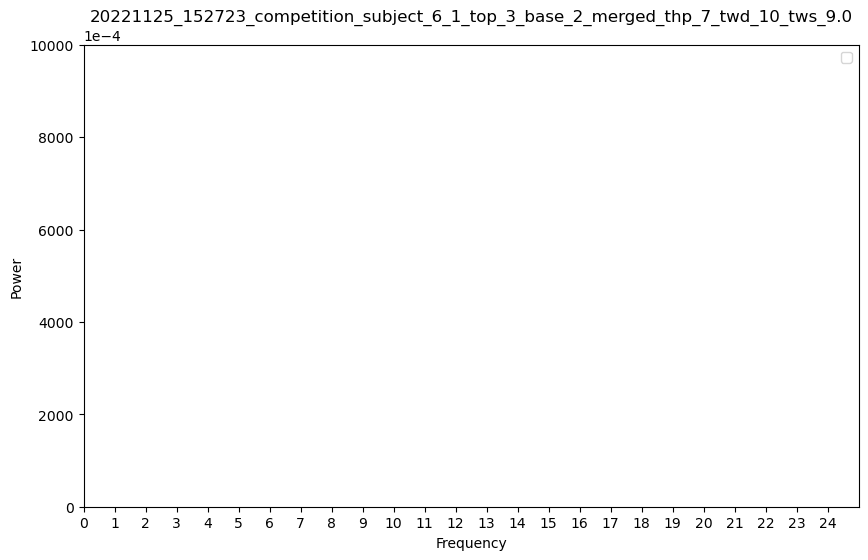

time_halfbandwidth_product: 10, time_window_duration: 1,         tws_ratio: 0.9, time_window_step 0.9
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 539,904,000 bytes (allocated so far: 9,824,403,456 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 539,904,000 bytes (allocated so far: 9,824,403,456 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 15
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 539,904,000 bytes (allocated so far: 9,824,403,456 bytes).
LFP File Path: .

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Out of memory allocating 466,032,128 bytes (allocated so far: 9,824,403,456 bytes).
20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


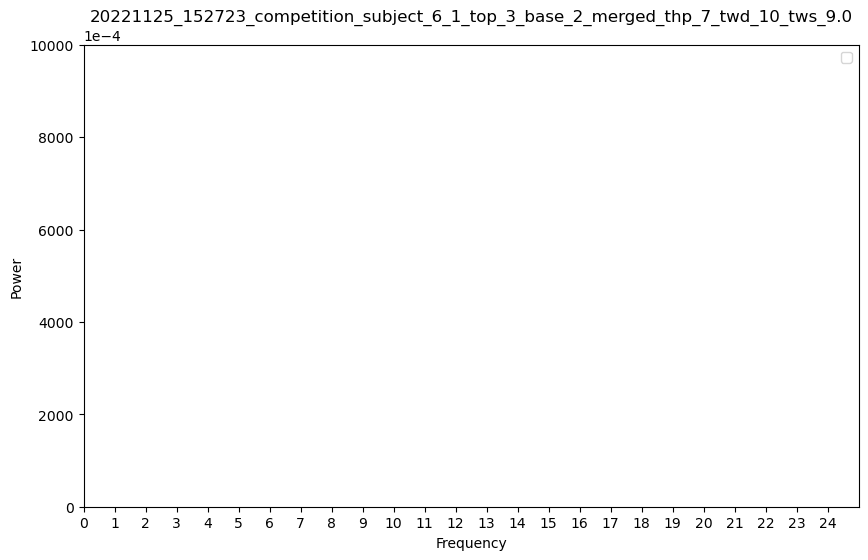

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


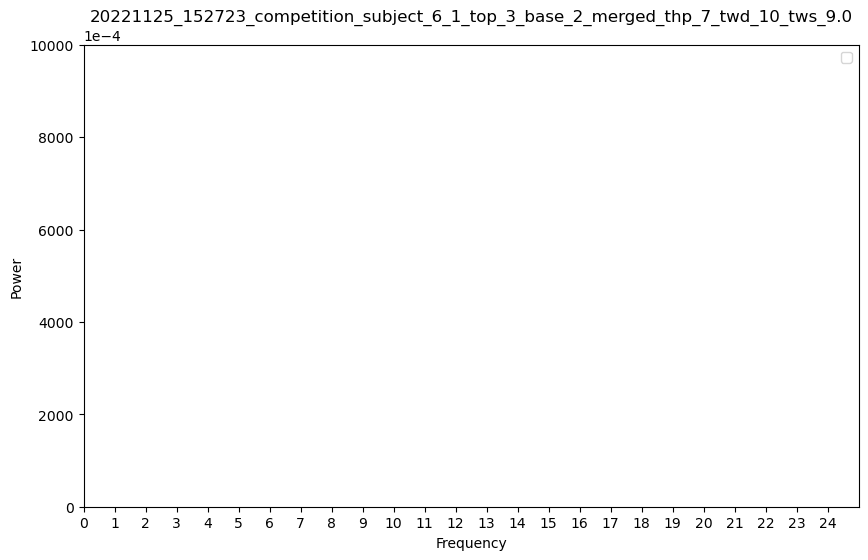

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


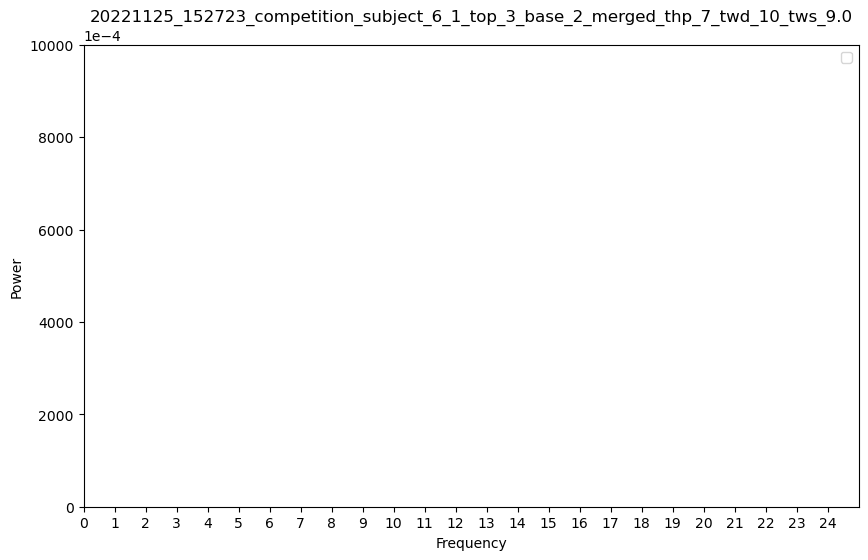

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


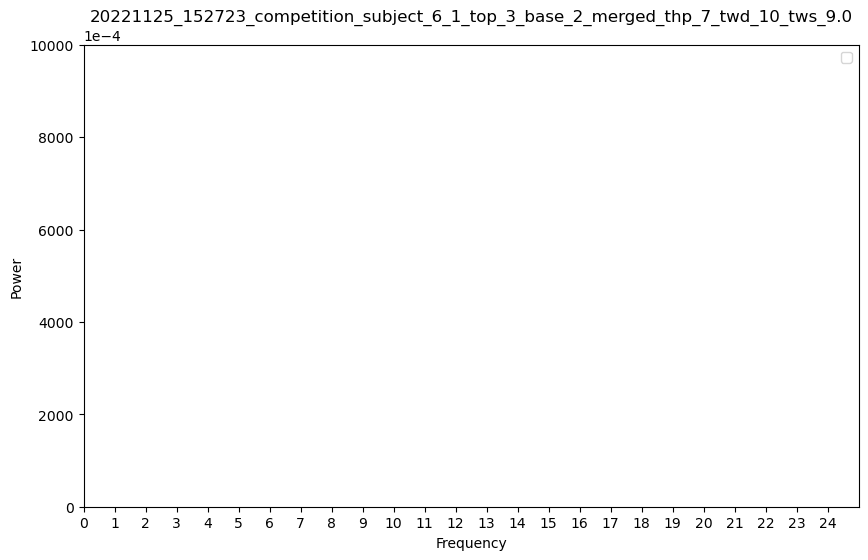

time_halfbandwidth_product: 10, time_window_duration: 2,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 485,792,256 bytes (allocated so far: 9,824,403,456 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 485,792,256 bytes (allocated so far: 9,824,403,456 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 15
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 485,792,256 bytes (allocated so far: 9,824,403,456 bytes).
LFP File Path:

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Out of memory allocating 419,520,000 bytes (allocated so far: 9,824,403,456 bytes).
20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


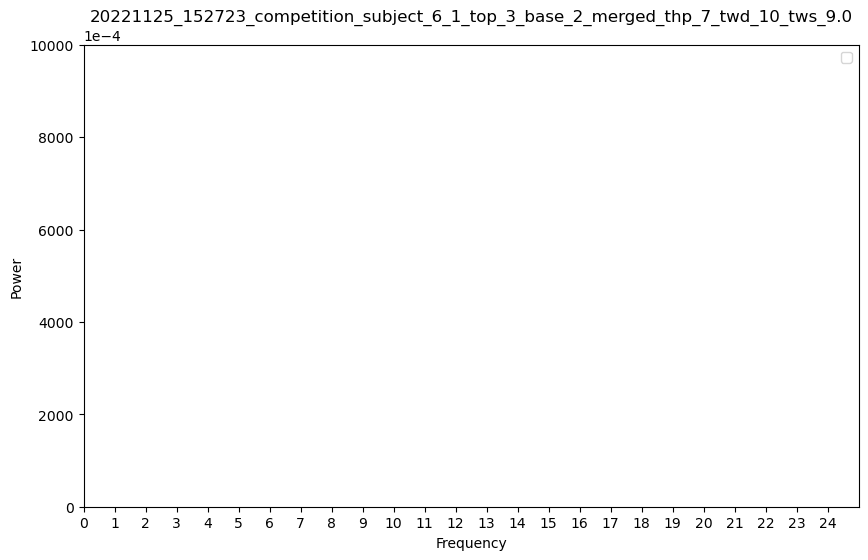

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


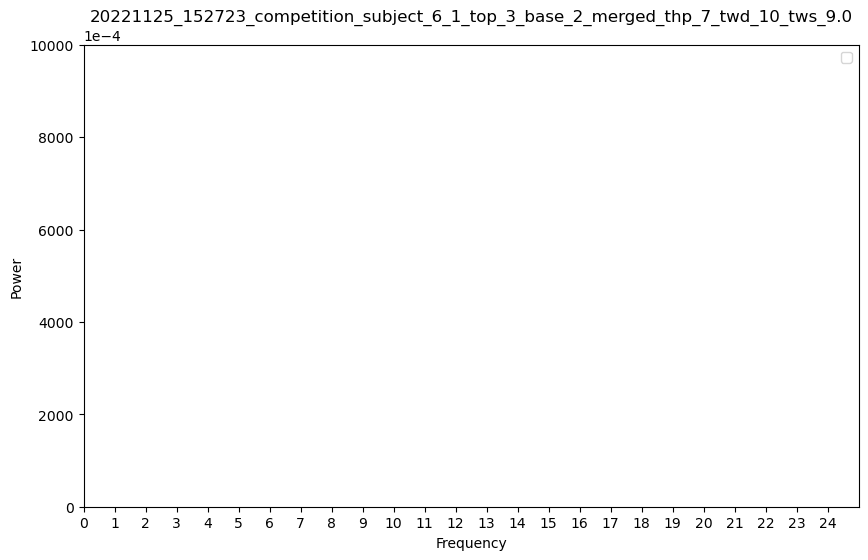

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


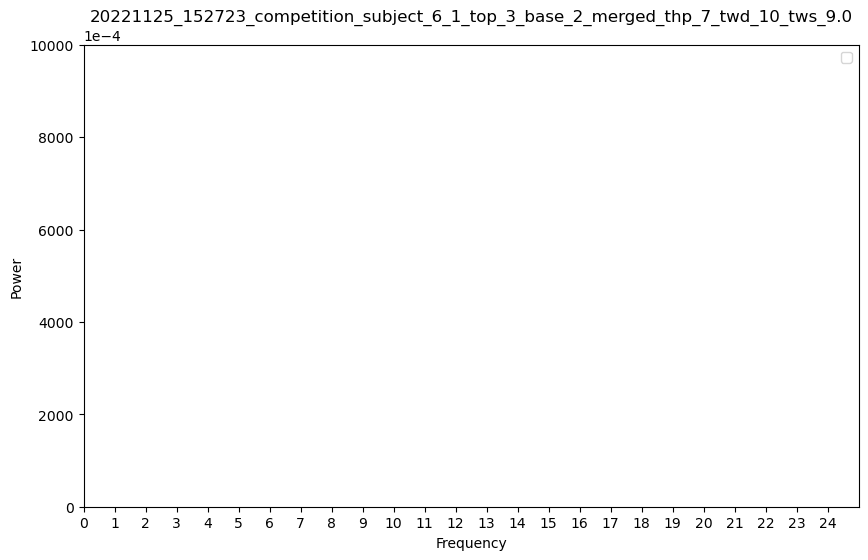

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


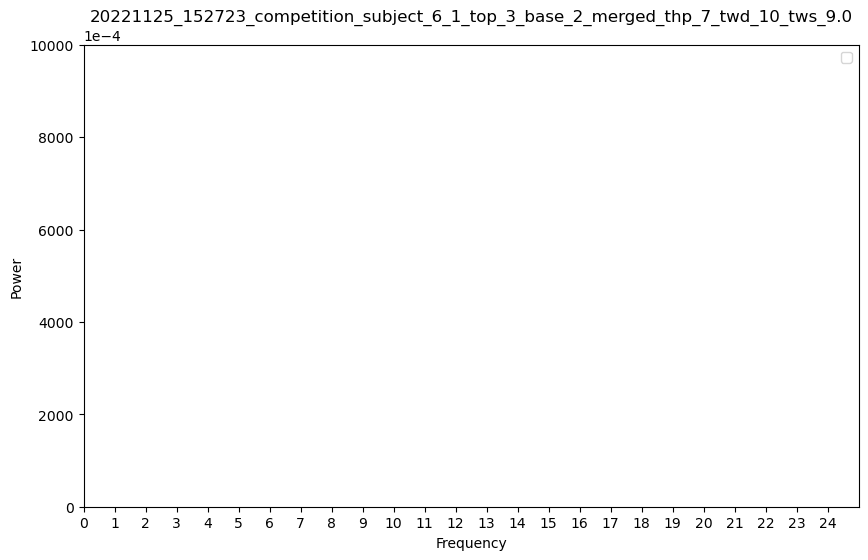

time_halfbandwidth_product: 10, time_window_duration: 2,         tws_ratio: 0.5, time_window_step 1.0
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 971,584,000 bytes (allocated so far: 9,824,403,456 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 971,584,000 bytes (allocated so far: 9,260,723,200 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 15
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 971,584,000 bytes (allocated so far: 9,260,723,200 bytes).
LFP File Path: .

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Out of memory allocating 838,432,256 bytes (allocated so far: 9,260,723,200 bytes).
20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


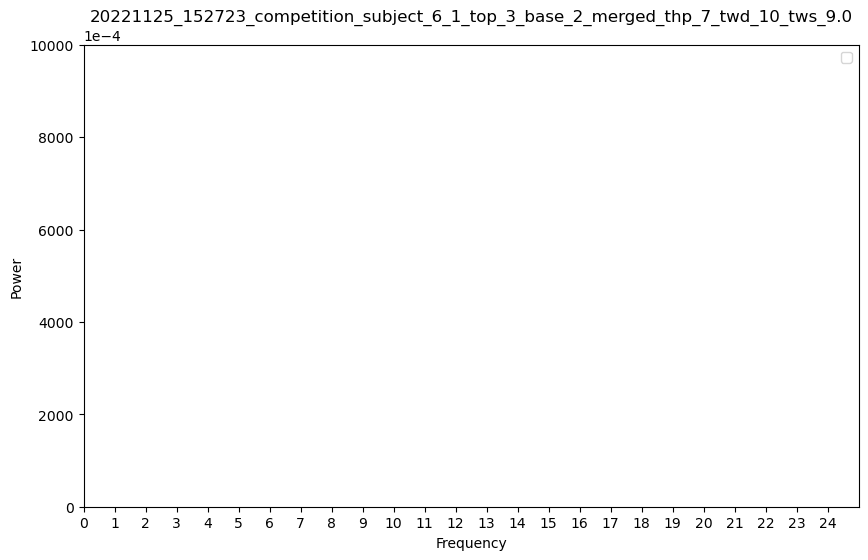

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


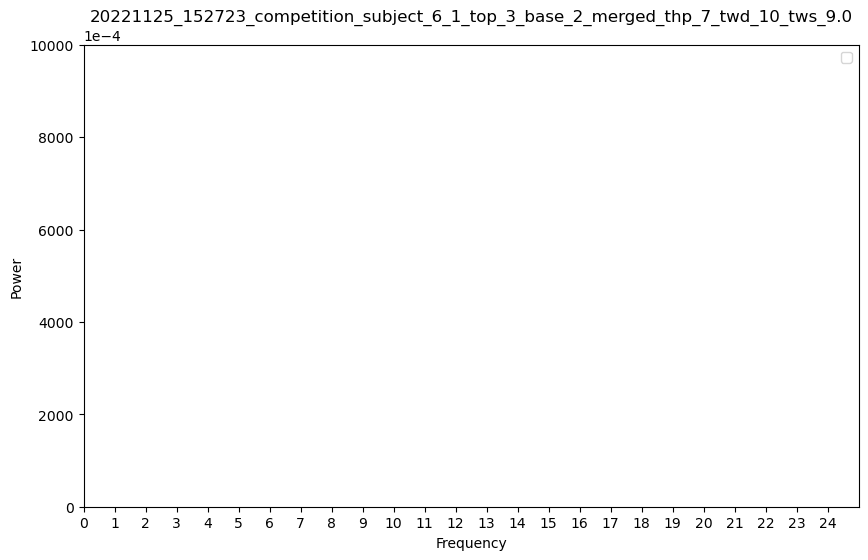

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


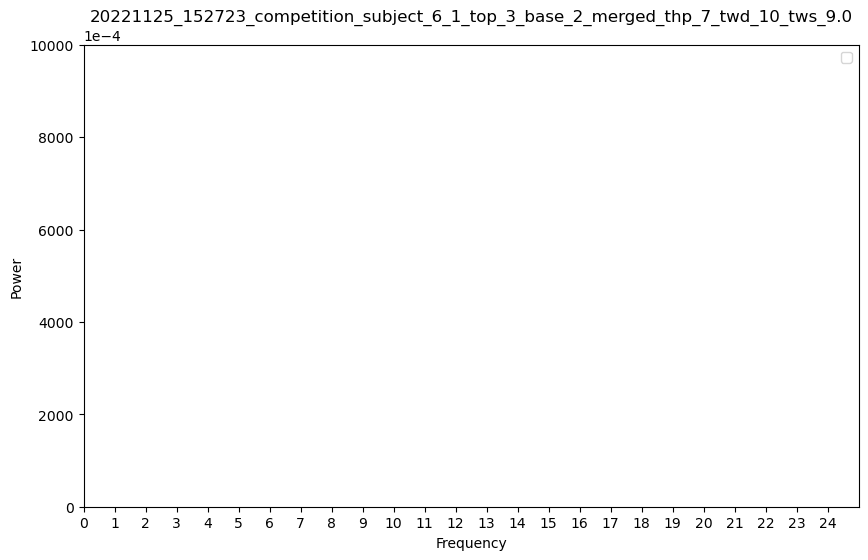

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


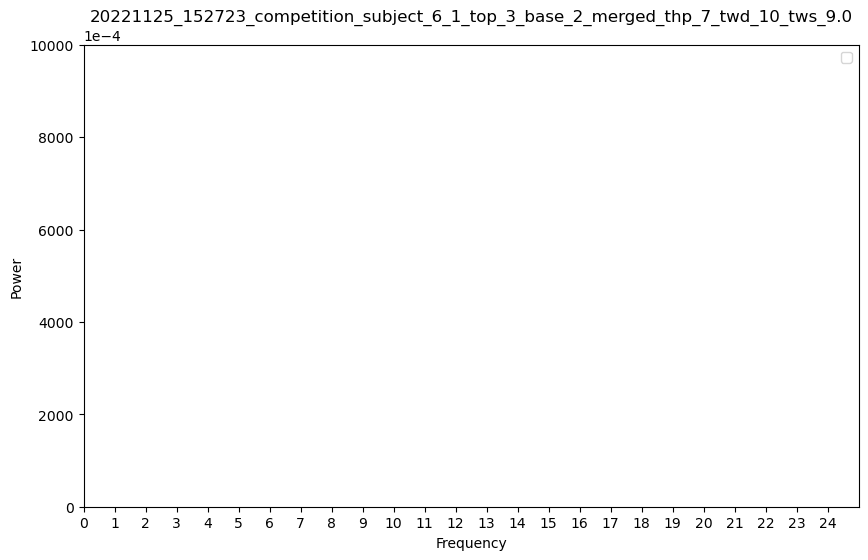

time_halfbandwidth_product: 10, time_window_duration: 2,         tws_ratio: 0.9, time_window_step 1.8
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 539,904,000 bytes (allocated so far: 9,800,627,200 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 539,904,000 bytes (allocated so far: 9,800,627,200 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 15
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 539,904,000 bytes (allocated so far: 9,800,627,200 bytes).
LFP File Path: .

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Out of memory allocating 465,728,000 bytes (allocated so far: 9,800,627,200 bytes).
20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


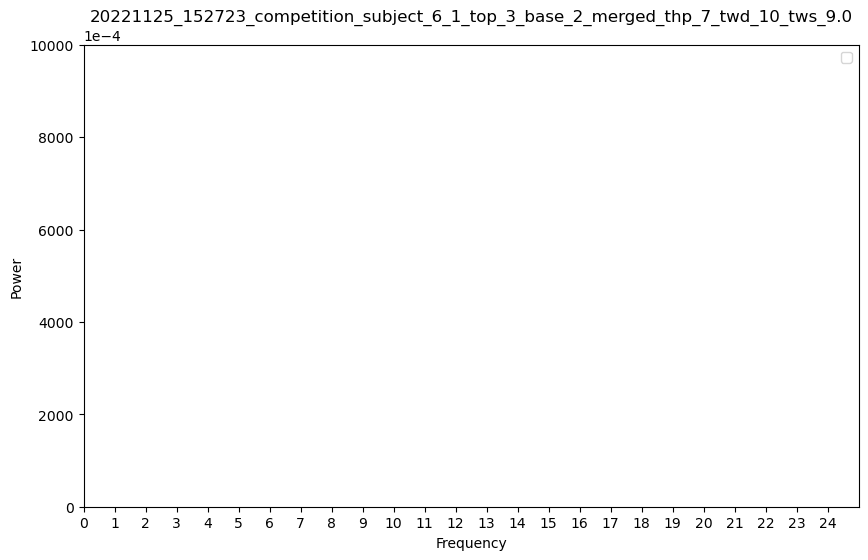

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


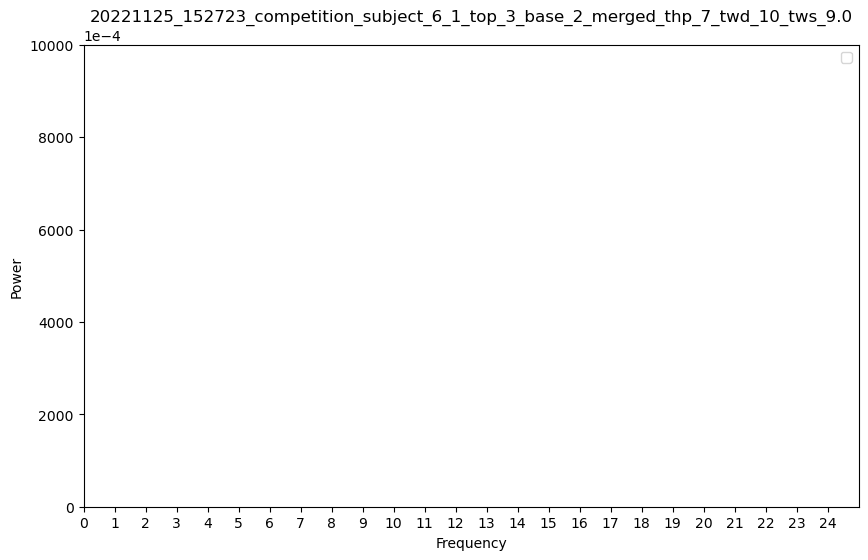

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


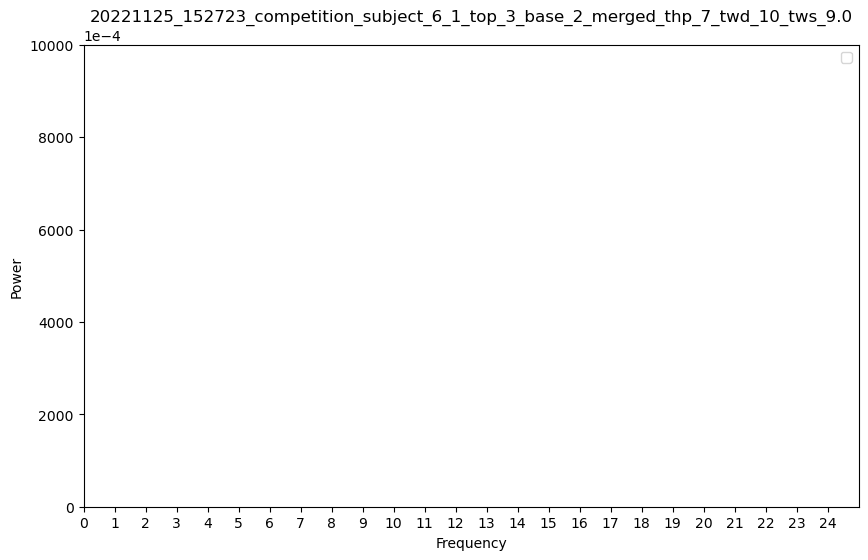

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_7_twd_10_tws_9.0.png


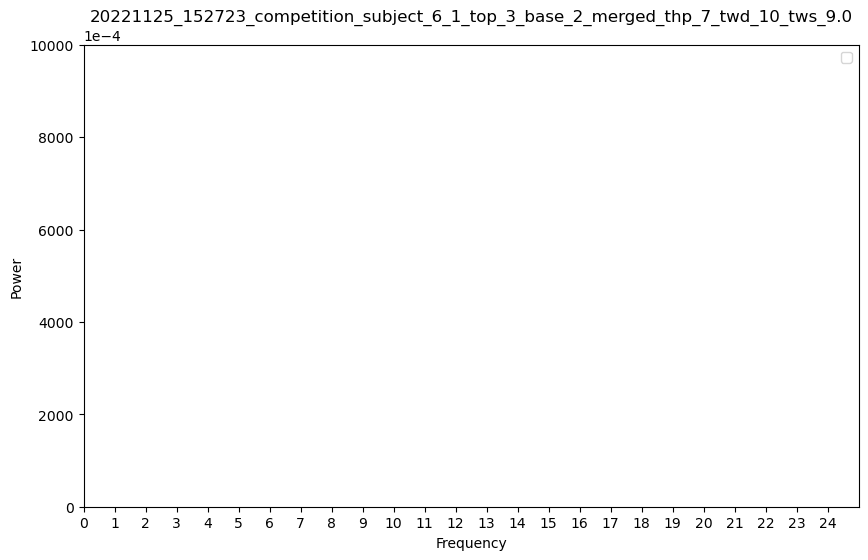

time_halfbandwidth_product: 10, time_window_duration: 3,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_10_twd_3_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_10_twd_3_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_10_twd_3_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_10_twd_3_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competiti

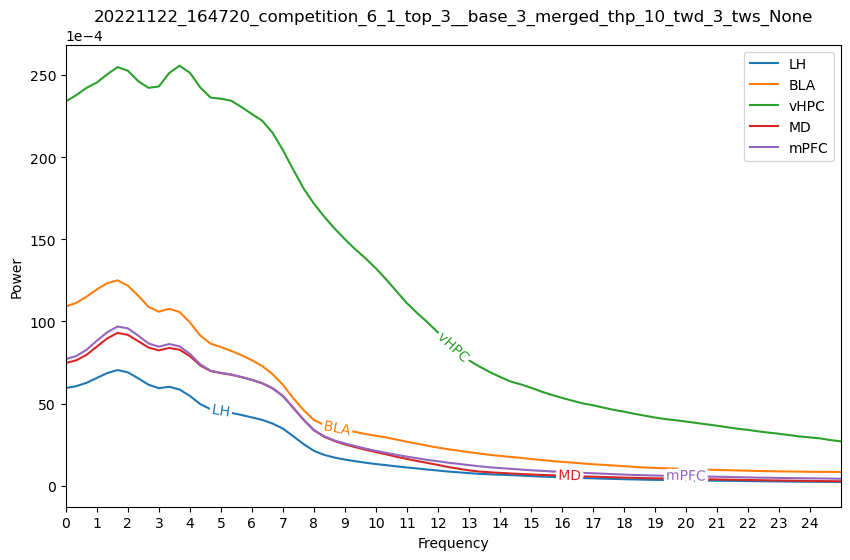

20221122_161341_omission_subject_6_1_top_4_base_2_thp_10_twd_3_tws_None.png


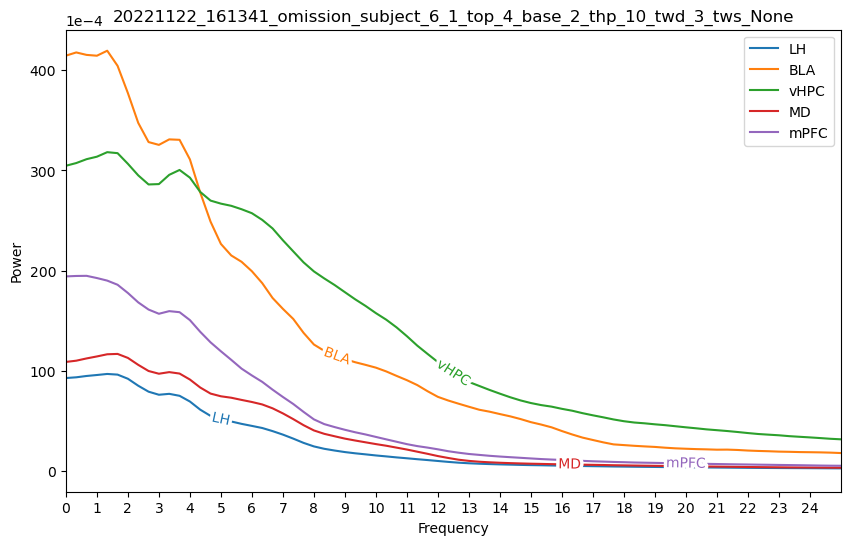

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_10_twd_3_tws_None.png


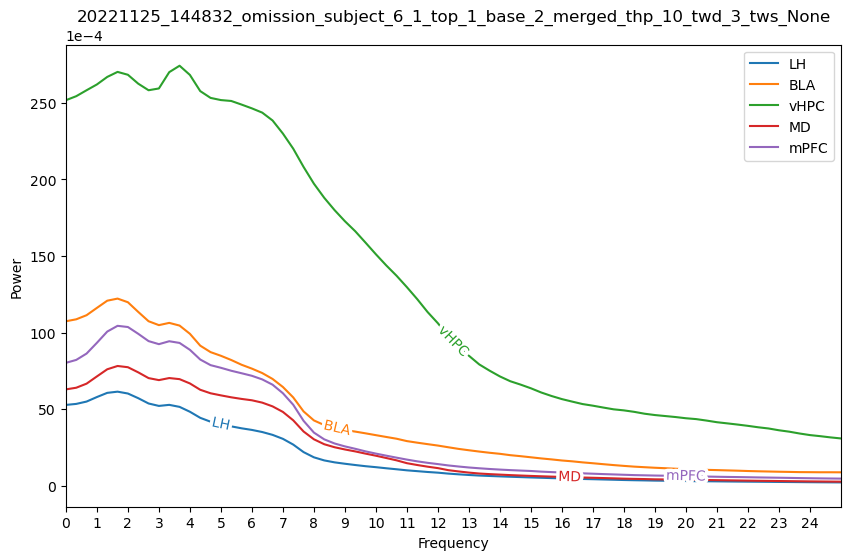

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_3_tws_None.png


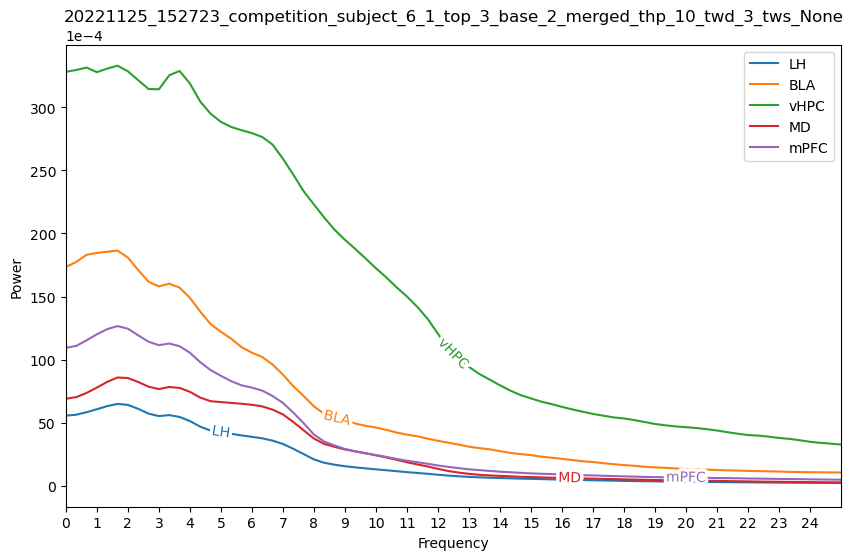

time_halfbandwidth_product: 10, time_window_duration: 3,         tws_ratio: 0.5, time_window_step 1.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 971,280,384 bytes (allocated so far: 9,164,691,456 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 971,280,384 bytes (allocated so far: 9,164,691,456 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 15
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 971,280,384 bytes (allocated so far: 9,164,691,456 bytes).
LFP File Path: .

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Out of memory allocating 838,128,128 bytes (allocated so far: 10,002,819,584 bytes).
20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_3_tws_None.png


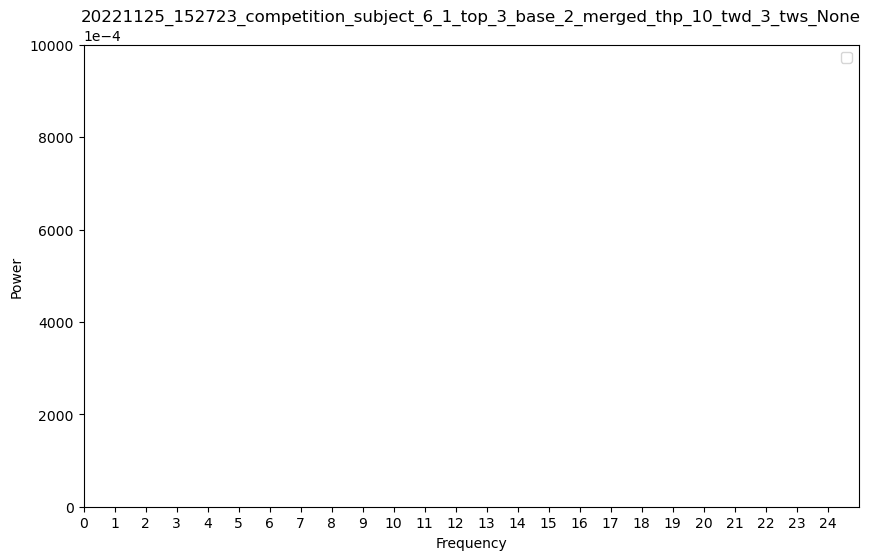

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_3_tws_None.png


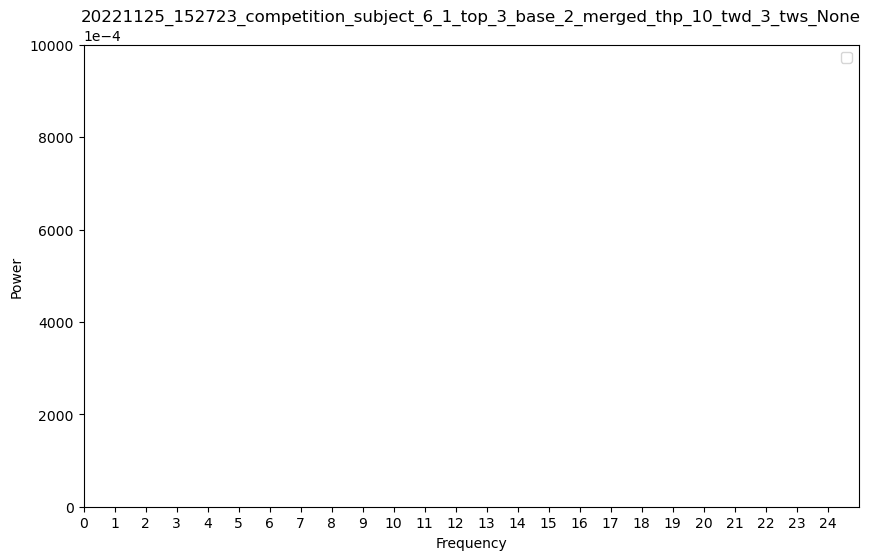

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_3_tws_None.png


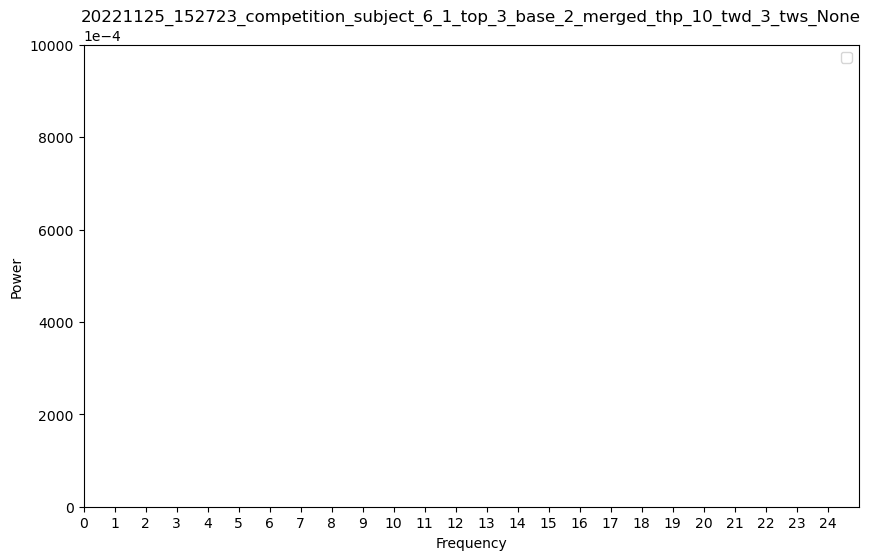

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_3_tws_None.png


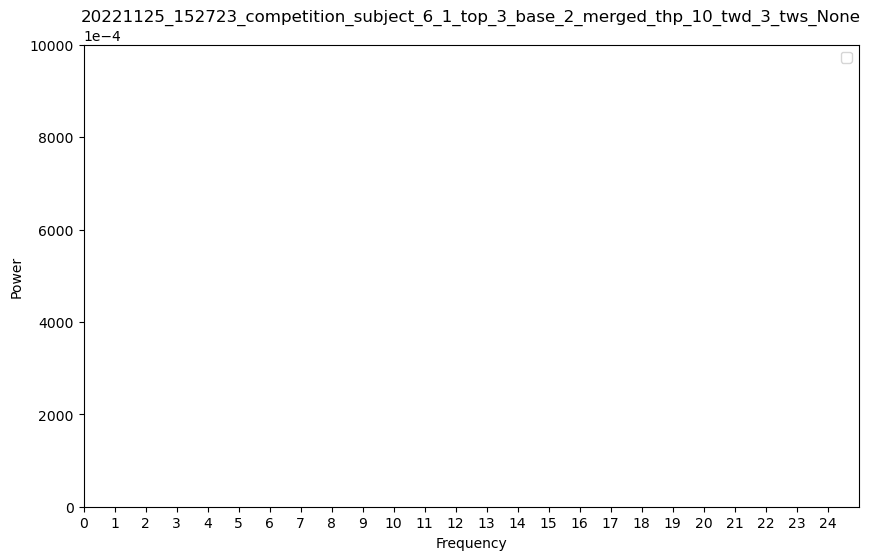

time_halfbandwidth_product: 10, time_window_duration: 3,         tws_ratio: 0.9, time_window_step 2.7
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_10_twd_3_tws_2.7_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_10_twd_3_tws_2.7_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_10_twd_3_tws_2.7_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_10_twd_3_tws_2.7_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1

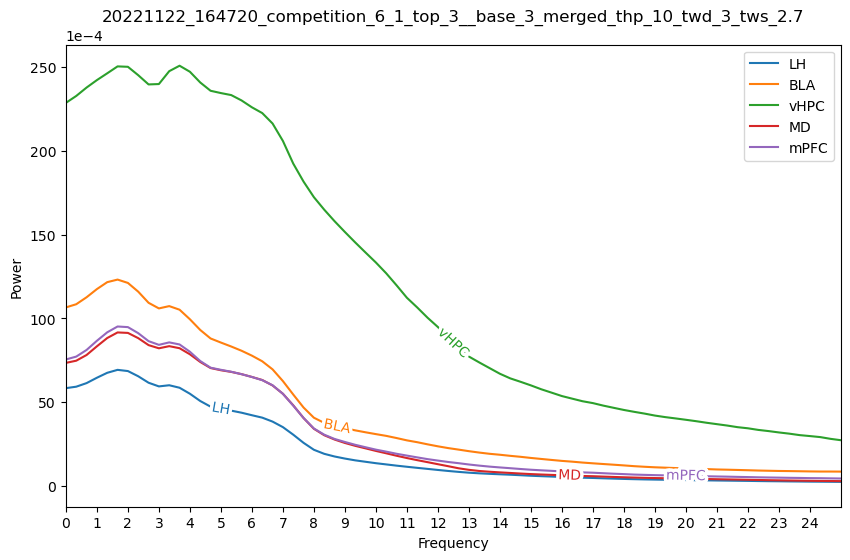

20221122_161341_omission_subject_6_1_top_4_base_2_thp_10_twd_3_tws_2.7.png


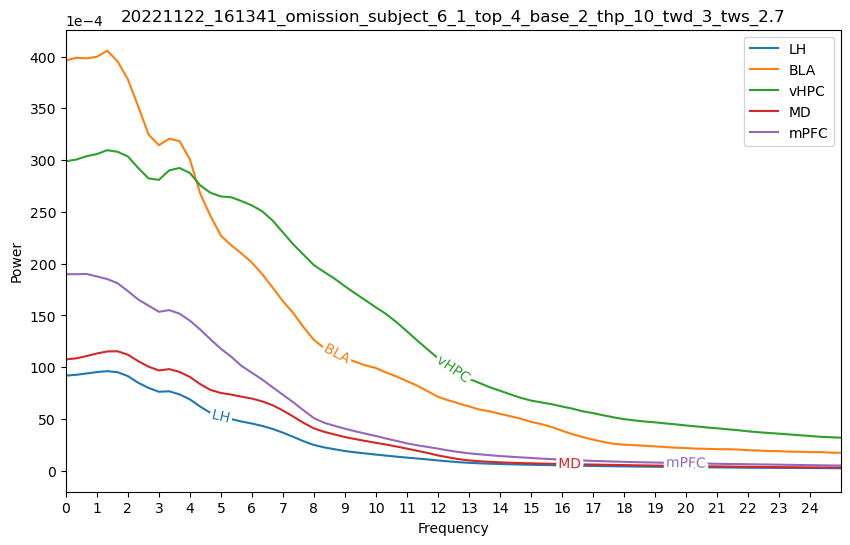

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_10_twd_3_tws_2.7.png


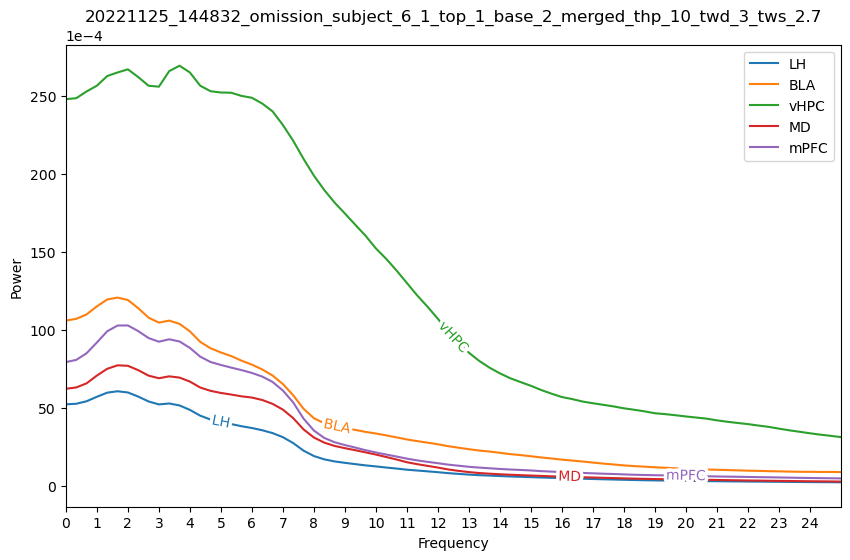

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_3_tws_2.7.png


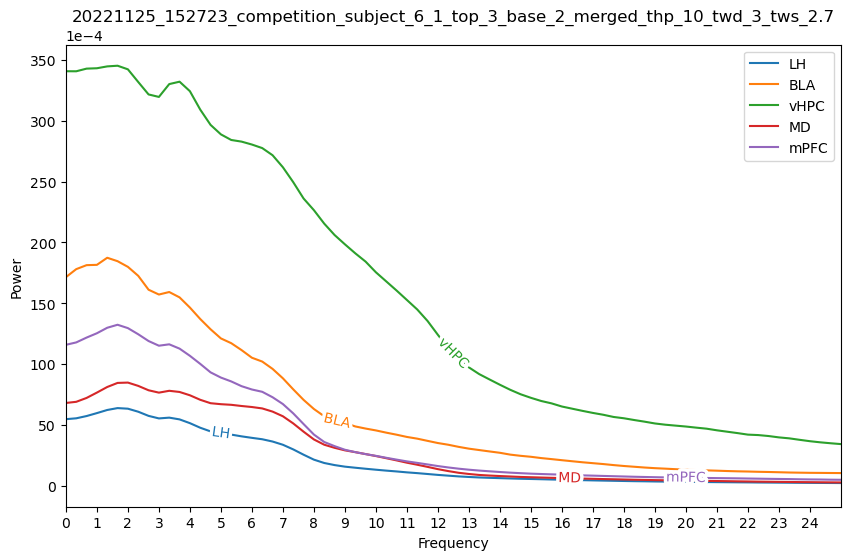

time_halfbandwidth_product: 10, time_window_duration: 5,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_10_twd_5_tws_None_ch_13.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_10_twd_5_tws_None_ch_13.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
20221122_164720_competition_6_1_top_3__base_3_merged_thp_10_twd_5_tws_None_ch_14.frequencies.npy
20221122_164720_competition_6_1_top_3__base_3_merged_thp_10_twd_5_tws_None_ch_14.power.npy
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competiti

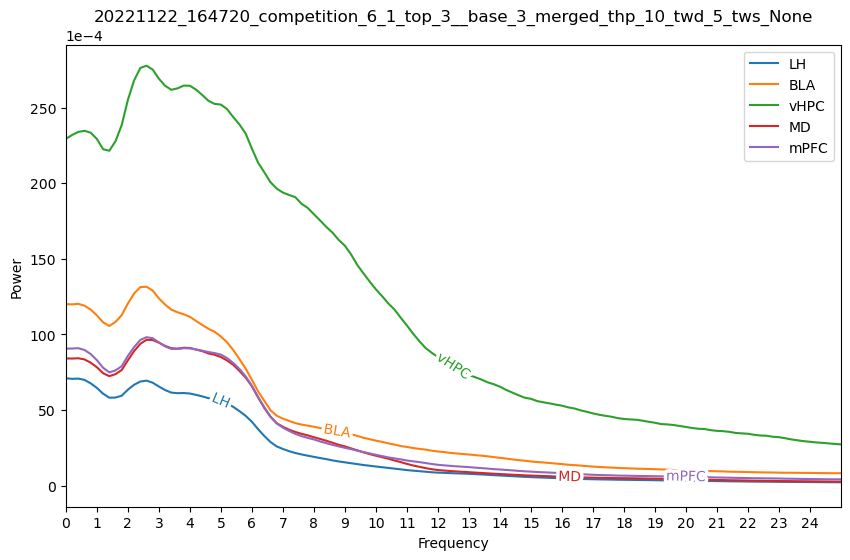

20221122_161341_omission_subject_6_1_top_4_base_2_thp_10_twd_5_tws_None.png


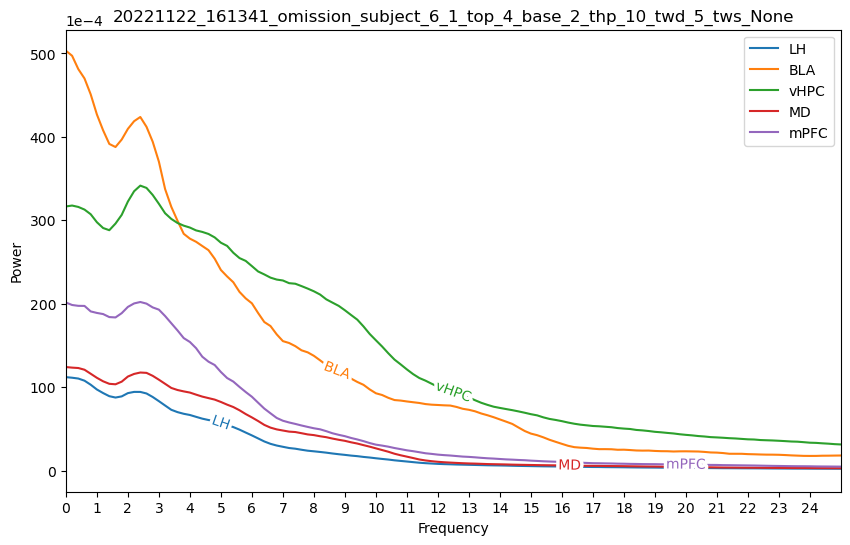

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_10_twd_5_tws_None.png


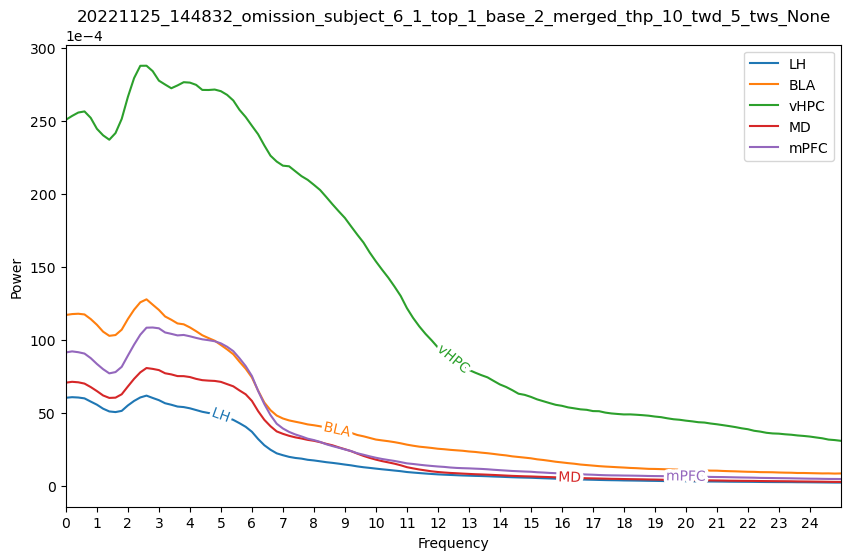

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_5_tws_None.png


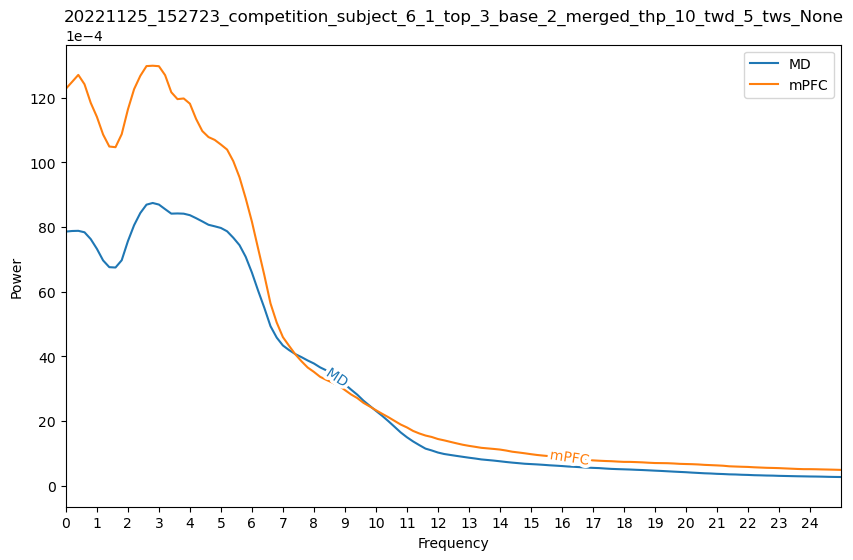

time_halfbandwidth_product: 10, time_window_duration: 5,         tws_ratio: 0.5, time_window_step 2.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 969,760,256 bytes (allocated so far: 10,002,819,584 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 969,760,256 bytes (allocated so far: 9,439,347,200 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 15
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 969,760,256 bytes (allocated so far: 9,439,347,200 bytes).
LFP File Path: 

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Out of memory allocating 837,520,384 bytes (allocated so far: 9,736,963,584 bytes).
20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_5_tws_None.png


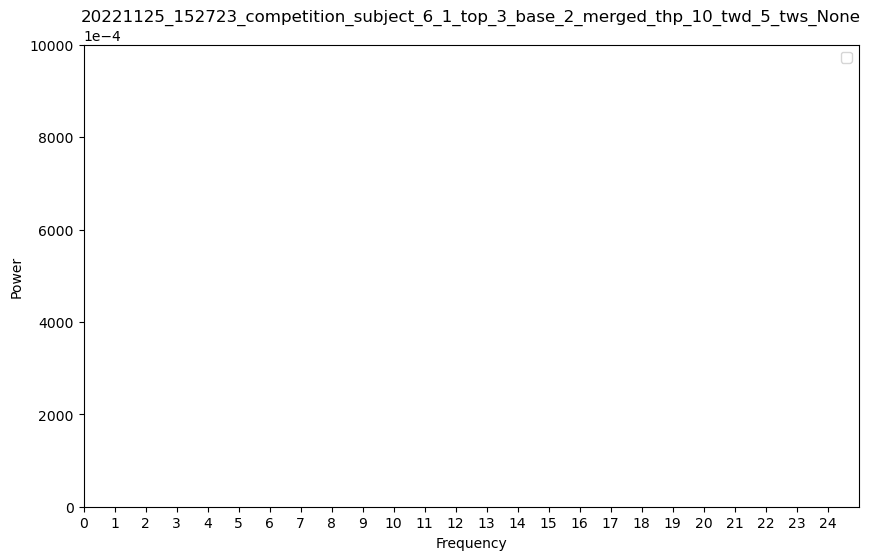

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_5_tws_None.png


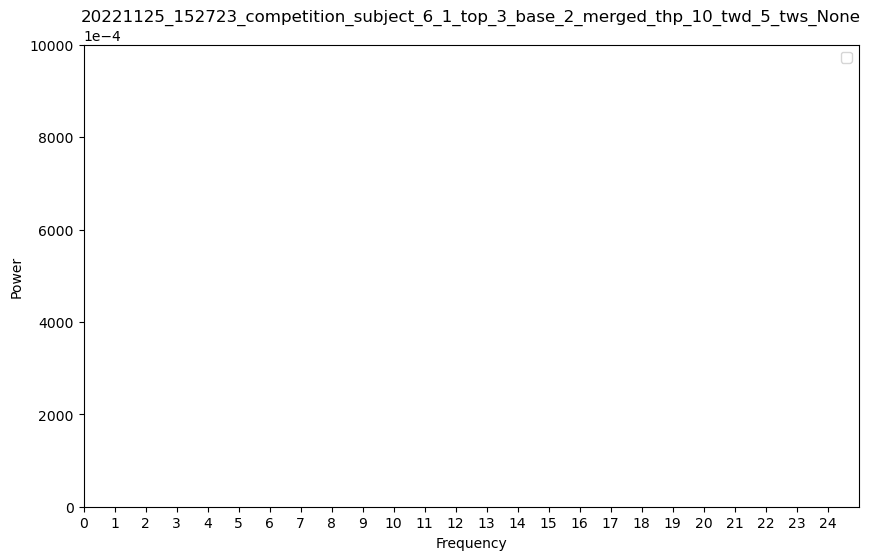

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_5_tws_None.png


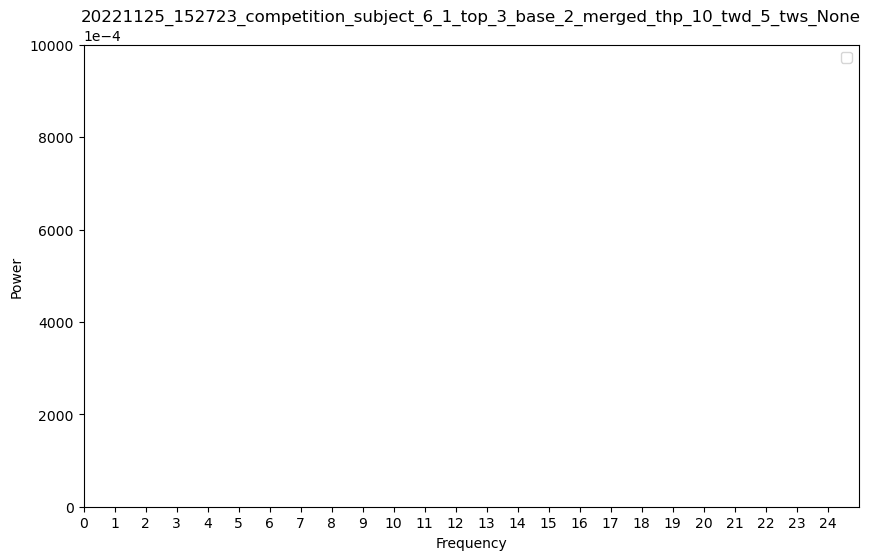

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_5_tws_None.png


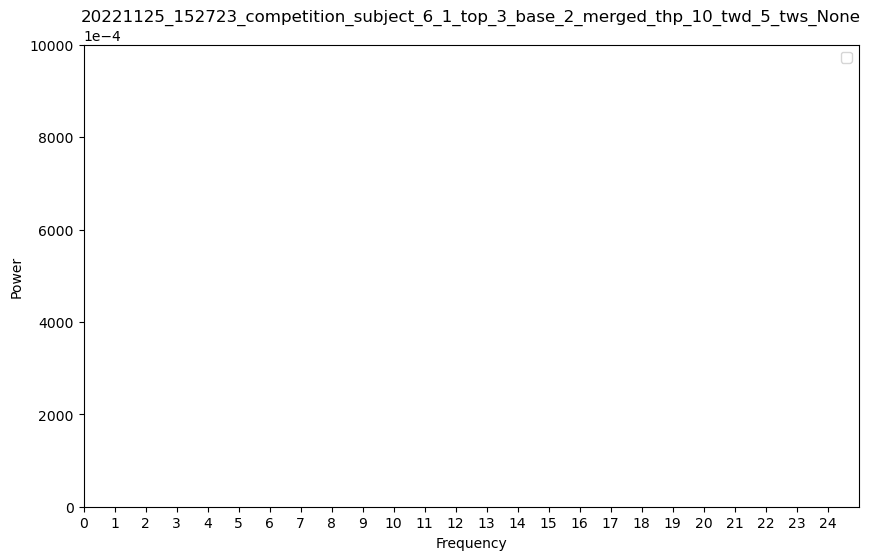

time_halfbandwidth_product: 10, time_window_duration: 5,         tws_ratio: 0.9, time_window_step 4.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 539,600,384 bytes (allocated so far: 9,736,963,584 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 539,600,384 bytes (allocated so far: 9,736,963,584 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 15
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 539,600,384 bytes (allocated so far: 9,736,963,584 bytes).
LFP File Path: .

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Out of memory allocating 465,120,256 bytes (allocated so far: 9,736,963,584 bytes).
20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_5_tws_None.png


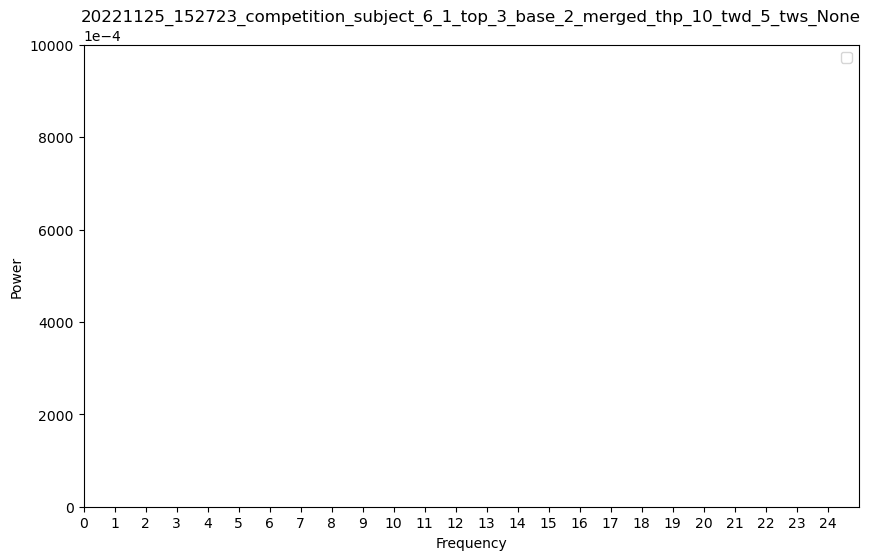

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_5_tws_None.png


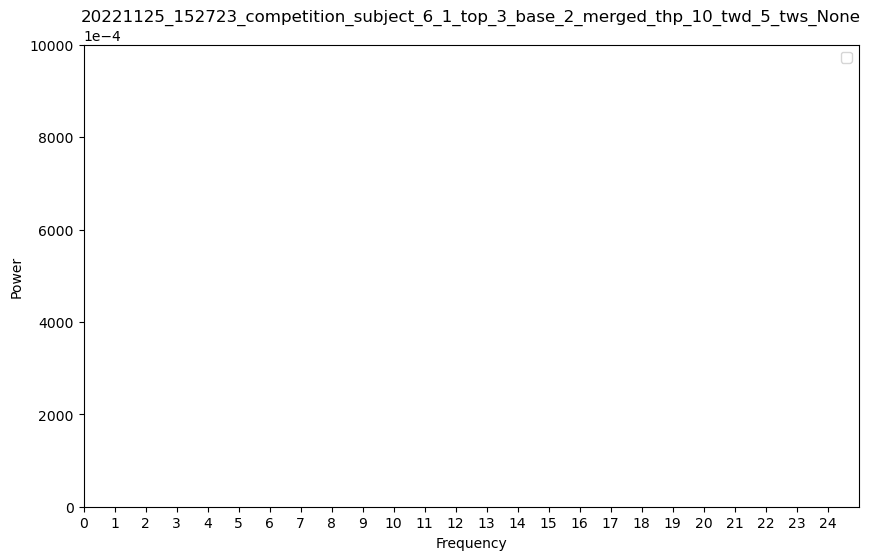

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_5_tws_None.png


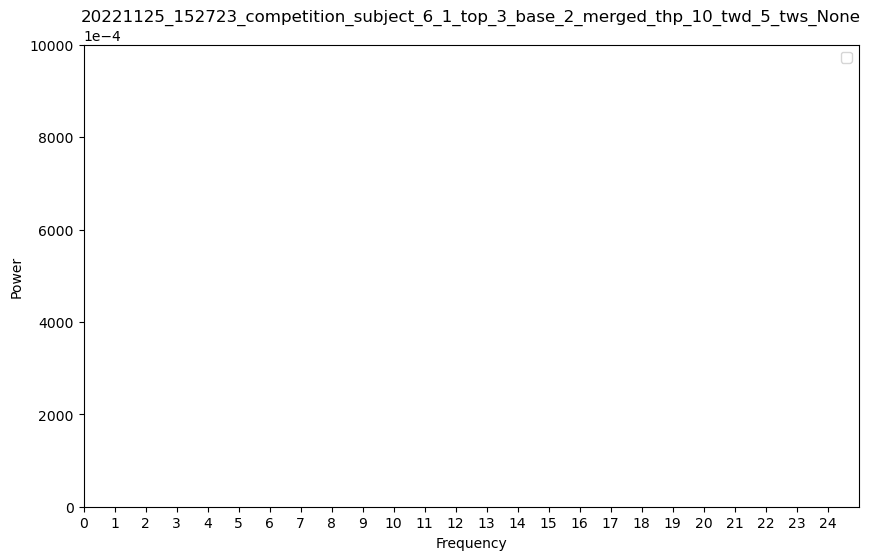

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_5_tws_None.png


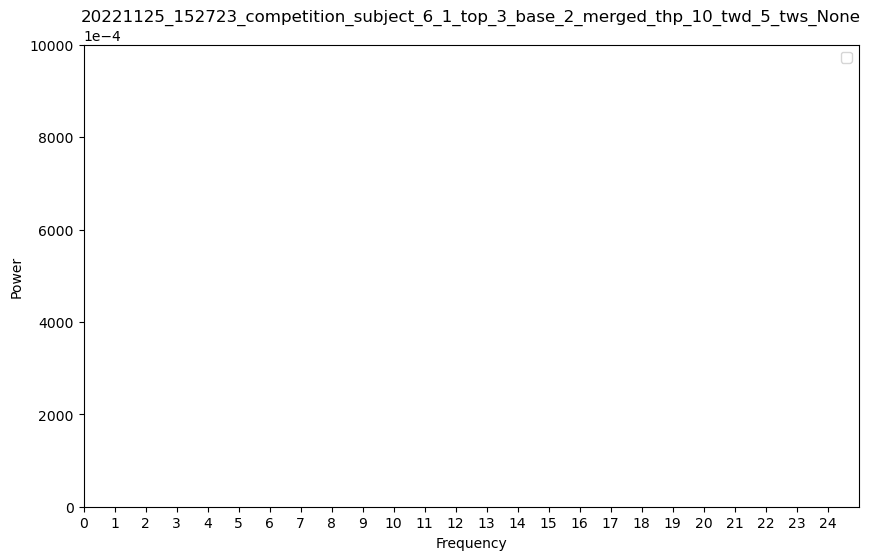

time_halfbandwidth_product: 10, time_window_duration: 7,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 485,184,000 bytes (allocated so far: 9,736,963,584 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 485,184,000 bytes (allocated so far: 9,736,963,584 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 15
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 485,184,000 bytes (allocated so far: 9,736,963,584 bytes).
LFP File Path:

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Out of memory allocating 419,216,384 bytes (allocated so far: 9,736,963,584 bytes).
20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_5_tws_None.png


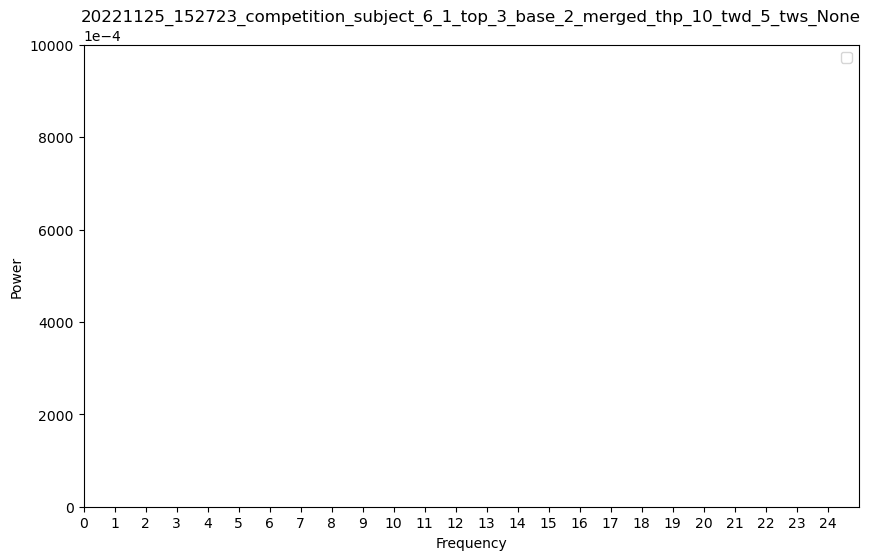

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_5_tws_None.png


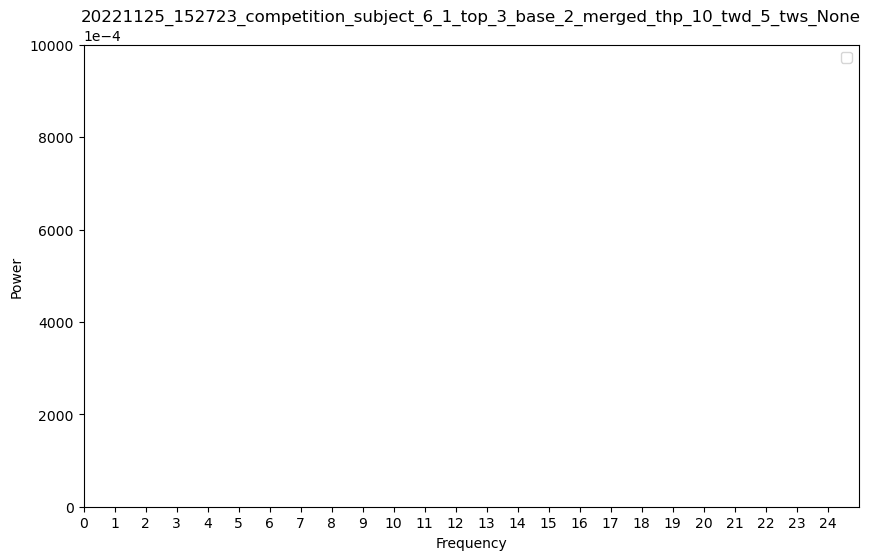

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_5_tws_None.png


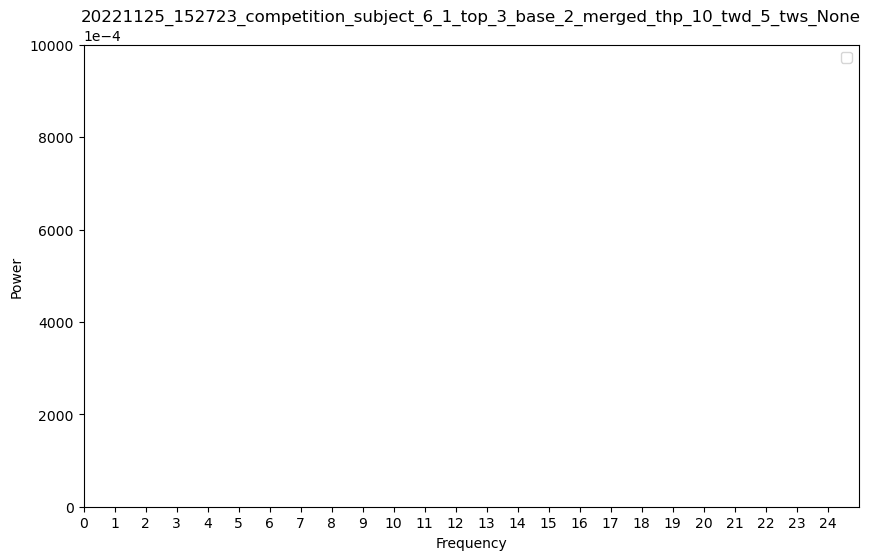

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_5_tws_None.png


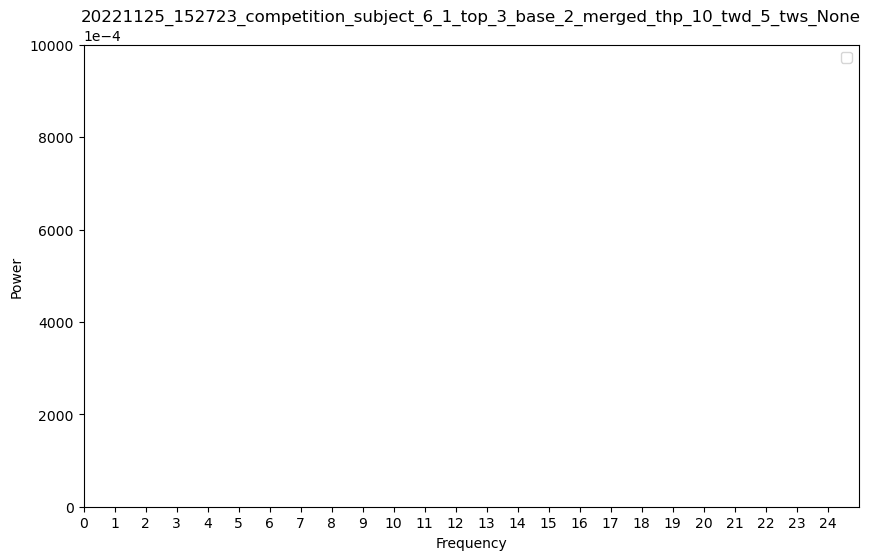

time_halfbandwidth_product: 10, time_window_duration: 7,         tws_ratio: 0.5, time_window_step 3.5
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 484,120,064 bytes (allocated so far: 9,736,963,584 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 484,120,064 bytes (allocated so far: 9,736,963,584 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 15
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 484,120,064 bytes (allocated so far: 9,736,963,584 bytes).
LFP File Path: .

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Out of memory allocating 836,304,384 bytes (allocated so far: 9,736,963,584 bytes).
20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_5_tws_None.png


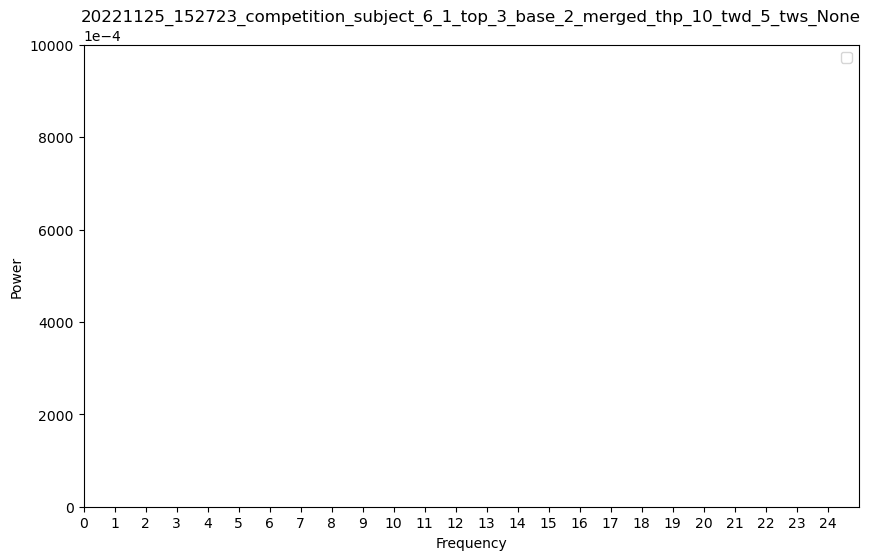

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_5_tws_None.png


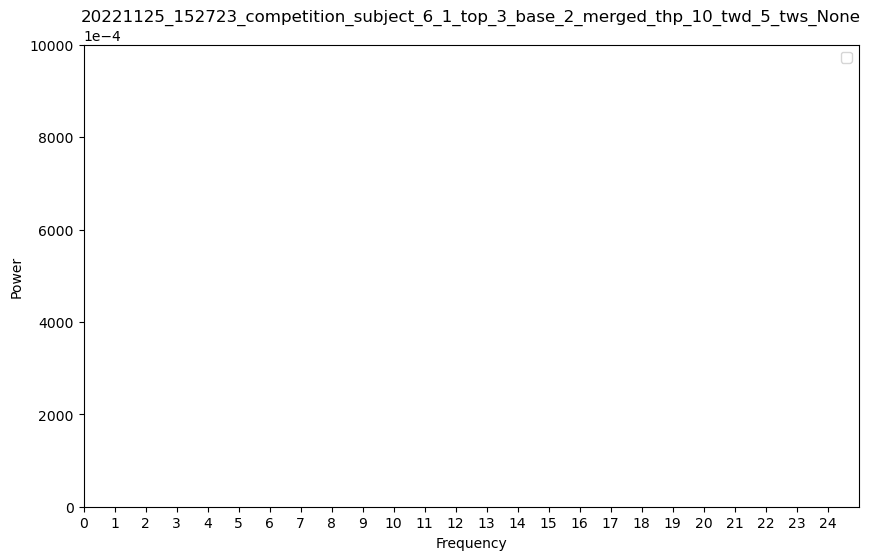

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_5_tws_None.png


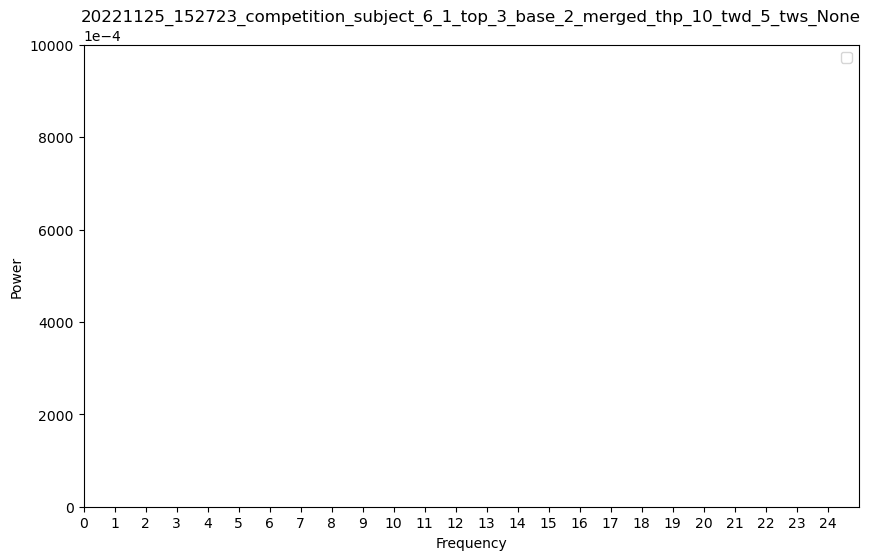

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_5_tws_None.png


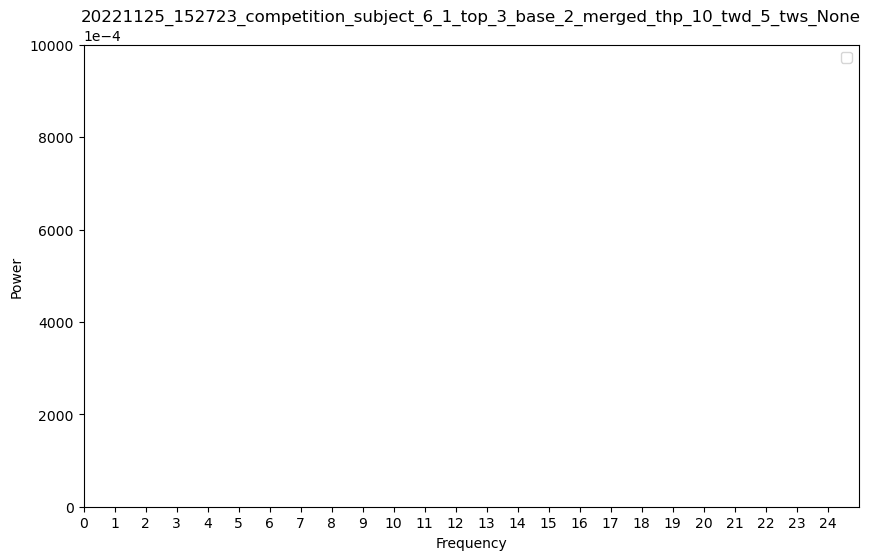

time_halfbandwidth_product: 10, time_window_duration: 7,         tws_ratio: 0.9, time_window_step 6.3
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 538,384,384 bytes (allocated so far: 9,736,963,584 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 538,384,384 bytes (allocated so far: 9,736,963,584 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 15
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 538,384,384 bytes (allocated so far: 9,736,963,584 bytes).
LFP File Path: .

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Out of memory allocating 463,904,256 bytes (allocated so far: 9,736,963,584 bytes).
20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_5_tws_None.png


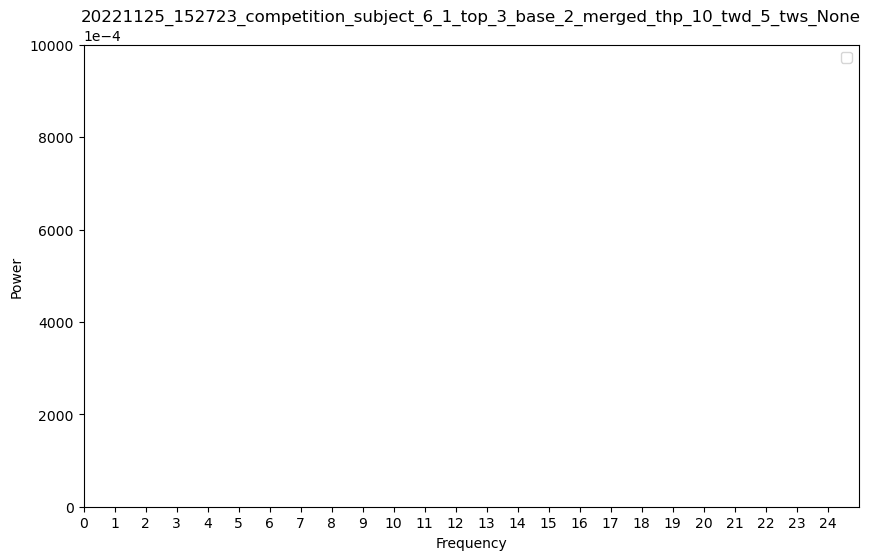

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_5_tws_None.png


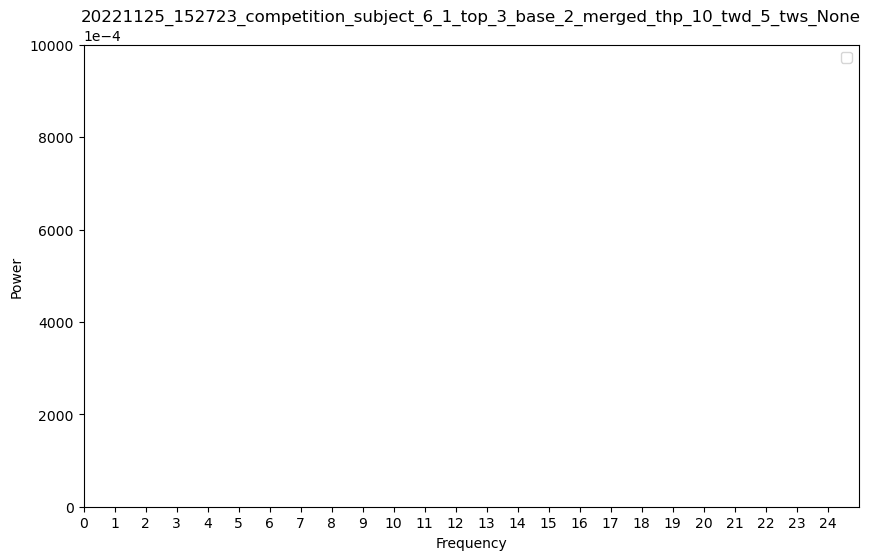

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_5_tws_None.png


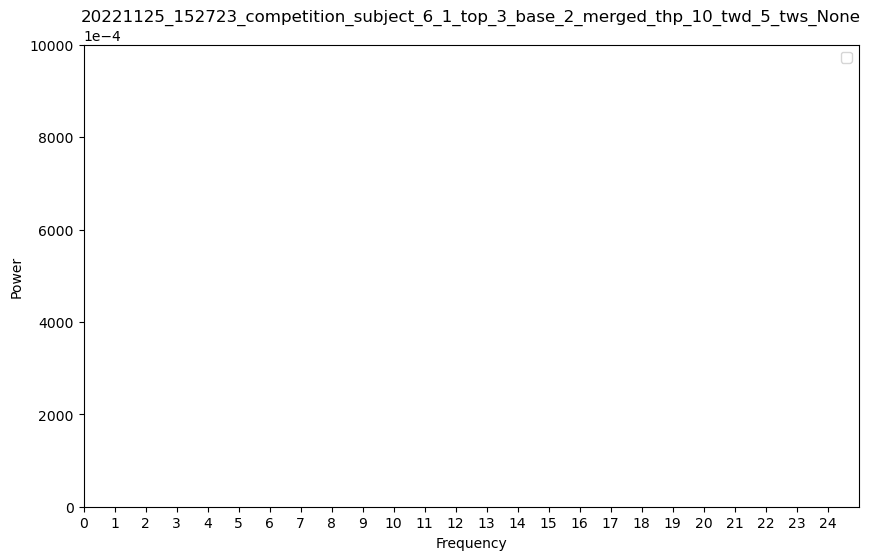

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_5_tws_None.png


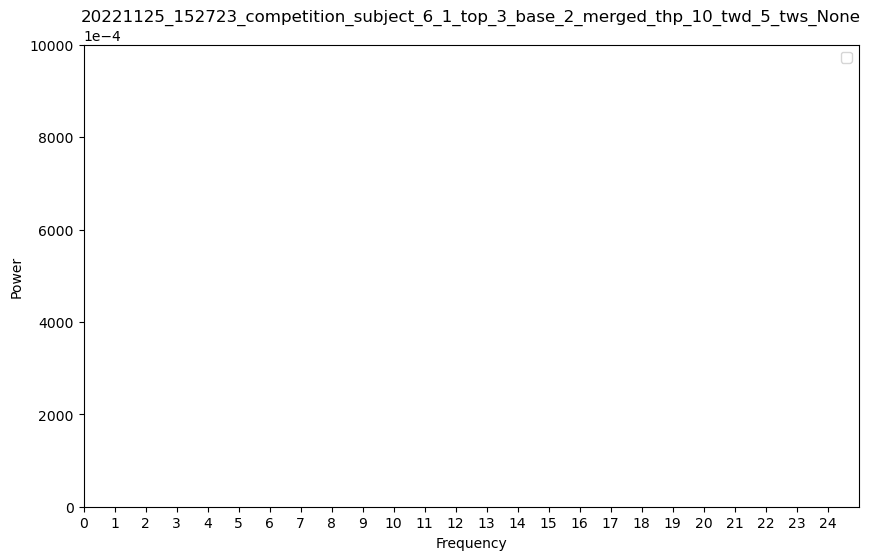

time_halfbandwidth_product: 10, time_window_duration: 10,         tws_ratio: None, time_window_step None
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 483,360,256 bytes (allocated so far: 9,736,963,584 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 483,360,256 bytes (allocated so far: 9,736,963,584 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 15
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 483,360,256 bytes (allocated so far: 9,736,963,584 bytes).
LFP File Path

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Out of memory allocating 419,520,000 bytes (allocated so far: 9,736,963,584 bytes).
20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_5_tws_None.png


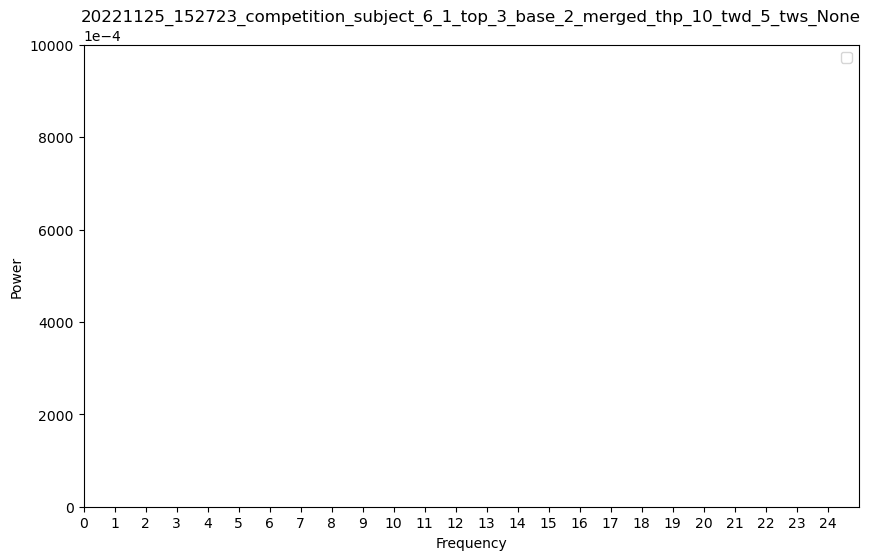

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_5_tws_None.png


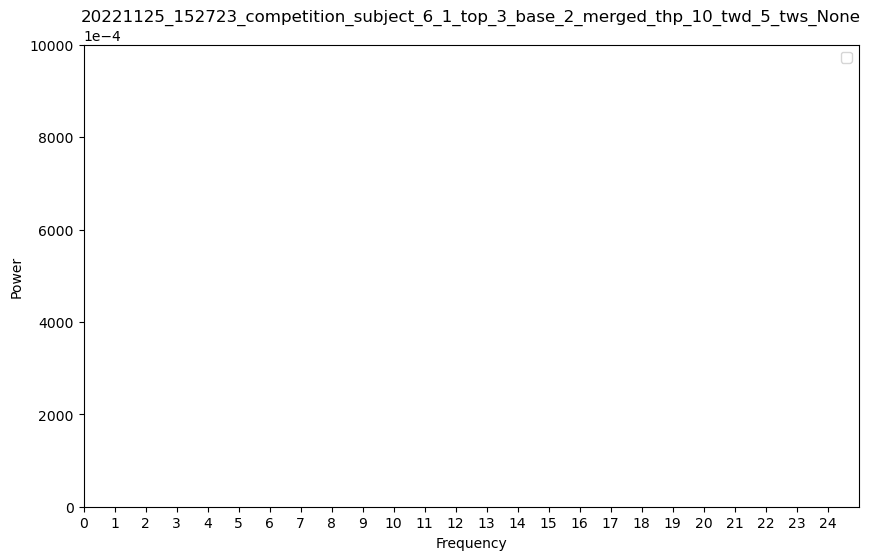

20221125_144832_omission_subject_6_1_top_1_base_2_merged_thp_10_twd_10_tws_None.png


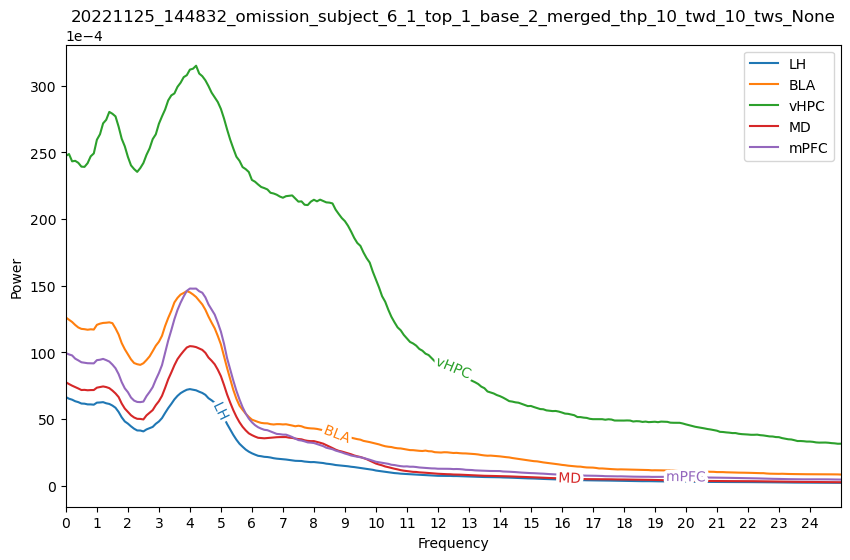

20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_10_tws_None.png


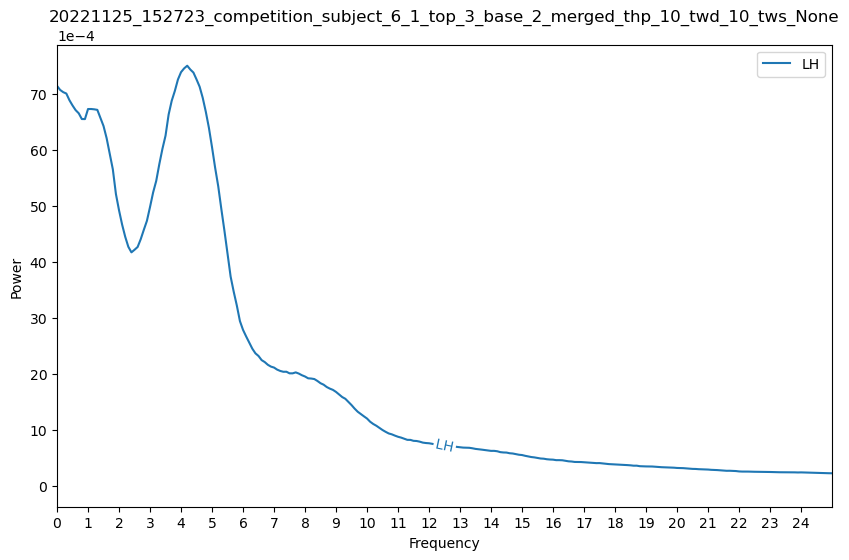

time_halfbandwidth_product: 10, time_window_duration: 10,         tws_ratio: 0.5, time_window_step 5.0
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 966,720,000 bytes (allocated so far: 9,736,963,584 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 966,720,000 bytes (allocated so far: 9,736,963,584 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 15
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 966,720,000 bytes (allocated so far: 9,736,963,584 bytes).
LFP File Path: 

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Out of memory allocating 836,000,256 bytes (allocated so far: 9,907,987,456 bytes).
20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_10_tws_None.png


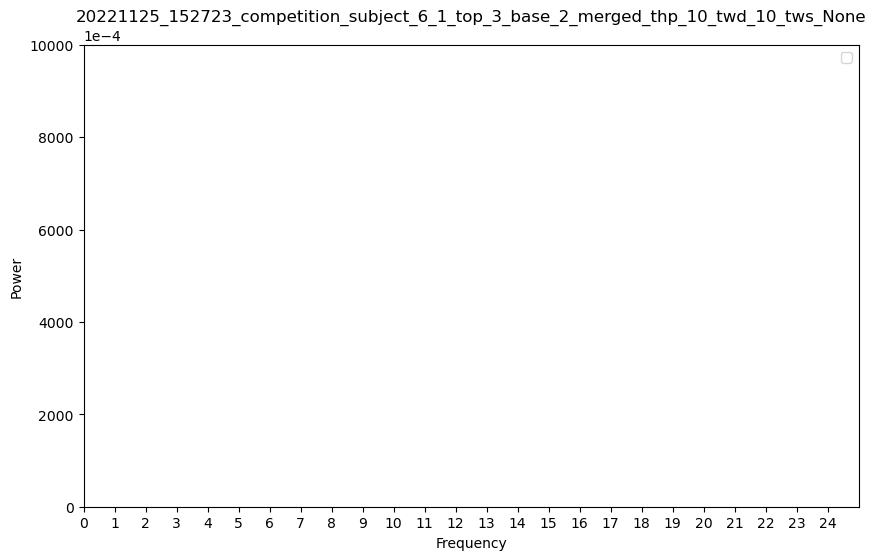

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_10_tws_None.png


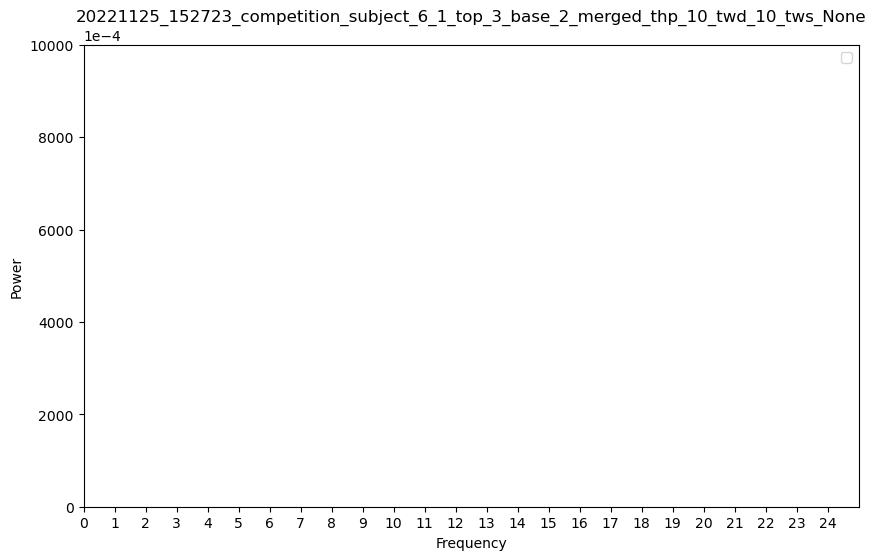

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_10_tws_None.png


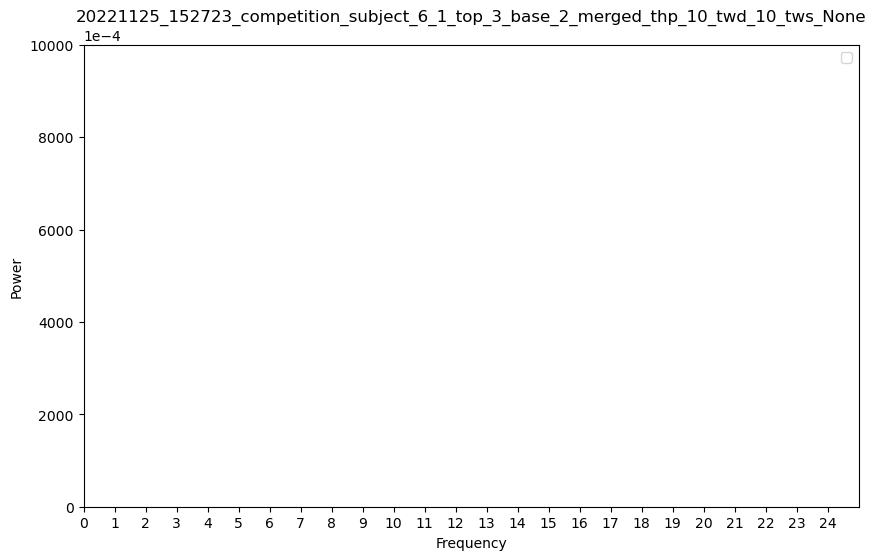

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_10_tws_None.png


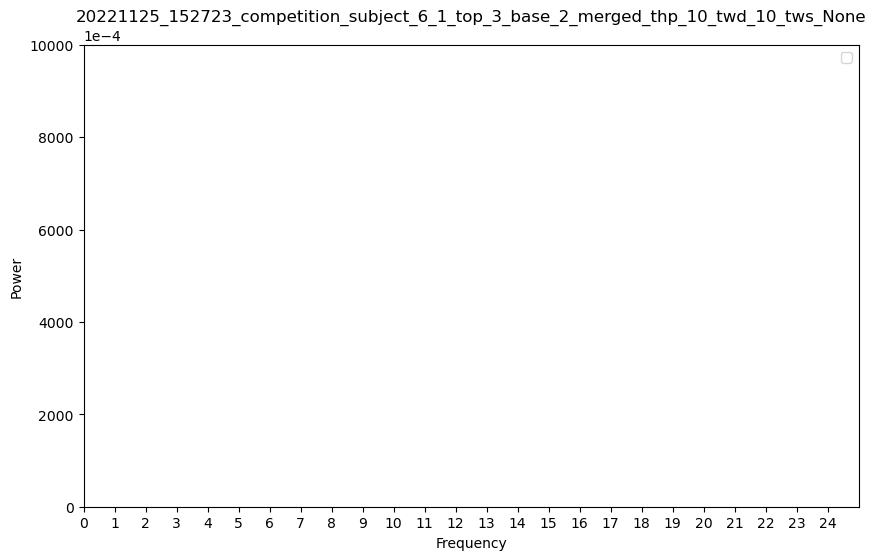

time_halfbandwidth_product: 10, time_window_duration: 10,         tws_ratio: 0.9, time_window_step 9.0
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 13
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 538,080,256 bytes (allocated so far: 9,907,987,456 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 14
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 538,080,256 bytes (allocated so far: 9,907,987,456 bytes).
LFP File Path: ./proc/20221122_164720_competition_6_1_top_3__base_3_merged/20221122_164720_competition_6_1_top_3__base_3_merged.traces.npy
Channel: 15
(1599198,)
calculating multitaper
calculating connectivity
Out of memory allocating 538,080,256 bytes (allocated so far: 9,907,987,456 bytes).
LFP File Path: 

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Out of memory allocating 465,120,256 bytes (allocated so far: 9,907,987,456 bytes).
20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_10_tws_None.png


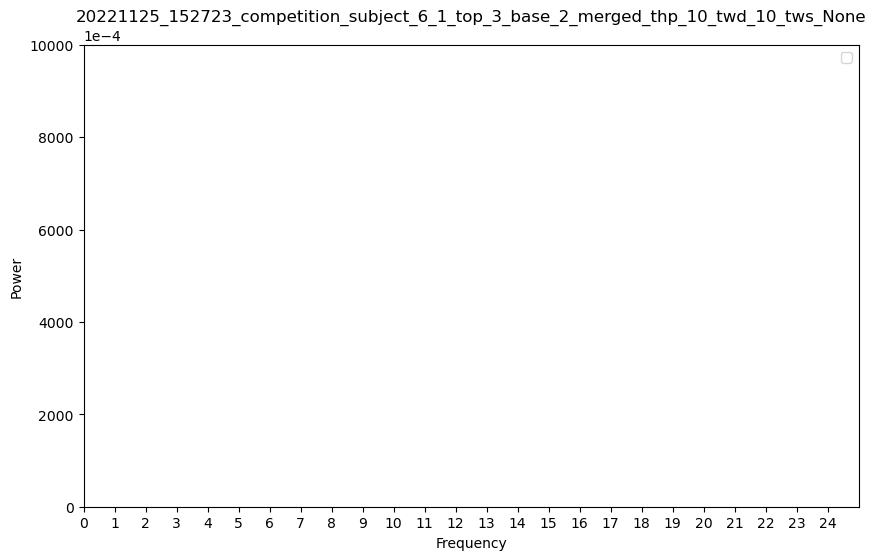

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_10_tws_None.png


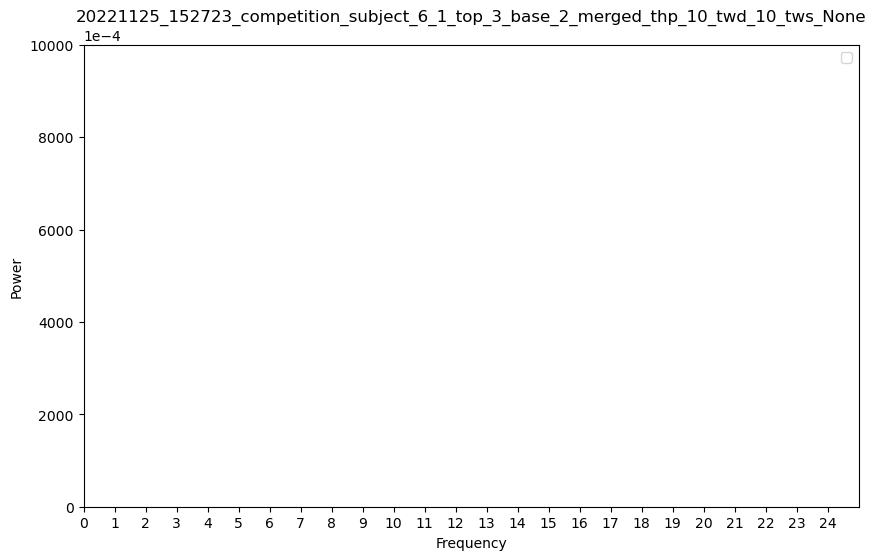

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_10_tws_None.png


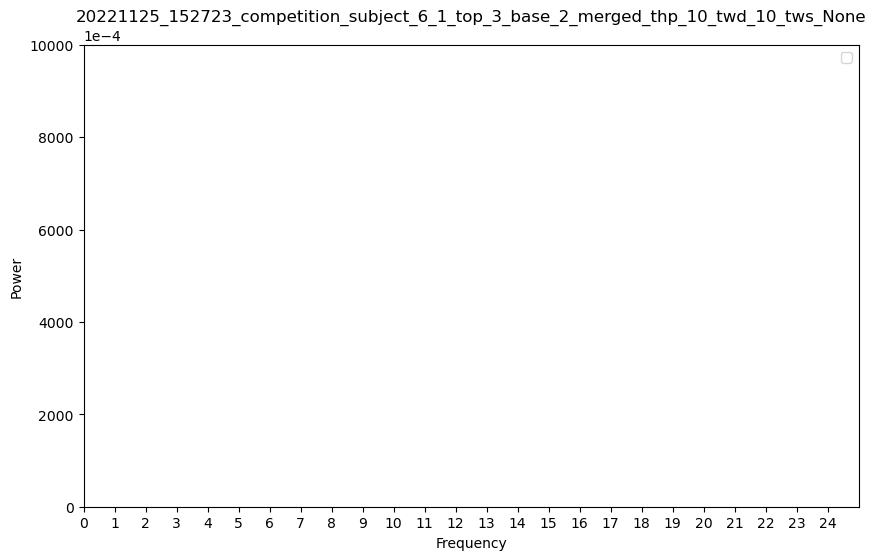

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


20221125_152723_competition_subject_6_1_top_3_base_2_merged_thp_10_twd_10_tws_None.png


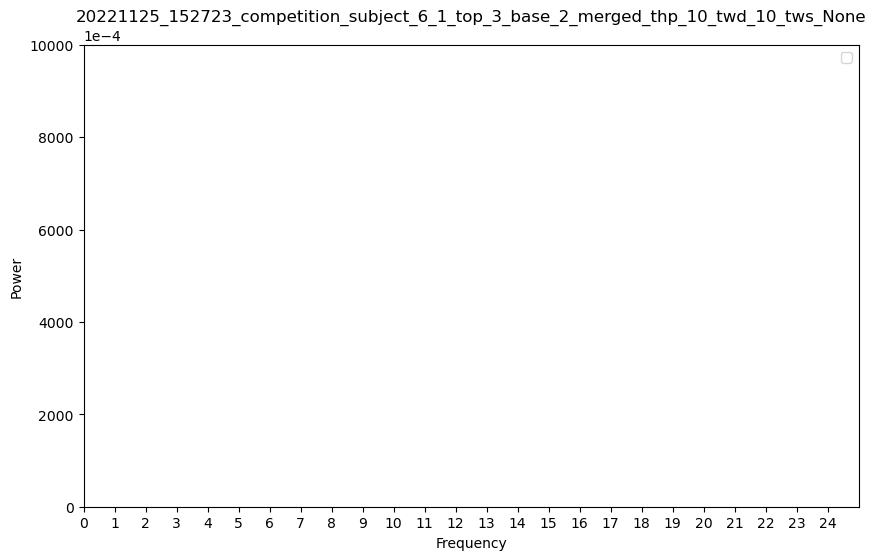

In [81]:
for param_combination in itertools.product(all_param_numbers, all_param_numbers, [None, 0.5, 0.9]):
    time_halfbandwidth_product = param_combination[0]
    time_window_duration = param_combination[1]
    tws_ratio = param_combination[2]
    if tws_ratio is None:
        time_window_step = None
    else:
        time_window_step = time_window_duration * tws_ratio

    print("time_halfbandwidth_product: {}, time_window_duration: {}, \
        tws_ratio: {}, time_window_step {}".format(time_halfbandwidth_product, time_window_duration, tws_ratio, time_window_step))
    
    power_issue_files = []
    for lfp_filepath, channel in itertools.product(lfp_array_filepath_glob, all_channels):
        print("LFP File Path: {}".format(lfp_filepath)) 
        print("Channel: {}".format(channel))
        try:
            recording_basename = os.path.basename(os.path.dirname(lfp_filepath))
            parent_output_directory = os.path.dirname(lfp_filepath)

            # Loading in LFP array
            lfp_array = np.load(lfp_filepath)
            # Cutting the LFP array to reduce on the memory usage
            lfp_array = lfp_array[int(lfp_array.shape[0]*first_proportion):int(lfp_array.shape[0]*second_proportion), channel]
            lfp_array = lfp_array*10**-3
            print(lfp_array.shape)
            print("calculating multitaper")
            # Compute multitaper spectral estimate
            m = Multitaper(time_halfbandwidth_product=time_halfbandwidth_product, time_series=lfp_array, \
                           sampling_frequency=resampled_frequency, time_window_duration=time_window_duration, \
                           time_window_step=time_window_step)

            print("calculating connectivity")
            # Sets up computing connectivity measures/power from multitaper spectral estimate
            c = Connectivity.from_multitaper(m, blocks=blocks)

            # Saving to file
            frequencies_filename = "{}_thp_{}_twd_{}_tws_{}_ch_{}.frequencies.npy".format(recording_basename, time_halfbandwidth_product, time_window_duration, time_window_step, channel)
            power_filename = "{}_thp_{}_twd_{}_tws_{}_ch_{}.power.npy".format(recording_basename, time_halfbandwidth_product, time_window_duration, time_window_step, channel)
            print(frequencies_filename)
            print(power_filename)
            np.save(file=os.path.join(parent_output_directory, frequencies_filename), arr=c.frequencies)
            np.save(file=os.path.join(parent_output_directory, power_filename), arr=c.power().squeeze())

        except Exception as e: 
            print(e)
            power_issue_files.append((lfp_filepath, channel))
            
    for prefix in all_prefixes:
        freq_array_filepath_glob = sorted(glob.glob("./proc/*/*{}*thp_{}_twd_{}_tws_{}*.frequencies.npy".format(prefix, time_halfbandwidth_product, time_window_duration, time_window_step)))

        power_array_filepath_glob = sorted(glob.glob("./proc/*/*{}*thp_{}_twd_{}_tws_{}*.power.npy".format(prefix, time_halfbandwidth_product, time_window_duration, time_window_step)))


        fig, ax = plt.subplots()
        ax.set_xlabel("Frequency")
        ax.set_ylabel("Power")

        for freq_array_path, power_array_path in zip(freq_array_filepath_glob, power_array_filepath_glob):
            output_dir_path = os.path.dirname(freq_array_path)
            channel = freq_array_path.split("ch_")[1].split(".")[0]
            freq_array = np.load(freq_array_path)
            power_array = np.load(power_array_path)
            ax.plot(freq_array, np.mean(power_array, axis=0), label=channel_brain_region[channel])


        freq_start = 0
        freq_end = 25
        ax.set_xlim(freq_start, freq_end)
        plt.xticks(np.arange(freq_start, freq_end, 1.0))
        plt.ticklabel_format(axis='y', style='sci', scilimits=(-4,-4))
        ax.legend()
        labelLines(ax.get_lines(), zorder=2.5)   

        lfp_basename = os.path.basename(freq_array_path).split("ch")[0].strip("_")

        plt.title("{}".format(lfp_basename))
        plt_file_name = "{}.png".format(lfp_basename)
        print(plt_file_name)
        plt.savefig(os.path.join(output_dir_path, plt_file_name))
        plt.show()

In [ ]:
with cp.cuda.Device(0):
    power_issue_files = []
    for lfp_filepath, channel in itertools.product(lfp_array_filepath_glob, all_channels):
        print("LFP File Path: {}".format(lfp_filepath)) 
        print("Channel: {}".format(channel))
        try:
            recording_basename = os.path.basename(os.path.dirname(lfp_filepath))
            parent_output_directory = os.path.dirname(lfp_filepath)

            # Loading in LFP array
            lfp_array = np.load(lfp_filepath)
            # Cutting the LFP array to reduce on the memory usage
            lfp_array = lfp_array[int(lfp_array.shape[0]*first_proportion):int(lfp_array.shape[0]*second_proportion), channel]
            lfp_array = lfp_array*10**-3
            print(lfp_array.shape)
            print("calculating multitaper")
            # Compute multitaper spectral estimate
            m = Multitaper(time_halfbandwidth_product=time_halfbandwidth_product, time_series=lfp_array, \
                           sampling_frequency=resampled_frequency, time_window_duration=time_window_duration, \
                           time_window_step=time_window_step, n_fft_samples=2048)

            print("calculating connectivity")
            # Sets up computing connectivity measures/power from multitaper spectral estimate
            c = Connectivity.from_multitaper(m, blocks=blocks)

            # Saving to file
            frequencies_filename = "{}_thp_{}_twd_{}_ch_{}.frequencies.npy".format(recording_basename, time_halfbandwidth_product, time_window_duration, channel)
            power_filename = "{}_thp_{}_twd_{}_ch_{}.power.npy".format(recording_basename, time_halfbandwidth_product, time_window_duration, channel)
            
            np.save(file=os.path.join(parent_output_directory, frequencies_filename), arr=c.frequencies)
            np.save(file=os.path.join(parent_output_directory, power_filename), arr=c.power().squeeze())

        except Exception as e: 
            print(e)
            power_issue_files.append((lfp_filepath, channel))

In [ ]:
for prefix in all_prefixes:
    freq_array_filepath_glob = sorted(glob.glob("./proc/*/{}*thp_{}_*twd_{}*frequencies.npy".format(prefix, time_halfbandwidth_product, time_window_duration), recursive=True))
    power_array_filepath_glob = sorted(glob.glob("./proc/*/{}*thp_{}_*twd_{}*power.npy".format(prefix, time_halfbandwidth_product, time_window_duration), recursive=True))
    
    fig, ax = plt.subplots()
    ax.set_xlabel("Frequency")
    ax.set_ylabel("Power")

    for freq_array_path, power_array_path in zip(freq_array_filepath_glob, power_array_filepath_glob):
        output_dir_path = os.path.dirname(freq_array_path)
        channel = freq_array_path.split("ch_")[1].split(".")[0]
        print(channel)
        freq_array = np.load(freq_array_path)
        power_array = np.load(power_array_path)


        ax.plot(freq_array, np.mean(power_array, axis=0), label=channel_brain_region[channel])


    freq_start = 0
    freq_end = 25
    ax.set_xlim(freq_start, freq_end)
#     ax.set_ylim(0, 10e-4)
    plt.xticks(np.arange(freq_start, freq_end, 1.0))

    plt.ticklabel_format(axis='y', style='sci', scilimits=(-4,-4))
    ax.legend()
    labelLines(ax.get_lines(), zorder=2.5)   

    lfp_basename = os.path.basename(freq_array_path).split(".")[0]
    lfp_basename = lfp_basename.split("_ch")[0]

    plt.title("{}".format(lfp_basename))
    plt_file_name = "{}.png".format(lfp_basename)
    print(plt_file_name)
    plt.savefig(os.path.join(output_dir_path, plt_file_name))
    plt.show()

In [ ]:
raise ValueError()

In [ ]:
for prefix in all_prefixes:
    freq_array_filepath_glob = sorted(glob.glob("./proc/*/*nancy*{}*thp_{}*twd_{}*frequencies.npy".format(prefix, time_halfbandwidth_product, time_window_duration), recursive=True))
    power_array_filepath_glob = sorted(glob.glob("./proc/*/*nancy*{}*thp_{}*twd_{}*power.npy".format(prefix, time_halfbandwidth_product, time_window_duration), recursive=True))
    
    fig, ax = plt.subplots()
    ax.set_xlabel("Frequency")
    ax.set_ylabel("Power")

    for freq_array_path, power_array_path in zip(freq_array_filepath_glob, power_array_filepath_glob):
        output_dir_path = os.path.dirname(freq_array_path)
        channel = freq_array_path.split("ch_")[1].split(".")[0]
        print(channel)
        freq_array = np.load(freq_array_path)
        power_array = np.load(power_array_path)


        ax.plot(freq_array, np.mean(power_array, axis=0), label=channel_brain_region[channel])


    freq_start = 0
    freq_end = 25
    ax.set_xlim(freq_start, freq_end)
#     ax.set_ylim(0, 10e-4)
    plt.xticks(np.arange(freq_start, freq_end, 1.0))

    plt.ticklabel_format(axis='y', style='sci', scilimits=(-4,-4))
    ax.legend()
    labelLines(ax.get_lines(), zorder=2.5)   

    lfp_basename = os.path.basename(freq_array_path).split(".")[0]
    lfp_basename = lfp_basename.split("_ch")[0]

    plt.title("{}".format(lfp_basename))
    plt_file_name = "{}.png".format(lfp_basename)
    print(plt_file_name)
#     plt.savefig(os.path.join(output_dir_path, plt_file_name))
    plt.show()

In [ ]:
type(c)

- One at a time

In [ ]:
freq_array_filepath_glob = sorted(glob.glob("./proc/*/*thp_{}*twd_{}*frequencies.npy".format(time_halfbandwidth_product, time_window_duration), recursive=True))
power_array_filepath_glob = sorted(glob.glob("./proc/*/*thp_{}*twd_{}*power.npy".format(time_halfbandwidth_product, time_window_duration), recursive=True))

In [ ]:
freq_array_filepath_glob

In [ ]:
power_array_filepath_glob

- All channels

In [ ]:
fig, ax = plt.subplots()
ax.set_xlabel("Frequency")
ax.set_ylabel("Power")

for freq_array_path, power_array_path in zip(freq_array_filepath_glob, power_array_filepath_glob):
    output_dir_path = os.path.dirname(freq_array_path)
    channel = freq_array_path.split("ch_")[1].split(".")[0]
    print(channel)
    freq_array = np.load(freq_array_path)
    power_array = np.load(power_array_path)
    

    ax.plot(freq_array, np.mean(power_array, axis=0), label=channel_brain_region[channel])
    

freq_start = 0.5
freq_end = 12
freq_end = 25
ax.set_xlim(freq_start, freq_end)
ax.set_ylim(0,100000)
ax.legend()
labelLines(ax.get_lines(), zorder=2.5)   

lfp_basename = os.path.basename(freq_array_path).split(".")[0]
lfp_basename = lfp_basename.split("_ch")[0]

plt.title("{}".format(lfp_basename))
plt_file_name = "{}.png".format(lfp_basename)
plt.savefig(os.path.join(output_dir_path, plt_file_name))
plt.show()

- Inidividual Plots